In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['specific_humidity'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df) 

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + 12*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 2040)
(11, 2040)


In [ ]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

[I 2025-05-18 04:05:15,374] A new study created in memory with name: no-name-5d7c79c9-69bd-4c62-98aa-ef90ceff878f
[I 2025-05-18 04:12:38,672] Trial 0 finished with value: 1.0458225011825562 and parameters: {'lr': 0.23463430352784903, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2715073562571386}. Best is trial 0 with value: 1.0458225011825562.


Cross Validation Accuracies:
[1.3027656078338623, 1.2200371026992798, 0.7533045411109924, 1.0740679502487183, 0.878937304019928]
Mean Cross Validation Accuracy:
1.0458225011825562
Standard Deviation of Cross Validation Accuracy:
0.20522461783452914


[I 2025-05-18 04:21:16,166] Trial 1 finished with value: 0.4919180154800415 and parameters: {'lr': 0.30503403506714677, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.47331220886839087}. Best is trial 1 with value: 0.4919180154800415.


Cross Validation Accuracies:
[0.29149478673934937, 0.6598424315452576, 0.4975798428058624, 0.47106286883354187, 0.5396101474761963]
Mean Cross Validation Accuracy:
0.4919180154800415
Standard Deviation of Cross Validation Accuracy:
0.11925570260104182


[I 2025-05-18 04:27:04,893] Trial 2 finished with value: 0.07272223681211472 and parameters: {'lr': 0.0019276847820026042, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.13631191505541682}. Best is trial 2 with value: 0.07272223681211472.


Cross Validation Accuracies:
[0.061531104147434235, 0.06698019057512283, 0.08461730927228928, 0.07668106257915497, 0.07380151748657227]
Mean Cross Validation Accuracy:
0.07272223681211472
Standard Deviation of Cross Validation Accuracy:
0.00795666314942481


[I 2025-05-18 04:33:38,938] Trial 3 finished with value: 0.06473758146166801 and parameters: {'lr': 0.014674678404069282, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.25719861531160026}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05877918004989624, 0.060738541185855865, 0.07231773436069489, 0.07328290492296219, 0.05856954678893089]
Mean Cross Validation Accuracy:
0.06473758146166801
Standard Deviation of Cross Validation Accuracy:
0.006633563043587195


[I 2025-05-18 04:40:48,416] Trial 4 finished with value: 0.0652945339679718 and parameters: {'lr': 0.0038096583906000745, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.47254917114501627}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05759654939174652, 0.06326980888843536, 0.07316390424966812, 0.07345489412546158, 0.058987513184547424]
Mean Cross Validation Accuracy:
0.0652945339679718
Standard Deviation of Cross Validation Accuracy:
0.006806694585133741


[I 2025-05-18 04:45:45,855] Trial 5 finished with value: 0.0690462939441204 and parameters: {'lr': 0.029903537626174155, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.3702355579445723}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06273464858531952, 0.06659064441919327, 0.07940472662448883, 0.07432868331670761, 0.06217276677489281]
Mean Cross Validation Accuracy:
0.0690462939441204
Standard Deviation of Cross Validation Accuracy:
0.006757414040119259


[I 2025-05-18 04:51:51,537] Trial 6 finished with value: 0.07439061105251313 and parameters: {'lr': 0.0031015846848808037, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.43851710108020847}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.07843224704265594, 0.07210388034582138, 0.07476913183927536, 0.0748009905219078, 0.07184680551290512]
Mean Cross Validation Accuracy:
0.07439061105251313
Standard Deviation of Cross Validation Accuracy:
0.002381033167345503


[I 2025-05-18 04:56:26,165] Trial 7 finished with value: 0.09984699115157128 and parameters: {'lr': 0.0015502907989110753, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3513321974740117}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.1077122762799263, 0.14365071058273315, 0.0812491849064827, 0.10597202181816101, 0.06065076217055321]
Mean Cross Validation Accuracy:
0.09984699115157128
Standard Deviation of Cross Validation Accuracy:
0.027929795238358594


[I 2025-05-18 05:01:44,480] Trial 8 finished with value: 0.4549329161643982 and parameters: {'lr': 0.003153443631928263, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.169684050578026}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.44575947523117065, 0.4633876085281372, 0.4549821615219116, 0.43719223141670227, 0.4733431041240692]
Mean Cross Validation Accuracy:
0.4549329161643982
Standard Deviation of Cross Validation Accuracy:
0.01272244616929987


[I 2025-05-18 05:08:05,905] Trial 9 finished with value: 0.07470035701990127 and parameters: {'lr': 0.0012716181912856225, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2458889382850832}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06924682855606079, 0.07060843706130981, 0.08107593655586243, 0.08355922251939774, 0.06901136040687561]
Mean Cross Validation Accuracy:
0.07470035701990127
Standard Deviation of Cross Validation Accuracy:
0.0062924872105390925


[I 2025-05-18 05:13:34,963] Trial 10 finished with value: 0.06488067656755447 and parameters: {'lr': 0.022517455168363256, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.20679302838198058}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05898675695061684, 0.06115518510341644, 0.07242737710475922, 0.07325083762407303, 0.058583226054906845]
Mean Cross Validation Accuracy:
0.06488067656755447
Standard Deviation of Cross Validation Accuracy:
0.0065618250993125325


[I 2025-05-18 05:20:11,358] Trial 11 finished with value: 0.0652394413948059 and parameters: {'lr': 0.02391972937314993, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18753811777093046}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05955933406949043, 0.06247824430465698, 0.07239219546318054, 0.07283507287502289, 0.058932360261678696]
Mean Cross Validation Accuracy:
0.0652394413948059
Standard Deviation of Cross Validation Accuracy:
0.0061404007908850994


[I 2025-05-18 05:28:08,034] Trial 12 finished with value: 0.06505335420370102 and parameters: {'lr': 0.011842343106189876, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.23496255218086148}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.059205684810876846, 0.061241600662469864, 0.07248857617378235, 0.07336112856864929, 0.058969780802726746]
Mean Cross Validation Accuracy:
0.06505335420370102
Standard Deviation of Cross Validation Accuracy:
0.006481299381376767


[I 2025-05-18 05:35:27,079] Trial 13 finished with value: 0.06603479534387588 and parameters: {'lr': 0.11098368847182921, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.10870579952526153}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.061935488134622574, 0.06273854523897171, 0.07487756013870239, 0.07155965268611908, 0.05906273052096367]
Mean Cross Validation Accuracy:
0.06603479534387588
Standard Deviation of Cross Validation Accuracy:
0.006082726528680516


[I 2025-05-18 05:42:11,228] Trial 14 finished with value: 0.06488508805632591 and parameters: {'lr': 0.010805403885053648, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3277508897828936}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05894714221358299, 0.06101635470986366, 0.07249908149242401, 0.0730644166469574, 0.0588984452188015]
Mean Cross Validation Accuracy:
0.06488508805632591
Standard Deviation of Cross Validation Accuracy:
0.006495236766122169


[I 2025-05-18 05:48:17,647] Trial 15 finished with value: 0.07271102666854859 and parameters: {'lr': 0.08338536695304741, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.22078474004243567}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06449022889137268, 0.08431484550237656, 0.07457522302865982, 0.07462005317211151, 0.06555478274822235]
Mean Cross Validation Accuracy:
0.07271102666854859
Standard Deviation of Cross Validation Accuracy:
0.007218885854882107


[I 2025-05-18 05:54:29,339] Trial 16 finished with value: 0.06511583626270294 and parameters: {'lr': 0.00987855039727893, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2994220539070209}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05938439071178436, 0.06144820153713226, 0.07235714793205261, 0.07299277931451797, 0.059396661818027496]
Mean Cross Validation Accuracy:
0.06511583626270294
Standard Deviation of Cross Validation Accuracy:
0.00622081659344144


[I 2025-05-18 05:59:26,305] Trial 17 finished with value: 0.06510208621621132 and parameters: {'lr': 0.6423451279861242, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3975037985344668}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05599265173077583, 0.06354887038469315, 0.07469639182090759, 0.07467550039291382, 0.056597016751766205]
Mean Cross Validation Accuracy:
0.06510208621621132
Standard Deviation of Cross Validation Accuracy:
0.008263551799241672


[I 2025-05-18 06:06:10,065] Trial 18 finished with value: 0.06815013885498047 and parameters: {'lr': 0.06759071440356733, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.17006531434551703}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06577073037624359, 0.0623144656419754, 0.07519000768661499, 0.07434622943401337, 0.06312926113605499]
Mean Cross Validation Accuracy:
0.06815013885498047
Standard Deviation of Cross Validation Accuracy:
0.005529505787252086


[I 2025-05-18 06:14:22,341] Trial 19 finished with value: 1.2570969104766845 and parameters: {'lr': 0.018255301202693388, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.28740617084574127}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[1.148516297340393, 1.2343900203704834, 1.30912184715271, 1.2719659805297852, 1.3214904069900513]
Mean Cross Validation Accuracy:
1.2570969104766845
Standard Deviation of Cross Validation Accuracy:
0.062256819836791426


[I 2025-05-18 06:18:18,573] Trial 20 finished with value: 0.06627224534749984 and parameters: {'lr': 0.047484294281056175, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20561704490325536}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06237891688942909, 0.06232786551117897, 0.07293351739645004, 0.07454252988100052, 0.05917839705944061]
Mean Cross Validation Accuracy:
0.06627224534749984
Standard Deviation of Cross Validation Accuracy:
0.006225897106197384


[I 2025-05-18 06:23:48,155] Trial 21 finished with value: 0.06492693647742272 and parameters: {'lr': 0.006247946024474003, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3329794587091625}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.059101518243551254, 0.0614701546728611, 0.07237711548805237, 0.07300673425197601, 0.058679159730672836]
Mean Cross Validation Accuracy:
0.06492693647742272
Standard Deviation of Cross Validation Accuracy:
0.006414169497124346


[I 2025-05-18 06:29:10,654] Trial 22 finished with value: 0.06519321575760842 and parameters: {'lr': 0.009048088346632859, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3287690037881847}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05952364578843117, 0.061668768525123596, 0.07255352288484573, 0.07303441315889359, 0.059185728430747986]
Mean Cross Validation Accuracy:
0.06519321575760842
Standard Deviation of Cross Validation Accuracy:
0.006266005962421945


[I 2025-05-18 06:35:40,948] Trial 23 finished with value: 0.06518507227301598 and parameters: {'lr': 0.01638864766226021, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3866321836207025}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05894693359732628, 0.06209476292133331, 0.07245644927024841, 0.07323764264583588, 0.059189572930336]
Mean Cross Validation Accuracy:
0.06518507227301598
Standard Deviation of Cross Validation Accuracy:
0.006358100525147535


[I 2025-05-18 06:42:22,219] Trial 24 finished with value: 0.06597466617822648 and parameters: {'lr': 0.04270182809908143, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2648892224303116}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06256167590618134, 0.06183350458741188, 0.07296428829431534, 0.07361385226249695, 0.05890000984072685]
Mean Cross Validation Accuracy:
0.06597466617822648
Standard Deviation of Cross Validation Accuracy:
0.00610017156427369


[I 2025-05-18 06:50:14,469] Trial 25 finished with value: 0.06511239409446716 and parameters: {'lr': 0.006035270330263962, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.30429650084405574}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05965554714202881, 0.06131512299180031, 0.07249395549297333, 0.07315400242805481, 0.05894334241747856]
Mean Cross Validation Accuracy:
0.06511239409446716
Standard Deviation of Cross Validation Accuracy:
0.006346787507922145


[I 2025-05-18 06:57:32,785] Trial 26 finished with value: 0.06508854031562805 and parameters: {'lr': 0.00616473719980676, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2514812857805915}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.059402093291282654, 0.061564043164253235, 0.07243681699037552, 0.07316850125789642, 0.05887124687433243]
Mean Cross Validation Accuracy:
0.06508854031562805
Standard Deviation of Cross Validation Accuracy:
0.006367031279695954


[I 2025-05-18 07:03:38,297] Trial 27 finished with value: 0.06508886069059372 and parameters: {'lr': 0.014013502799347707, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4275320153038634}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.0590268038213253, 0.06205949932336807, 0.0724392756819725, 0.07329481095075607, 0.058623913675546646]
Mean Cross Validation Accuracy:
0.06508886069059372
Standard Deviation of Cross Validation Accuracy:
0.006466642465833321


[I 2025-05-18 07:08:30,475] Trial 28 finished with value: 0.7947762727737426 and parameters: {'lr': 0.1486495972444829, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.1385270070986705}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.6237406730651855, 0.9024938941001892, 0.7585538625717163, 0.9999954700469971, 0.6890974640846252]
Mean Cross Validation Accuracy:
0.7947762727737426
Standard Deviation of Cross Validation Accuracy:
0.1381674743549779


[I 2025-05-18 07:17:48,720] Trial 29 finished with value: 0.06634311005473137 and parameters: {'lr': 0.038329360530135075, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3208984855988791}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.0664810836315155, 0.06234026327729225, 0.07468833774328232, 0.06926827132701874, 0.058937594294548035]
Mean Cross Validation Accuracy:
0.06634311005473137
Standard Deviation of Cross Validation Accuracy:
0.005460455591771008


[I 2025-05-18 07:24:32,901] Trial 30 finished with value: 0.15064964890480043 and parameters: {'lr': 0.0275880583443, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2109602159043873}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.16236993670463562, 0.13479694724082947, 0.1778610199689865, 0.15472055971622467, 0.1234997808933258]
Mean Cross Validation Accuracy:
0.15064964890480043
Standard Deviation of Cross Validation Accuracy:
0.019405255263591464


[I 2025-05-18 07:30:21,346] Trial 31 finished with value: 0.06497322618961335 and parameters: {'lr': 0.006570604163135633, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2773867890341227}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.059080008417367935, 0.061438366770744324, 0.07242985814809799, 0.07308817654848099, 0.05882972106337547]
Mean Cross Validation Accuracy:
0.06497322618961335
Standard Deviation of Cross Validation Accuracy:
0.006425288811400898


[I 2025-05-18 07:36:12,146] Trial 32 finished with value: 0.09132853001356125 and parameters: {'lr': 0.004127145032566879, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.34304301376113105}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.09171246737241745, 0.06545630097389221, 0.1080009862780571, 0.10880067199468613, 0.08267222344875336]
Mean Cross Validation Accuracy:
0.09132853001356125
Standard Deviation of Cross Validation Accuracy:
0.016295384806875035


[I 2025-05-18 07:42:15,953] Trial 33 finished with value: 0.06475244909524917 and parameters: {'lr': 0.020473360534575696, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3110564598807167}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05899874120950699, 0.06112124025821686, 0.07220783084630966, 0.07301241904497147, 0.058422014117240906]
Mean Cross Validation Accuracy:
0.06475244909524917
Standard Deviation of Cross Validation Accuracy:
0.006483441365320504


[I 2025-05-18 07:49:19,350] Trial 34 finished with value: 0.0660737358033657 and parameters: {'lr': 0.022173416263066452, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2714001409935182}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06208144128322601, 0.061768196523189545, 0.07251328974962234, 0.07518918812274933, 0.058816563338041306]
Mean Cross Validation Accuracy:
0.0660737358033657
Standard Deviation of Cross Validation Accuracy:
0.006506949550040259


[I 2025-05-18 07:55:45,828] Trial 35 finished with value: 0.06564022973179817 and parameters: {'lr': 0.05721074794384594, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.36419272806546354}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06162339076399803, 0.06418713182210922, 0.07271261513233185, 0.073044553399086, 0.05663345754146576]
Mean Cross Validation Accuracy:
0.06564022973179817
Standard Deviation of Cross Validation Accuracy:
0.006390791474309985


[I 2025-05-18 08:00:01,681] Trial 36 finished with value: 0.07055149450898171 and parameters: {'lr': 0.29098981024785203, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.30830861827084105}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.07268351316452026, 0.060118868947029114, 0.0791943147778511, 0.08002132922410965, 0.06073944643139839]
Mean Cross Validation Accuracy:
0.07055149450898171
Standard Deviation of Cross Validation Accuracy:
0.00864913381642462


[I 2025-05-18 08:06:15,583] Trial 37 finished with value: 0.08981218039989472 and parameters: {'lr': 0.009369416047027724, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.25188033878179156}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.09767205268144608, 0.08549655228853226, 0.09195815771818161, 0.09077337384223938, 0.08316076546907425]
Mean Cross Validation Accuracy:
0.08981218039989472
Standard Deviation of Cross Validation Accuracy:
0.005102404733927541


[I 2025-05-18 08:12:00,286] Trial 38 finished with value: 0.06497168689966201 and parameters: {'lr': 0.03109052594660744, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2312265188717497}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05906040966510773, 0.06044301018118858, 0.07264815270900726, 0.0733385756611824, 0.05936828628182411]
Mean Cross Validation Accuracy:
0.06497168689966201
Standard Deviation of Cross Validation Accuracy:
0.006569370817938231


[I 2025-05-18 08:18:42,345] Trial 39 finished with value: 0.08461627662181855 and parameters: {'lr': 0.01247001662120532, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1940684332902919}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06954334676265717, 0.07938007265329361, 0.10991492122411728, 0.07767586410045624, 0.08656717836856842]
Mean Cross Validation Accuracy:
0.08461627662181855
Standard Deviation of Cross Validation Accuracy:
0.013759417203099615


[I 2025-05-18 08:26:49,702] Trial 40 finished with value: 0.46659616827964784 and parameters: {'lr': 0.002520121486643968, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4144081622037047}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.46212148666381836, 0.46221014857292175, 0.46193936467170715, 0.4739656448364258, 0.4727441966533661]
Mean Cross Validation Accuracy:
0.46659616827964784
Standard Deviation of Cross Validation Accuracy:
0.005532688349775462


[I 2025-05-18 08:34:13,829] Trial 41 finished with value: 0.07054238095879554 and parameters: {'lr': 0.004442101752136816, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3493932090419345}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05929742753505707, 0.07815216481685638, 0.07611259073019028, 0.07677841186523438, 0.06237130984663963]
Mean Cross Validation Accuracy:
0.07054238095879554
Standard Deviation of Cross Validation Accuracy:
0.00801298333146602


[I 2025-05-18 08:40:47,852] Trial 42 finished with value: 0.06464687585830689 and parameters: {'lr': 0.01807288356493865, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.49514573990307015}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05781635269522667, 0.06146134436130524, 0.07224368304014206, 0.07283911108970642, 0.05887388810515404]
Mean Cross Validation Accuracy:
0.06464687585830689
Standard Deviation of Cross Validation Accuracy:
0.006556755945471571


[I 2025-05-18 08:48:12,896] Trial 43 finished with value: 0.06488721594214439 and parameters: {'lr': 0.018454549465991194, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4887144210873822}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05823133885860443, 0.061794497072696686, 0.07251821458339691, 0.0730634331703186, 0.05882859602570534]
Mean Cross Validation Accuracy:
0.06488721594214439
Standard Deviation of Cross Validation Accuracy:
0.006567421921478669


[I 2025-05-18 08:54:34,491] Trial 44 finished with value: 0.06533426567912101 and parameters: {'lr': 0.02763840103169211, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4587947324979602}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.060739219188690186, 0.061090704053640366, 0.07266634702682495, 0.0729488879442215, 0.05922617018222809]
Mean Cross Validation Accuracy:
0.06533426567912101
Standard Deviation of Cross Validation Accuracy:
0.006134704348982895


[I 2025-05-18 09:00:39,377] Trial 45 finished with value: 0.06501340121030807 and parameters: {'lr': 0.008422022815825504, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4992005649020522}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05946338549256325, 0.06117348372936249, 0.07248977571725845, 0.07291854172945023, 0.05902181938290596]
Mean Cross Validation Accuracy:
0.06501340121030807
Standard Deviation of Cross Validation Accuracy:
0.006321931918610038


[I 2025-05-18 09:06:56,994] Trial 46 finished with value: 0.06511529609560966 and parameters: {'lr': 0.02068519882052749, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15068833976925}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05985685810446739, 0.06136799231171608, 0.07216837257146835, 0.07284510135650635, 0.05933815613389015]
Mean Cross Validation Accuracy:
0.06511529609560966
Standard Deviation of Cross Validation Accuracy:
0.006075600036843527


[I 2025-05-18 09:15:32,339] Trial 47 finished with value: 0.10723576843738555 and parameters: {'lr': 0.011938929139951978, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.36991501170614055}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.13180679082870483, 0.09611651301383972, 0.10482742637395859, 0.10782213509082794, 0.09560597687959671]
Mean Cross Validation Accuracy:
0.10723576843738555
Standard Deviation of Cross Validation Accuracy:
0.013181570252083963


[I 2025-05-18 09:21:21,847] Trial 48 finished with value: 0.06925764232873917 and parameters: {'lr': 0.09095396077908444, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.10841622850814919}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.06510327011346817, 0.06259802728891373, 0.08002312481403351, 0.0763191357254982, 0.06224465370178223]
Mean Cross Validation Accuracy:
0.06925764232873917
Standard Deviation of Cross Validation Accuracy:
0.007437090729541531


[I 2025-05-18 09:26:15,289] Trial 49 finished with value: 0.06550557911396027 and parameters: {'lr': 0.03585650230116812, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4562812618478026}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.06117101013660431, 0.06028556451201439, 0.07291378825902939, 0.07391341030597687, 0.059244122356176376]
Mean Cross Validation Accuracy:
0.06550557911396027
Standard Deviation of Cross Validation Accuracy:
0.006493320714151049


[I 2025-05-18 09:31:48,806] Trial 50 finished with value: 0.0649731032550335 and parameters: {'lr': 0.015414516370662832, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1861686963561651}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.059122439473867416, 0.061700306832790375, 0.0722937062382698, 0.07309336960315704, 0.058655694127082825]
Mean Cross Validation Accuracy:
0.0649731032550335
Standard Deviation of Cross Validation Accuracy:
0.006393450942867185


[I 2025-05-18 09:39:08,789] Trial 51 finished with value: 0.06513817459344864 and parameters: {'lr': 0.022959047823413393, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.49729462257165213}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05960424244403839, 0.061072155833244324, 0.07291821390390396, 0.0734388679265976, 0.05865739285945892]
Mean Cross Validation Accuracy:
0.06513817459344864
Standard Deviation of Cross Validation Accuracy:
0.006611928114543263


[I 2025-05-18 09:45:40,195] Trial 52 finished with value: 0.06503832414746284 and parameters: {'lr': 0.020379953276515667, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4742131207993223}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.0596846379339695, 0.06168344244360924, 0.07232578843832016, 0.07320330291986465, 0.058294449001550674]
Mean Cross Validation Accuracy:
0.06503832414746284
Standard Deviation of Cross Validation Accuracy:
0.006405795086440792


[I 2025-05-18 09:53:31,570] Trial 53 finished with value: 0.0649768054485321 and parameters: {'lr': 0.0170587081800049, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.48405186188415666}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.059567276388406754, 0.06148242950439453, 0.07238771766424179, 0.07296232134103775, 0.0584842823445797]
Mean Cross Validation Accuracy:
0.0649768054485321
Standard Deviation of Cross Validation Accuracy:
0.006361078652006735


[I 2025-05-18 10:00:59,718] Trial 54 finished with value: 0.06478440463542938 and parameters: {'lr': 0.011823633895284518, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.45323920084566827}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05809800326824188, 0.06146720424294472, 0.07242462038993835, 0.07312589138746262, 0.05880630388855934]
Mean Cross Validation Accuracy:
0.06478440463542938
Standard Deviation of Cross Validation Accuracy:
0.006624239854300998


[I 2025-05-18 10:07:10,537] Trial 55 finished with value: 0.06498782709240913 and parameters: {'lr': 0.00757272886373488, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.43415386851417603}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05896341800689697, 0.06149359047412872, 0.07231119275093079, 0.07294363528490067, 0.05922729894518852]
Mean Cross Validation Accuracy:
0.06498782709240913
Standard Deviation of Cross Validation Accuracy:
0.006302593870355027


[I 2025-05-18 10:12:54,310] Trial 56 finished with value: 0.06498450264334679 and parameters: {'lr': 0.010694442035727544, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4570978259543954}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05853170529007912, 0.06153141334652901, 0.07255664467811584, 0.07349006831645966, 0.05881268158555031]
Mean Cross Validation Accuracy:
0.06498450264334679
Standard Deviation of Cross Validation Accuracy:
0.0066533567010637305


[I 2025-05-18 10:19:13,068] Trial 57 finished with value: 0.0721406914293766 and parameters: {'lr': 0.7538455863744877, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3852228203589547}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.07057440280914307, 0.06855828315019608, 0.0747852697968483, 0.08474714308977127, 0.0620383583009243]
Mean Cross Validation Accuracy:
0.0721406914293766
Standard Deviation of Cross Validation Accuracy:
0.007526758425330334


[I 2025-05-18 10:28:37,498] Trial 58 finished with value: 0.7349961012601852 and parameters: {'lr': 0.04699412684084753, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.23226345622781647}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.8568265438079834, 0.6910083293914795, 0.2484750598669052, 0.9649885296821594, 0.9136820435523987]
Mean Cross Validation Accuracy:
0.7349961012601852
Standard Deviation of Cross Validation Accuracy:
0.26011746870522195


[I 2025-05-18 10:33:26,780] Trial 59 finished with value: 0.456345397233963 and parameters: {'lr': 0.005230698584177142, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2883653422083371}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.431043416261673, 0.46810972690582275, 0.46208488941192627, 0.4516923129558563, 0.46879664063453674]
Mean Cross Validation Accuracy:
0.456345397233963
Standard Deviation of Cross Validation Accuracy:
0.01405856407838811


[I 2025-05-18 10:39:34,918] Trial 60 finished with value: 0.19087064564228057 and parameters: {'lr': 0.003094133497566078, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.31459370289937516}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.22312428057193756, 0.17863662540912628, 0.20245777070522308, 0.21438726782798767, 0.1357472836971283]
Mean Cross Validation Accuracy:
0.19087064564228057
Standard Deviation of Cross Validation Accuracy:
0.03135552976948928


[I 2025-05-18 10:45:37,488] Trial 61 finished with value: 0.06490559801459313 and parameters: {'lr': 0.015041583049938863, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.47776503580983537}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.058527473360300064, 0.061016179621219635, 0.072610042989254, 0.07327423989772797, 0.05910005420446396]
Mean Cross Validation Accuracy:
0.06490559801459313
Standard Deviation of Cross Validation Accuracy:
0.006616721662749279


[I 2025-05-18 10:51:17,855] Trial 62 finished with value: 0.06497263163328171 and parameters: {'lr': 0.011562923676317867, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4465071423166552}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.059441208839416504, 0.06106710806488991, 0.07241661846637726, 0.0729396715760231, 0.05899855121970177]
Mean Cross Validation Accuracy:
0.06497263163328171
Standard Deviation of Cross Validation Accuracy:
0.006331288252420854


[I 2025-05-18 10:57:02,867] Trial 63 finished with value: 0.06531665921211242 and parameters: {'lr': 0.025117282195542052, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.41492472696021215}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.059785231947898865, 0.062170449644327164, 0.07240566611289978, 0.07350854575634003, 0.0587134025990963]
Mean Cross Validation Accuracy:
0.06531665921211242
Standard Deviation of Cross Validation Accuracy:
0.006347587638055229


[I 2025-05-18 11:03:04,800] Trial 64 finished with value: 0.06502543464303016 and parameters: {'lr': 0.017989085686479913, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.49138058379830296}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05939234793186188, 0.06099027767777443, 0.07241001725196838, 0.07345433533191681, 0.058880195021629333]
Mean Cross Validation Accuracy:
0.06502543464303016
Standard Deviation of Cross Validation Accuracy:
0.006501639097421108


[I 2025-05-18 11:08:35,616] Trial 65 finished with value: 0.06525463610887527 and parameters: {'lr': 0.059841758378436104, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4657151467420362}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.061601296067237854, 0.059746548533439636, 0.07261703908443451, 0.07346988469362259, 0.058838412165641785]
Mean Cross Validation Accuracy:
0.06525463610887527
Standard Deviation of Cross Validation Accuracy:
0.0064272721861134635


[I 2025-05-18 11:14:18,953] Trial 66 finished with value: 0.06945399641990661 and parameters: {'lr': 0.032965557103735346, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2585307666166389}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.06160692125558853, 0.06360967457294464, 0.07856209576129913, 0.08012532442808151, 0.06336596608161926]
Mean Cross Validation Accuracy:
0.06945399641990661
Standard Deviation of Cross Validation Accuracy:
0.008119501400405998


[I 2025-05-18 11:21:11,069] Trial 67 finished with value: 0.06486166566610337 and parameters: {'lr': 0.00892661767222391, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.17046342725118166}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05852200835943222, 0.061172593384981155, 0.07242395728826523, 0.07315439730882645, 0.059035371989011765]
Mean Cross Validation Accuracy:
0.06486166566610337
Standard Deviation of Cross Validation Accuracy:
0.006537642690602336


[I 2025-05-18 11:28:52,977] Trial 68 finished with value: 0.0653197556734085 and parameters: {'lr': 0.008110963690051319, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15125860171241448}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.060413774102926254, 0.06087026745080948, 0.07393128424882889, 0.07250043749809265, 0.05888301506638527]
Mean Cross Validation Accuracy:
0.0653197556734085
Standard Deviation of Cross Validation Accuracy:
0.006496442813227741


[I 2025-05-18 11:33:05,564] Trial 69 finished with value: 0.0651285246014595 and parameters: {'lr': 0.013483724115054156, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.21231275822517937}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.059505119919776917, 0.0612138994038105, 0.07247854769229889, 0.07312877476215363, 0.059316281229257584]
Mean Cross Validation Accuracy:
0.0651285246014595
Standard Deviation of Cross Validation Accuracy:
0.00630485504574533


[I 2025-05-18 11:38:39,567] Trial 70 finished with value: 0.06498599126935005 and parameters: {'lr': 0.010455439325619107, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1789476998958755}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.058789968490600586, 0.06133975833654404, 0.07231594622135162, 0.07323618978261948, 0.05924809351563454]
Mean Cross Validation Accuracy:
0.06498599126935005
Standard Deviation of Cross Validation Accuracy:
0.006425001145741226


[I 2025-05-18 11:43:43,308] Trial 71 finished with value: 0.06502278000116349 and parameters: {'lr': 0.018090110401729278, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.16613006771530037}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.059577248990535736, 0.06151995807886124, 0.07227841764688492, 0.07294212281703949, 0.05879615247249603]
Mean Cross Validation Accuracy:
0.06502278000116349
Standard Deviation of Cross Validation Accuracy:
0.006261864388011066


[I 2025-05-18 11:49:24,280] Trial 72 finished with value: 0.5743218243122101 and parameters: {'lr': 0.001068259461802847, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.28361188793809067}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.6591994166374207, 0.6796229481697083, 0.5644581317901611, 0.5088339447975159, 0.4594946801662445]
Mean Cross Validation Accuracy:
0.5743218243122101
Standard Deviation of Cross Validation Accuracy:
0.08469210139180135


[I 2025-05-18 11:55:02,483] Trial 73 finished with value: 0.06526392623782158 and parameters: {'lr': 0.00504356747552432, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.124924880175155}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05947822704911232, 0.06173885986208916, 0.07272858917713165, 0.0730120837688446, 0.05936187133193016]
Mean Cross Validation Accuracy:
0.06526392623782158
Standard Deviation of Cross Validation Accuracy:
0.006268808468772442


[I 2025-05-18 12:01:37,145] Trial 74 finished with value: 0.0651181772351265 and parameters: {'lr': 0.007102315160215436, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2408051362606714}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05945998802781105, 0.06169724464416504, 0.07246565818786621, 0.07319477945566177, 0.0587732158601284]
Mean Cross Validation Accuracy:
0.0651181772351265
Standard Deviation of Cross Validation Accuracy:
0.006374847441743672


[I 2025-05-18 12:07:08,139] Trial 75 finished with value: 0.06497335210442542 and parameters: {'lr': 0.0146377734140019, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2968254737808815}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05925672873854637, 0.06077435240149498, 0.07220353931188583, 0.07354580610990524, 0.059086333960294724]
Mean Cross Validation Accuracy:
0.06497335210442542
Standard Deviation of Cross Validation Accuracy:
0.006492009528225286


[I 2025-05-18 12:15:19,662] Trial 76 finished with value: 0.06802125573158264 and parameters: {'lr': 0.026972628011616494, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3314690267419014}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.0696907788515091, 0.06088518723845482, 0.07397881150245667, 0.07468775659799576, 0.06086374446749687]
Mean Cross Validation Accuracy:
0.06802125573158264
Standard Deviation of Cross Validation Accuracy:
0.006080714646274013


[I 2025-05-18 12:20:23,541] Trial 77 finished with value: 0.0649803787469864 and parameters: {'lr': 0.009417738456471234, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2221159680673229}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05944391340017319, 0.06132551655173302, 0.0723523423075676, 0.07299835234880447, 0.05878176912665367]
Mean Cross Validation Accuracy:
0.0649803787469864
Standard Deviation of Cross Validation Accuracy:
0.006341403233449611


[I 2025-05-18 12:26:36,470] Trial 78 finished with value: 0.070400170981884 and parameters: {'lr': 0.04022314126674617, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.19672891806929324}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.06614071130752563, 0.06678248196840286, 0.07554257661104202, 0.07938116788864136, 0.06415391713380814]
Mean Cross Validation Accuracy:
0.070400170981884
Standard Deviation of Cross Validation Accuracy:
0.005955652755900583


[I 2025-05-18 12:32:41,012] Trial 79 finished with value: 0.06517002061009407 and parameters: {'lr': 0.02067090186669316, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4850937163536394}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05905349180102348, 0.0610995776951313, 0.07263573259115219, 0.07351328432559967, 0.059548016637563705]
Mean Cross Validation Accuracy:
0.06517002061009407
Standard Deviation of Cross Validation Accuracy:
0.006495140701692233


[I 2025-05-18 12:39:53,328] Trial 80 finished with value: 0.06483138576149941 and parameters: {'lr': 0.012584798425744854, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4192533743998095}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.060438212007284164, 0.0590786449611187, 0.07300224155187607, 0.07175599038600922, 0.05988183990120888]
Mean Cross Validation Accuracy:
0.06483138576149941
Standard Deviation of Cross Validation Accuracy:
0.006190396435239411


[I 2025-05-18 12:46:57,937] Trial 81 finished with value: 0.06466076299548149 and parameters: {'lr': 0.011324683957968647, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.44766968098551757}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05655282363295555, 0.0640149712562561, 0.07252725958824158, 0.07256854325532913, 0.05764021724462509]
Mean Cross Validation Accuracy:
0.06466076299548149
Standard Deviation of Cross Validation Accuracy:
0.006926161239801731


[I 2025-05-18 12:53:59,398] Trial 82 finished with value: 0.06586719155311585 and parameters: {'lr': 0.01273679428720369, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4192693808275361}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.056847695261240005, 0.06205502524971962, 0.07268387824296951, 0.07539483904838562, 0.062354519963264465]
Mean Cross Validation Accuracy:
0.06586719155311585
Standard Deviation of Cross Validation Accuracy:
0.0070066549965559066


[I 2025-05-18 13:00:31,550] Trial 83 finished with value: 0.06566281616687775 and parameters: {'lr': 0.009203756819016095, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3958985594618303}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.06175461784005165, 0.060497745871543884, 0.07267288118600845, 0.07359974086284637, 0.05978909507393837]
Mean Cross Validation Accuracy:
0.06566281616687775
Standard Deviation of Cross Validation Accuracy:
0.00614147132203846


[I 2025-05-18 13:07:01,900] Trial 84 finished with value: 0.06585901603102684 and parameters: {'lr': 0.005724760056073868, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.44615457600298924}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.06208498775959015, 0.06300894170999527, 0.07286638766527176, 0.07276836782693863, 0.058566395193338394]
Mean Cross Validation Accuracy:
0.06585901603102684
Standard Deviation of Cross Validation Accuracy:
0.005871812857565958


[I 2025-05-18 13:13:59,829] Trial 85 finished with value: 0.06388984844088555 and parameters: {'lr': 0.0075347879655024725, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4315340075776729}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.054280176758766174, 0.059719398617744446, 0.07351742684841156, 0.07260225713253021, 0.05932998284697533]
Mean Cross Validation Accuracy:
0.06388984844088555
Standard Deviation of Cross Validation Accuracy:
0.007734690000294743


[I 2025-05-18 13:21:32,408] Trial 86 finished with value: 0.06555255725979806 and parameters: {'lr': 0.0035246703257811613, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4027404470475025}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.059587981551885605, 0.060856934636831284, 0.07374773919582367, 0.07334619015455246, 0.06022394075989723]
Mean Cross Validation Accuracy:
0.06555255725979806
Standard Deviation of Cross Validation Accuracy:
0.006540961850653318


[I 2025-05-18 13:25:58,519] Trial 87 finished with value: 0.06426668614149093 and parameters: {'lr': 0.007313301543291928, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.43959274501903817}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.05609827861189842, 0.06254683434963226, 0.07285574823617935, 0.07202494144439697, 0.05780762806534767]
Mean Cross Validation Accuracy:
0.06426668614149093
Standard Deviation of Cross Validation Accuracy:
0.007005179740705269


[I 2025-05-18 13:30:24,976] Trial 88 finished with value: 0.06550362333655357 and parameters: {'lr': 0.007670947237741508, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4259398420041224}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.0586124025285244, 0.06105535104870796, 0.07297443598508835, 0.07436785846948624, 0.06050806865096092]
Mean Cross Validation Accuracy:
0.06550362333655357
Standard Deviation of Cross Validation Accuracy:
0.006732300101896842


[I 2025-05-18 13:35:34,317] Trial 89 finished with value: 0.06657517477869987 and parameters: {'lr': 0.004546551871903314, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.44072215473490417}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.0623553991317749, 0.062193870544433594, 0.0735778659582138, 0.07375763356685638, 0.06099110469222069]
Mean Cross Validation Accuracy:
0.06657517477869987
Standard Deviation of Cross Validation Accuracy:
0.005810500323268235


[I 2025-05-18 13:40:33,861] Trial 90 finished with value: 0.6496986746788025 and parameters: {'lr': 0.46379669732890466, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.46430249898718173}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.6468817591667175, 0.6798456311225891, 0.923647940158844, 0.5475833415985107, 0.4505347013473511]
Mean Cross Validation Accuracy:
0.6496986746788025
Standard Deviation of Cross Validation Accuracy:
0.15878211711408188


[I 2025-05-18 13:45:05,500] Trial 91 finished with value: 0.06615331918001174 and parameters: {'lr': 0.010759392332530843, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4317615432661322}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.05966348573565483, 0.06230636686086655, 0.07378619909286499, 0.0748552680015564, 0.06015527620911598]
Mean Cross Validation Accuracy:
0.06615331918001174
Standard Deviation of Cross Validation Accuracy:
0.0067361453193767


[I 2025-05-18 13:49:57,659] Trial 92 finished with value: 0.06510168015956878 and parameters: {'lr': 0.0063103207302411205, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.40513345139843726}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.05940675735473633, 0.06133311614394188, 0.07220876216888428, 0.07367654144763947, 0.05888322368264198]
Mean Cross Validation Accuracy:
0.06510168015956878
Standard Deviation of Cross Validation Accuracy:
0.006470583934160823


[I 2025-05-18 13:56:55,517] Trial 93 finished with value: 0.0650751069188118 and parameters: {'lr': 0.013036640052264901, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4486733409147686}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.05795254558324814, 0.061164166778326035, 0.07257039844989777, 0.07400322705507278, 0.05968519672751427]
Mean Cross Validation Accuracy:
0.0650751069188118
Standard Deviation of Cross Validation Accuracy:
0.006796590158823174


[I 2025-05-18 14:03:59,370] Trial 94 finished with value: 0.06689140647649765 and parameters: {'lr': 0.015922896462025552, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.384414515487413}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.06446684151887894, 0.062012020498514175, 0.0731223076581955, 0.07428506016731262, 0.06057080253958702]
Mean Cross Validation Accuracy:
0.06689140647649765
Standard Deviation of Cross Validation Accuracy:
0.00571186836891275


[I 2025-05-18 14:08:52,490] Trial 95 finished with value: 0.07011326029896736 and parameters: {'lr': 0.008590442104800693, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.424347672018167}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.058025989681482315, 0.06329170614480972, 0.08153697848320007, 0.07543475180864334, 0.07227687537670135]
Mean Cross Validation Accuracy:
0.07011326029896736
Standard Deviation of Cross Validation Accuracy:
0.00843962737688511


[I 2025-05-18 14:15:51,197] Trial 96 finished with value: 0.06705927476286888 and parameters: {'lr': 0.007088188187178537, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.44003206374548176}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.06471310555934906, 0.06310513615608215, 0.07228705286979675, 0.07501137256622314, 0.060179706662893295]
Mean Cross Validation Accuracy:
0.06705927476286888
Standard Deviation of Cross Validation Accuracy:
0.005639746496161222


[I 2025-05-18 14:22:55,983] Trial 97 finished with value: 0.06548948660492897 and parameters: {'lr': 0.02346639586380762, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.47450109280901964}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.060398779809474945, 0.06048920378088951, 0.07311008125543594, 0.07304409891366959, 0.060405269265174866]
Mean Cross Validation Accuracy:
0.06548948660492897
Standard Deviation of Cross Validation Accuracy:
0.006195369559892821


[I 2025-05-18 14:29:43,236] Trial 98 finished with value: 0.1960957944393158 and parameters: {'lr': 0.031624855617514026, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.4671710146249546}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.21860076487064362, 0.21288567781448364, 0.1569882035255432, 0.17907220125198364, 0.21293212473392487]
Mean Cross Validation Accuracy:
0.1960957944393158
Standard Deviation of Cross Validation Accuracy:
0.02404596551499905


[I 2025-05-18 14:34:38,954] Trial 99 finished with value: 0.06510899811983109 and parameters: {'lr': 0.011684819632189111, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.45317929366189497}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.05410813167691231, 0.06464201211929321, 0.07304901629686356, 0.07620428502559662, 0.05754154548048973]
Mean Cross Validation Accuracy:
0.06510899811983109
Standard Deviation of Cross Validation Accuracy:
0.008539938618528442
Number of finished trials: 100
Best trial: {'lr': 0.0075347879655024725, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4315340075776729}
Best hyperparameters:  {'lr': 0.0075347879655024725, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4315340075776729}
Fold 1:
Epoch 1/100
84/84 [==============================] - 27s 227ms/step - loss: 0.1026 - val_loss: 0.2105
Epoch 2/100
84/84 [==============================] - 16s 189ms/step - loss: 0.0709 - val_loss: 0.1875
Epoch 3/100
84/84 [==============================] - 16s 191ms/step - loss: 0.0679 - val_loss: 0.1941
Epoch 4/100
84/84 [==============================] - 15s 175ms/step - loss: 0.065

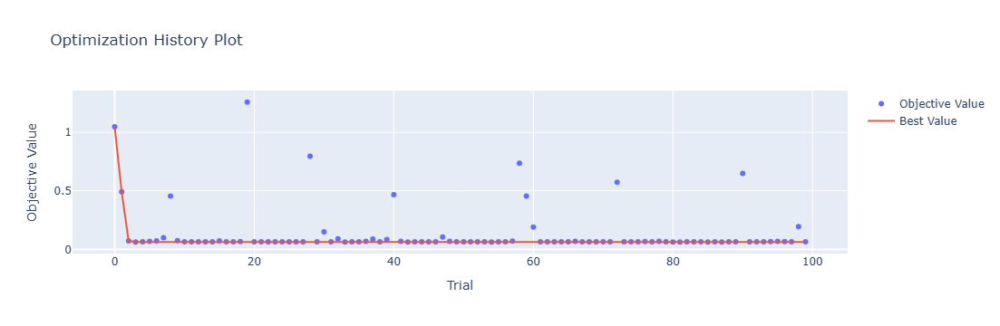

In [4]:
optuna.visualization.plot_optimization_history(study)

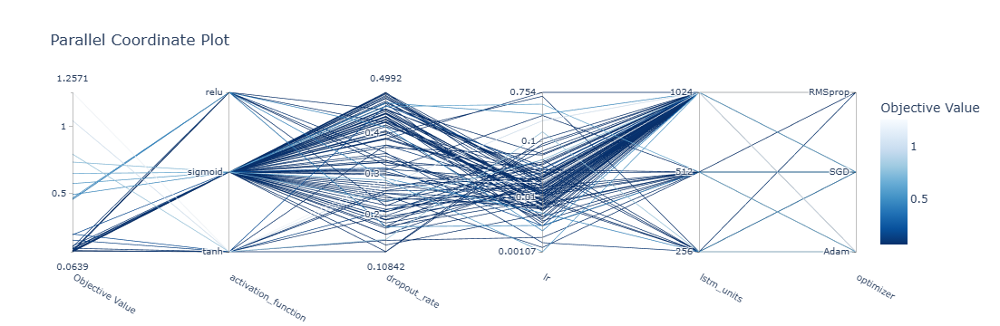

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

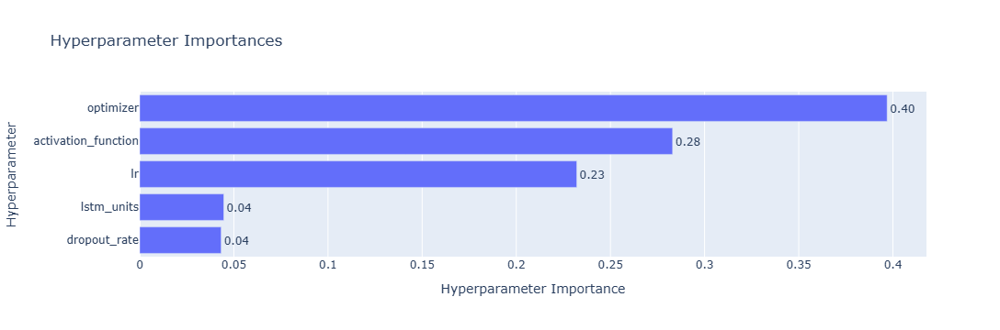

In [6]:
optuna.visualization.plot_param_importances(study)

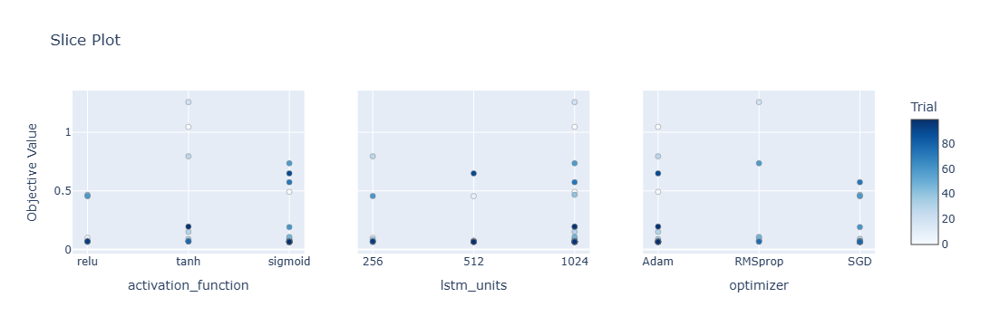

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

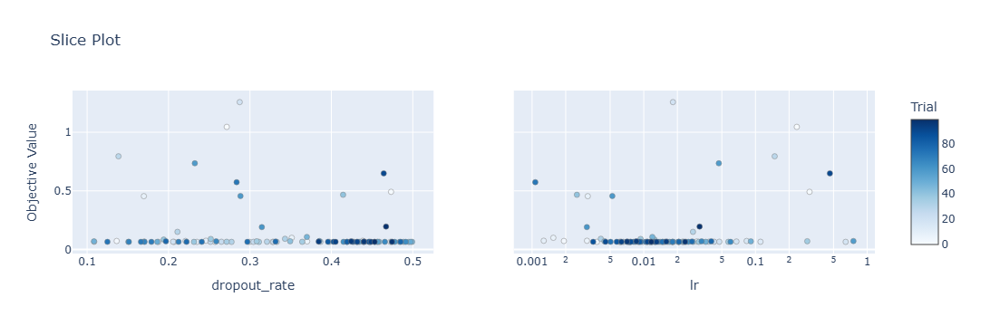

In [9]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 12s 95ms/step - loss: 0.1069 - accuracy: 0.2262 - mae: 0.0860 - rmse: 0.1069 - mape: 19.1437 - pearson: 0.6107 - val_loss: 0.0614 - val_accuracy: 0.7000 - val_mae: 0.0487 - val_rmse: 0.0614 - val_mape: 10.4798 - val_pearson: 0.7804
Epoch 2/100
84/84 [==============================] - 7s 79ms/step - loss: 0.0715 - accuracy: 0.4643 - mae: 0.0567 - rmse: 0.0715 - mape: 12.7554 - pearson: 0.7491 - val_loss: 0.0630 - val_accuracy: 0.7000 - val_mae: 0.0485 - val_rmse: 0.0630 - val_mape: 10.4904 - val_pearson: 0.7740
Epoch 3/100
84/84 [==============================] - 9s 105ms/step - loss: 0.0679 - accuracy: 0.4167 - mae: 0.0535 - rmse: 0.0679 - mape: 12.0362 - pearson: 0.7667 - val_loss: 0.0784 - val_accuracy: 0.7000 - val_mae: 0.0605 - val_rmse: 0.0784 - val_mape: 12.7960 - val_pearson: 0.6638
Epoch 4/100
84/84 [==============================] - 8s 90ms/step - loss: 0.0687 - accuracy: 0.4167 - mae: 0.0541 - rmse: 0.0687 - mape: 12.1215 -

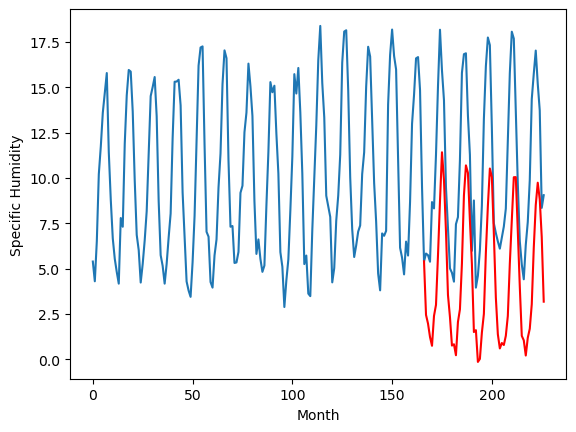

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.70		2.13		3.83
-1.37		1.66		3.03
-1.81		0.91		2.72
-1.08		0.43		1.51
2.80		2.08		-0.72
1.01		2.69		1.68
3.33		5.42		2.09
7.01		8.41		1.40
8.67		11.11		2.44
8.61		9.57		0.96
6.51		6.75		0.24
3.95		3.24		-0.71
0.62		2.02		1.40
-2.90		0.44		3.34
-2.55		0.51		3.06
-1.84		-0.09		1.75
0.37		1.74		1.37
0.59		2.45		1.86
3.08		4.98		1.90
7.83		8.72		0.89
8.63		10.38		1.75
8.79		9.98		1.19
6.63		7.35		0.72
3.55		4.93		1.38
-2.11		1.19		3.30
1.53		1.29		-0.24
-3.23		-0.46		2.77
-2.01		-0.29		1.72
-0.10		1.16		1.26
1.20		2.19		0.99
5.44		5.57		0.13
8.05		8.14		0.09
8.95		10.21		1.26
8.38		9.74		1.36
5.32		6.61		1.29
0.18		3.09		2.91
-0.02		1.07		1.09
-1.22		0.28		1.50
-1.13		0.58		1.71
0.56		0.47		-0.09
0.94		0.98		0.04
1.73		2.08		0.35
3.92		4.96		1.04
7.25		7.36		0.11
8.92		9.73		0.81
9.70		9.74		0.04
5.68		6.77		1.09
0.98		3.70		2.72
-1.20		0.98		2.18
-2.64		0.73		3.37
-3.42		-0.11		3.31
-2.20		0.8

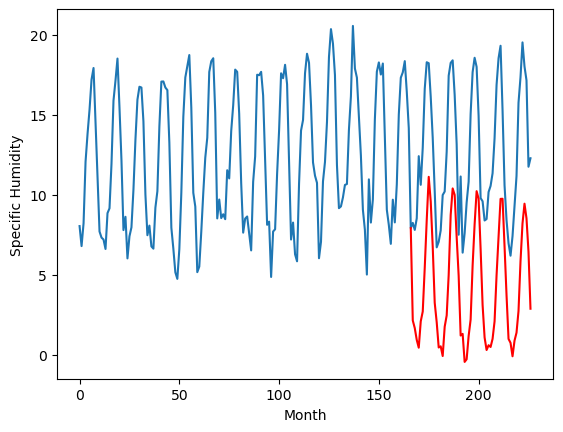

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		2.02		3.38
-1.11		1.55		2.66
-1.28		0.80		2.08
-0.73		0.32		1.05
1.87		1.97		0.10
0.62		2.58		1.96
3.48		5.31		1.83
7.39		8.30		0.91
9.79		11.00		1.21
9.88		9.46		-0.42
6.79		6.64		-0.15
4.04		3.13		-0.91
0.71		1.91		1.20
-2.45		0.33		2.78
-2.07		0.40		2.47
-1.92		-0.20		1.72
-0.07		1.63		1.70
0.17		2.34		2.17
2.93		4.87		1.94
7.55		8.61		1.06
9.46		10.27		0.81
9.66		9.87		0.21
6.66		7.24		0.58
3.94		4.82		0.88
-1.93		1.08		3.01
0.47		1.18		0.71
-2.94		-0.57		2.37
-1.73		-0.40		1.33
-1.02		1.05		2.07
0.43		2.08		1.65
4.57		5.46		0.89
7.35		8.03		0.68
9.55		10.10		0.55
8.85		9.63		0.78
5.12		6.50		1.38
0.12		2.98		2.86
-0.20		0.96		1.16
-1.53		0.17		1.70
-1.16		0.47		1.63
-0.05		0.36		0.41
-0.69		0.87		1.56
0.75		1.97		1.22
3.53		4.85		1.32
6.11		7.25		1.14
8.97		9.62		0.65
9.06		9.63		0.57
5.48		6.66		1.18
1.57		3.59		2.02
-0.96		0.87		1.83
-1.77		0.62		2.39
-2.57		-0.22		2.35
-1.93		0

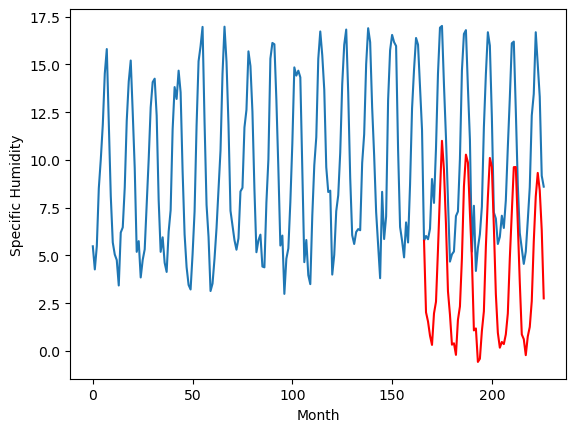

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		1.72		3.54
-1.28		1.25		2.53
-1.04		0.50		1.54
-0.90		0.02		0.92
3.41		1.67		-1.74
2.26		2.28		0.02
4.41		5.01		0.60
6.90		8.00		1.10
9.65		10.70		1.05
8.40		9.16		0.76
7.05		6.34		-0.71
3.24		2.83		-0.41
0.19		1.61		1.42
-2.88		0.03		2.91
-2.81		0.10		2.91
-2.90		-0.50		2.40
0.55		1.33		0.78
1.12		2.04		0.92
4.63		4.57		-0.06
8.53		8.31		-0.22
9.37		9.97		0.60
8.99		9.57		0.58
6.68		6.94		0.26
4.25		4.52		0.27
-1.96		0.78		2.74
1.09		0.88		-0.21
-4.03		-0.87		3.16
-2.82		-0.70		2.12
-1.73		0.75		2.48
1.19		1.78		0.59
5.43		5.16		-0.27
7.44		7.73		0.29
8.65		9.80		1.15
7.93		9.33		1.40
4.55		6.20		1.65
-0.55		2.68		3.23
-1.07		0.66		1.73
-1.57		-0.13		1.44
-1.38		0.17		1.55
-0.71		0.06		0.77
0.37		0.57		0.20
0.77		1.67		0.90
3.62		4.55		0.93
7.77		6.95		-0.82
8.80		9.32		0.52
8.55		9.33		0.78
6.37		6.36		-0.01
1.80		3.29		1.49
-1.19		0.57		1.76
-2.59		0.32		2.91
-3.51		-0.52		2.99
-1.7

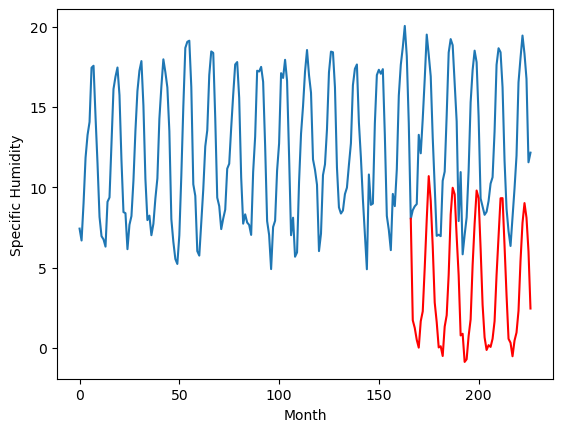

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		2.97		0.72
1.00		2.50		1.50
1.79		1.75		-0.04
1.18		1.27		0.09
5.63		2.92		-2.71
5.35		3.53		-1.82
7.93		6.26		-1.67
10.29		9.25		-1.04
13.15		11.95		-1.20
10.88		10.41		-0.47
9.57		7.59		-1.98
5.29		4.08		-1.21
3.44		2.86		-0.58
0.66		1.28		0.62
0.59		1.35		0.76
0.19		0.75		0.56
3.03		2.58		-0.45
4.43		3.29		-1.14
8.44		5.82		-2.62
12.13		9.56		-2.57
12.84		11.22		-1.62
12.76		10.82		-1.94
8.53		8.19		-0.34
6.44		5.77		-0.67
2.22		2.03		-0.19
4.98		2.13		-2.85
-0.52		0.38		0.90
-0.26		0.55		0.81
1.29		2.00		0.71
5.21		3.03		-2.18
8.91		6.41		-2.50
9.88		8.98		-0.90
9.64		11.05		1.41
10.73		10.58		-0.15
7.90		7.45		-0.45
3.10		3.93		0.83
3.09		1.91		-1.18
2.01		1.12		-0.89
1.25		1.42		0.17
1.59		1.31		-0.28
3.78		1.82		-1.96
4.54		2.92		-1.62
8.48		5.80		-2.68
12.60		8.20		-4.40
11.18		10.57		-0.61
9.36		10.58		1.22
9.32		7.61		-1.71
5.57		4.54		-1.03
2.77		1.82		-0.95
0.91		1.57		0.66


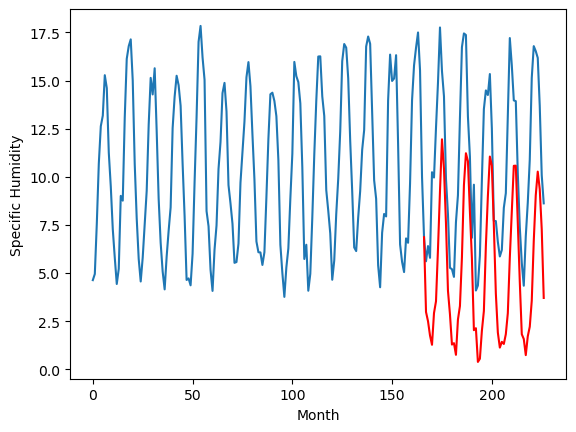

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.59		5.61		3.02
2.55		5.14		2.59
2.07		4.39		2.32
1.96		3.91		1.95
3.72		5.56		1.84
4.06		6.17		2.11
7.19		8.90		1.71
10.92		11.89		0.97
14.40		14.59		0.19
14.43		13.05		-1.38
11.53		10.23		-1.30
7.83		6.72		-1.11
4.88		5.50		0.62
1.12		3.92		2.80
0.51		3.99		3.48
1.10		3.39		2.29
2.67		5.22		2.55
3.68		5.93		2.25
6.18		8.46		2.28
11.44		12.20		0.76
12.56		13.86		1.30
13.72		13.46		-0.26
9.63		10.83		1.20
7.31		8.41		1.10
2.05		4.67		2.62
3.47		4.77		1.30
0.36		3.02		2.66
1.74		3.19		1.45
3.07		4.64		1.57
4.20		5.67		1.47
8.98		9.05		0.07
10.07		11.62		1.55
14.40		13.69		-0.71
12.61		13.22		0.61
9.91		10.09		0.18
5.27		6.57		1.30
4.61		4.55		-0.06
1.26		3.76		2.50
2.01		4.06		2.05
2.94		3.95		1.01
2.72		4.46		1.74
5.40		5.56		0.16
6.16		8.44		2.28
10.06		10.84		0.78
14.41		13.21		-1.20
13.52		13.22		-0.30
10.40		10.25		-0.15
6.00		7.18		1.18
2.98		4.46		1.48
2.16		4.21		2.05
1.37		3.37		2.00

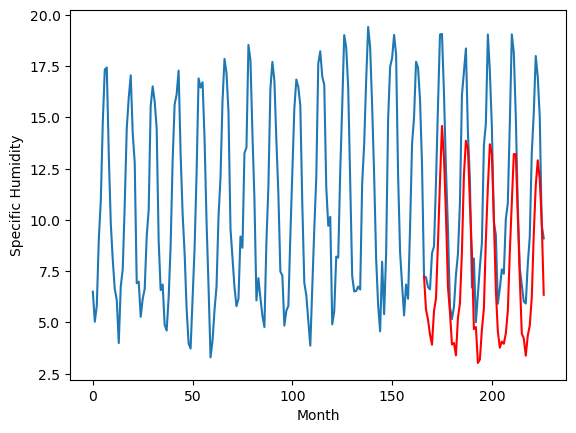

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.36		3.06		2.70
0.48		2.59		2.11
0.40		1.84		1.44
0.76		1.36		0.60
2.39		3.01		0.62
2.17		3.62		1.45
5.27		6.35		1.08
8.99		9.34		0.35
11.78		12.04		0.26
11.72		10.50		-1.22
8.19		7.68		-0.51
5.47		4.17		-1.30
2.62		2.95		0.33
-0.25		1.37		1.62
-0.40		1.44		1.84
-0.35		0.84		1.19
1.24		2.67		1.43
1.84		3.38		1.54
4.84		5.91		1.07
9.22		9.65		0.43
10.66		11.31		0.65
11.19		10.91		-0.28
7.87		8.28		0.41
5.76		5.86		0.10
0.01		2.12		2.11
1.85		2.22		0.37
-0.93		0.47		1.40
0.35		0.64		0.29
1.36		2.09		0.73
2.36		3.12		0.76
6.72		6.50		-0.22
8.60		9.07		0.47
12.22		11.14		-1.08
10.87		10.67		-0.20
7.43		7.54		0.11
2.87		4.02		1.15
2.27		2.00		-0.27
0.09		1.21		1.12
0.95		1.51		0.56
1.63		1.40		-0.23
1.22		1.91		0.69
3.43		3.01		-0.42
5.02		5.89		0.87
7.75		8.29		0.54
11.49		10.66		-0.83
11.12		10.67		-0.45
8.18		7.70		-0.48
3.92		4.63		0.71
0.59		1.91		1.32
0.52		1.66		1.14
-0.15		0.82		0.97
0.01

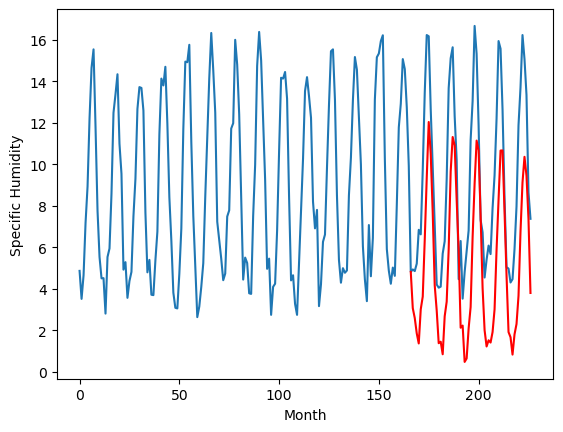

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.52		5.01		2.49
2.77		4.54		1.77
2.80		3.79		0.99
3.02		3.31		0.29
4.32		4.96		0.64
4.26		5.57		1.31
6.25		8.30		2.05
10.92		11.29		0.37
13.73		13.99		0.26
13.97		12.45		-1.52
10.07		9.63		-0.44
7.36		6.12		-1.24
4.82		4.90		0.08
1.95		3.32		1.37
1.64		3.39		1.75
1.67		2.79		1.12
3.29		4.62		1.33
3.99		5.33		1.34
7.01		7.86		0.85
11.28		11.60		0.32
12.78		13.26		0.48
13.06		12.86		-0.20
9.57		10.23		0.66
7.69		7.81		0.12
1.90		4.07		2.17
3.67		4.17		0.50
1.16		2.42		1.26
2.39		2.59		0.20
3.38		4.04		0.66
4.28		5.07		0.79
8.57		8.45		-0.12
10.02		11.02		1.00
13.39		13.09		-0.30
12.32		12.62		0.30
9.53		9.49		-0.04
5.11		5.97		0.86
4.41		3.95		-0.46
2.07		3.16		1.09
3.00		3.46		0.46
3.36		3.35		-0.01
3.28		3.86		0.58
5.56		4.96		-0.60
6.88		7.84		0.96
9.50		10.24		0.74
13.85		12.61		-1.24
12.79		12.62		-0.17
9.99		9.65		-0.34
6.24		6.58		0.34
2.72		3.86		1.14
2.92		3.61		0.69
2.23		2.77		0.54


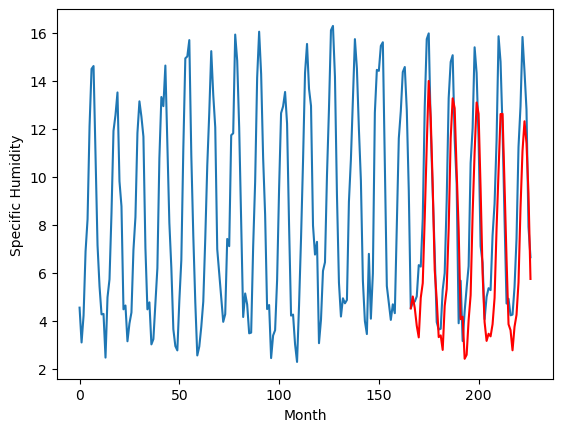

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		2.21		0.86
1.44		1.74		0.30
1.04		0.99		-0.05
1.03		0.51		-0.52
3.29		2.16		-1.13
3.53		2.77		-0.76
6.75		5.50		-1.25
10.40		8.49		-1.91
13.49		11.19		-2.30
11.46		9.65		-1.81
8.74		6.83		-1.91
4.29		3.32		-0.97
2.53		2.10		-0.43
0.62		0.52		-0.10
0.39		0.59		0.20
-0.29		-0.01		0.28
2.77		1.82		-0.95
3.50		2.53		-0.97
6.41		5.06		-1.35
11.39		8.80		-2.59
12.89		10.46		-2.43
13.08		10.06		-3.02
9.27		7.43		-1.84
6.85		5.01		-1.84
1.56		1.27		-0.29
3.15		1.37		-1.78
-0.13		-0.38		-0.25
0.46		-0.21		-0.67
2.14		1.24		-0.90
3.72		2.27		-1.45
7.91		5.65		-2.26
10.09		8.22		-1.87
13.75		10.29		-3.46
12.78		9.82		-2.96
8.33		6.69		-1.64
3.10		3.17		0.07
2.10		1.15		-0.95
1.17		0.36		-0.81
1.77		0.66		-1.11
1.84		0.55		-1.29
2.28		1.06		-1.22
3.50		2.16		-1.34
6.99		5.04		-1.95
9.27		7.44		-1.83
12.82		9.81		-3.01
12.82		9.82		-3.00
8.75		6.85		-1.90
4.69		3.78		-0.91
2.03		1.06		-0.97
1.42		0.

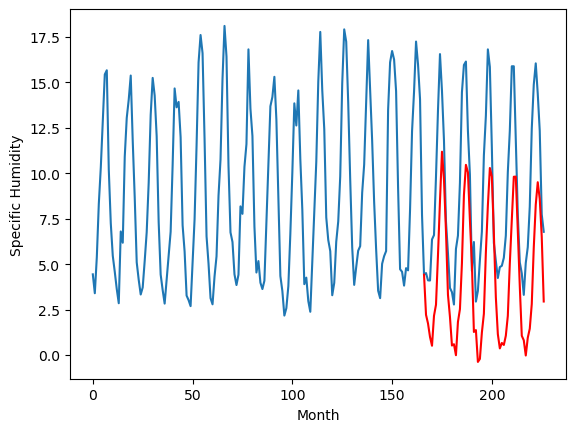

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.84		4.08		1.24
3.25		3.61		0.36
2.75		2.86		0.11
2.43		2.38		-0.05
4.39		4.03		-0.36
4.45		4.64		0.19
7.59		7.37		-0.22
10.28		10.36		0.08
13.42		13.06		-0.36
12.20		11.52		-0.68
9.41		8.70		-0.71
6.07		5.19		-0.88
4.02		3.97		-0.05
2.36		2.39		0.03
2.03		2.46		0.43
1.58		1.86		0.28
3.38		3.69		0.31
4.70		4.40		-0.30
6.79		6.93		0.14
11.56		10.67		-0.89
12.49		12.33		-0.16
12.91		11.93		-0.98
9.74		9.30		-0.44
8.43		6.88		-1.55
2.91		3.14		0.23
3.75		3.24		-0.51
1.46		1.49		0.03
2.20		1.66		-0.54
3.48		3.11		-0.37
5.10		4.14		-0.96
9.71		7.52		-2.19
11.39		10.09		-1.30
14.97		12.16		-2.81
13.43		11.69		-1.74
10.37		8.56		-1.81
4.58		5.04		0.46
3.86		3.02		-0.84
2.93		2.23		-0.70
3.54		2.53		-1.01
3.31		2.42		-0.89
3.41		2.93		-0.48
5.14		4.03		-1.11
7.58		6.91		-0.67
10.20		9.31		-0.89
14.02		11.68		-2.34
12.72		11.69		-1.03
10.00		8.72		-1.28
6.76		5.65		-1.11
3.41		2.93		-0.48
3.60		2.68

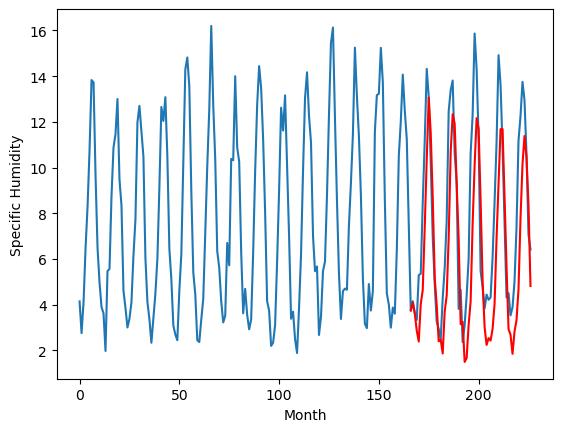

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.21		2.44		1.23
1.33		1.97		0.64
0.95		1.22		0.27
0.44		0.74		0.30
2.04		2.39		0.35
2.40		3.00		0.60
5.30		5.73		0.43
8.40		8.72		0.32
11.45		11.42		-0.03
9.88		9.88		0.00
7.22		7.06		-0.16
3.77		3.55		-0.22
2.36		2.33		-0.03
0.83		0.75		-0.08
0.45		0.82		0.37
-0.29		0.22		0.51
1.33		2.05		0.72
2.93		2.76		-0.17
4.45		5.29		0.84
9.58		9.03		-0.55
10.65		10.69		0.04
11.14		10.29		-0.85
7.52		7.66		0.14
6.53		5.24		-1.29
1.68		1.50		-0.18
1.68		1.60		-0.08
-0.39		-0.15		0.24
0.21		0.02		-0.19
1.46		1.47		0.01
2.40		2.50		0.10
6.12		5.88		-0.24
7.39		8.45		1.06
9.88		10.52		0.64
10.87		10.05		-0.82
8.27		6.92		-1.35
3.25		3.40		0.15
2.11		1.38		-0.73
0.94		0.59		-0.35
1.34		0.89		-0.45
0.78		0.78		0.00
1.24		1.29		0.05
2.88		2.39		-0.49
4.09		5.27		1.18
7.10		7.67		0.57
10.93		10.04		-0.89
10.18		10.05		-0.13
8.87		7.08		-1.79
5.11		4.01		-1.10
1.70		1.29		-0.41
2.23		1.04		-1.19
0.71		0.20		-

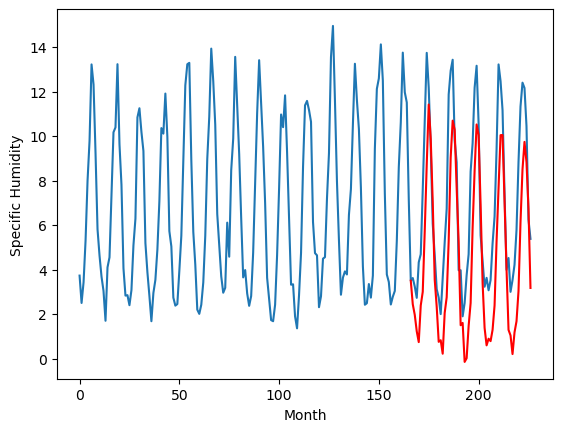

RangeIndex(start=1, stop=12, step=1)
[0.7500000000000009, -1.7000000000000002, -1.3600000000000003, -1.8200000000000012, 2.2500000000000004, 2.59, 0.3600000000000003, 2.5199999999999996, 1.3499999999999996, 2.84, 1.21]
[2.444235191345215, 2.1342351913452147, 2.0242351913452152, 1.7242351913452145, 2.9742351913452145, 5.614235191345214, 3.0642351913452153, 5.014235191345215, 2.2142351913452147, 4.084235191345215, 2.444235191345215]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.75   2.444235
1                 1   -1.70   2.134235
2                 2   -1.36   2.024235
3                 3   -1.82   1.724235
4                 4    2.25   2.974235
5                 5    2.59   5.614235
6                 6    0.36   3.064235
7                 7    2.52   5.014235
8                 8    1.35   2.214235
9                 9    2.84   4.084235
10               10    1.21   2.444235


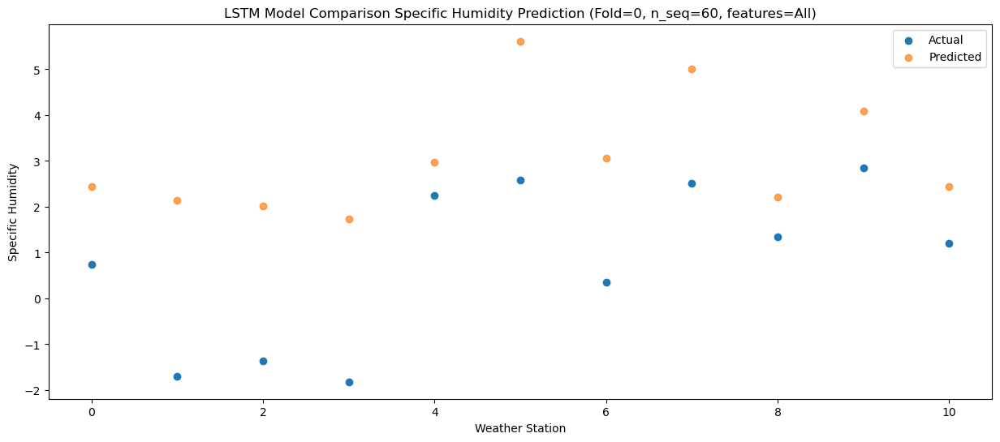

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18    1.96559
1                 1   -1.37    1.65559
2                 2   -1.11    1.54559
3                 3   -1.28    1.24559
4                 4    1.00    2.49559
5                 5    2.55    5.13559
6                 6    0.48    2.58559
7                 7    2.77    4.53559
8                 8    1.44    1.73559
9                 9    3.25    3.60559
10               10    1.33    1.96559


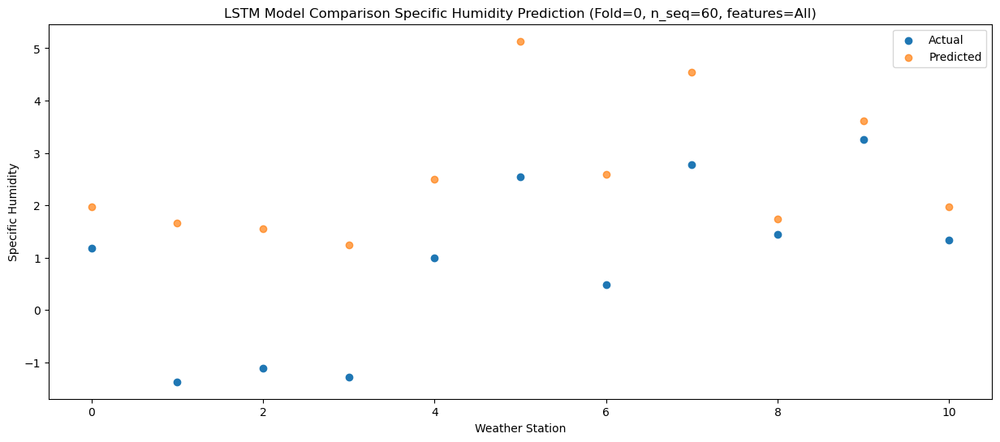

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.09   1.223891
1                 1   -1.81   0.913891
2                 2   -1.28   0.803891
3                 3   -1.04   0.503891
4                 4    1.79   1.753891
5                 5    2.07   4.393891
6                 6    0.40   1.843891
7                 7    2.80   3.793891
8                 8    1.04   0.993891
9                 9    2.75   2.863891
10               10    0.95   1.223891


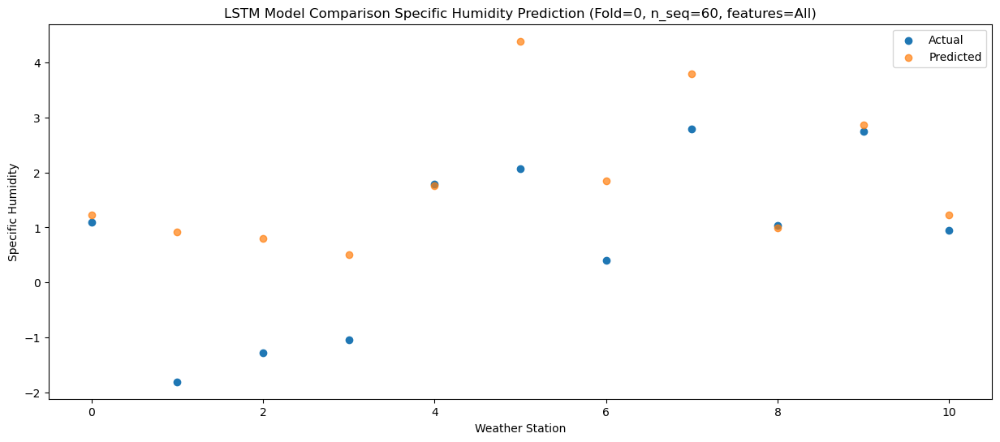

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.73   0.741401
1                 1   -1.08   0.431401
2                 2   -0.73   0.321401
3                 3   -0.90   0.021401
4                 4    1.18   1.271401
5                 5    1.96   3.911401
6                 6    0.76   1.361401
7                 7    3.02   3.311401
8                 8    1.03   0.511401
9                 9    2.43   2.381401
10               10    0.44   0.741401


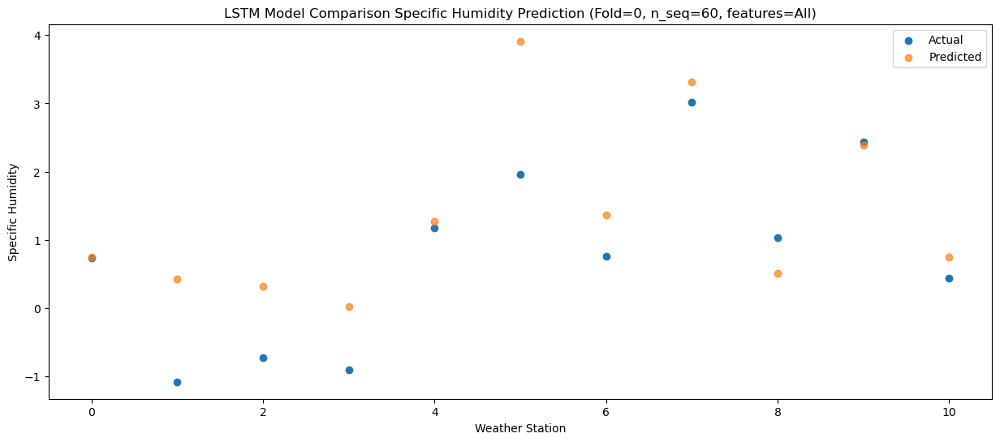

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.02   2.388711
1                 1    2.80   2.078711
2                 2    1.87   1.968711
3                 3    3.41   1.668711
4                 4    5.63   2.918711
5                 5    3.72   5.558711
6                 6    2.39   3.008711
7                 7    4.32   4.958711
8                 8    3.29   2.158711
9                 9    4.39   4.028711
10               10    2.04   2.388711


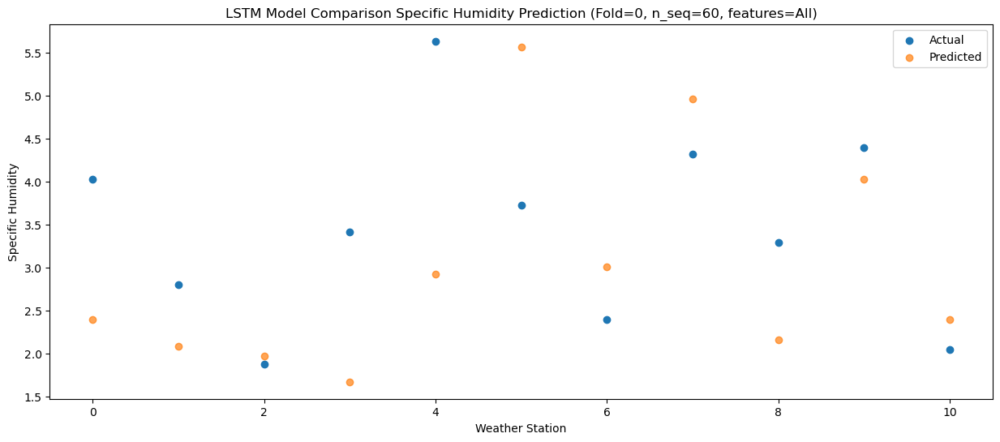

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.67   3.000024
1                 1    1.01   2.690024
2                 2    0.62   2.580024
3                 3    2.26   2.280024
4                 4    5.35   3.530024
5                 5    4.06   6.170024
6                 6    2.17   3.620024
7                 7    4.26   5.570024
8                 8    3.53   2.770024
9                 9    4.45   4.640024
10               10    2.40   3.000024


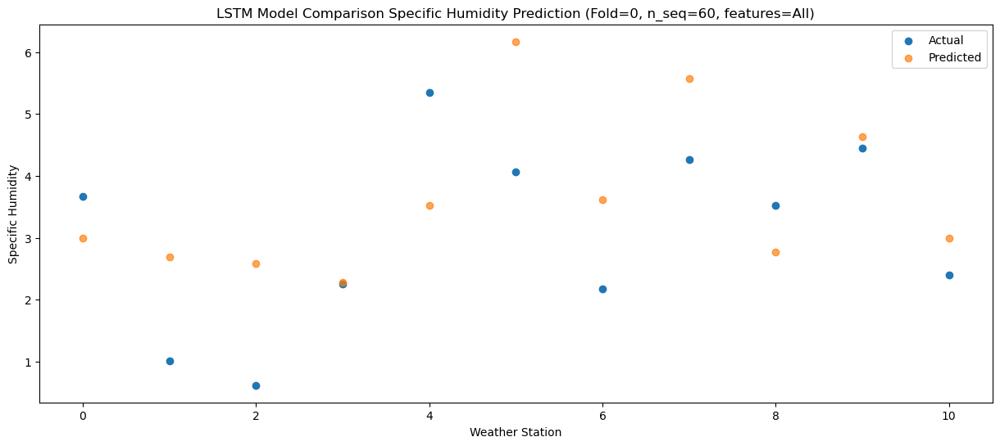

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.64   5.730708
1                 1    3.33   5.420708
2                 2    3.48   5.310708
3                 3    4.41   5.010708
4                 4    7.93   6.260708
5                 5    7.19   8.900708
6                 6    5.27   6.350708
7                 7    6.25   8.300708
8                 8    6.75   5.500708
9                 9    7.59   7.370708
10               10    5.30   5.730708


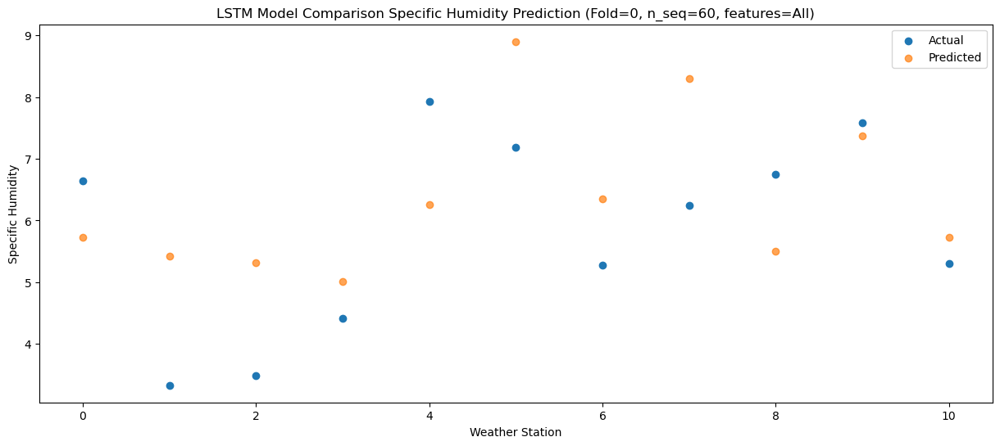

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.40    8.71654
1                 1    7.01    8.40654
2                 2    7.39    8.29654
3                 3    6.90    7.99654
4                 4   10.29    9.24654
5                 5   10.92   11.88654
6                 6    8.99    9.33654
7                 7   10.92   11.28654
8                 8   10.40    8.48654
9                 9   10.28   10.35654
10               10    8.40    8.71654


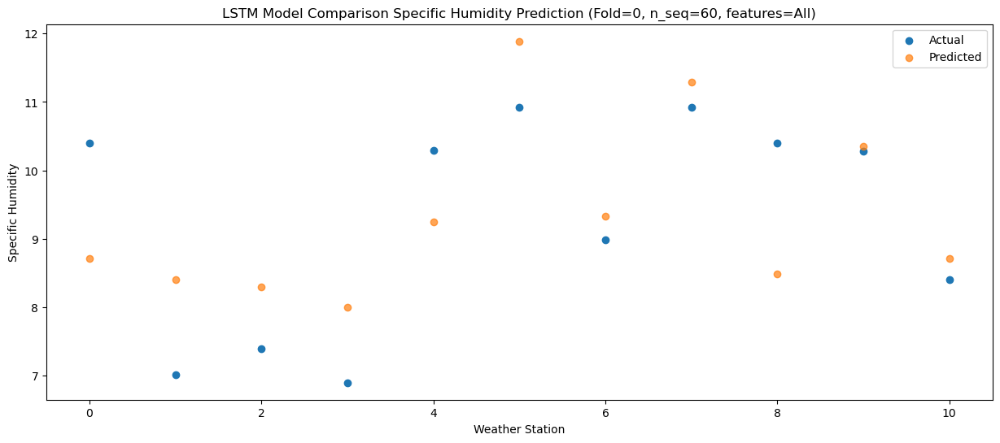

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.53  11.418135
1                 1    8.67  11.108135
2                 2    9.79  10.998135
3                 3    9.65  10.698135
4                 4   13.15  11.948135
5                 5   14.40  14.588135
6                 6   11.78  12.038135
7                 7   13.73  13.988135
8                 8   13.49  11.188135
9                 9   13.42  13.058135
10               10   11.45  11.418135


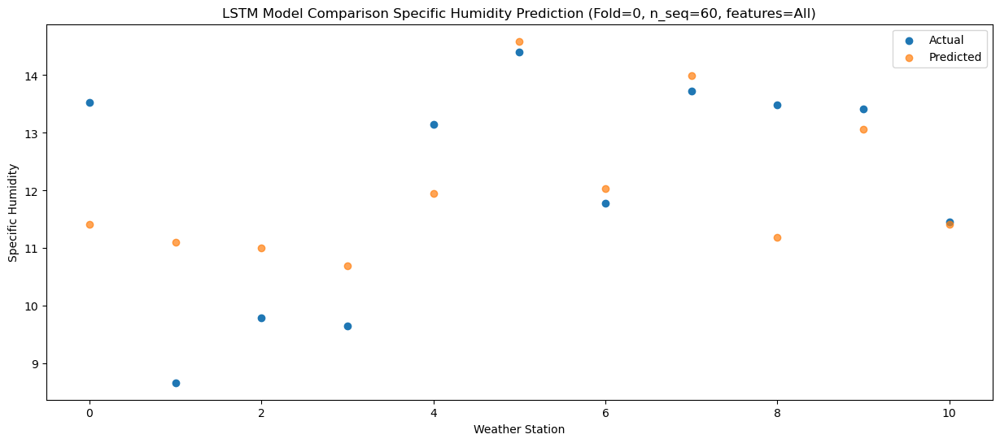

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.28   9.882625
1                 1    8.61   9.572625
2                 2    9.88   9.462625
3                 3    8.40   9.162625
4                 4   10.88  10.412625
5                 5   14.43  13.052625
6                 6   11.72  10.502625
7                 7   13.97  12.452625
8                 8   11.46   9.652625
9                 9   12.20  11.522625
10               10    9.88   9.882625


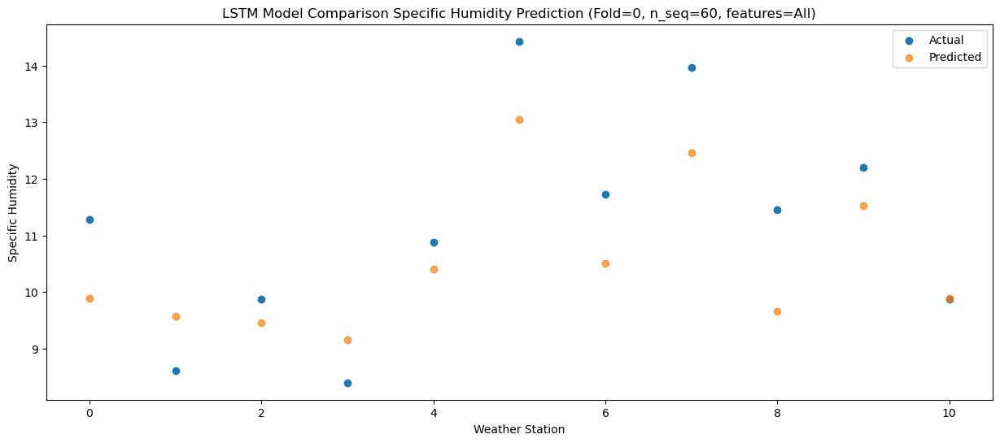

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.64   7.055329
1                 1    6.51   6.745329
2                 2    6.79   6.635329
3                 3    7.05   6.335329
4                 4    9.57   7.585329
5                 5   11.53  10.225329
6                 6    8.19   7.675329
7                 7   10.07   9.625329
8                 8    8.74   6.825329
9                 9    9.41   8.695329
10               10    7.22   7.055329


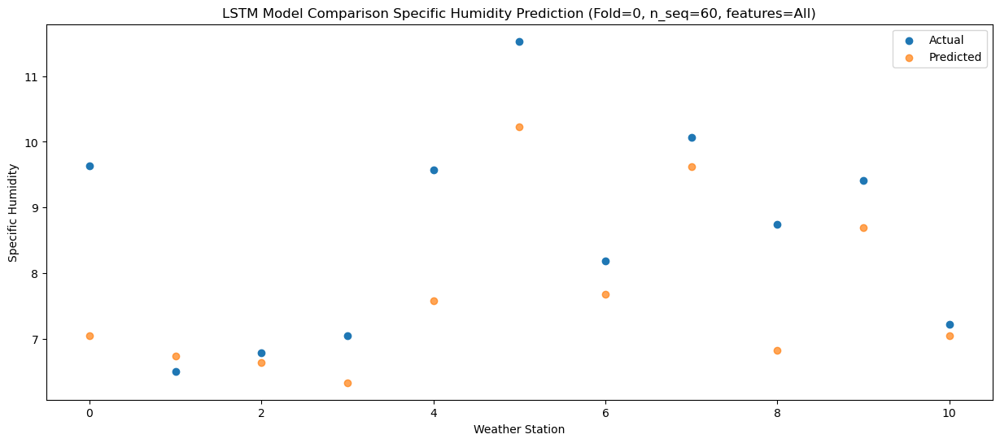

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.83   3.547957
1                 1    3.95   3.237957
2                 2    4.04   3.127957
3                 3    3.24   2.827957
4                 4    5.29   4.077957
5                 5    7.83   6.717957
6                 6    5.47   4.167957
7                 7    7.36   6.117957
8                 8    4.29   3.317957
9                 9    6.07   5.187957
10               10    3.77   3.547957


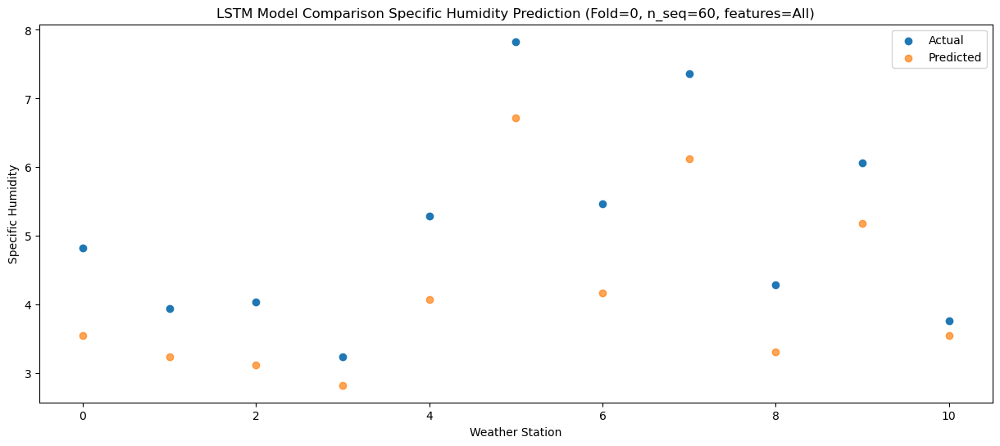

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.59   2.325517
1                 1    0.62   2.015517
2                 2    0.71   1.905517
3                 3    0.19   1.605517
4                 4    3.44   2.855517
5                 5    4.88   5.495517
6                 6    2.62   2.945517
7                 7    4.82   4.895517
8                 8    2.53   2.095517
9                 9    4.02   3.965517
10               10    2.36   2.325517


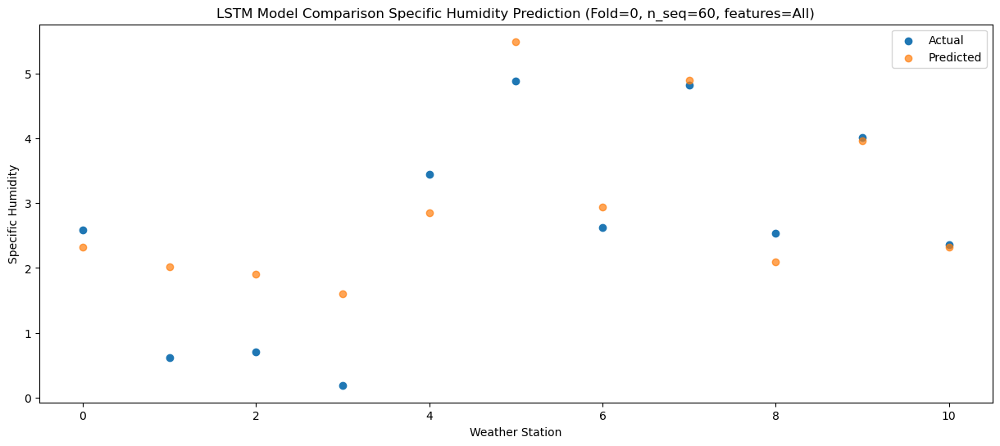

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.36    0.75303
1                 1   -2.90    0.44303
2                 2   -2.45    0.33303
3                 3   -2.88    0.03303
4                 4    0.66    1.28303
5                 5    1.12    3.92303
6                 6   -0.25    1.37303
7                 7    1.95    3.32303
8                 8    0.62    0.52303
9                 9    2.36    2.39303
10               10    0.83    0.75303


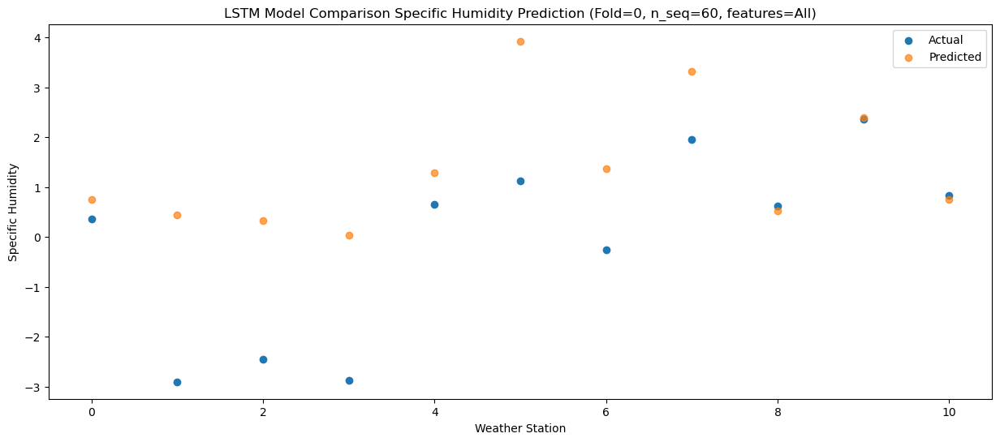

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.12   0.824478
1                 1   -2.55   0.514478
2                 2   -2.07   0.404478
3                 3   -2.81   0.104478
4                 4    0.59   1.354478
5                 5    0.51   3.994478
6                 6   -0.40   1.444478
7                 7    1.64   3.394478
8                 8    0.39   0.594478
9                 9    2.03   2.464478
10               10    0.45   0.824478


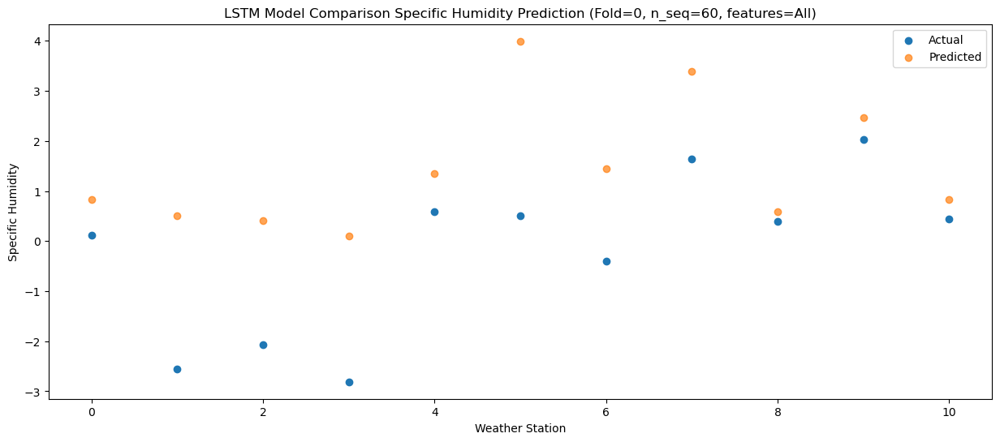

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.37   0.219757
1                 1   -1.84  -0.090243
2                 2   -1.92  -0.200243
3                 3   -2.90  -0.500243
4                 4    0.19   0.749757
5                 5    1.10   3.389757
6                 6   -0.35   0.839757
7                 7    1.67   2.789757
8                 8   -0.29  -0.010243
9                 9    1.58   1.859757
10               10   -0.29   0.219757


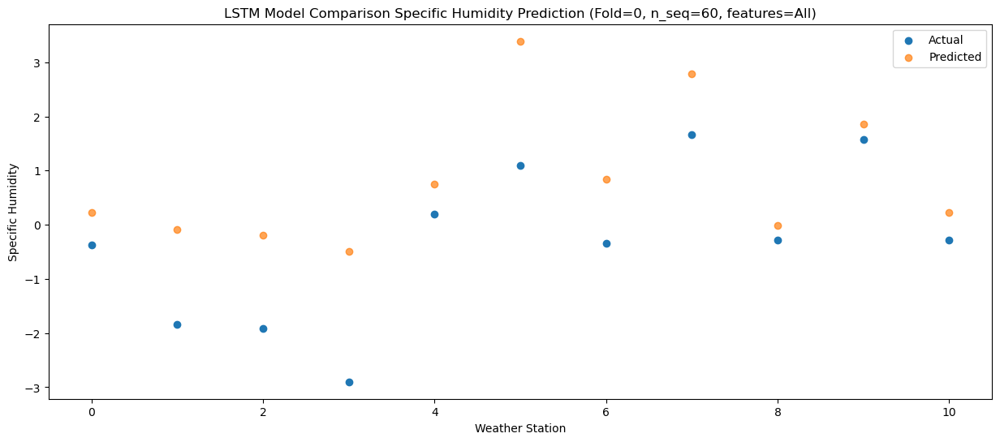

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.80   2.051995
1                 1    0.37   1.741995
2                 2   -0.07   1.631995
3                 3    0.55   1.331995
4                 4    3.03   2.581995
5                 5    2.67   5.221995
6                 6    1.24   2.671995
7                 7    3.29   4.621995
8                 8    2.77   1.821995
9                 9    3.38   3.691995
10               10    1.33   2.051995


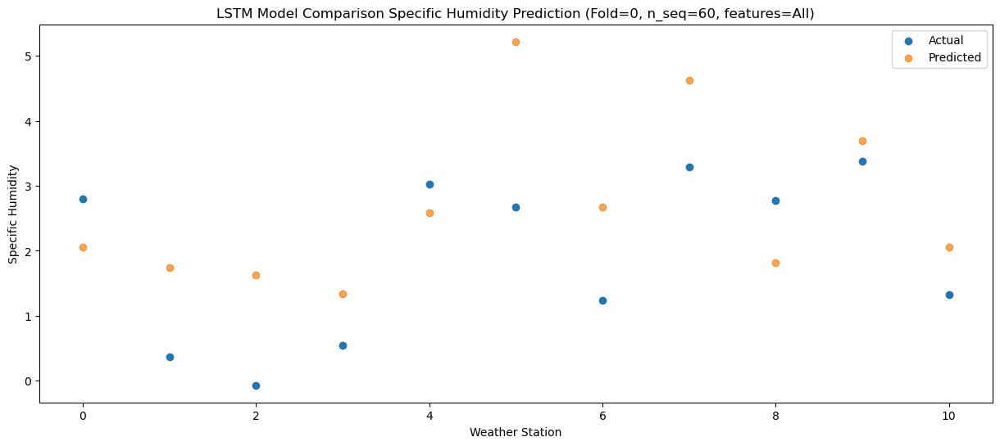

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.19   2.755129
1                 1    0.59   2.445129
2                 2    0.17   2.335129
3                 3    1.12   2.035129
4                 4    4.43   3.285129
5                 5    3.68   5.925129
6                 6    1.84   3.375129
7                 7    3.99   5.325129
8                 8    3.50   2.525129
9                 9    4.70   4.395129
10               10    2.93   2.755129


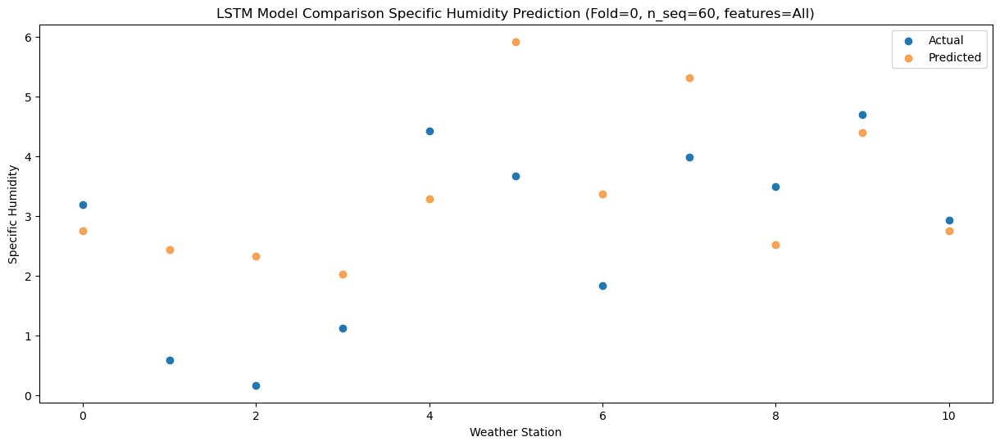

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    6.34   5.286385
1                 1    3.08   4.976385
2                 2    2.93   4.866385
3                 3    4.63   4.566385
4                 4    8.44   5.816385
5                 5    6.18   8.456385
6                 6    4.84   5.906385
7                 7    7.01   7.856385
8                 8    6.41   5.056385
9                 9    6.79   6.926385
10               10    4.45   5.286385


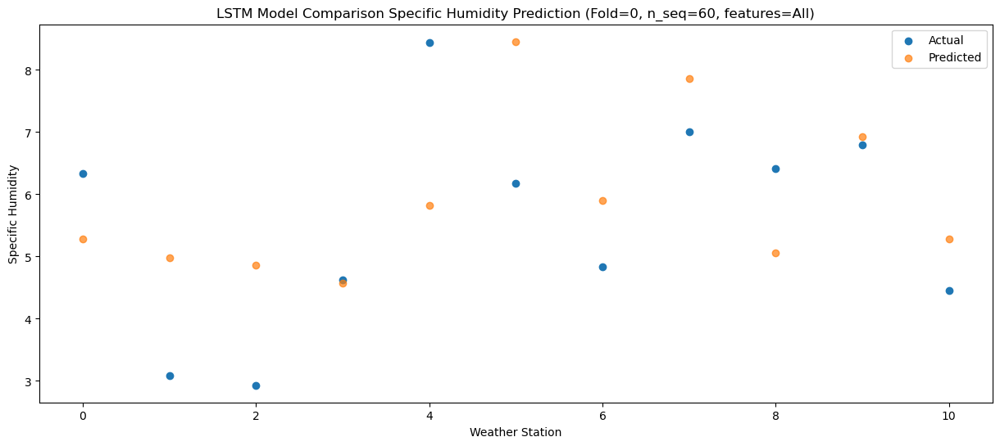

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.15    9.03075
1                 1    7.83    8.72075
2                 2    7.55    8.61075
3                 3    8.53    8.31075
4                 4   12.13    9.56075
5                 5   11.44   12.20075
6                 6    9.22    9.65075
7                 7   11.28   11.60075
8                 8   11.39    8.80075
9                 9   11.56   10.67075
10               10    9.58    9.03075


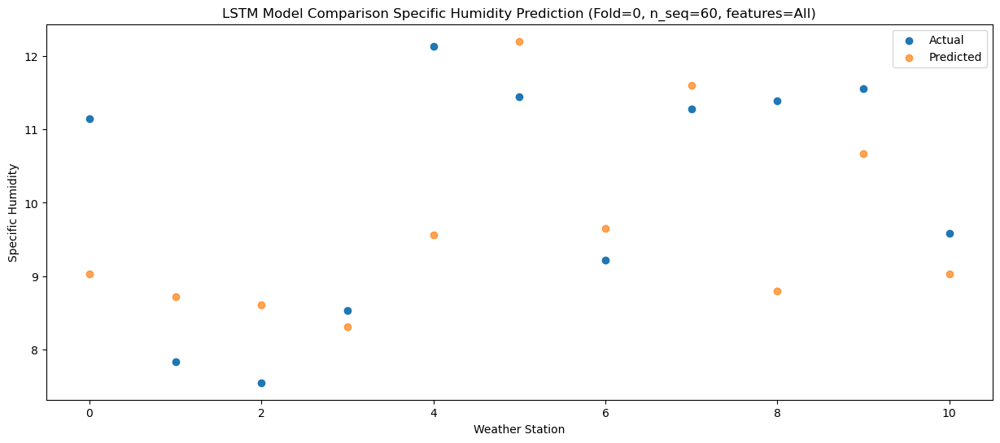

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.18  10.694103
1                 1    8.63  10.384103
2                 2    9.46  10.274103
3                 3    9.37   9.974103
4                 4   12.84  11.224103
5                 5   12.56  13.864103
6                 6   10.66  11.314103
7                 7   12.78  13.264103
8                 8   12.89  10.464103
9                 9   12.49  12.334103
10               10   10.65  10.694103


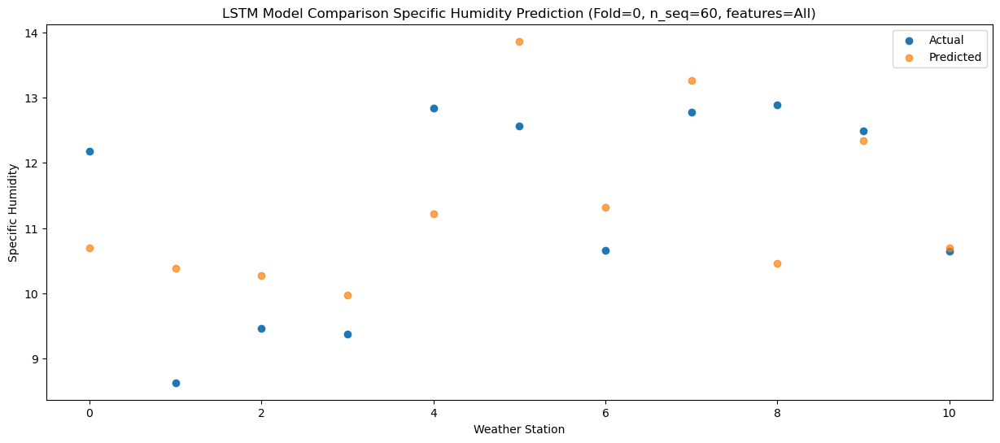

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.23  10.286045
1                 1    8.79   9.976045
2                 2    9.66   9.866045
3                 3    8.99   9.566045
4                 4   12.76  10.816045
5                 5   13.72  13.456045
6                 6   11.19  10.906045
7                 7   13.06  12.856045
8                 8   13.08  10.056045
9                 9   12.91  11.926045
10               10   11.14  10.286045


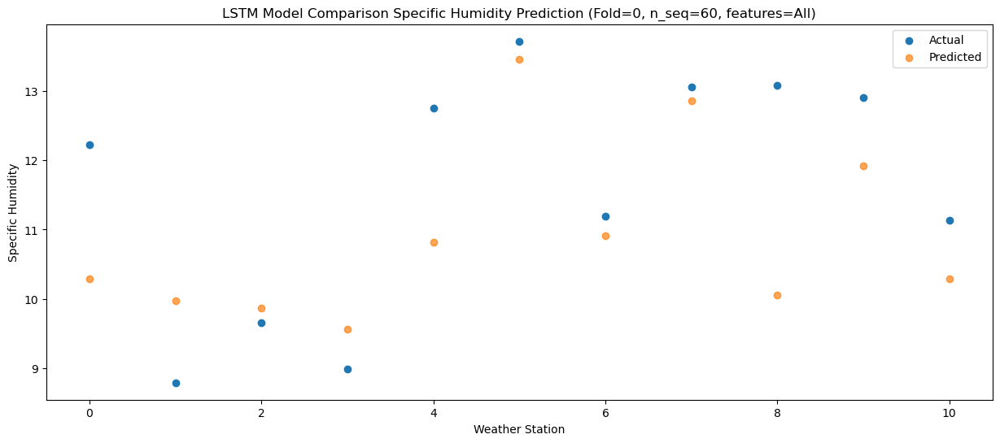

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.81   7.656532
1                 1    6.63   7.346532
2                 2    6.66   7.236532
3                 3    6.68   6.936532
4                 4    8.53   8.186532
5                 5    9.63  10.826532
6                 6    7.87   8.276532
7                 7    9.57  10.226532
8                 8    9.27   7.426532
9                 9    9.74   9.296532
10               10    7.52   7.656532


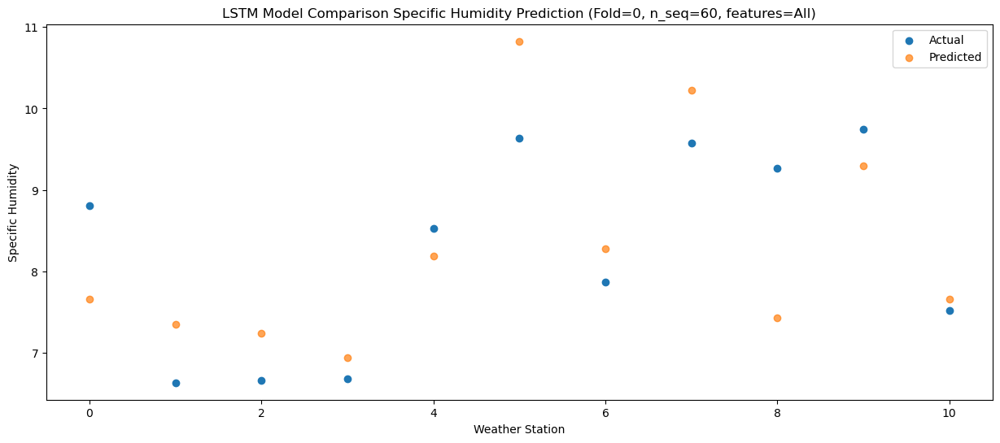

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.63   5.238404
1                 1    3.55   4.928404
2                 2    3.94   4.818404
3                 3    4.25   4.518404
4                 4    6.44   5.768404
5                 5    7.31   8.408404
6                 6    5.76   5.858404
7                 7    7.69   7.808404
8                 8    6.85   5.008404
9                 9    8.43   6.878404
10               10    6.53   5.238404


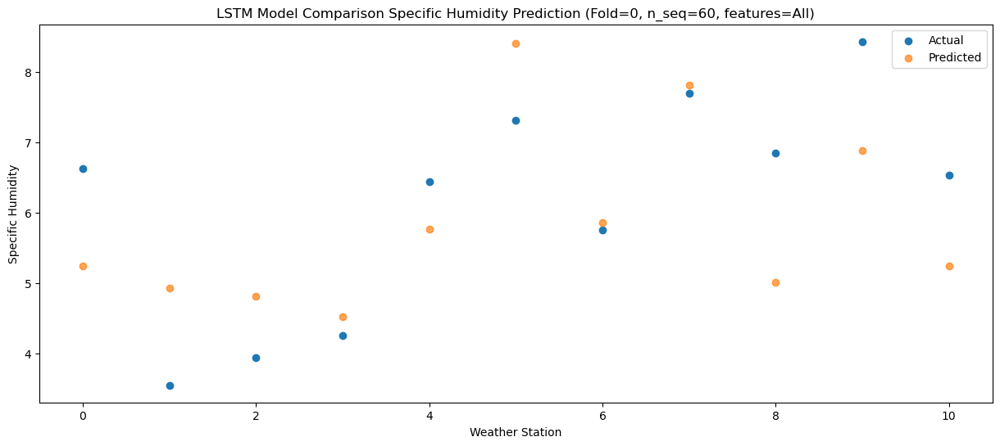

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.33   1.499112
1                 1   -2.11   1.189112
2                 2   -1.93   1.079112
3                 3   -1.96   0.779112
4                 4    2.22   2.029112
5                 5    2.05   4.669112
6                 6    0.01   2.119112
7                 7    1.90   4.069112
8                 8    1.56   1.269112
9                 9    2.91   3.139112
10               10    1.68   1.499112


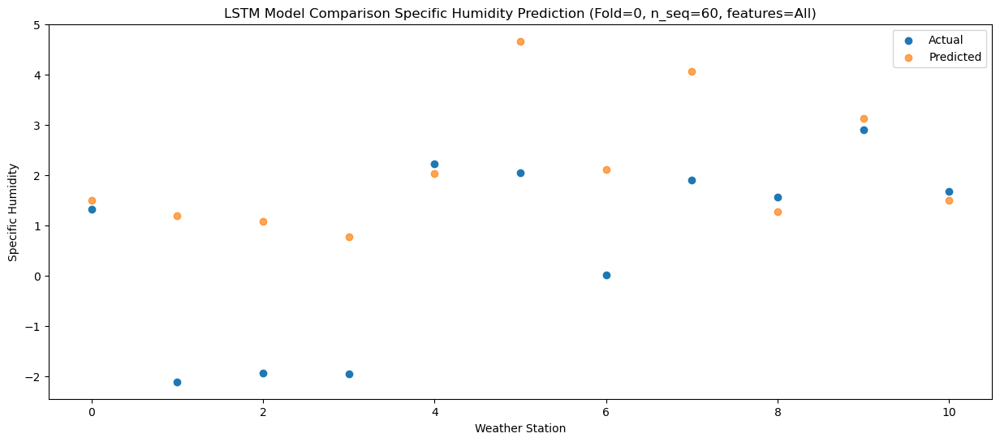

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.11   1.602937
1                 1    1.53   1.292937
2                 2    0.47   1.182937
3                 3    1.09   0.882937
4                 4    4.98   2.132937
5                 5    3.47   4.772937
6                 6    1.85   2.222937
7                 7    3.67   4.172937
8                 8    3.15   1.372937
9                 9    3.75   3.242937
10               10    1.68   1.602937


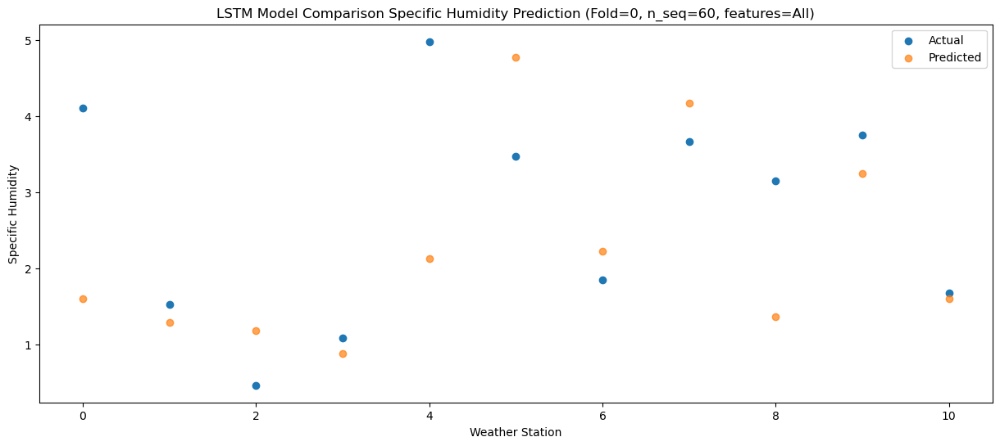

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.70   -0.14955
1                 1   -3.23   -0.45955
2                 2   -2.94   -0.56955
3                 3   -4.03   -0.86955
4                 4   -0.52    0.38045
5                 5    0.36    3.02045
6                 6   -0.93    0.47045
7                 7    1.16    2.42045
8                 8   -0.13   -0.37955
9                 9    1.46    1.49045
10               10   -0.39   -0.14955


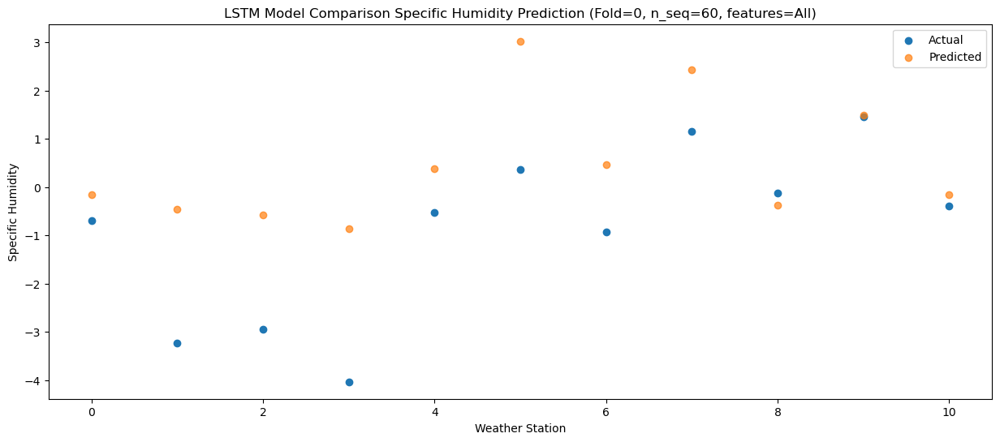

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.04   0.017335
1                 1   -2.01  -0.292665
2                 2   -1.73  -0.402665
3                 3   -2.82  -0.702665
4                 4   -0.26   0.547335
5                 5    1.74   3.187335
6                 6    0.35   0.637335
7                 7    2.39   2.587335
8                 8    0.46  -0.212665
9                 9    2.20   1.657335
10               10    0.21   0.017335


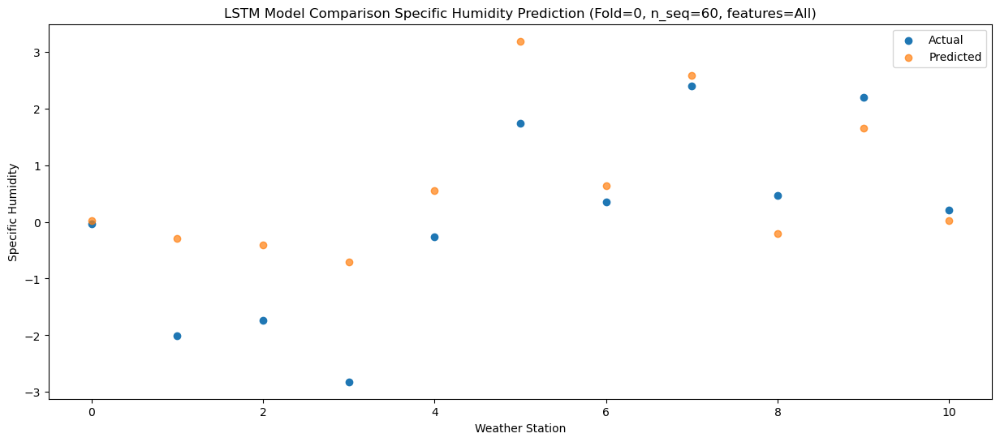

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.36   1.467098
1                 1   -0.10   1.157098
2                 2   -1.02   1.047098
3                 3   -1.73   0.747098
4                 4    1.29   1.997098
5                 5    3.07   4.637098
6                 6    1.36   2.087098
7                 7    3.38   4.037098
8                 8    2.14   1.237098
9                 9    3.48   3.107098
10               10    1.46   1.467098


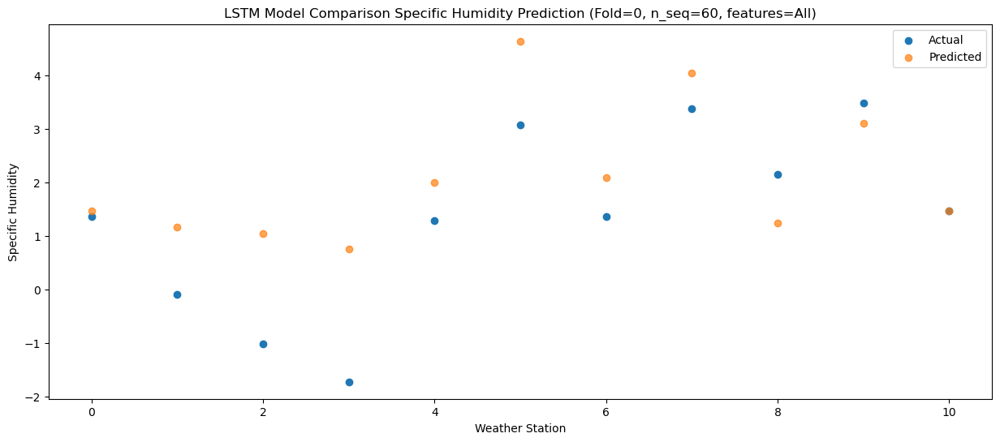

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.83   2.498872
1                 1    1.20   2.188872
2                 2    0.43   2.078872
3                 3    1.19   1.778872
4                 4    5.21   3.028872
5                 5    4.20   5.668872
6                 6    2.36   3.118872
7                 7    4.28   5.068872
8                 8    3.72   2.268872
9                 9    5.10   4.138872
10               10    2.40   2.498872


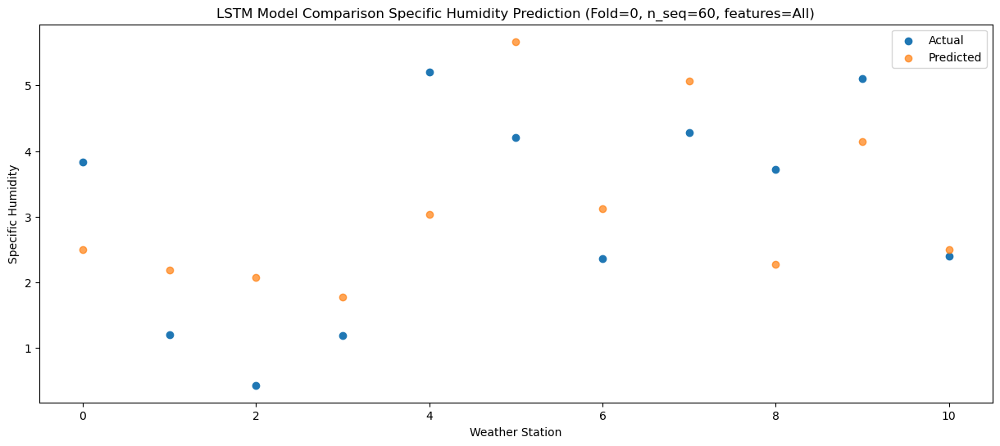

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    8.60   5.884911
1                 1    5.44   5.574911
2                 2    4.57   5.464911
3                 3    5.43   5.164911
4                 4    8.91   6.414911
5                 5    8.98   9.054911
6                 6    6.72   6.504911
7                 7    8.57   8.454911
8                 8    7.91   5.654911
9                 9    9.71   7.524911
10               10    6.12   5.884911


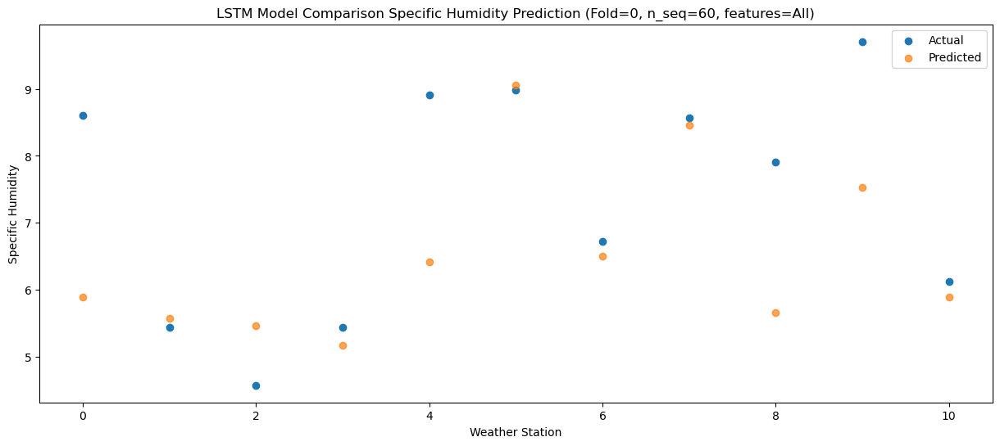

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   11.52   8.451685
1                 1    8.05   8.141685
2                 2    7.35   8.031685
3                 3    7.44   7.731685
4                 4    9.88   8.981685
5                 5   10.07  11.621685
6                 6    8.60   9.071685
7                 7   10.02  11.021685
8                 8   10.09   8.221685
9                 9   11.39  10.091685
10               10    7.39   8.451685


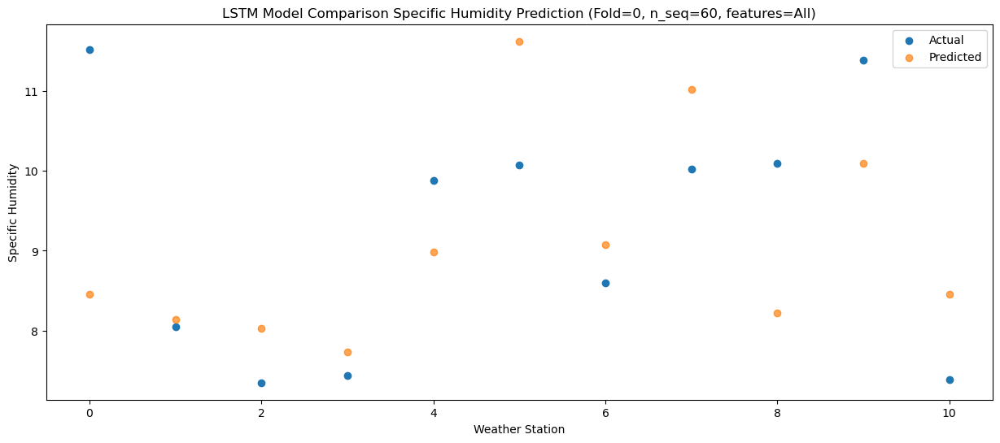

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.10  10.521578
1                 1    8.95  10.211578
2                 2    9.55  10.101578
3                 3    8.65   9.801578
4                 4    9.64  11.051578
5                 5   14.40  13.691578
6                 6   12.22  11.141578
7                 7   13.39  13.091578
8                 8   13.75  10.291578
9                 9   14.97  12.161578
10               10    9.88  10.521578


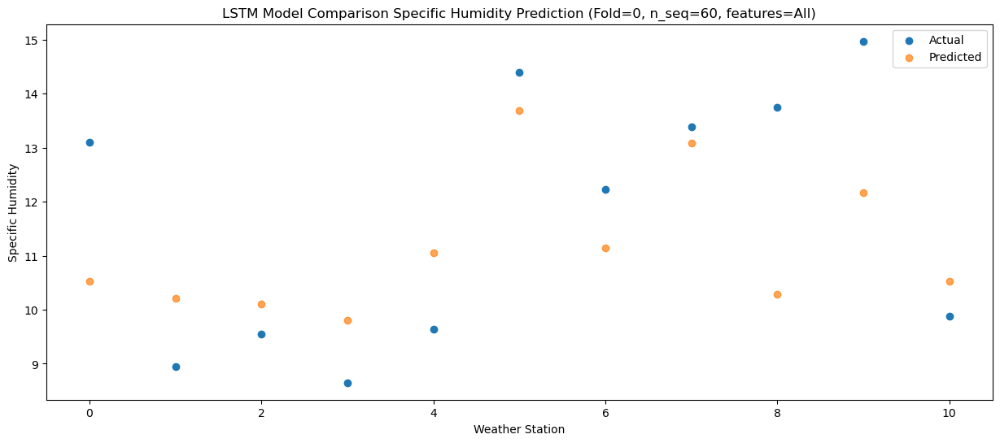

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.68  10.051339
1                 1    8.38   9.741339
2                 2    8.85   9.631339
3                 3    7.93   9.331339
4                 4   10.73  10.581339
5                 5   12.61  13.221339
6                 6   10.87  10.671339
7                 7   12.32  12.621339
8                 8   12.78   9.821339
9                 9   13.43  11.691339
10               10   10.87  10.051339


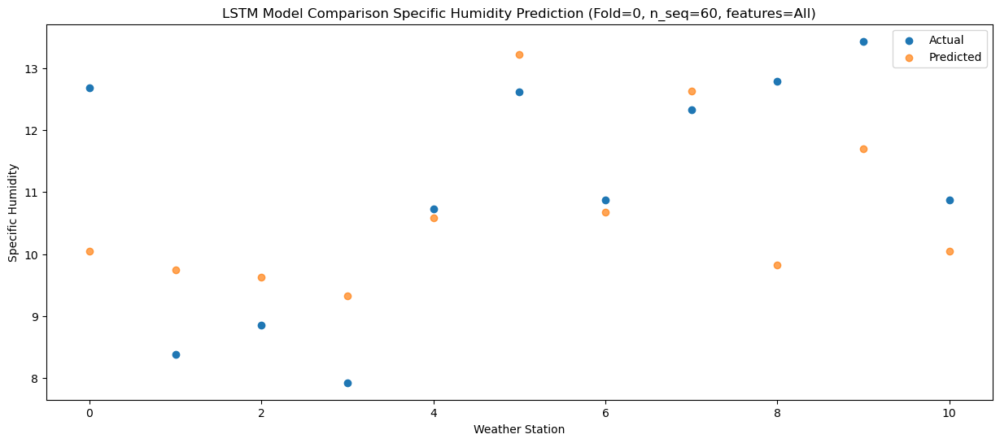

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    8.13   6.922005
1                 1    5.32   6.612005
2                 2    5.12   6.502005
3                 3    4.55   6.202005
4                 4    7.90   7.452005
5                 5    9.91  10.092005
6                 6    7.43   7.542005
7                 7    9.53   9.492005
8                 8    8.33   6.692005
9                 9   10.37   8.562005
10               10    8.27   6.922005


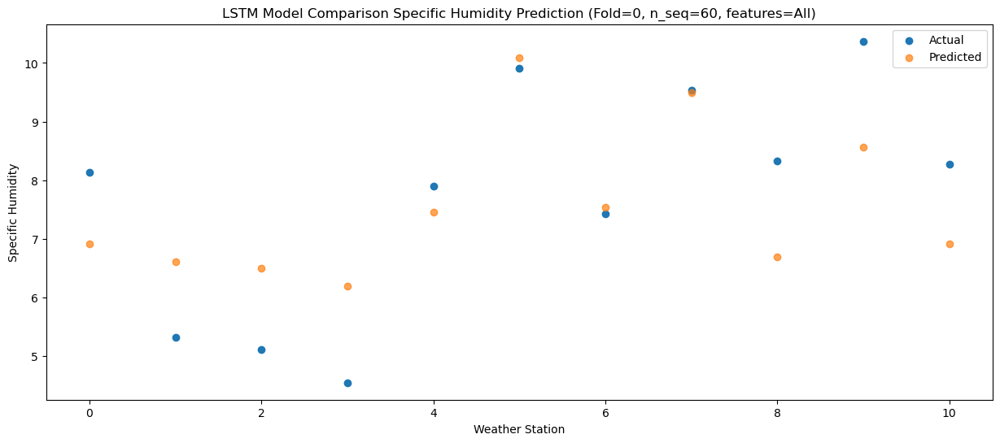

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.85   3.403094
1                 1    0.18   3.093094
2                 2    0.12   2.983094
3                 3   -0.55   2.683094
4                 4    3.10   3.933094
5                 5    5.27   6.573094
6                 6    2.87   4.023094
7                 7    5.11   5.973094
8                 8    3.10   3.173094
9                 9    4.58   5.043094
10               10    3.25   3.403094


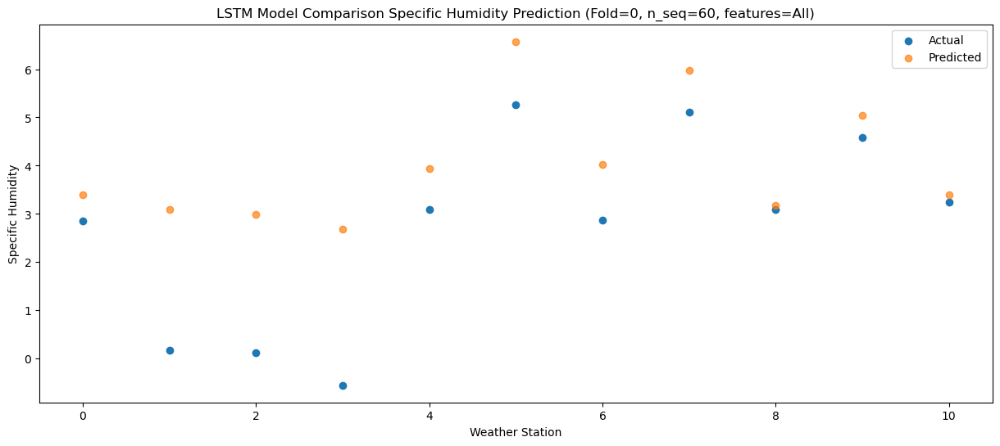

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.31   1.378316
1                 1   -0.02   1.068316
2                 2   -0.20   0.958316
3                 3   -1.07   0.658316
4                 4    3.09   1.908316
5                 5    4.61   4.548316
6                 6    2.27   1.998316
7                 7    4.41   3.948316
8                 8    2.10   1.148316
9                 9    3.86   3.018316
10               10    2.11   1.378316


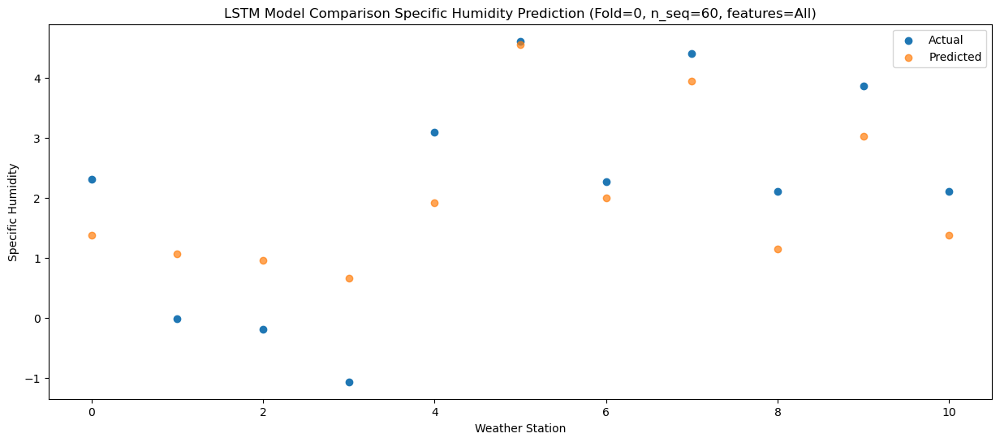

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.85   0.594836
1                 1   -1.22   0.284836
2                 2   -1.53   0.174836
3                 3   -1.57  -0.125164
4                 4    2.01   1.124836
5                 5    1.26   3.764836
6                 6    0.09   1.214836
7                 7    2.07   3.164836
8                 8    1.17   0.364836
9                 9    2.93   2.234836
10               10    0.94   0.594836


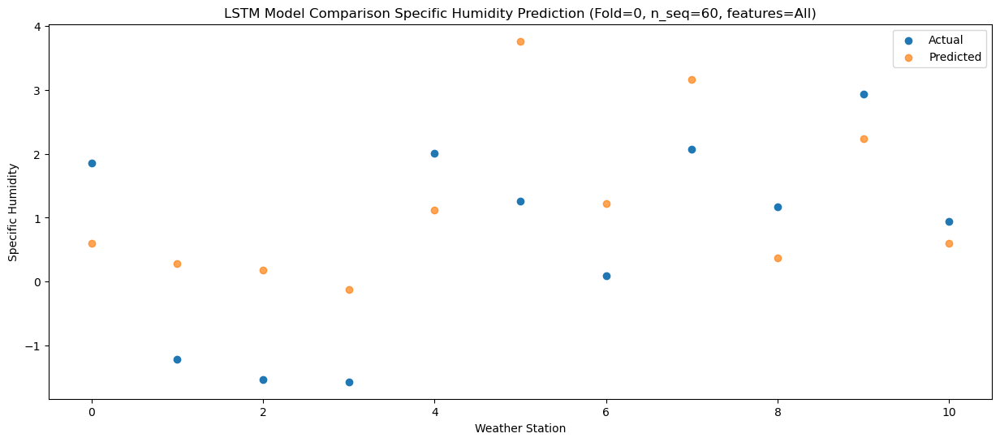

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.45   0.893143
1                 1   -1.13   0.583143
2                 2   -1.16   0.473143
3                 3   -1.38   0.173143
4                 4    1.25   1.423143
5                 5    2.01   4.063143
6                 6    0.95   1.513143
7                 7    3.00   3.463143
8                 8    1.77   0.663143
9                 9    3.54   2.533143
10               10    1.34   0.893143


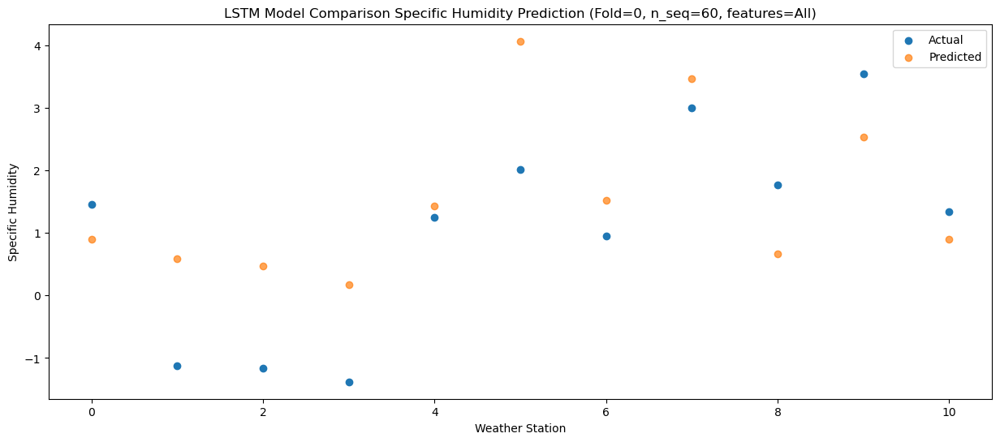

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.07   0.784329
1                 1    0.56   0.474329
2                 2   -0.05   0.364329
3                 3   -0.71   0.064329
4                 4    1.59   1.314329
5                 5    2.94   3.954329
6                 6    1.63   1.404329
7                 7    3.36   3.354329
8                 8    1.84   0.554329
9                 9    3.31   2.424329
10               10    0.78   0.784329


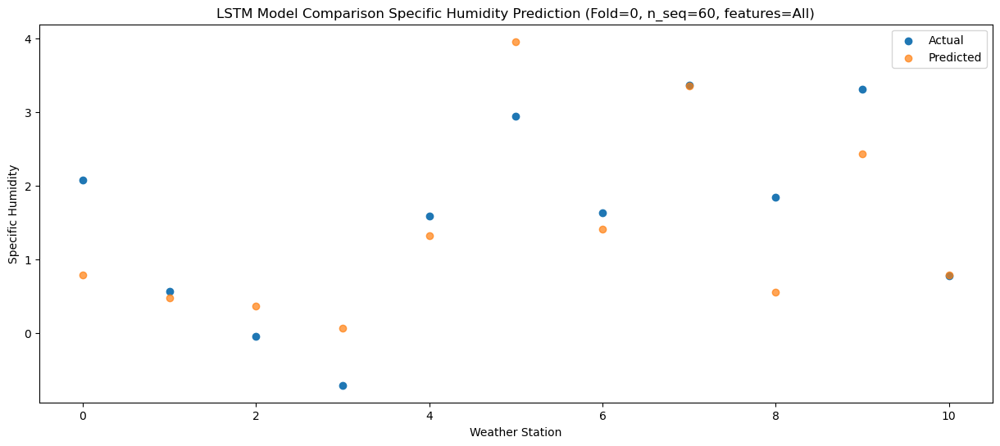

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.67    1.29153
1                 1    0.94    0.98153
2                 2   -0.69    0.87153
3                 3    0.37    0.57153
4                 4    3.78    1.82153
5                 5    2.72    4.46153
6                 6    1.22    1.91153
7                 7    3.28    3.86153
8                 8    2.28    1.06153
9                 9    3.41    2.93153
10               10    1.24    1.29153


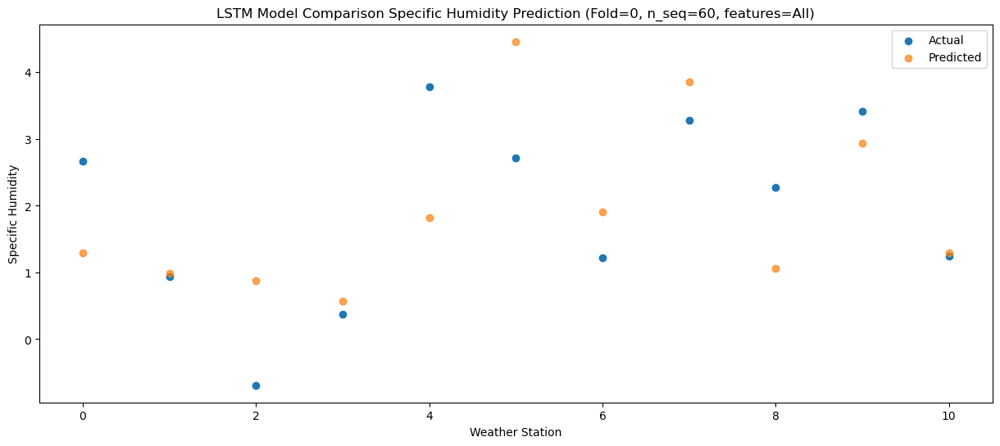

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    3.66   2.386043
1                 1    1.73   2.076043
2                 2    0.75   1.966043
3                 3    0.77   1.666043
4                 4    4.54   2.916043
5                 5    5.40   5.556043
6                 6    3.43   3.006043
7                 7    5.56   4.956043
8                 8    3.50   2.156043
9                 9    5.14   4.026043
10               10    2.88   2.386043


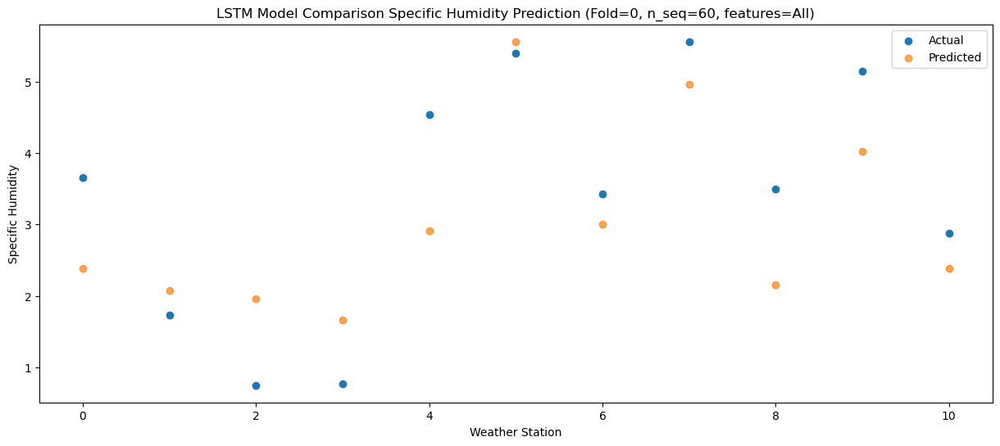

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.34   5.265659
1                 1    3.92   4.955659
2                 2    3.53   4.845659
3                 3    3.62   4.545659
4                 4    8.48   5.795659
5                 5    6.16   8.435659
6                 6    5.02   5.885659
7                 7    6.88   7.835659
8                 8    6.99   5.035659
9                 9    7.58   6.905659
10               10    4.09   5.265659


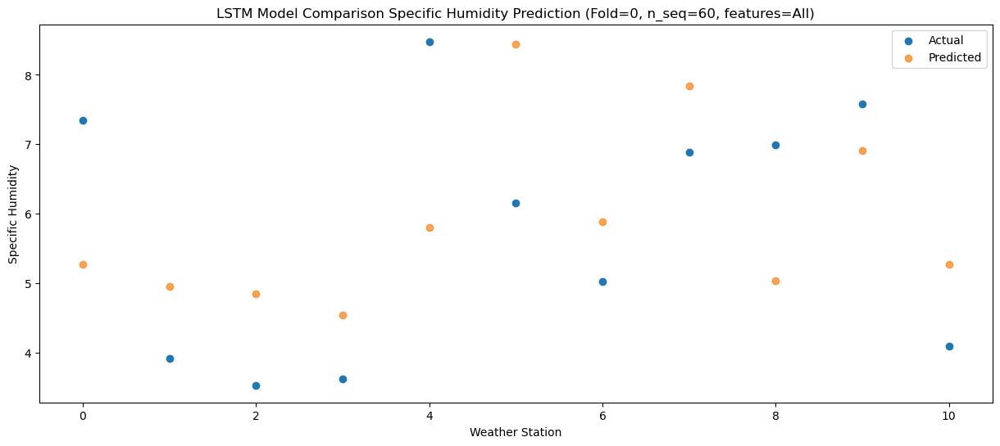

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.13   7.672599
1                 1    7.25   7.362599
2                 2    6.11   7.252599
3                 3    7.77   6.952599
4                 4   12.60   8.202599
5                 5   10.06  10.842599
6                 6    7.75   8.292599
7                 7    9.50  10.242599
8                 8    9.27   7.442599
9                 9   10.20   9.312599
10               10    7.10   7.672599


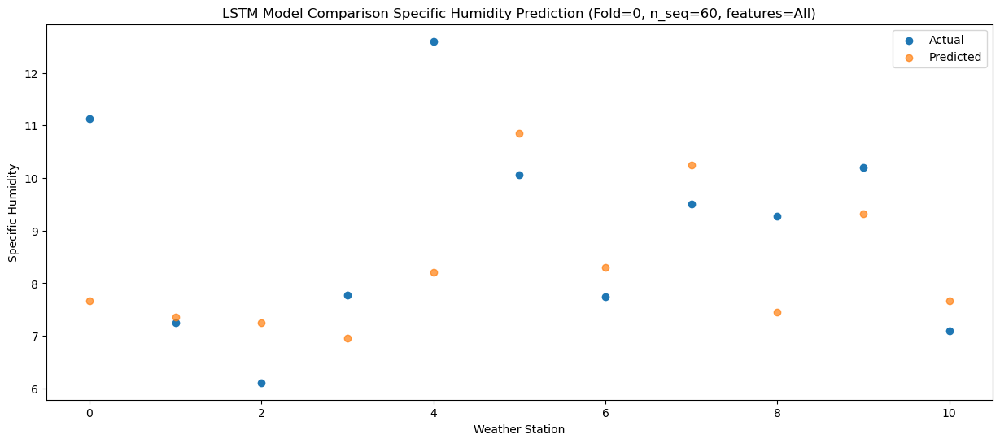

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.42  10.041244
1                 1    8.92   9.731244
2                 2    8.97   9.621244
3                 3    8.80   9.321244
4                 4   11.18  10.571244
5                 5   14.41  13.211244
6                 6   11.49  10.661244
7                 7   13.85  12.611244
8                 8   12.82   9.811244
9                 9   14.02  11.681244
10               10   10.93  10.041244


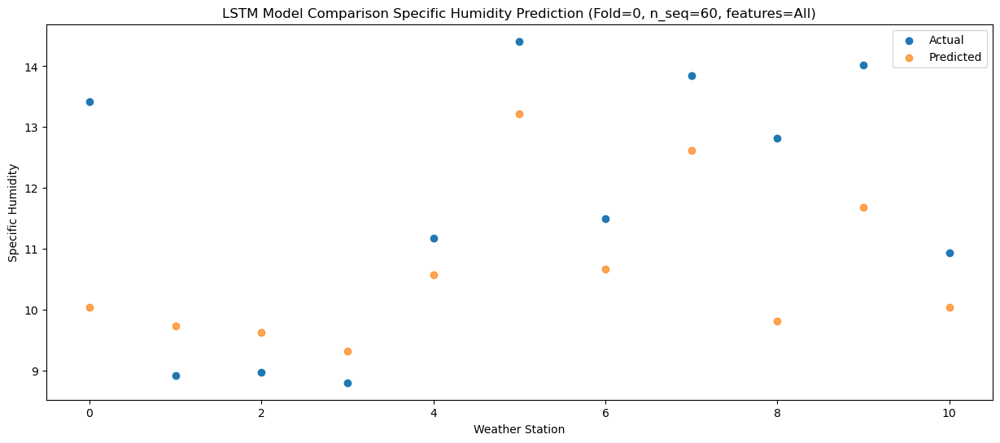

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.04   10.04736
1                 1    9.70    9.73736
2                 2    9.06    9.62736
3                 3    8.55    9.32736
4                 4    9.36   10.57736
5                 5   13.52   13.21736
6                 6   11.12   10.66736
7                 7   12.79   12.61736
8                 8   12.82    9.81736
9                 9   12.72   11.68736
10               10   10.18   10.04736


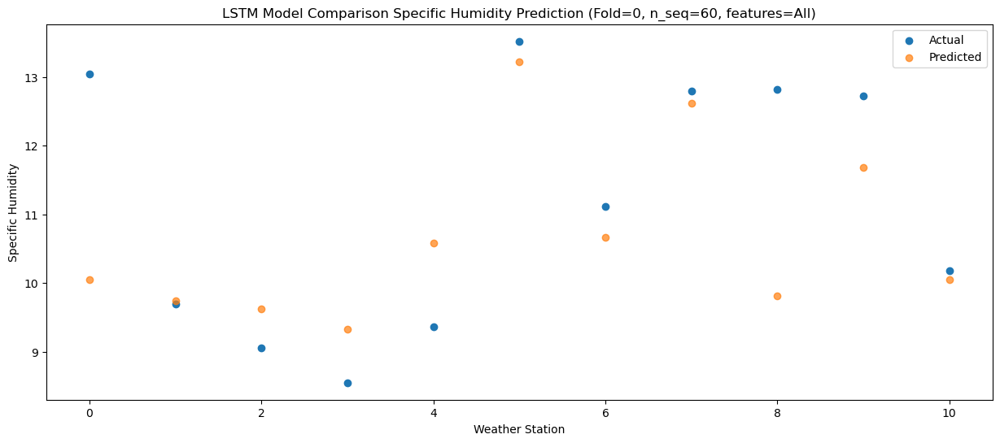

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.07   7.078891
1                 1    5.68   6.768891
2                 2    5.48   6.658891
3                 3    6.37   6.358891
4                 4    9.32   7.608891
5                 5   10.40  10.248891
6                 6    8.18   7.698891
7                 7    9.99   9.648891
8                 8    8.75   6.848891
9                 9   10.00   8.718891
10               10    8.87   7.078891


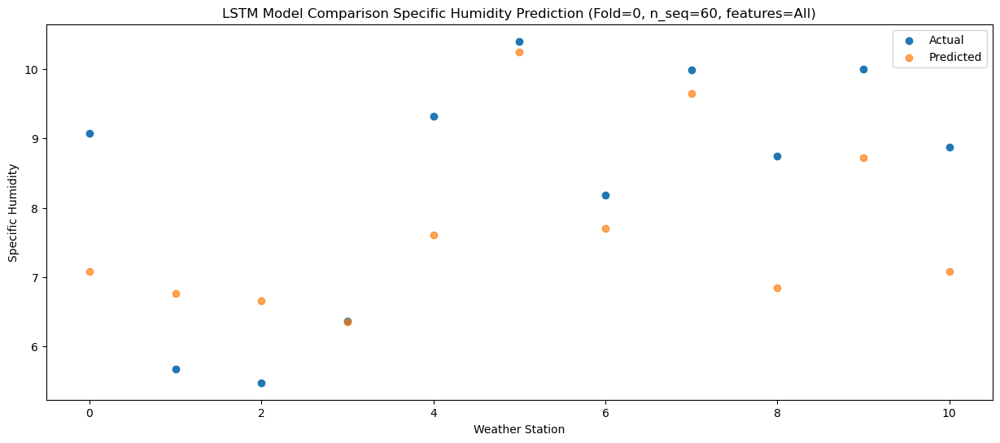

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.04   4.008744
1                 1    0.98   3.698744
2                 2    1.57   3.588744
3                 3    1.80   3.288744
4                 4    5.57   4.538744
5                 5    6.00   7.178744
6                 6    3.92   4.628744
7                 7    6.24   6.578744
8                 8    4.69   3.778744
9                 9    6.76   5.648744
10               10    5.11   4.008744


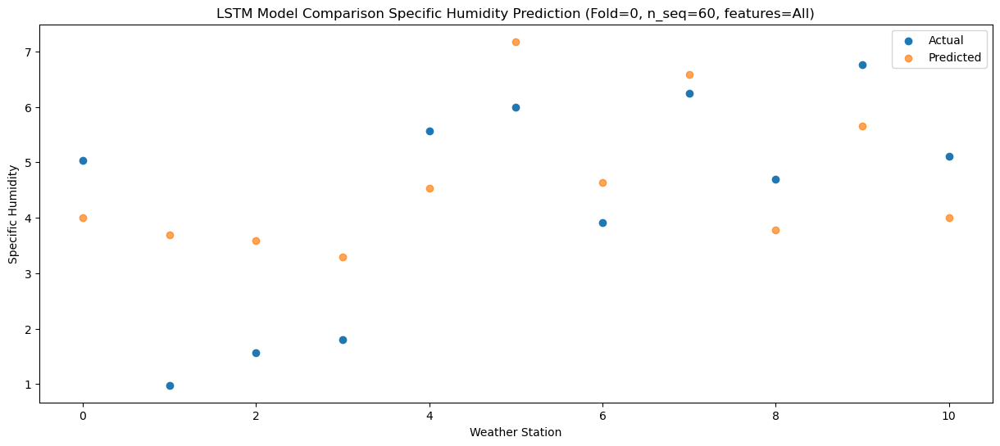

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.86   1.288618
1                 1   -1.20   0.978618
2                 2   -0.96   0.868618
3                 3   -1.19   0.568618
4                 4    2.77   1.818618
5                 5    2.98   4.458618
6                 6    0.59   1.908618
7                 7    2.72   3.858618
8                 8    2.03   1.058618
9                 9    3.41   2.928618
10               10    1.70   1.288618


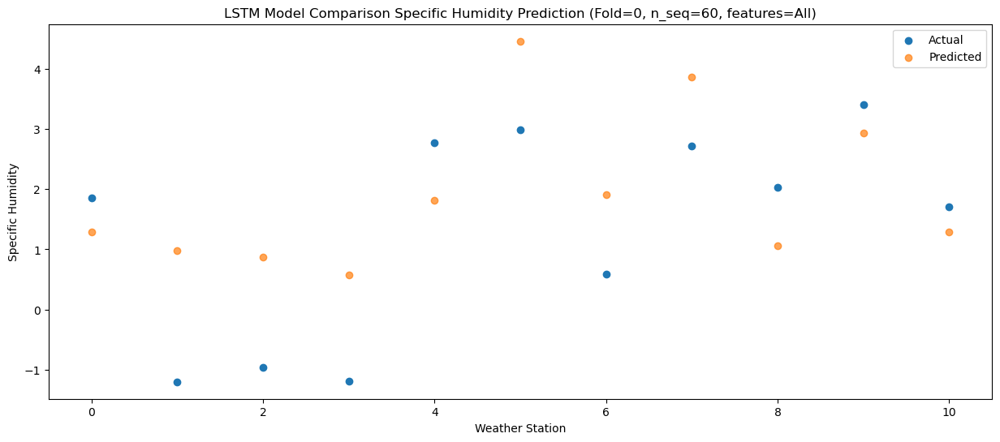

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.58   1.041731
1                 1   -2.64   0.731731
2                 2   -1.77   0.621731
3                 3   -2.59   0.321731
4                 4    0.91   1.571731
5                 5    2.16   4.211731
6                 6    0.52   1.661731
7                 7    2.92   3.611731
8                 8    1.42   0.811731
9                 9    3.60   2.681731
10               10    2.23   1.041731


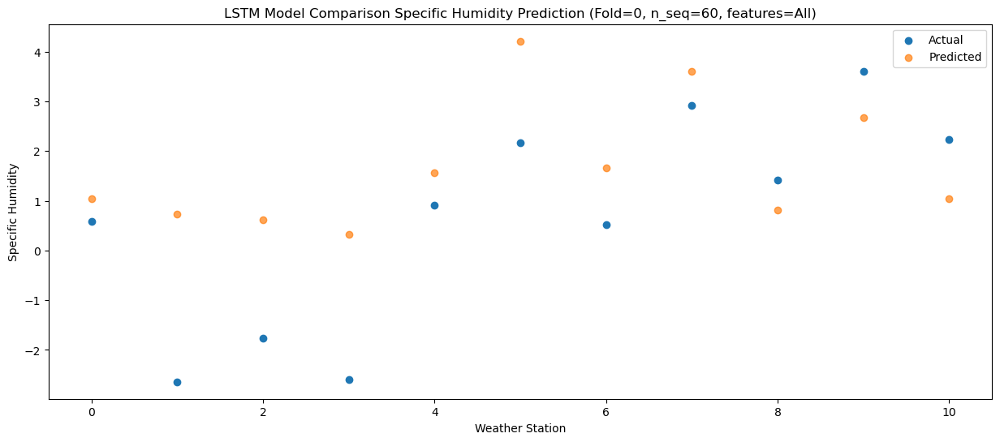

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.24    0.20387
1                 1   -3.42   -0.10613
2                 2   -2.57   -0.21613
3                 3   -3.51   -0.51613
4                 4   -0.27    0.73387
5                 5    1.37    3.37387
6                 6   -0.15    0.82387
7                 7    2.23    2.77387
8                 8    0.24   -0.02613
9                 9    2.63    1.84387
10               10    0.71    0.20387


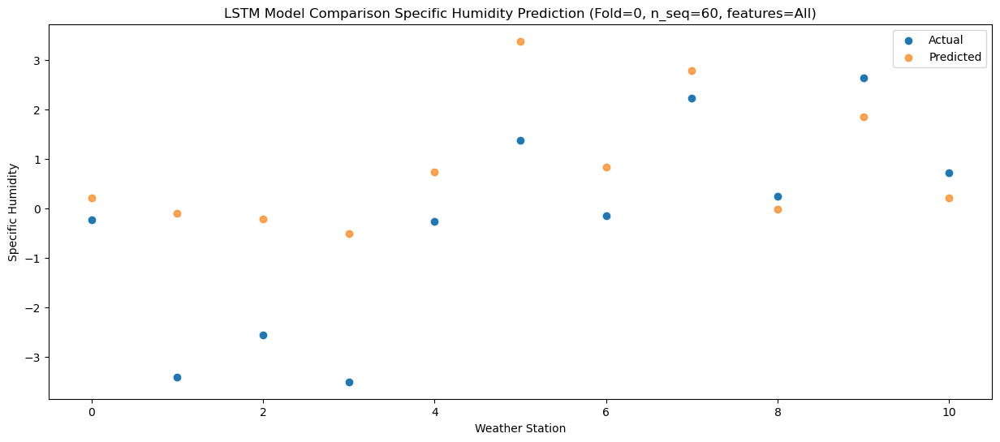

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.66   1.181264
1                 1   -2.20   0.871264
2                 2   -1.93   0.761264
3                 3   -1.73   0.461264
4                 4    2.30   1.711264
5                 5    1.27   4.351264
6                 6    0.01   1.801264
7                 7    2.26   3.751264
8                 8    2.00   0.951264
9                 9    2.98   2.821264
10               10    1.24   1.181264


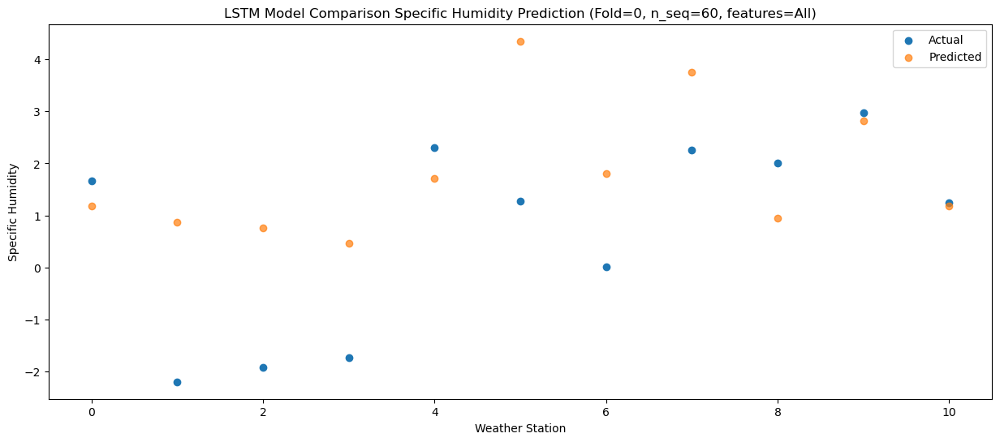

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.92   1.679033
1                 1   -0.35   1.369033
2                 2   -0.30   1.259033
3                 3    0.06   0.959033
4                 4    4.04   2.209033
5                 5    3.19   4.849033
6                 6    1.46   2.299033
7                 7    3.40   4.249033
8                 8    2.87   1.449033
9                 9    4.11   3.319033
10               10    1.93   1.679033


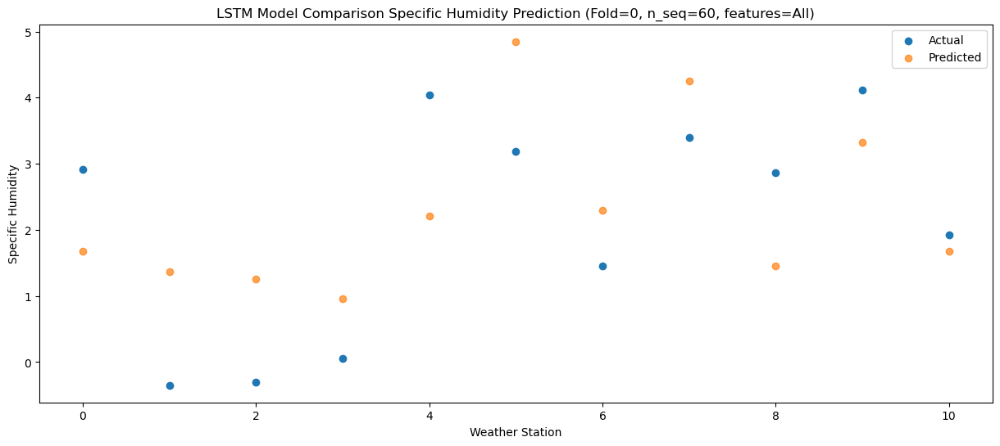

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.23   3.034309
1                 1    1.56   2.724309
2                 2    1.44   2.614309
3                 3    2.11   2.314309
4                 4    6.28   3.564309
5                 5    4.53   6.204309
6                 6    3.52   3.654309
7                 7    5.42   5.604309
8                 8    5.10   2.804309
9                 9    6.48   4.674309
10               10    3.49   3.034309


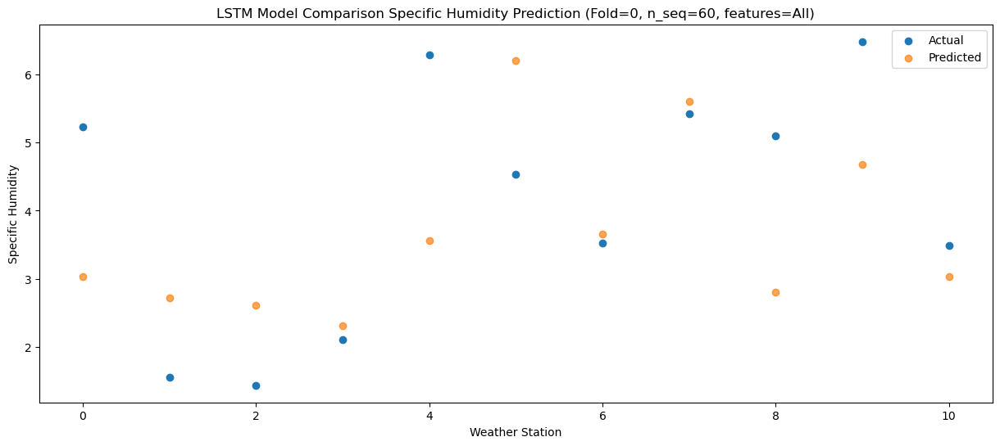

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.70   6.129738
1                 1    6.14   5.819738
2                 2    5.19   5.709738
3                 3    6.68   5.409738
4                 4   10.53   6.659738
5                 5    8.59   9.299738
6                 6    7.43   6.749738
7                 7    9.24   8.699738
8                 8    9.38   5.899738
9                 9   10.28   7.769738
10               10    6.54   6.129738


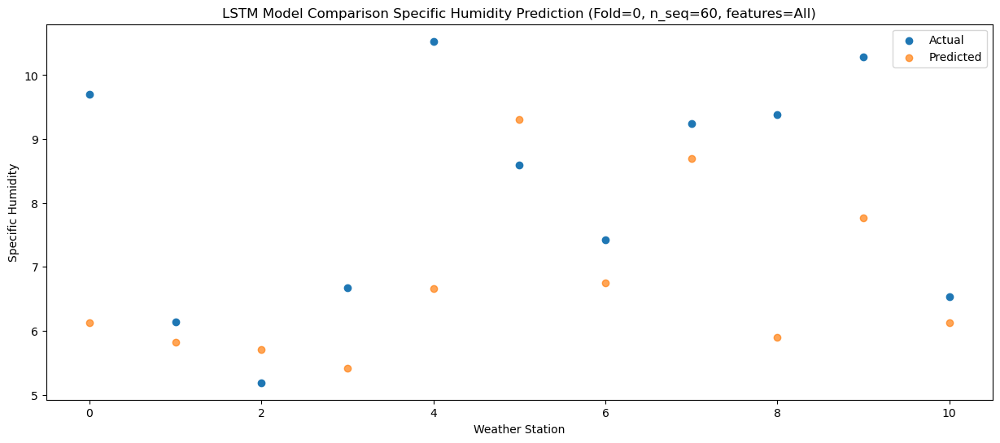

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.09   8.502473
1                 1    7.74   8.192473
2                 2    6.32   8.082473
3                 3    8.19   7.782473
4                 4   12.18   9.032473
5                 5   10.56  11.672473
6                 6    9.25   9.122473
7                 7   10.93  11.072473
8                 8   11.80   8.272473
9                 9   11.35  10.142473
10               10    9.04   8.502473


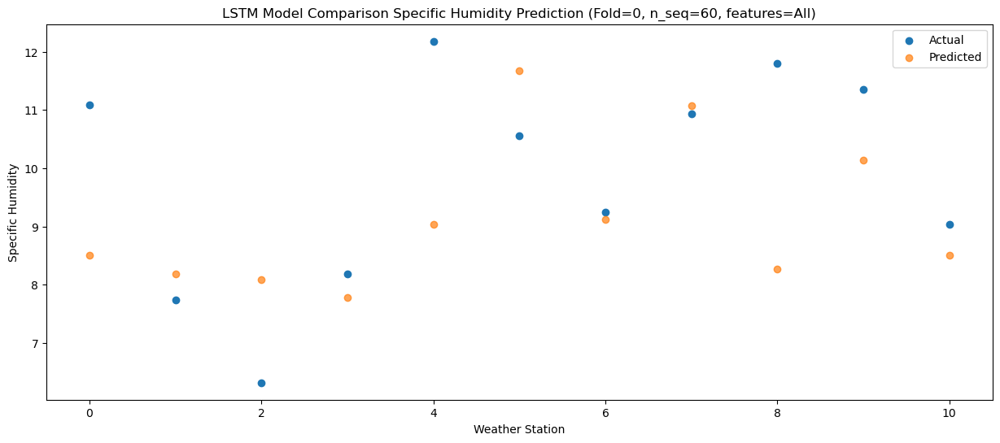

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.38   9.739323
1                 1    9.91   9.429323
2                 2    9.55   9.319323
3                 3    9.59   9.019323
4                 4   11.92  10.269323
5                 5   13.35  12.909323
6                 6   11.78  10.359323
7                 7   13.82  12.309323
8                 8   12.98   9.509323
9                 9   12.85  11.379323
10               10   10.11   9.739323


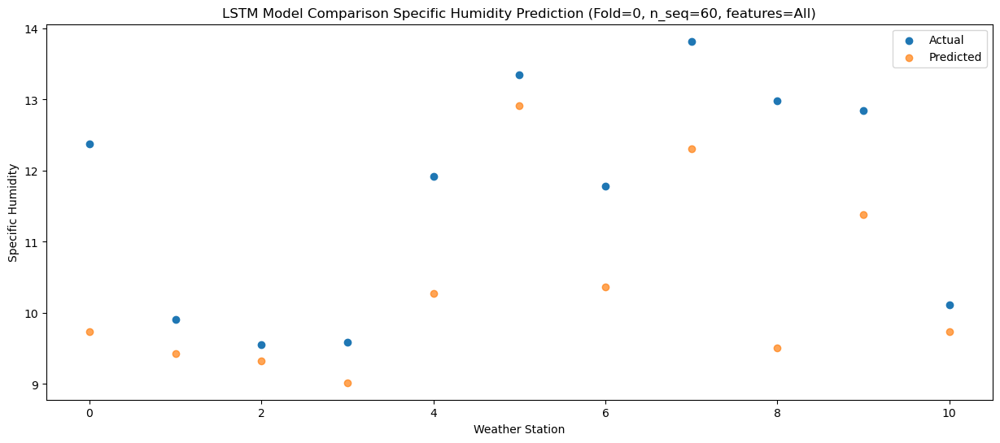

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.55   8.824124
1                 1    8.41   8.514124
2                 2    7.86   8.404124
3                 3    8.45   8.104124
4                 4   11.57   9.354124
5                 5   12.34  11.994124
6                 6   10.62   9.444124
7                 7   12.39  11.394124
8                 8   11.31   8.594124
9                 9   12.05  10.464124
10               10    9.87   8.824124


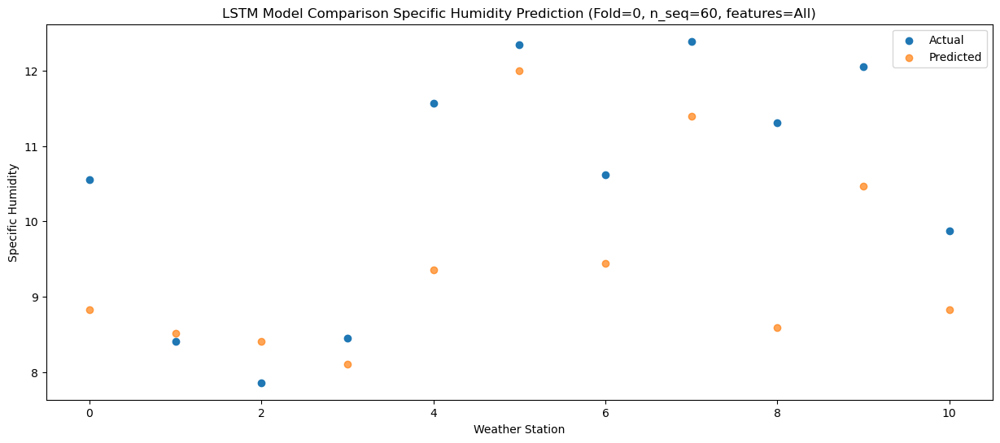

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.08   6.742979
1                 1    7.54   6.432979
2                 2    6.17   6.322979
3                 3    6.89   6.022979
4                 4    9.08   7.272979
5                 5   10.39   9.912979
6                 6    8.89   7.362979
7                 7   10.80   9.312979
8                 8    9.27   6.512979
9                 9    9.70   8.382979
10               10    8.16   6.742979


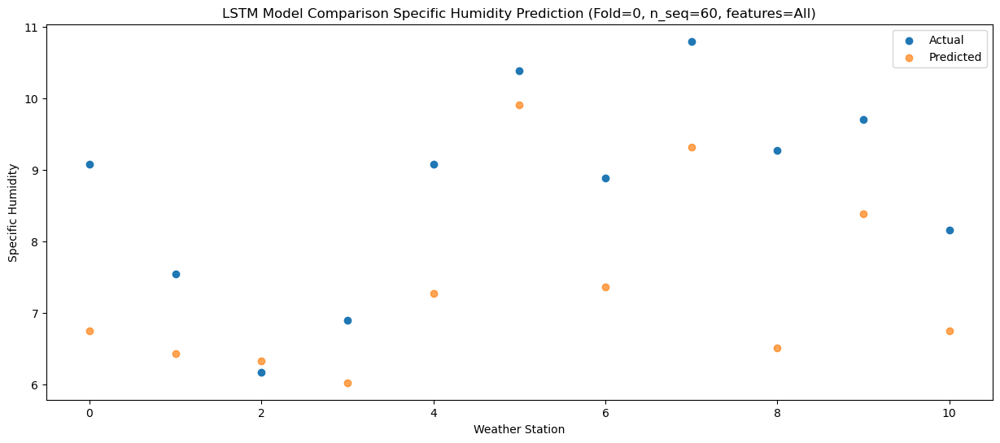

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.70   3.174964
1                 1    2.14   2.864964
2                 2    2.04   2.754964
3                 3    1.70   2.454964
4                 4    5.47   3.704964
5                 5    5.10   6.344964
6                 6    4.19   3.794964
7                 7    5.91   5.744964
8                 8    4.67   2.944964
9                 9    6.17   4.814964
10               10    3.96   3.174964


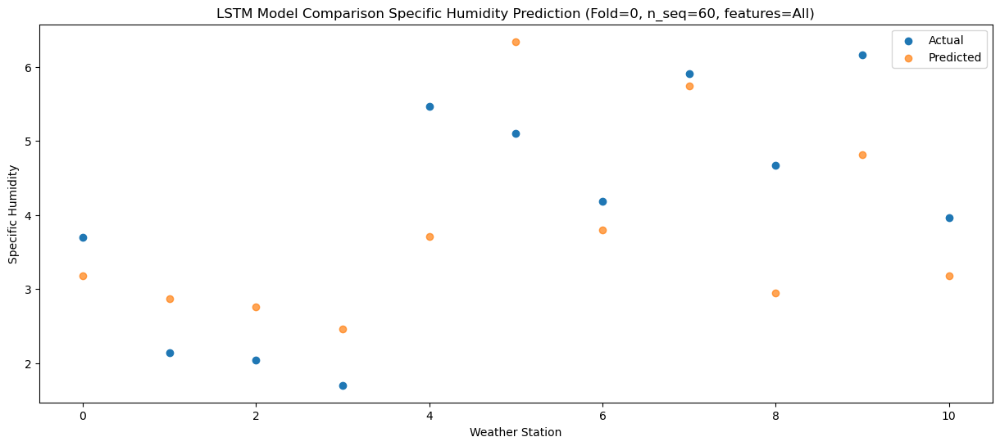

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (1, 1, 1024)              12308480  
                                                                 
 dropout (Dropout)           (1, 1, 1024)              0         
                                                                 
 lstm_1 (LSTM)               (1, 1024)                 8392704   
                                                                 
 dropout_1 (Dropout)         (1, 1024)                 0         
                                                                 
 dense (Dense)               (1, 256)                  262400    
                                                                 
 dense_1 (Dense)             (1, 128)                  32896     
                                                                 
 dense_2 (Dense)             (1, 60)                   7

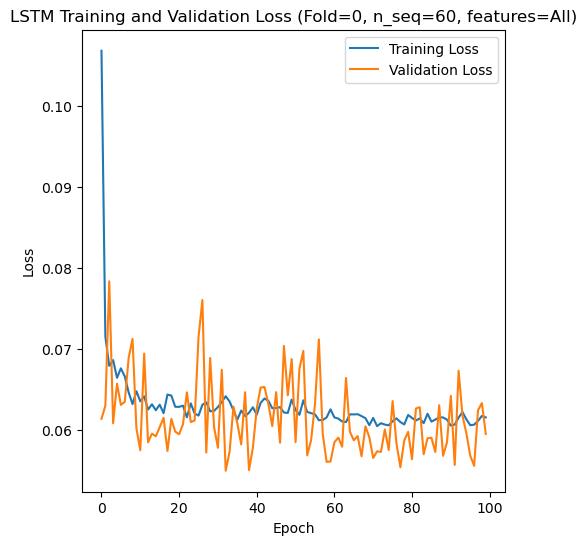

Epoch 1/100
84/84 [==============================] - 28s 99ms/step - loss: 0.1032 - accuracy: 0.3333 - mae: 0.0831 - rmse: 0.1032 - mape: 18.5416 - pearson: 0.6496 - val_loss: 0.0889 - val_accuracy: 0.0000e+00 - val_mae: 0.0722 - val_rmse: 0.0889 - val_mape: 16.0967 - val_pearson: 0.5895
Epoch 2/100
84/84 [==============================] - 6s 71ms/step - loss: 0.0820 - accuracy: 0.3571 - mae: 0.0638 - rmse: 0.0820 - mape: 14.9579 - pearson: 0.6856 - val_loss: 0.0677 - val_accuracy: 0.5000 - val_mae: 0.0517 - val_rmse: 0.0677 - val_mape: 11.4530 - val_pearson: 0.7609
Epoch 3/100
84/84 [==============================] - 5s 64ms/step - loss: 0.0684 - accuracy: 0.3810 - mae: 0.0539 - rmse: 0.0684 - mape: 12.2266 - pearson: 0.7632 - val_loss: 0.0730 - val_accuracy: 0.0000e+00 - val_mae: 0.0576 - val_rmse: 0.0730 - val_mape: 13.5085 - val_pearson: 0.7156
Epoch 4/100
84/84 [==============================] - 6s 76ms/step - loss: 0.0675 - accuracy: 0.4167 - mae: 0.0534 - rmse: 0.0675 - mape: 12

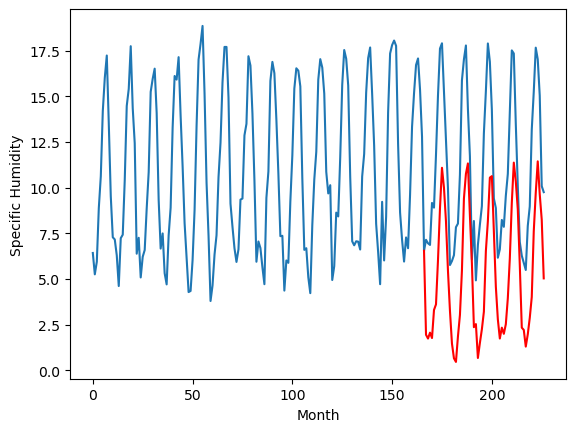

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.00		1.46		2.46
-0.95		1.25		2.20
-1.20		1.58		2.78
-0.68		1.28		1.96
1.55		2.82		1.27
-0.04		3.13		3.17
2.97		5.54		2.57
6.77		8.39		1.62
8.81		10.60		1.79
8.86		9.51		0.65
5.96		7.68		1.72
3.29		4.96		1.67
0.23		2.77		2.54
-2.36		0.98		3.34
-2.34		0.17		2.51
-2.15		-0.02		2.13
-0.62		1.37		1.99
-0.26		2.55		2.81
2.66		4.98		2.32
6.64		8.92		2.28
8.51		10.27		1.76
8.72		10.84		2.12
5.77		7.98		2.21
3.73		5.37		1.64
-1.86		1.88		3.74
0.31		2.05		1.74
-2.69		0.19		2.88
-1.74		1.01		2.75
-1.06		1.77		2.83
0.00		2.72		2.72
4.17		6.05		1.88
6.57		7.68		1.11
9.24		10.07		0.83
8.83		10.15		1.32
5.47		7.14		1.67
0.58		4.09		3.51
0.10		2.31		2.21
-1.49		1.26		2.75
-1.08		1.85		2.93
0.04		1.51		1.47
-0.83		2.04		2.87
0.77		3.46		2.69
3.51		5.63		2.12
5.86		8.69		2.83
8.82		10.89		2.07
8.95		9.85		0.90
5.84		8.33		2.49
1.99		5.28		3.29
-1.02		1.85		2.87
-1.60		1.73		3.33
-2.37		0.81		3.18
-2.03		1.49

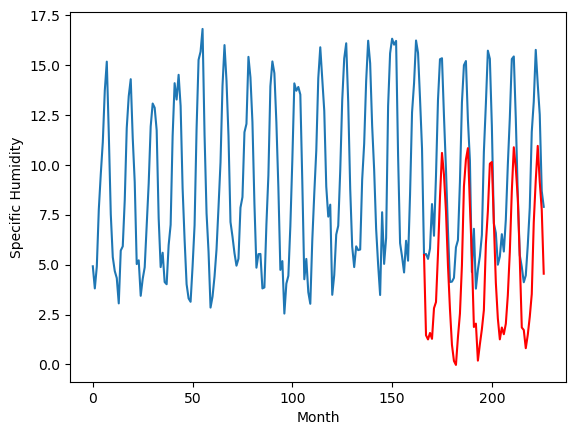

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.90		0.21		2.11
-0.99		0.00		0.99
-1.50		0.33		1.83
-1.11		0.03		1.14
2.05		1.57		-0.48
0.43		1.88		1.45
3.20		4.29		1.09
7.05		7.14		0.09
9.60		9.35		-0.25
9.12		8.26		-0.86
6.17		6.43		0.26
3.41		3.71		0.30
0.23		1.52		1.29
-2.54		-0.27		2.27
-2.39		-1.08		1.31
-2.39		-1.27		1.12
0.23		0.12		-0.11
-0.06		1.30		1.36
2.78		3.73		0.95
7.30		7.67		0.37
8.89		9.02		0.13
9.11		9.59		0.48
6.35		6.73		0.38
3.60		4.12		0.52
-1.90		0.63		2.53
0.74		0.80		0.06
-3.14		-1.06		2.08
-2.11		-0.24		1.87
-1.32		0.52		1.84
0.44		1.47		1.03
4.80		4.80		-0.00
7.89		6.43		-1.46
9.52		8.82		-0.70
8.65		8.90		0.25
5.14		5.89		0.75
0.03		2.84		2.81
-0.34		1.06		1.40
-1.03		0.01		1.04
-1.06		0.60		1.66
-0.01		0.26		0.27
-0.48		0.79		1.27
0.88		2.21		1.33
4.18		4.38		0.20
6.83		7.44		0.61
9.97		9.64		-0.33
9.90		8.60		-1.30
6.09		7.08		0.99
1.58		4.03		2.45
-0.97		0.60		1.57
-1.99		0.48		2.47
-2.62		-0.44		2.18
-1.

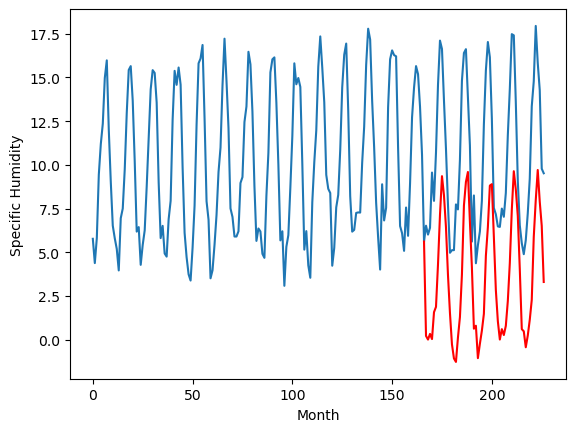

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.51		-0.49		1.02
-2.71		-0.70		2.01
-1.81		-0.37		1.44
-2.51		-0.67		1.84
1.85		0.87		-0.98
1.51		1.18		-0.33
3.49		3.59		0.10
5.61		6.44		0.83
8.12		8.65		0.53
7.01		7.56		0.55
5.43		5.73		0.30
2.03		3.01		0.98
-0.07		0.82		0.89
-2.62		-0.97		1.65
-2.96		-1.78		1.18
-2.89		-1.97		0.92
-0.25		-0.58		-0.33
1.09		0.60		-0.49
4.98		3.03		-1.95
8.17		6.97		-1.20
8.65		8.32		-0.33
8.99		8.89		-0.10
5.90		6.03		0.13
3.65		3.42		-0.23
-0.80		-0.07		0.73
2.12		0.10		-2.02
-3.53		-1.76		1.77
-3.36		-0.94		2.42
-1.68		-0.18		1.50
2.48		0.77		-1.71
6.29		4.10		-2.19
7.34		5.73		-1.61
8.26		8.12		-0.14
8.51		8.20		-0.31
5.22		5.19		-0.03
0.26		2.14		1.88
-0.24		0.36		0.60
-1.05		-0.69		0.36
-1.47		-0.10		1.37
-0.69		-0.44		0.25
0.86		0.09		-0.77
1.23		1.51		0.28
5.01		3.68		-1.33
8.41		6.74		-1.67
8.97		8.94		-0.03
7.30		7.90		0.60
6.10		6.38		0.28
2.68		3.33		0.65
-0.65		-0.10		0.55
-2.29		-0.22		2.07

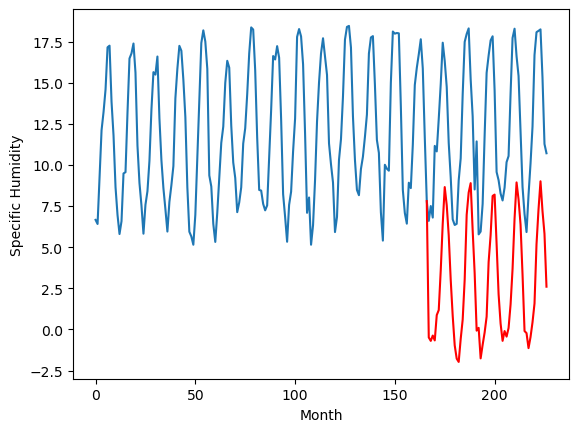

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.21		3.57		1.36
0.97		3.36		2.39
1.88		3.69		1.81
1.20		3.39		2.19
5.93		4.93		-1.00
5.62		5.24		-0.38
7.74		7.65		-0.09
10.03		10.50		0.47
12.63		12.71		0.08
11.18		11.62		0.44
9.69		9.79		0.10
5.84		7.07		1.23
3.36		4.88		1.52
0.54		3.09		2.55
0.29		2.28		1.99
0.33		2.09		1.76
3.05		3.48		0.43
4.31		4.66		0.35
8.34		7.09		-1.25
11.75		11.03		-0.72
11.93		12.38		0.45
11.97		12.95		0.98
8.87		10.09		1.22
6.92		7.48		0.56
2.33		3.99		1.66
5.26		4.16		-1.10
-0.28		2.30		2.58
-0.08		3.12		3.20
1.62		3.88		2.26
5.72		4.83		-0.89
9.60		8.16		-1.44
10.72		9.79		-0.93
11.47		12.18		0.71
11.85		12.26		0.41
8.50		9.25		0.75
3.60		6.20		2.60
3.22		4.42		1.20
2.40		3.37		0.97
1.92		3.96		2.04
2.52		3.62		1.10
4.22		4.15		-0.07
4.67		5.57		0.90
8.34		7.74		-0.60
11.60		10.80		-0.80
11.68		13.00		1.32
10.28		11.96		1.68
9.53		10.44		0.91
6.14		7.39		1.25
2.80		3.96		1.16
1.08		3.84		2.76
-0.09		2.92		3.0

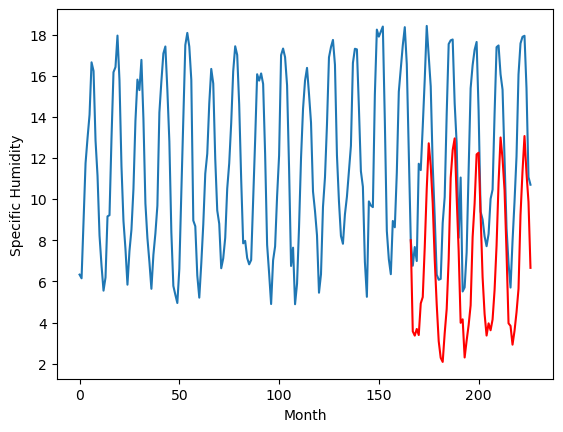

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.35		2.06		-1.29
1.87		1.85		-0.02
1.59		2.18		0.59
1.77		1.88		0.11
4.44		3.42		-1.02
3.43		3.73		0.30
6.11		6.14		0.03
7.93		8.99		1.06
8.92		11.20		2.28
7.69		10.11		2.42
7.26		8.28		1.02
3.75		5.56		1.81
3.19		3.37		0.18
0.75		1.58		0.83
1.58		0.77		-0.81
0.95		0.58		-0.37
1.74		1.97		0.23
3.04		3.15		0.11
7.35		5.58		-1.77
9.52		9.52		0.00
10.85		10.87		0.02
11.07		11.44		0.37
7.53		8.58		1.05
4.42		5.97		1.55
2.58		2.48		-0.10
1.53		2.65		1.12
0.26		0.79		0.53
0.14		1.61		1.47
0.69		2.37		1.68
2.96		3.32		0.36
4.73		6.65		1.92
7.33		8.28		0.95
8.28		10.67		2.39
10.39		10.75		0.36
9.12		7.74		-1.38
5.93		4.69		-1.24
3.06		2.91		-0.15
2.39		1.86		-0.53
0.84		2.45		1.61
0.87		2.11		1.24
1.92		2.64		0.72
2.18		4.06		1.88
6.55		6.23		-0.32
6.50		9.29		2.79
8.67		11.49		2.82
8.82		10.45		1.63
8.46		8.93		0.47
6.48		5.88		-0.60
3.85		2.45		-1.40
1.98		2.33		0.35
0.83		1.41		0.58
1.24		2.09		0

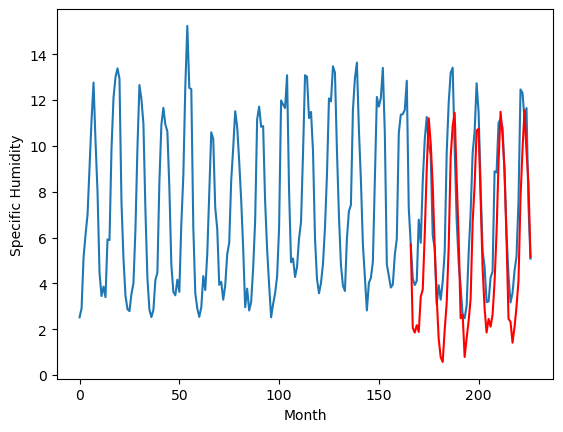

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.70		2.91		2.21
0.73		2.70		1.97
0.31		3.03		2.72
0.79		2.73		1.94
2.76		4.27		1.51
2.11		4.58		2.47
5.31		6.99		1.68
8.95		9.84		0.89
11.39		12.05		0.66
11.41		10.96		-0.45
8.10		9.13		1.03
5.61		6.41		0.80
2.50		4.22		1.72
-0.22		2.43		2.65
-0.33		1.62		1.95
-0.21		1.43		1.64
1.35		2.82		1.47
1.97		4.00		2.03
4.90		6.43		1.53
9.25		10.37		1.12
11.75		11.72		-0.03
12.04		12.29		0.25
8.69		9.43		0.74
6.56		6.82		0.26
0.63		3.33		2.70
2.50		3.50		1.00
-0.50		1.64		2.14
0.63		2.46		1.83
1.38		3.22		1.84
2.57		4.17		1.60
6.83		7.50		0.67
9.55		9.13		-0.42
12.54		11.52		-1.02
11.45		11.60		0.15
7.97		8.59		0.62
2.91		5.54		2.63
2.42		3.76		1.34
0.52		2.71		2.19
0.88		3.30		2.42
2.08		2.96		0.88
1.32		3.49		2.17
3.13		4.91		1.78
5.69		7.08		1.39
8.27		10.14		1.87
11.89		12.34		0.45
11.78		11.30		-0.48
8.81		9.78		0.97
4.56		6.73		2.17
1.21		3.30		2.09
0.71		3.18		2.47
-0.11		2.26		2.37
0.37		2.94

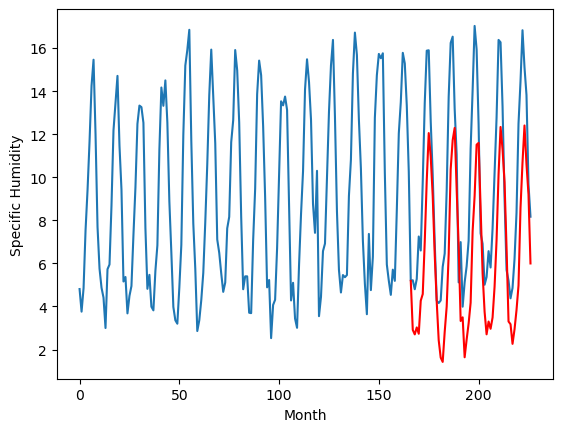

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.11		3.80		0.69
2.78		3.59		0.81
2.70		3.92		1.22
2.58		3.62		1.04
5.24		5.16		-0.08
5.50		5.47		-0.03
8.40		7.88		-0.52
12.23		10.73		-1.50
15.31		12.94		-2.37
13.14		11.85		-1.29
11.34		10.02		-1.32
6.52		7.30		0.78
4.50		5.11		0.61
2.18		3.32		1.14
2.05		2.51		0.46
1.53		2.32		0.79
4.26		3.71		-0.55
5.49		4.89		-0.60
8.70		7.32		-1.38
13.46		11.26		-2.20
14.09		12.61		-1.48
13.94		13.18		-0.76
10.69		10.32		-0.37
7.96		7.71		-0.25
3.40		4.22		0.82
5.04		4.39		-0.65
1.29		2.53		1.24
1.97		3.35		1.38
3.50		4.11		0.61
5.69		5.06		-0.63
10.14		8.39		-1.75
12.90		10.02		-2.88
13.87		12.41		-1.46
13.78		12.49		-1.29
9.82		9.48		-0.34
5.28		6.43		1.15
4.03		4.65		0.62
3.12		3.60		0.48
3.24		4.19		0.95
3.34		3.85		0.51
4.10		4.38		0.28
5.30		5.80		0.50
9.34		7.97		-1.37
12.26		11.03		-1.23
14.83		13.23		-1.60
14.41		12.19		-2.22
9.92		10.67		0.75
6.67		7.62		0.95
3.96		4.19		0.23
2.57		4.07		1.50

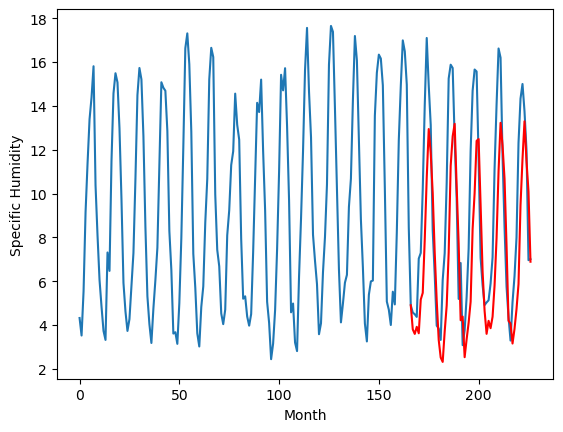

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.03		3.47		-0.56
3.19		3.26		0.07
3.64		3.59		-0.05
3.02		3.29		0.27
6.04		4.83		-1.21
6.23		5.14		-1.09
9.56		7.55		-2.01
11.70		10.40		-1.30
15.06		12.61		-2.45
12.16		11.52		-0.64
10.68		9.69		-0.99
6.01		6.97		0.96
4.90		4.78		-0.12
2.62		2.99		0.37
2.78		2.18		-0.60
1.97		1.99		0.02
4.58		3.38		-1.20
5.74		4.56		-1.18
9.96		6.99		-2.97
13.10		10.93		-2.17
14.15		12.28		-1.87
13.73		12.85		-0.88
10.16		9.99		-0.17
7.72		7.38		-0.34
4.19		3.89		-0.30
3.58		4.06		0.48
1.60		2.20		0.60
2.13		3.02		0.89
3.22		3.78		0.56
6.34		4.73		-1.61
10.58		8.06		-2.52
12.48		9.69		-2.79
11.84		12.08		0.24
12.58		12.16		-0.42
9.84		9.15		-0.69
5.89		6.10		0.21
4.91		4.32		-0.59
3.17		3.27		0.10
2.69		3.86		1.17
3.02		3.52		0.50
4.44		4.05		-0.39
5.66		5.47		-0.19
10.71		7.64		-3.07
13.29		10.70		-2.59
13.52		12.90		-0.62
11.69		11.86		0.17
10.74		10.34		-0.40
7.31		7.29		-0.02
4.64		3.86		-0.78
3.59		3.7

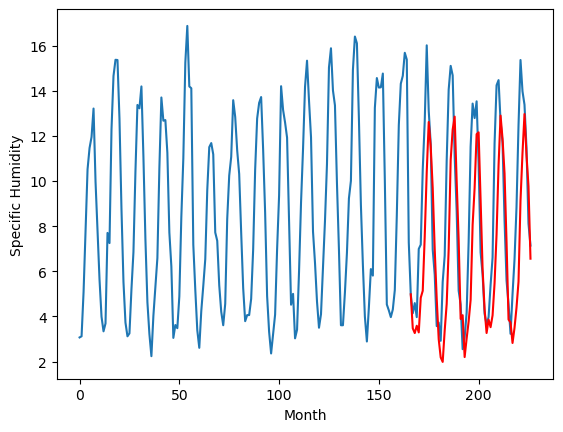

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.80		-0.34		-1.14
0.15		-0.55		-0.70
-0.00		-0.22		-0.22
0.01		-0.52		-0.53
1.90		1.02		-0.88
2.06		1.33		-0.73
4.88		3.74		-1.14
6.59		6.59		-0.00
9.48		8.80		-0.68
8.16		7.71		-0.45
5.37		5.88		0.51
1.85		3.16		1.31
1.53		0.97		-0.56
-0.33		-0.82		-0.49
-0.14		-1.63		-1.49
-0.88		-1.82		-0.94
0.94		-0.43		-1.37
1.11		0.75		-0.36
6.26		3.18		-3.08
9.25		7.12		-2.13
10.49		8.47		-2.02
9.46		9.04		-0.42
6.50		6.18		-0.32
3.06		3.57		0.51
0.70		0.08		-0.62
-0.28		0.25		0.53
-0.92		-1.61		-0.69
-1.00		-0.79		0.21
-0.04		-0.03		0.01
0.93		0.92		-0.01
3.49		4.25		0.76
7.67		5.88		-1.79
8.32		8.27		-0.05
8.73		8.35		-0.38
6.73		5.34		-1.39
3.34		2.29		-1.05
1.36		0.51		-0.85
0.15		-0.54		-0.69
-0.16		0.05		0.21
-0.30		-0.29		0.01
0.49		0.24		-0.25
1.01		1.66		0.65
6.74		3.83		-2.91
8.35		6.89		-1.46
10.28		9.09		-1.19
8.37		8.05		-0.32
6.72		6.53		-0.19
3.61		3.48		-0.13
1.29		0.05		-1.24
0.85		-

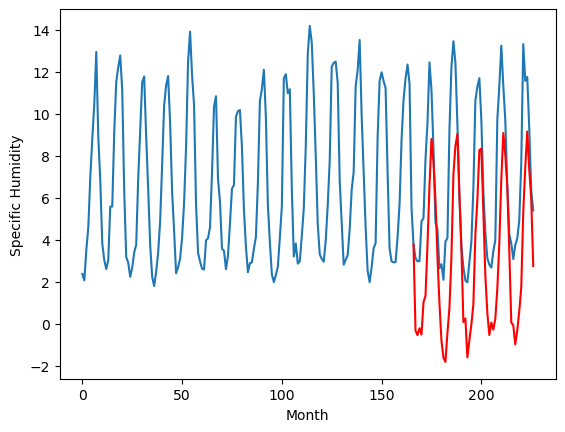

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.62		1.95		1.33
0.61		1.74		1.13
0.46		2.07		1.61
0.53		1.77		1.24
1.48		3.31		1.83
1.77		3.62		1.85
4.34		6.03		1.69
7.98		8.88		0.90
11.62		11.09		-0.53
11.53		10.00		-1.53
8.05		8.17		0.12
5.13		5.45		0.32
2.75		3.26		0.51
0.59		1.47		0.88
-0.14		0.66		0.80
-0.10		0.47		0.57
1.14		1.86		0.72
2.51		3.04		0.53
4.04		5.47		1.43
9.36		9.41		0.05
11.22		10.76		-0.46
11.56		11.33		-0.23
8.37		8.47		0.10
6.51		5.86		-0.65
1.32		2.37		1.05
1.20		2.54		1.34
-0.41		0.68		1.09
0.33		1.50		1.17
1.35		2.26		0.91
2.01		3.21		1.20
6.14		6.54		0.40
7.73		8.17		0.44
11.36		10.56		-0.80
10.93		10.64		-0.29
7.68		7.63		-0.05
4.24		4.58		0.34
2.74		2.80		0.06
0.61		1.75		1.14
1.47		2.34		0.87
0.67		2.00		1.33
0.70		2.53		1.83
3.31		3.95		0.64
3.61		6.12		2.51
6.90		9.18		2.28
11.61		11.38		-0.23
9.32		10.34		1.02
8.06		8.82		0.76
5.01		5.77		0.76
1.35		2.34		0.99
1.59		2.22		0.63
0.54		1.30		0.76
0.41		1.98

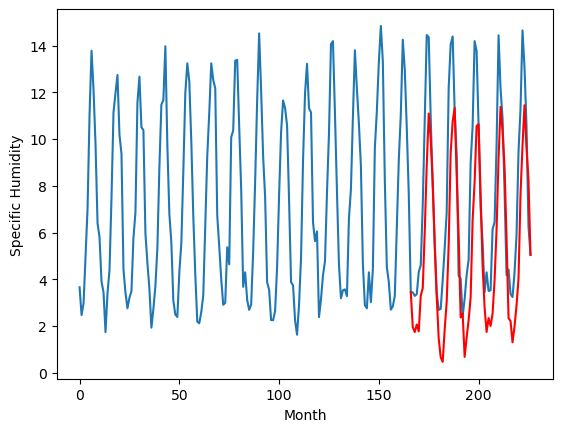

RangeIndex(start=1, stop=12, step=1)
[-1.4400000000000013, -1.0, -1.9, -1.5099999999999993, 2.209999999999999, 3.3500000000000005, 0.7000000000000002, 3.110000000000001, 4.03, 0.7999999999999996, 0.6200000000000001]
[1.9526932811737057, 1.4626932811737063, 0.2126932811737059, -0.48730671882629384, 3.5726932811737058, 2.062693281173706, 2.9126932811737056, 3.802693281173706, 3.472693281173706, -0.3373067188262939, 1.9526932811737057]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.44   1.952693
1                 1   -1.00   1.462693
2                 2   -1.90   0.212693
3                 3   -1.51  -0.487307
4                 4    2.21   3.572693
5                 5    3.35   2.062693
6                 6    0.70   2.912693
7                 7    3.11   3.802693
8                 8    4.03   3.472693
9                 9    0.80  -0.337307
10               10    0.62   1.952693


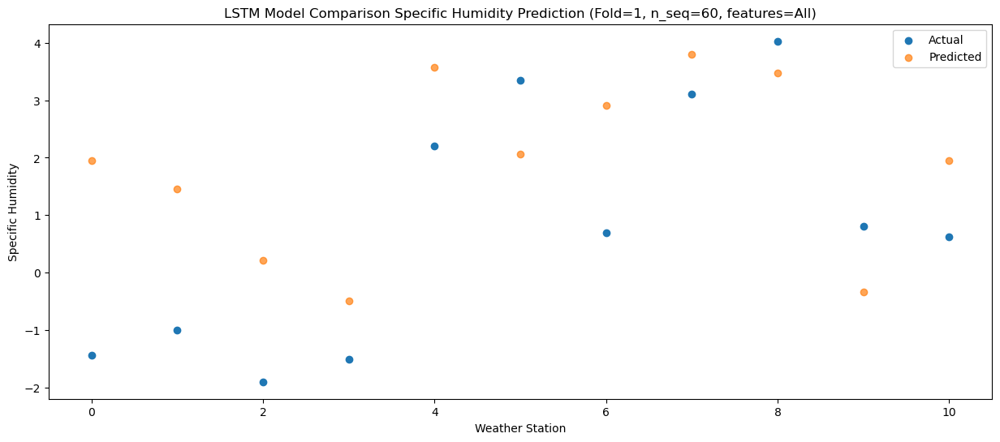

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.84   1.744041
1                 1   -0.95   1.254041
2                 2   -0.99   0.004041
3                 3   -2.71  -0.695959
4                 4    0.97   3.364041
5                 5    1.87   1.854041
6                 6    0.73   2.704041
7                 7    2.78   3.594041
8                 8    3.19   3.264041
9                 9    0.15  -0.545959
10               10    0.61   1.744041


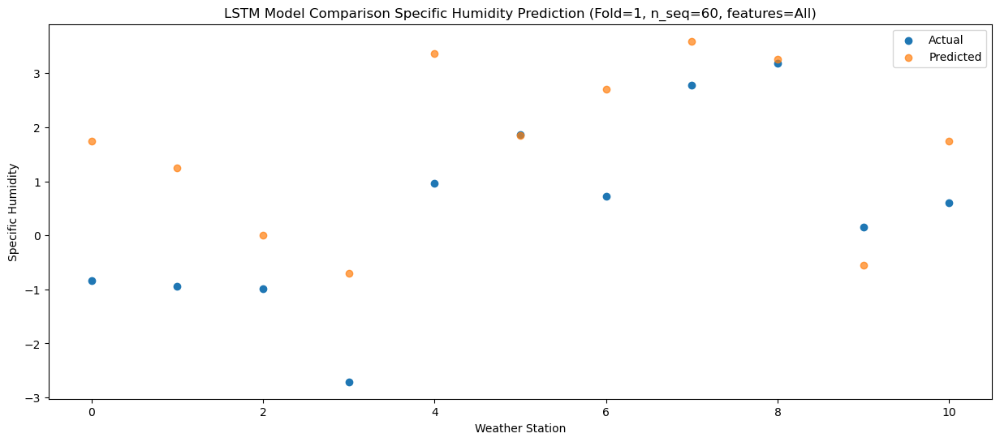

Predictions for (t+2):
    Weather_Station        Actual  Predicted
0                 0 -1.030000e+00    2.06807
1                 1 -1.200000e+00    1.57807
2                 2 -1.500000e+00    0.32807
3                 3 -1.810000e+00   -0.37193
4                 4  1.880000e+00    3.68807
5                 5  1.590000e+00    2.17807
6                 6  3.100000e-01    3.02807
7                 7  2.700000e+00    3.91807
8                 8  3.640000e+00    3.58807
9                 9 -2.775558e-16   -0.22193
10               10  4.600000e-01    2.06807


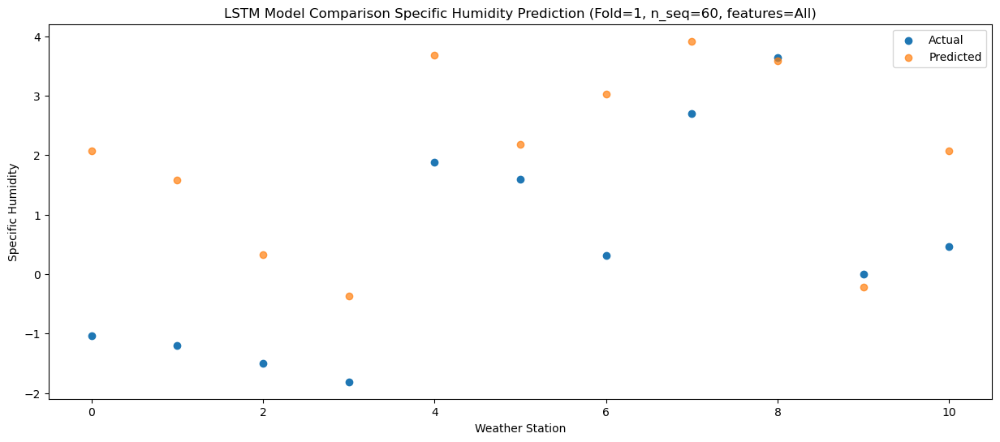

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.12   1.772272
1                 1   -0.68   1.282272
2                 2   -1.11   0.032272
3                 3   -2.51  -0.667728
4                 4    1.20   3.392272
5                 5    1.77   1.882272
6                 6    0.79   2.732272
7                 7    2.58   3.622272
8                 8    3.02   3.292272
9                 9    0.01  -0.517728
10               10    0.53   1.772272


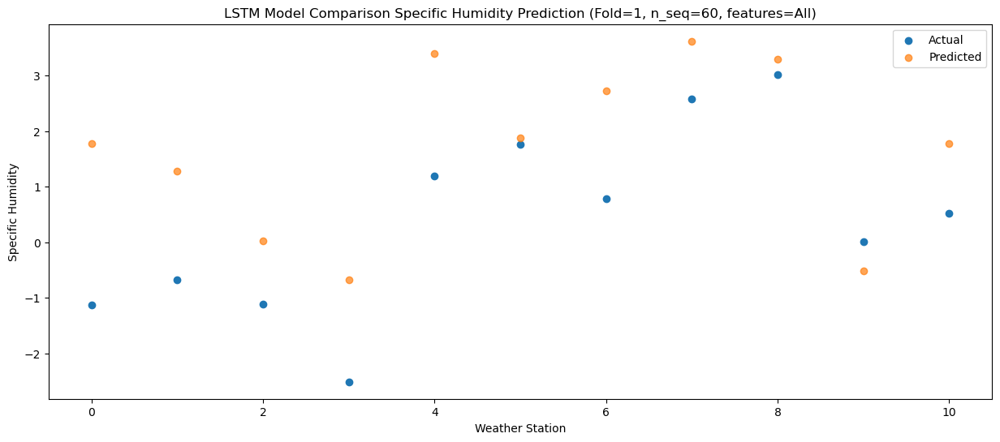

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.18   3.309944
1                 1    1.55   2.819944
2                 2    2.05   1.569944
3                 3    1.85   0.869944
4                 4    5.93   4.929944
5                 5    4.44   3.419944
6                 6    2.76   4.269944
7                 7    5.24   5.159944
8                 8    6.04   4.829944
9                 9    1.90   1.019944
10               10    1.48   3.309944


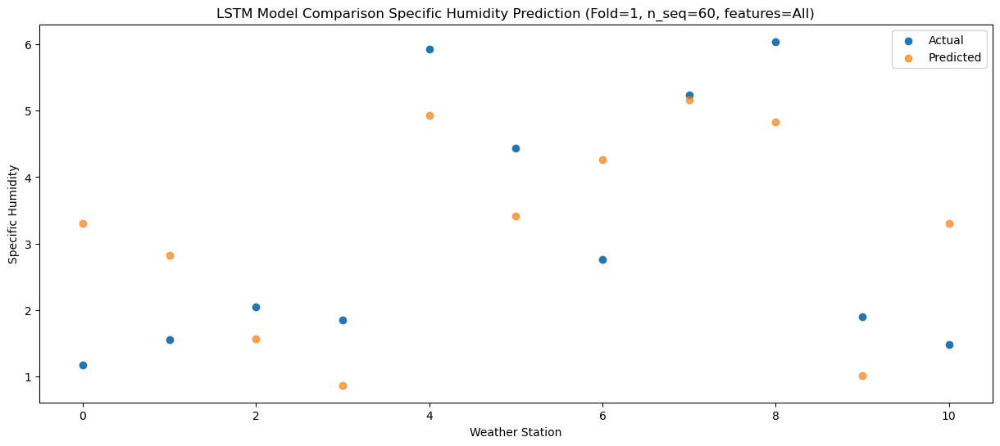

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.92    3.61669
1                 1   -0.04    3.12669
2                 2    0.43    1.87669
3                 3    1.51    1.17669
4                 4    5.62    5.23669
5                 5    3.43    3.72669
6                 6    2.11    4.57669
7                 7    5.50    5.46669
8                 8    6.23    5.13669
9                 9    2.06    1.32669
10               10    1.77    3.61669


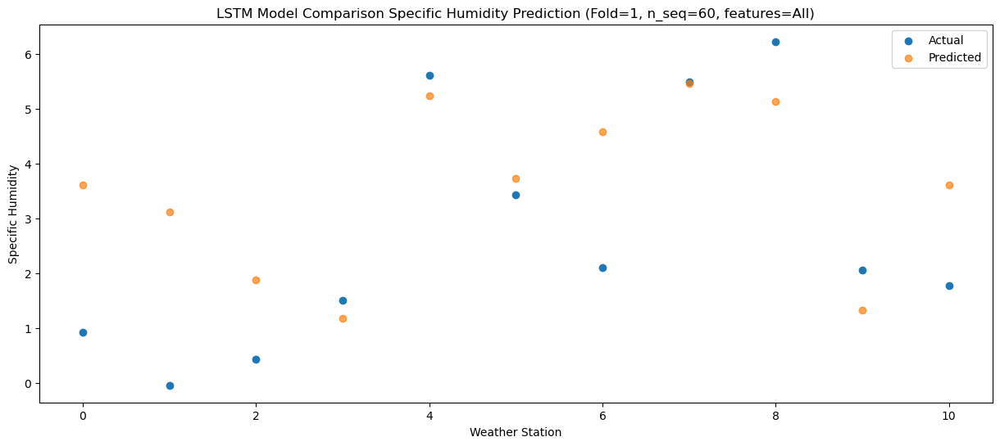

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    3.82   6.034796
1                 1    2.97   5.544796
2                 2    3.20   4.294796
3                 3    3.49   3.594796
4                 4    7.74   7.654796
5                 5    6.11   6.144796
6                 6    5.31   6.994796
7                 7    8.40   7.884796
8                 8    9.56   7.554796
9                 9    4.88   3.744796
10               10    4.34   6.034796


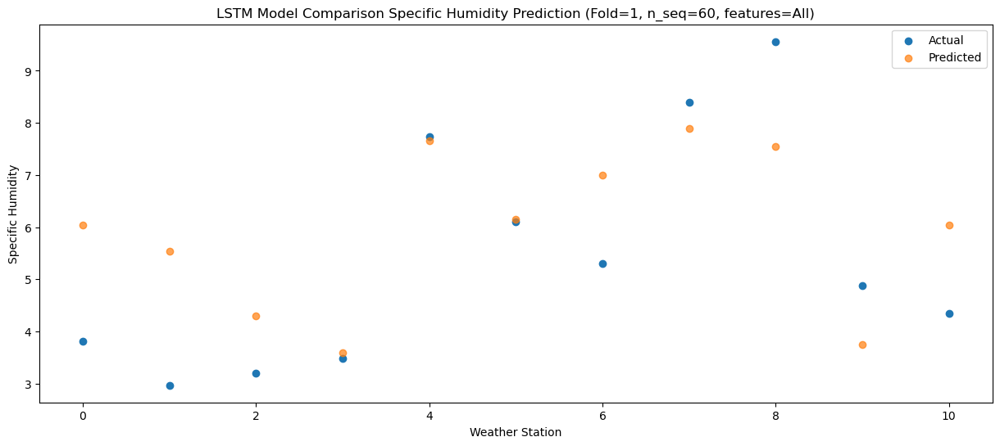

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.06   8.875568
1                 1    6.77   8.385568
2                 2    7.05   7.135568
3                 3    5.61   6.435568
4                 4   10.03  10.495568
5                 5    7.93   8.985568
6                 6    8.95   9.835568
7                 7   12.23  10.725568
8                 8   11.70  10.395568
9                 9    6.59   6.585568
10               10    7.98   8.875568


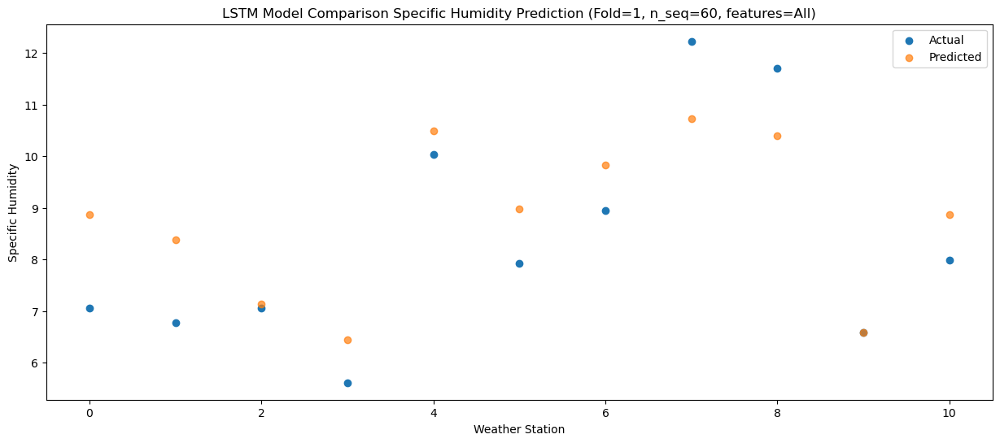

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    9.63  11.093557
1                 1    8.81  10.603557
2                 2    9.60   9.353557
3                 3    8.12   8.653557
4                 4   12.63  12.713557
5                 5    8.92  11.203557
6                 6   11.39  12.053557
7                 7   15.31  12.943557
8                 8   15.06  12.613557
9                 9    9.48   8.803557
10               10   11.62  11.093557


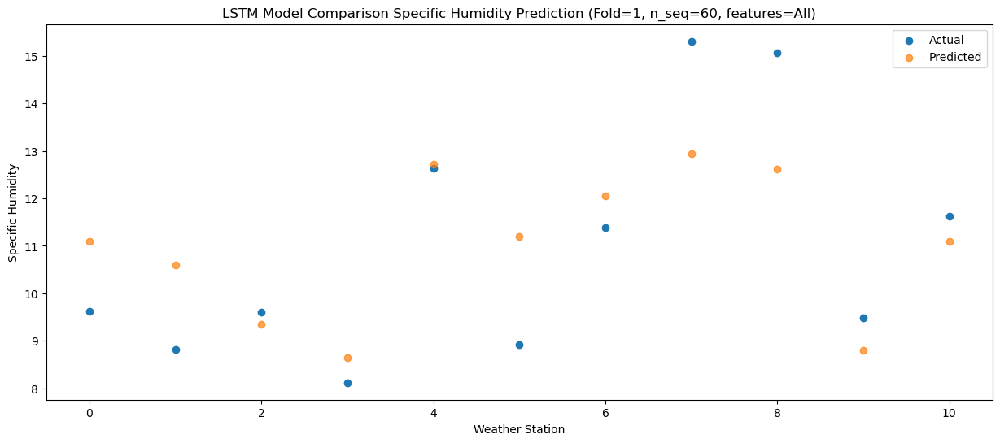

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.92   9.995515
1                 1    8.86   9.505515
2                 2    9.12   8.255515
3                 3    7.01   7.555515
4                 4   11.18  11.615515
5                 5    7.69  10.105515
6                 6   11.41  10.955515
7                 7   13.14  11.845515
8                 8   12.16  11.515515
9                 9    8.16   7.705515
10               10   11.53   9.995515


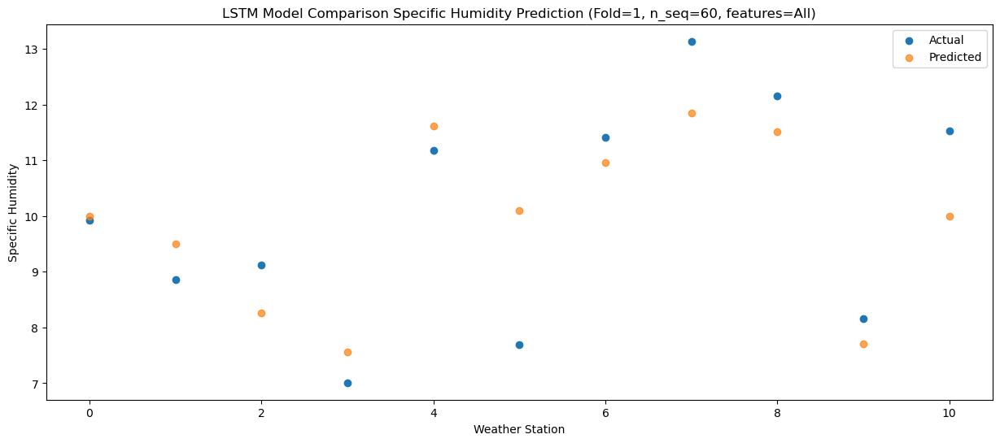

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.30   8.169218
1                 1    5.96   7.679218
2                 2    6.17   6.429218
3                 3    5.43   5.729218
4                 4    9.69   9.789218
5                 5    7.26   8.279218
6                 6    8.10   9.129218
7                 7   11.34  10.019218
8                 8   10.68   9.689218
9                 9    5.37   5.879218
10               10    8.05   8.169218


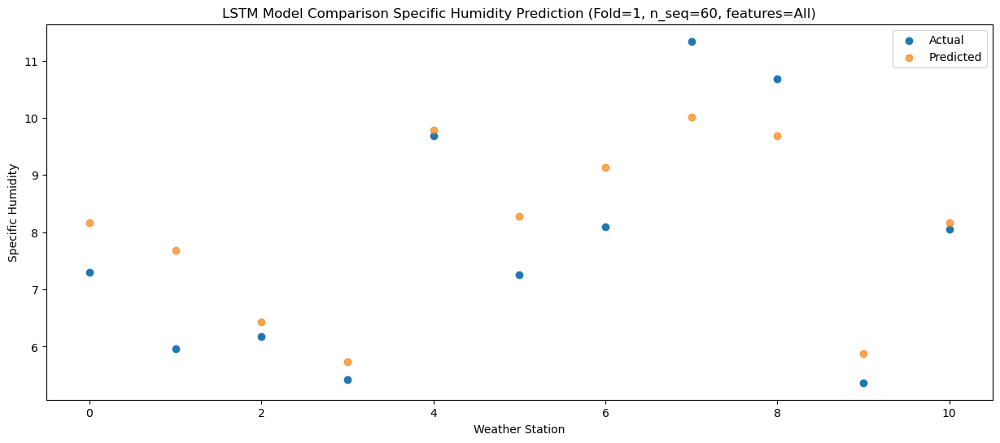

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.62   5.454303
1                 1    3.29   4.964303
2                 2    3.41   3.714303
3                 3    2.03   3.014303
4                 4    5.84   7.074303
5                 5    3.75   5.564303
6                 6    5.61   6.414303
7                 7    6.52   7.304303
8                 8    6.01   6.974303
9                 9    1.85   3.164303
10               10    5.13   5.454303


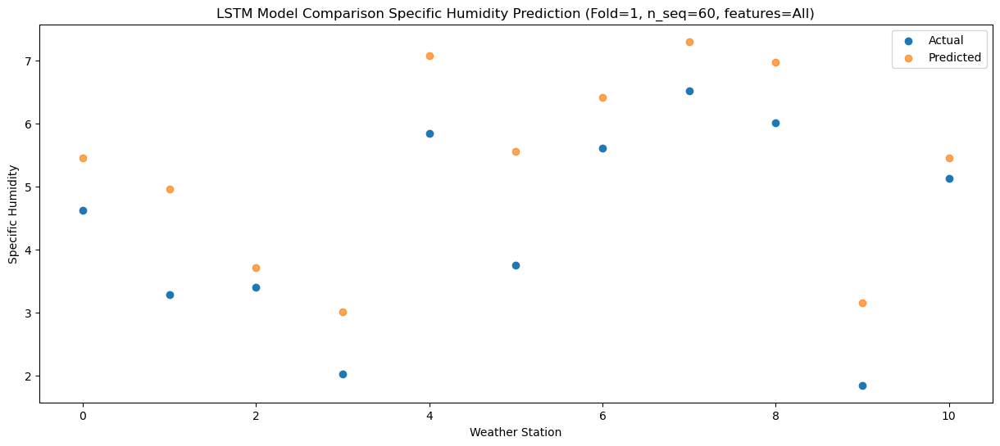

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.99   3.262949
1                 1    0.23   2.772949
2                 2    0.23   1.522949
3                 3   -0.07   0.822949
4                 4    3.36   4.882949
5                 5    3.19   3.372949
6                 6    2.50   4.222949
7                 7    4.50   5.112949
8                 8    4.90   4.782949
9                 9    1.53   0.972949
10               10    2.75   3.262949


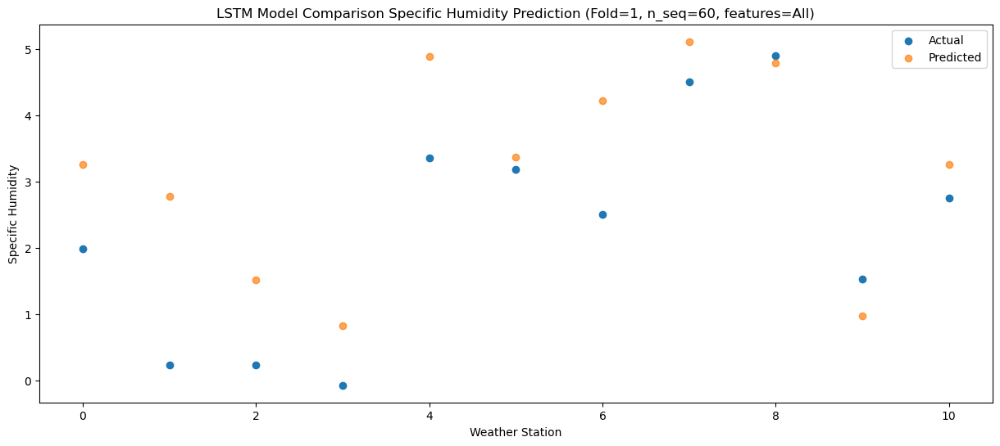

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.22   1.473908
1                 1   -2.36   0.983908
2                 2   -2.54  -0.266092
3                 3   -2.62  -0.966092
4                 4    0.54   3.093908
5                 5    0.75   1.583908
6                 6   -0.22   2.433908
7                 7    2.18   3.323908
8                 8    2.62   2.993908
9                 9   -0.33  -0.816092
10               10    0.59   1.473908


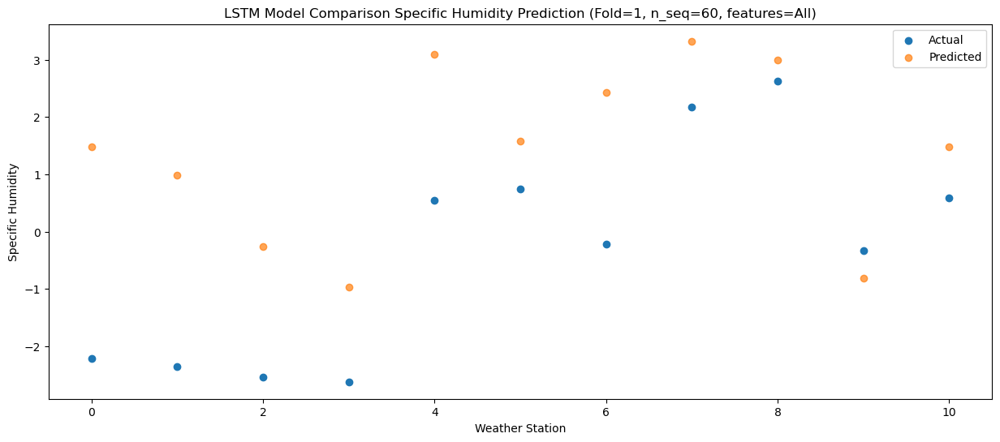

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.00   0.664865
1                 1   -2.34   0.174865
2                 2   -2.39  -1.075135
3                 3   -2.96  -1.775135
4                 4    0.29   2.284865
5                 5    1.58   0.774865
6                 6   -0.33   1.624865
7                 7    2.05   2.514865
8                 8    2.78   2.184865
9                 9   -0.14  -1.625135
10               10   -0.14   0.664865


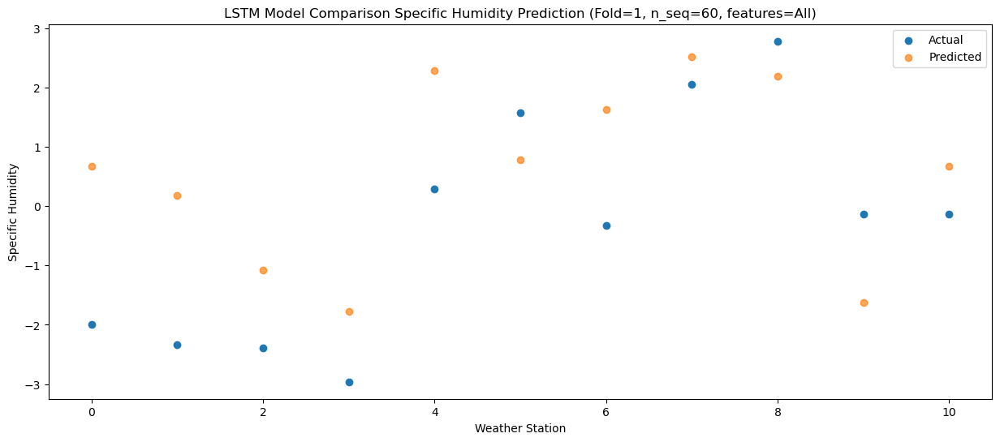

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.68     0.4653
1                 1   -2.15    -0.0247
2                 2   -2.39    -1.2747
3                 3   -2.89    -1.9747
4                 4    0.33     2.0853
5                 5    0.95     0.5753
6                 6   -0.21     1.4253
7                 7    1.53     2.3153
8                 8    1.97     1.9853
9                 9   -0.88    -1.8247
10               10   -0.10     0.4653


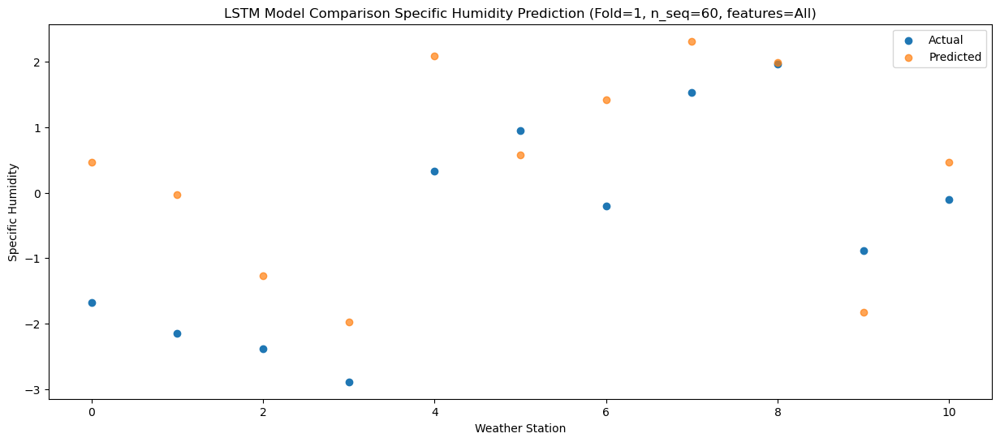

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.15   1.857044
1                 1   -0.62   1.367044
2                 2    0.23   0.117044
3                 3   -0.25  -0.582956
4                 4    3.05   3.477044
5                 5    1.74   1.967044
6                 6    1.35   2.817044
7                 7    4.26   3.707044
8                 8    4.58   3.377044
9                 9    0.94  -0.432956
10               10    1.14   1.857044


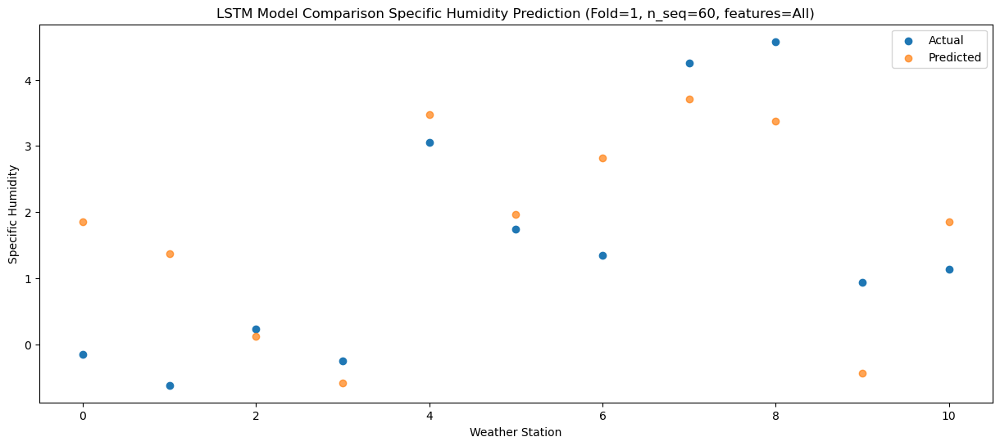

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.05   3.035598
1                 1   -0.26   2.545598
2                 2   -0.06   1.295598
3                 3    1.09   0.595598
4                 4    4.31   4.655598
5                 5    3.04   3.145598
6                 6    1.97   3.995598
7                 7    5.49   4.885598
8                 8    5.74   4.555598
9                 9    1.11   0.745598
10               10    2.51   3.035598


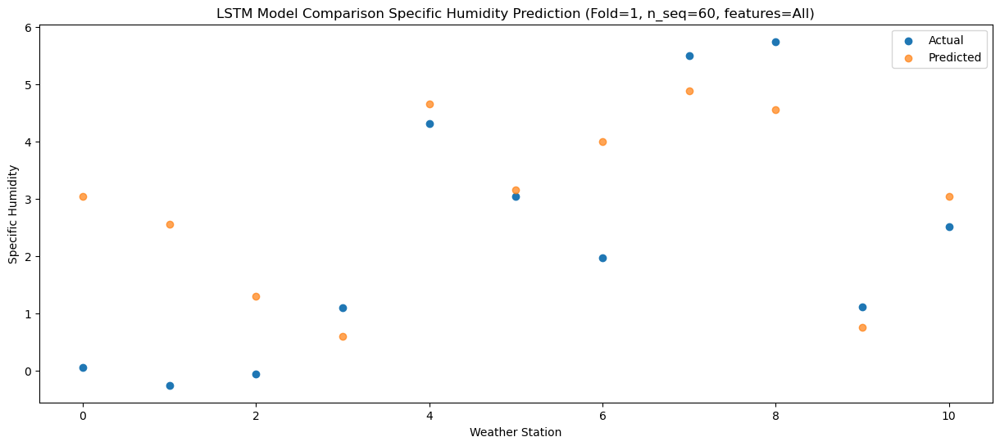

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    2.73   5.467611
1                 1    2.66   4.977611
2                 2    2.78   3.727611
3                 3    4.98   3.027611
4                 4    8.34   7.087611
5                 5    7.35   5.577611
6                 6    4.90   6.427611
7                 7    8.70   7.317611
8                 8    9.96   6.987611
9                 9    6.26   3.177611
10               10    4.04   5.467611


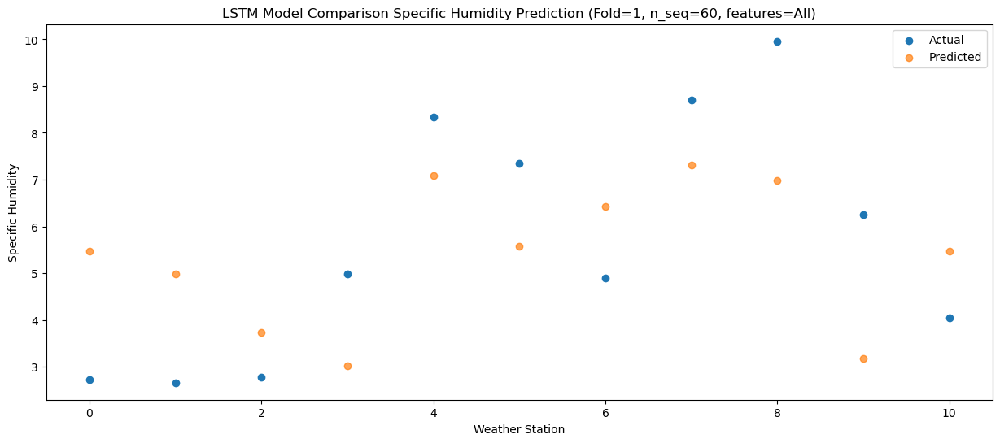

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.89   9.410757
1                 1    6.64   8.920757
2                 2    7.30   7.670757
3                 3    8.17   6.970757
4                 4   11.75  11.030757
5                 5    9.52   9.520757
6                 6    9.25  10.370757
7                 7   13.46  11.260757
8                 8   13.10  10.930757
9                 9    9.25   7.120757
10               10    9.36   9.410757


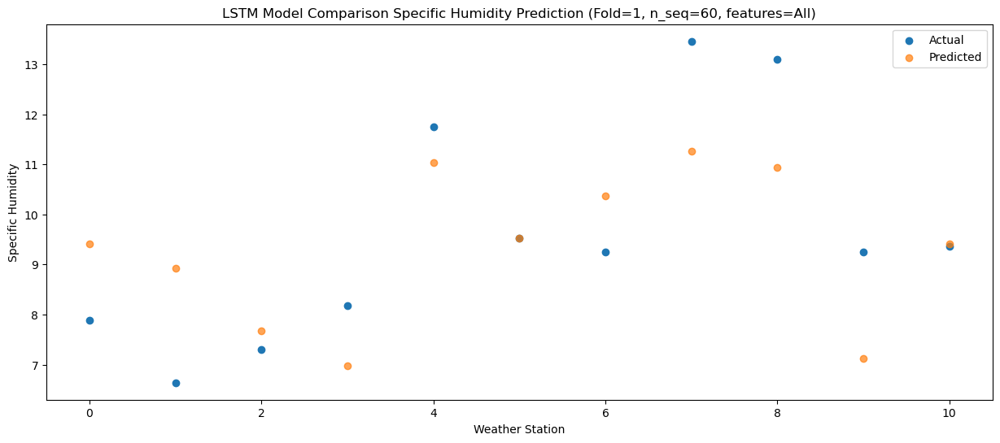

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.04   10.76129
1                 1    8.51   10.27129
2                 2    8.89    9.02129
3                 3    8.65    8.32129
4                 4   11.93   12.38129
5                 5   10.85   10.87129
6                 6   11.75   11.72129
7                 7   14.09   12.61129
8                 8   14.15   12.28129
9                 9   10.49    8.47129
10               10   11.22   10.76129


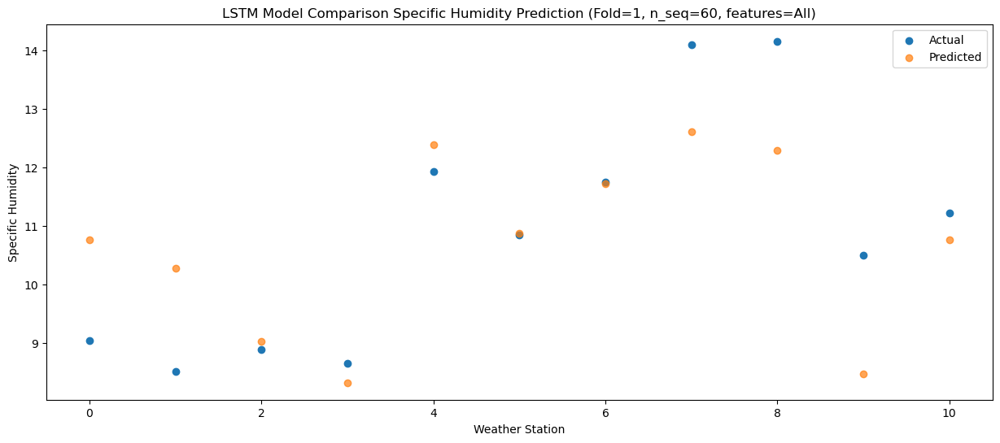

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.80  11.332262
1                 1    8.72  10.842262
2                 2    9.11   9.592262
3                 3    8.99   8.892262
4                 4   11.97  12.952262
5                 5   11.07  11.442262
6                 6   12.04  12.292262
7                 7   13.94  13.182262
8                 8   13.73  12.852262
9                 9    9.46   9.042262
10               10   11.56  11.332262


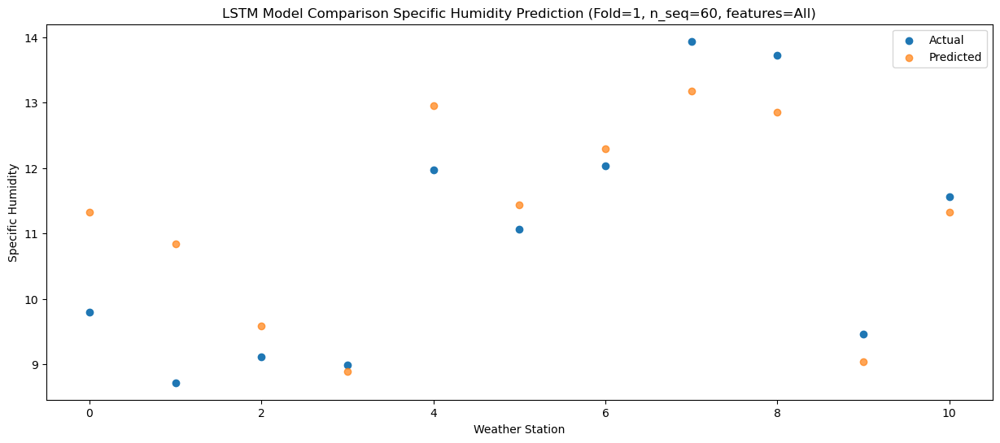

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    6.32   8.469384
1                 1    5.77   7.979384
2                 2    6.35   6.729384
3                 3    5.90   6.029384
4                 4    8.87  10.089384
5                 5    7.53   8.579384
6                 6    8.69   9.429384
7                 7   10.69  10.319384
8                 8   10.16   9.989384
9                 9    6.50   6.179384
10               10    8.37   8.469384


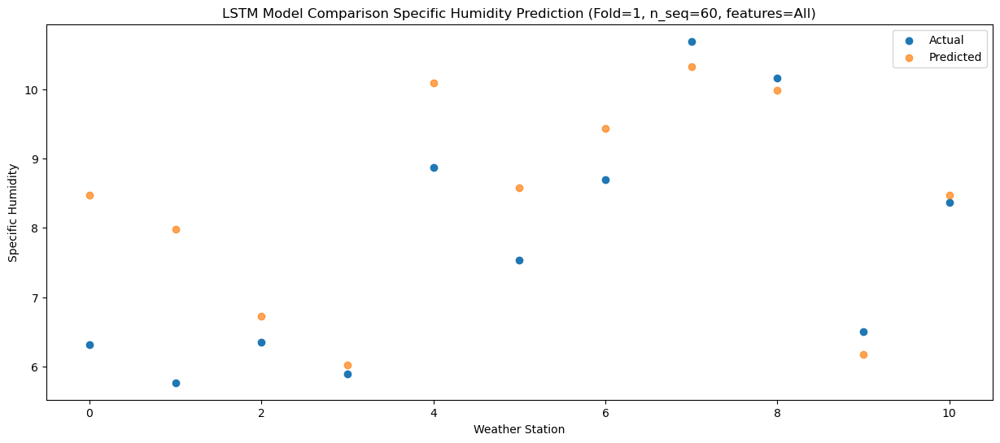

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.74   5.864896
1                 1    3.73   5.374896
2                 2    3.60   4.124896
3                 3    3.65   3.424896
4                 4    6.92   7.484896
5                 5    4.42   5.974896
6                 6    6.56   6.824896
7                 7    7.96   7.714896
8                 8    7.72   7.384896
9                 9    3.06   3.574896
10               10    6.51   5.864896


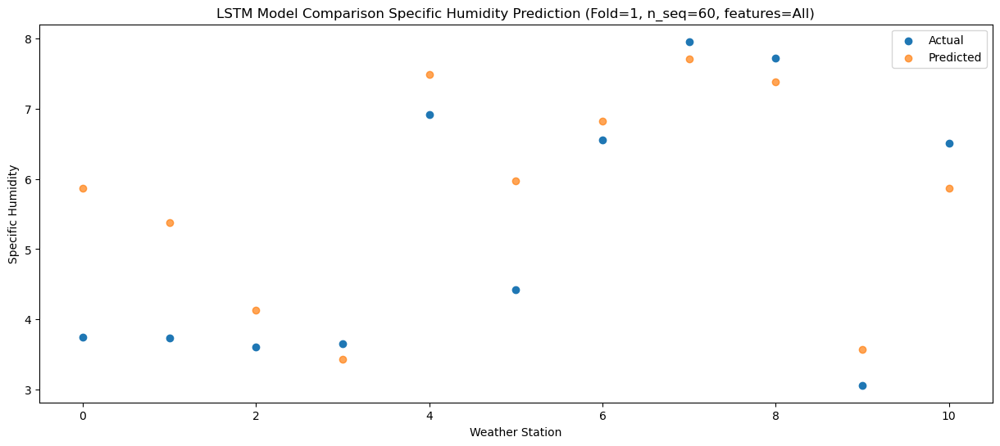

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.92   2.366306
1                 1   -1.86   1.876306
2                 2   -1.90   0.626306
3                 3   -0.80  -0.073694
4                 4    2.33   3.986306
5                 5    2.58   2.476306
6                 6    0.63   3.326306
7                 7    3.40   4.216306
8                 8    4.19   3.886306
9                 9    0.70   0.076306
10               10    1.32   2.366306


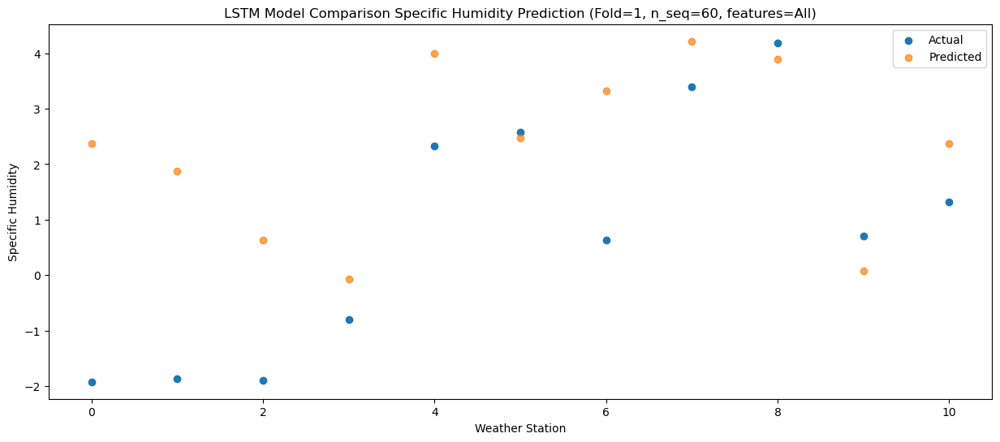

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.19   2.536806
1                 1    0.31   2.046806
2                 2    0.74   0.796806
3                 3    2.12   0.096806
4                 4    5.26   4.156806
5                 5    1.53   2.646806
6                 6    2.50   3.496806
7                 7    5.04   4.386806
8                 8    3.58   4.056806
9                 9   -0.28   0.246806
10               10    1.20   2.536806


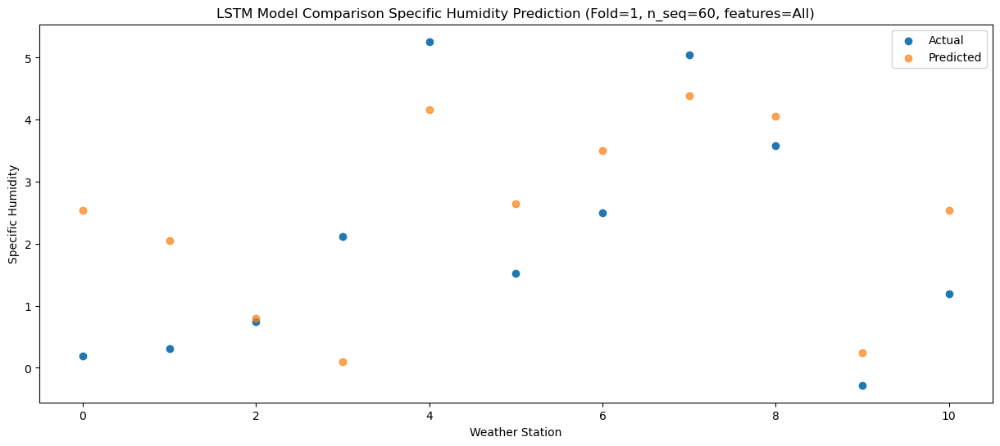

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.06   0.680919
1                 1   -2.69   0.190919
2                 2   -3.14  -1.059081
3                 3   -3.53  -1.759081
4                 4   -0.28   2.300919
5                 5    0.26   0.790919
6                 6   -0.50   1.640919
7                 7    1.29   2.530919
8                 8    1.60   2.200919
9                 9   -0.92  -1.609081
10               10   -0.41   0.680919


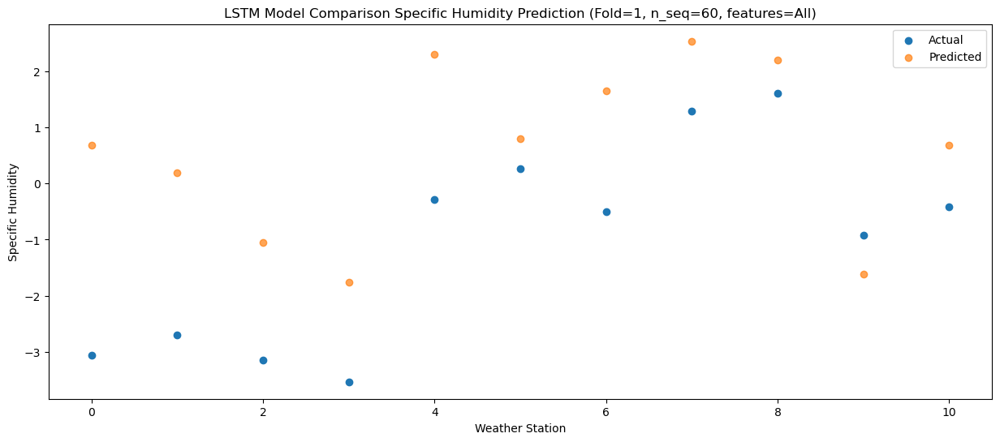

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.12   1.503322
1                 1   -1.74   1.013322
2                 2   -2.11  -0.236678
3                 3   -3.36  -0.936678
4                 4   -0.08   3.123322
5                 5    0.14   1.613322
6                 6    0.63   2.463322
7                 7    1.97   3.353322
8                 8    2.13   3.023322
9                 9   -1.00  -0.786678
10               10    0.33   1.503322


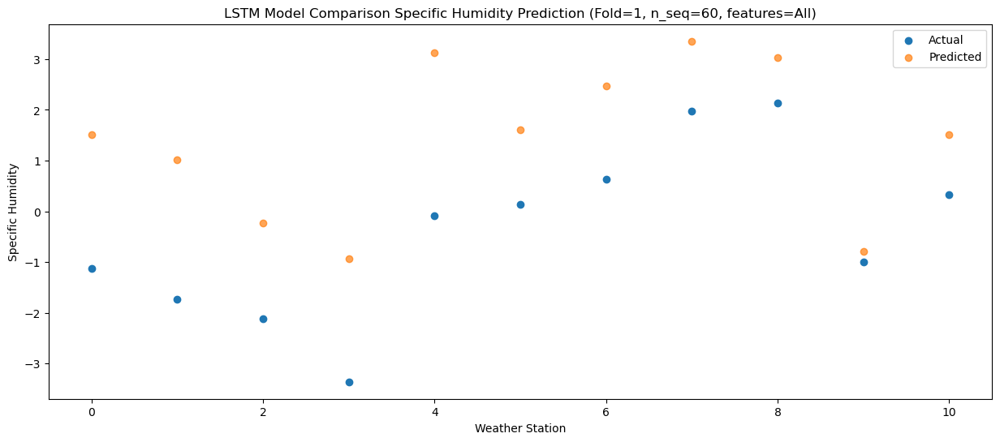

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.01    2.25553
1                 1   -1.06    1.76553
2                 2   -1.32    0.51553
3                 3   -1.68   -0.18447
4                 4    1.62    3.87553
5                 5    0.69    2.36553
6                 6    1.38    3.21553
7                 7    3.50    4.10553
8                 8    3.22    3.77553
9                 9   -0.04   -0.03447
10               10    1.35    2.25553


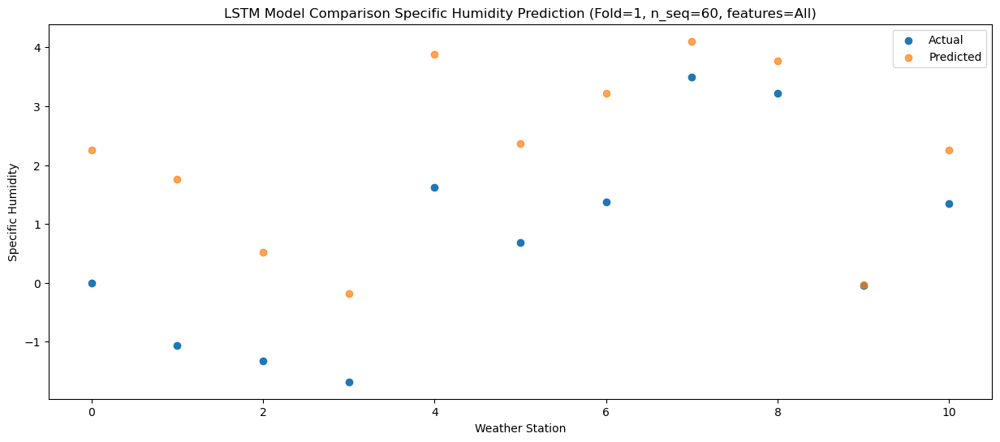

Predictions for (t+29):
    Weather_Station        Actual  Predicted
0                 0  1.010000e+00   3.214971
1                 1  1.332268e-15   2.724971
2                 2  4.400000e-01   1.474971
3                 3  2.480000e+00   0.774971
4                 4  5.720000e+00   4.834971
5                 5  2.960000e+00   3.324971
6                 6  2.570000e+00   4.174971
7                 7  5.690000e+00   5.064971
8                 8  6.340000e+00   4.734971
9                 9  9.300000e-01   0.924971
10               10  2.010000e+00   3.214971


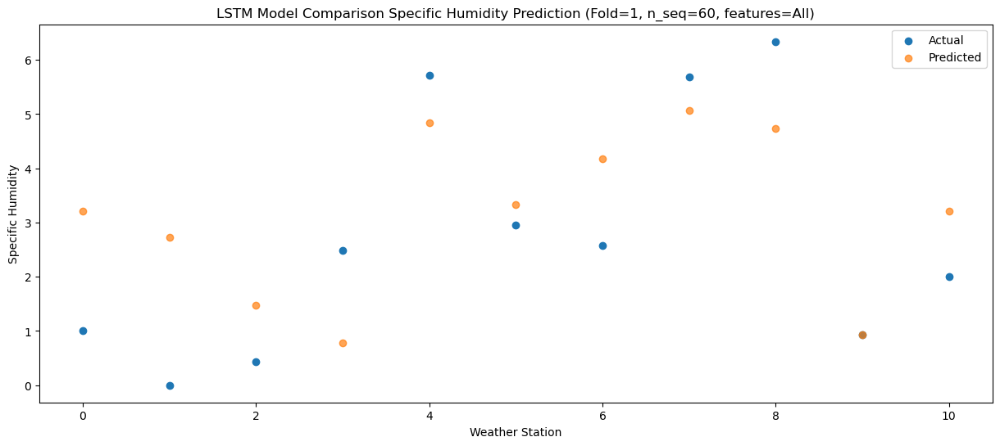

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    4.99   6.535619
1                 1    4.17   6.045619
2                 2    4.80   4.795619
3                 3    6.29   4.095619
4                 4    9.60   8.155619
5                 5    4.73   6.645619
6                 6    6.83   7.495619
7                 7   10.14   8.385619
8                 8   10.58   8.055619
9                 9    3.49   4.245619
10               10    6.14   6.535619


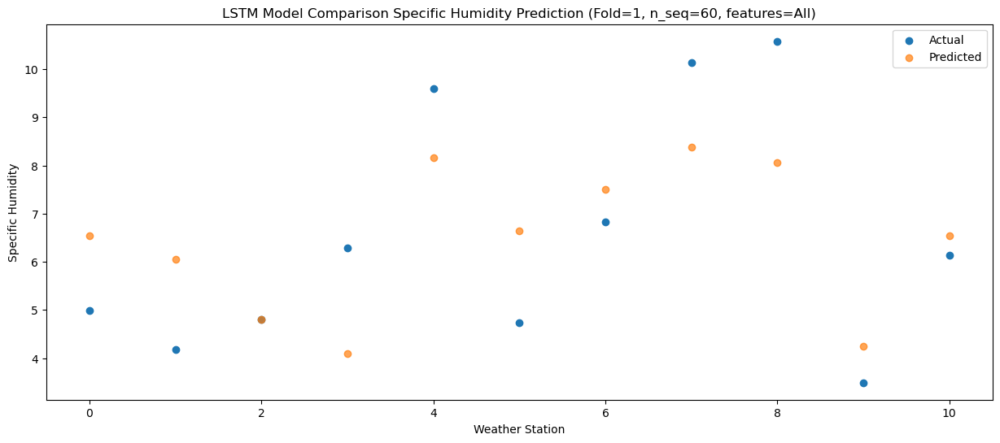

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    7.29   8.172593
1                 1    6.57   7.682593
2                 2    7.89   6.432593
3                 3    7.34   5.732593
4                 4   10.72   9.792593
5                 5    7.33   8.282593
6                 6    9.55   9.132593
7                 7   12.90  10.022593
8                 8   12.48   9.692593
9                 9    7.67   5.882593
10               10    7.73   8.172593


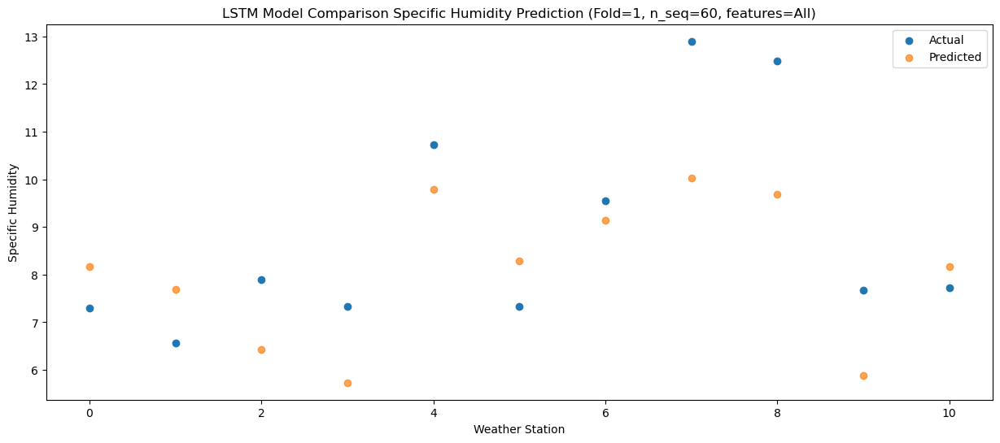

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    9.91  10.555016
1                 1    9.24  10.065016
2                 2    9.52   8.815016
3                 3    8.26   8.115016
4                 4   11.47  12.175016
5                 5    8.28  10.665016
6                 6   12.54  11.515016
7                 7   13.87  12.405016
8                 8   11.84  12.075016
9                 9    8.32   8.265016
10               10   11.36  10.555016


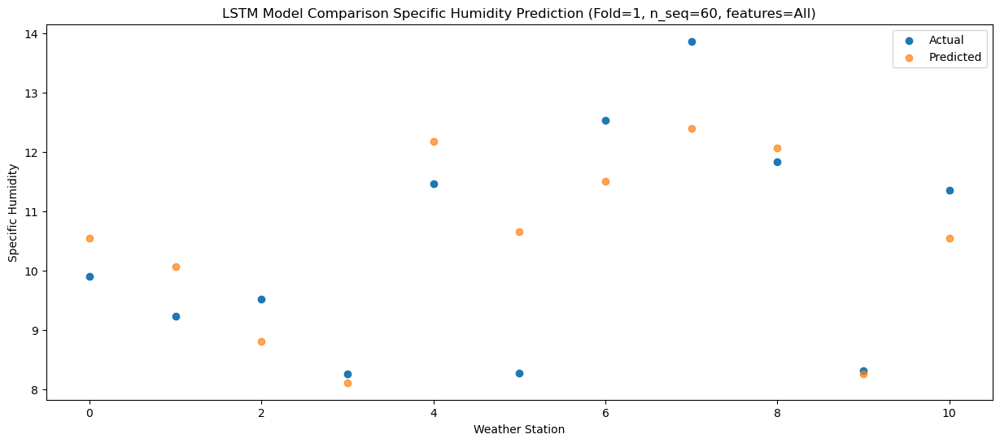

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.91  10.636421
1                 1    8.83  10.146421
2                 2    8.65   8.896421
3                 3    8.51   8.196421
4                 4   11.85  12.256421
5                 5   10.39  10.746421
6                 6   11.45  11.596421
7                 7   13.78  12.486421
8                 8   12.58  12.156421
9                 9    8.73   8.346421
10               10   10.93  10.636421


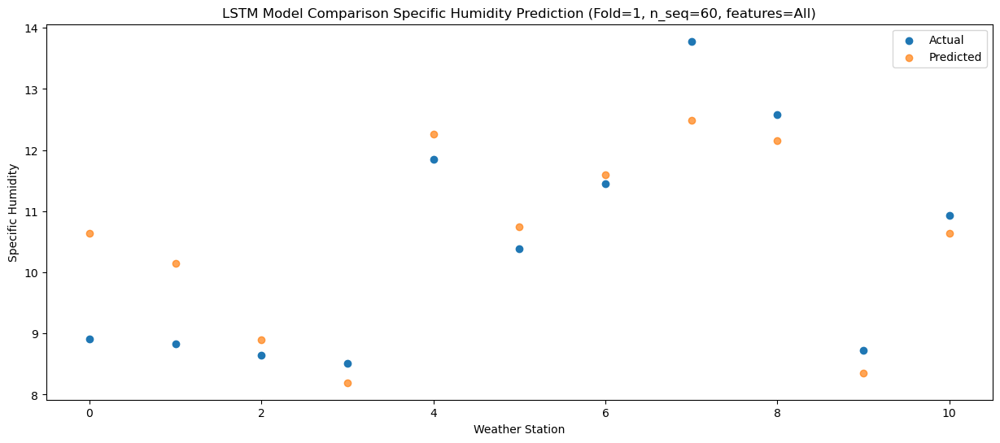

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.29   7.629895
1                 1    5.47   7.139895
2                 2    5.14   5.889895
3                 3    5.22   5.189895
4                 4    8.50   9.249895
5                 5    9.12   7.739895
6                 6    7.97   8.589895
7                 7    9.82   9.479895
8                 8    9.84   9.149895
9                 9    6.73   5.339895
10               10    7.68   7.629895


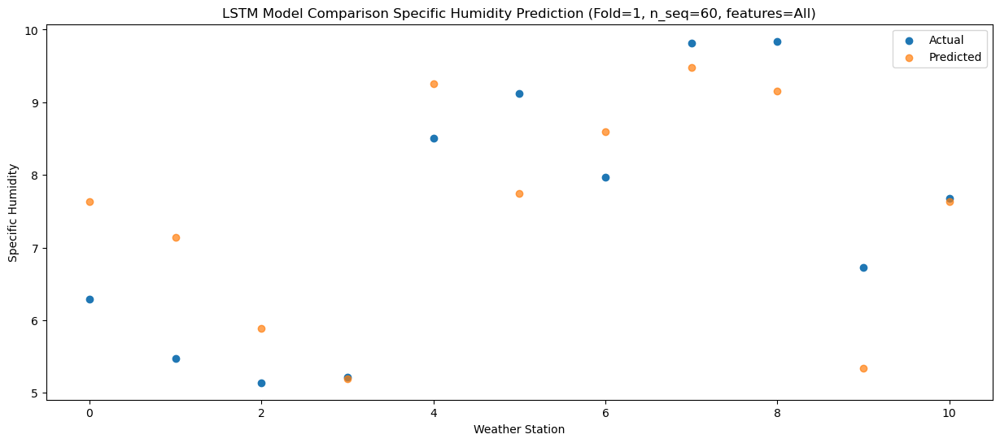

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    1.43   4.579704
1                 1    0.58   4.089704
2                 2    0.03   2.839704
3                 3    0.26   2.139704
4                 4    3.60   6.199704
5                 5    5.93   4.689704
6                 6    2.91   5.539704
7                 7    5.28   6.429704
8                 8    5.89   6.099704
9                 9    3.34   2.289704
10               10    4.24   4.579704


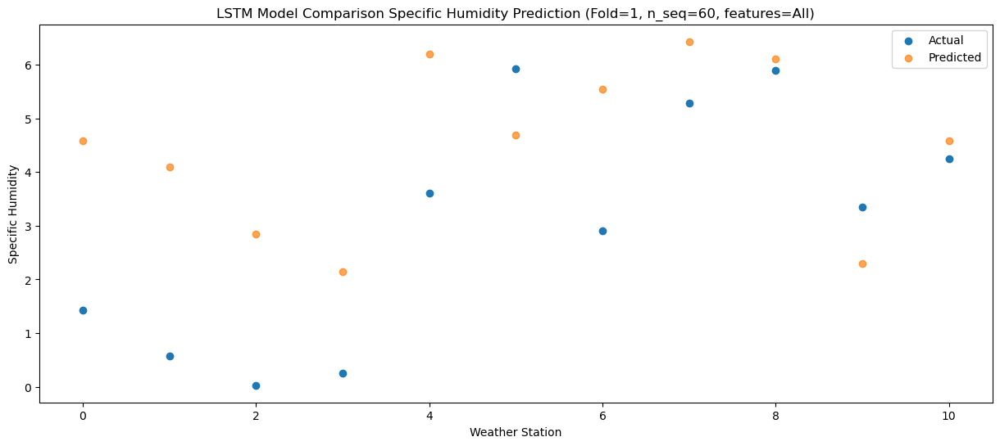

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.90   2.795494
1                 1    0.10   2.305494
2                 2   -0.34   1.055494
3                 3   -0.24   0.355494
4                 4    3.22   4.415494
5                 5    3.06   2.905494
6                 6    2.42   3.755494
7                 7    4.03   4.645494
8                 8    4.91   4.315494
9                 9    1.36   0.505494
10               10    2.74   2.795494


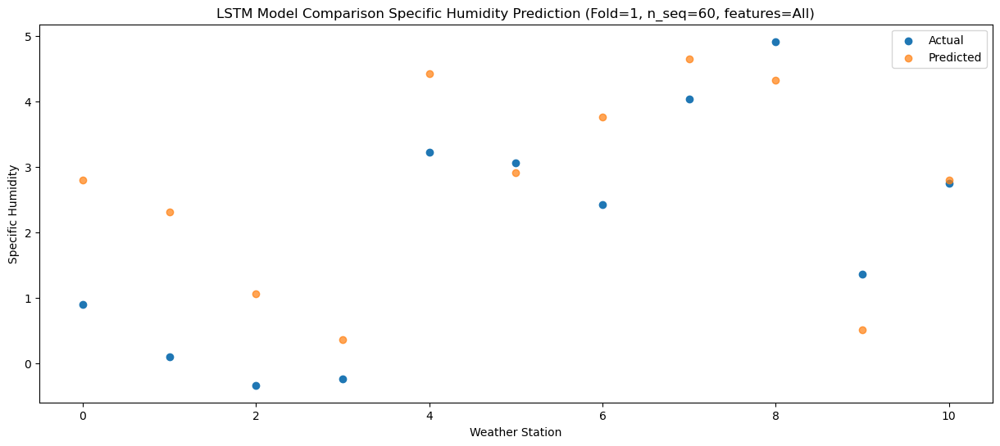

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.82   1.746985
1                 1   -1.49   1.256985
2                 2   -1.03   0.006985
3                 3   -1.05  -0.693015
4                 4    2.40   3.366985
5                 5    2.39   1.856985
6                 6    0.52   2.706985
7                 7    3.12   3.596985
8                 8    3.17   3.266985
9                 9    0.15  -0.543015
10               10    0.61   1.746985


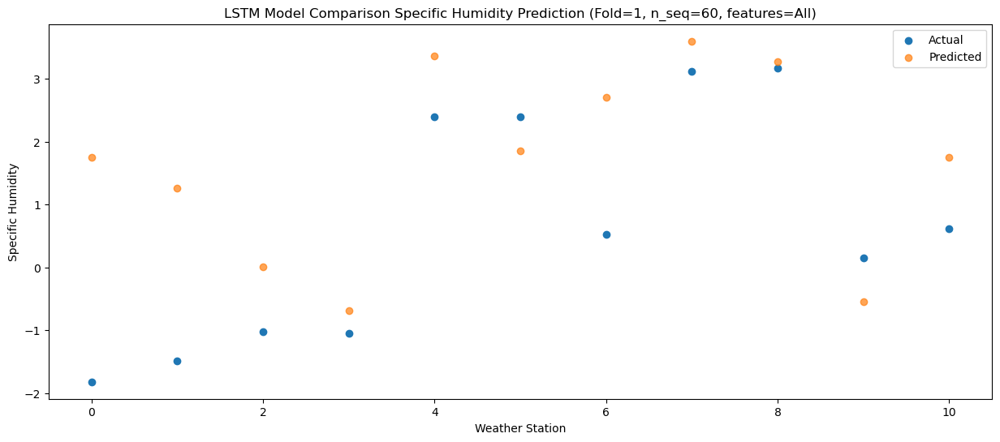

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -1.36   2.341263
1                 1   -1.08   1.851263
2                 2   -1.06   0.601263
3                 3   -1.47  -0.098737
4                 4    1.92   3.961263
5                 5    0.84   2.451263
6                 6    0.88   3.301263
7                 7    3.24   4.191263
8                 8    2.69   3.861263
9                 9   -0.16   0.051263
10               10    1.47   2.341263


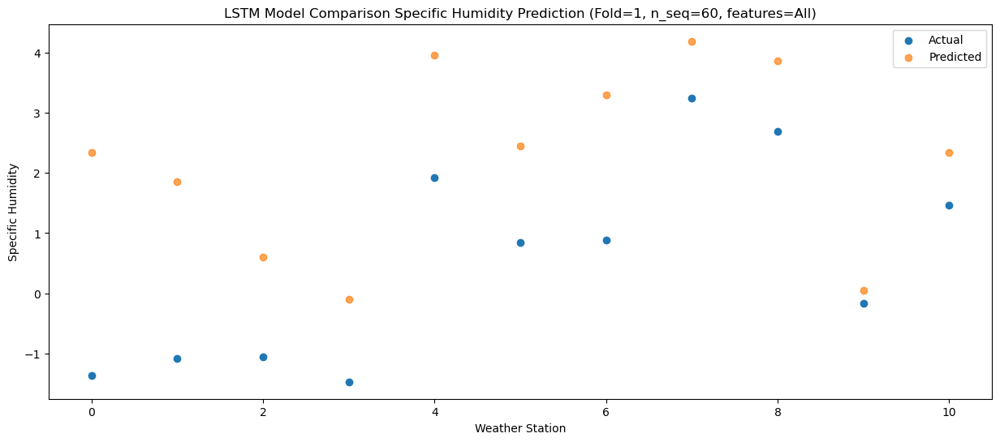

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.25    2.00407
1                 1    0.04    1.51407
2                 2   -0.01    0.26407
3                 3   -0.69   -0.43593
4                 4    2.52    3.62407
5                 5    0.87    2.11407
6                 6    2.08    2.96407
7                 7    3.34    3.85407
8                 8    3.02    3.52407
9                 9   -0.30   -0.28593
10               10    0.67    2.00407


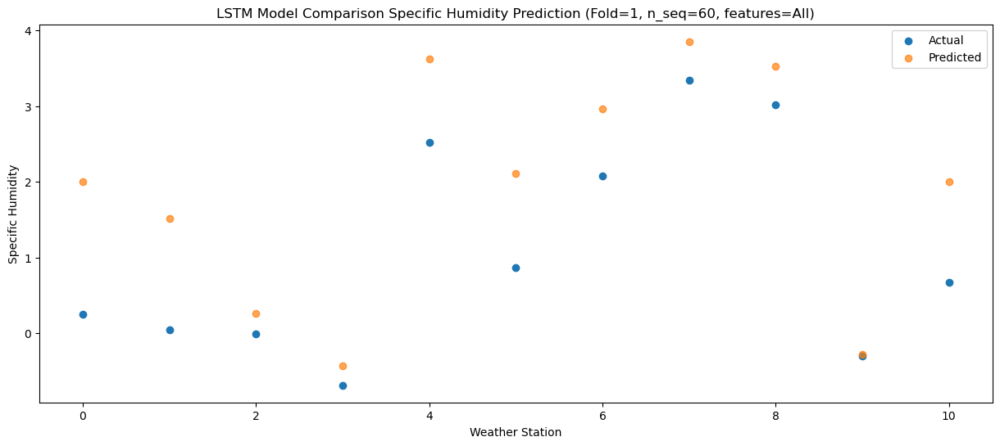

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.13   2.528589
1                 1   -0.83   2.038589
2                 2   -0.48   0.788589
3                 3    0.86   0.088589
4                 4    4.22   4.148589
5                 5    1.92   2.638589
6                 6    1.32   3.488589
7                 7    4.10   4.378589
8                 8    4.44   4.048589
9                 9    0.49   0.238589
10               10    0.70   2.528589


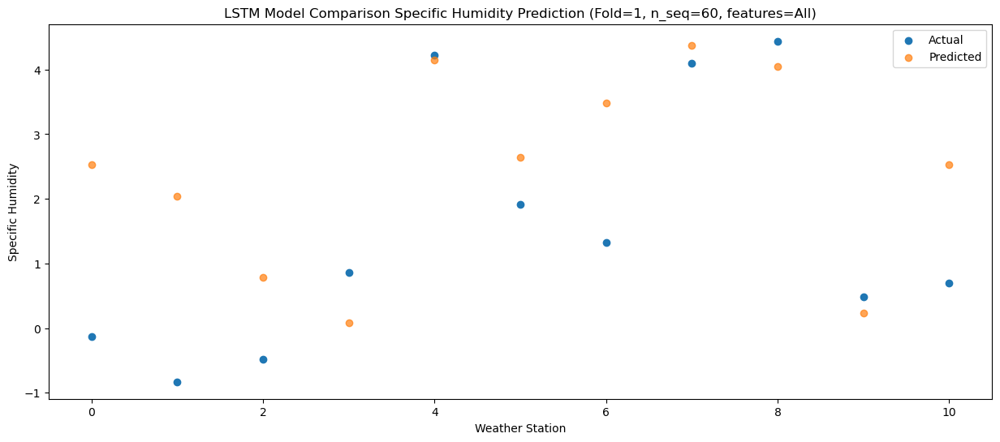

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.57   3.953252
1                 1    0.77   3.463252
2                 2    0.88   2.213252
3                 3    1.23   1.513252
4                 4    4.67   5.573252
5                 5    2.18   4.063252
6                 6    3.13   4.913252
7                 7    5.30   5.803252
8                 8    5.66   5.473252
9                 9    1.01   1.663252
10               10    3.31   3.953252


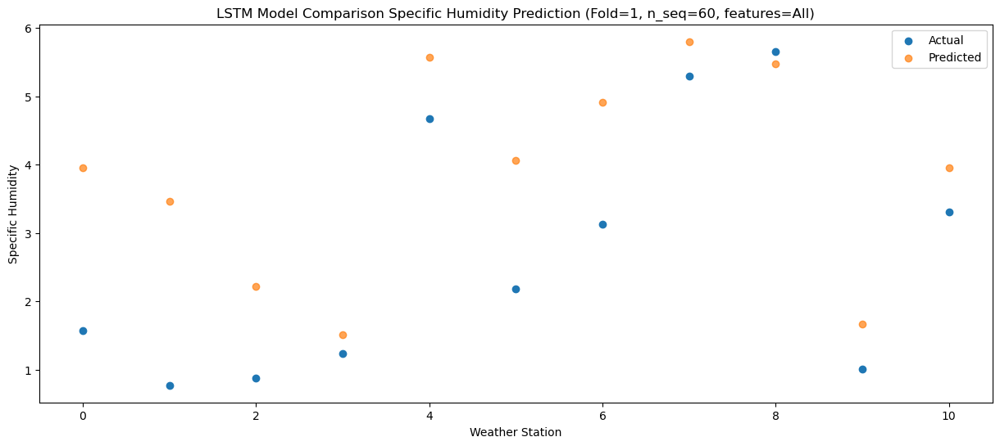

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.77   6.121962
1                 1    3.51   5.631962
2                 2    4.18   4.381962
3                 3    5.01   3.681962
4                 4    8.34   7.741962
5                 5    6.55   6.231962
6                 6    5.69   7.081962
7                 7    9.34   7.971962
8                 8   10.71   7.641962
9                 9    6.74   3.831962
10               10    3.61   6.121962


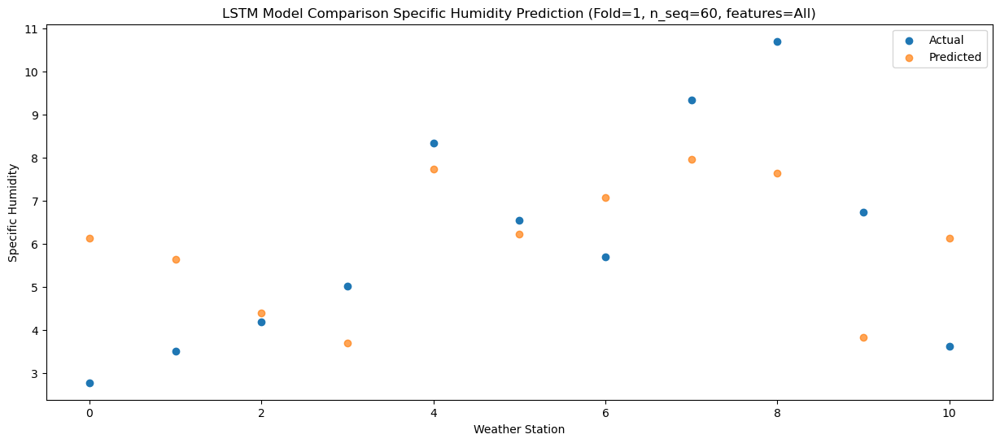

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.12   9.175679
1                 1    5.86   8.685679
2                 2    6.83   7.435679
3                 3    8.41   6.735679
4                 4   11.60  10.795679
5                 5    6.50   9.285679
6                 6    8.27  10.135679
7                 7   12.26  11.025679
8                 8   13.29  10.695679
9                 9    8.35   6.885679
10               10    6.90   9.175679


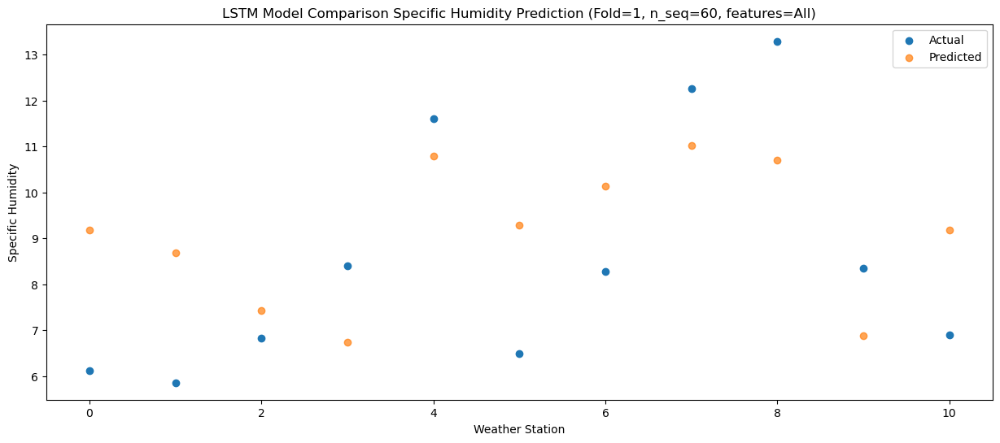

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    9.53  11.377353
1                 1    8.82  10.887353
2                 2    9.97   9.637353
3                 3    8.97   8.937353
4                 4   11.68  12.997353
5                 5    8.67  11.487353
6                 6   11.89  12.337353
7                 7   14.83  13.227353
8                 8   13.52  12.897353
9                 9   10.28   9.087353
10               10   11.61  11.377353


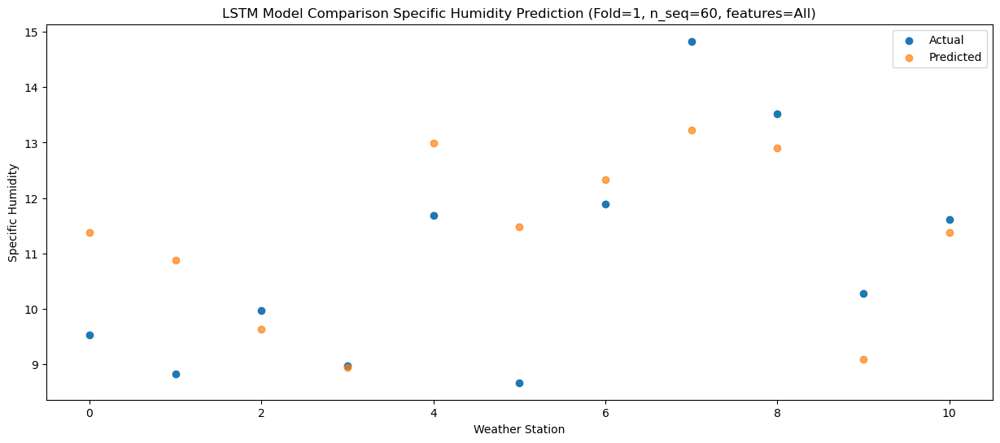

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.36  10.342863
1                 1    8.95   9.852863
2                 2    9.90   8.602863
3                 3    7.30   7.902863
4                 4   10.28  11.962863
5                 5    8.82  10.452863
6                 6   11.78  11.302863
7                 7   14.41  12.192863
8                 8   11.69  11.862863
9                 9    8.37   8.052863
10               10    9.32  10.342863


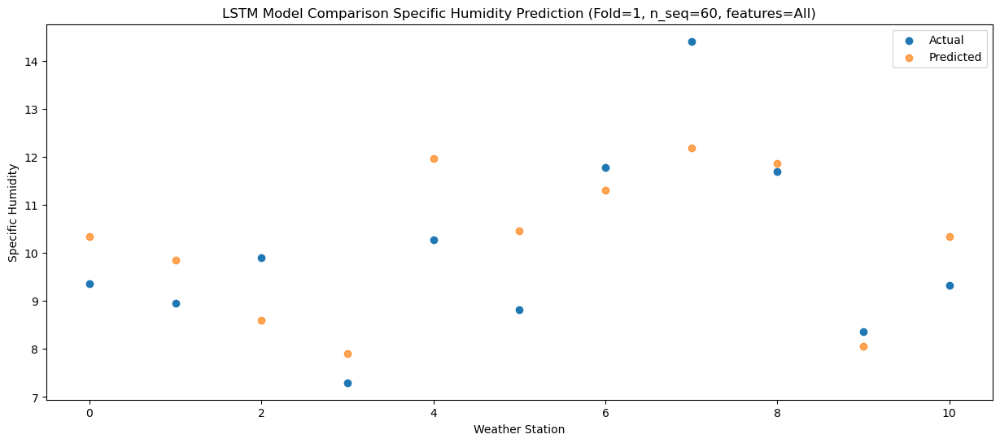

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.50   8.815081
1                 1    5.84   8.325081
2                 2    6.09   7.075081
3                 3    6.10   6.375081
4                 4    9.53  10.435081
5                 5    8.46   8.925081
6                 6    8.81   9.775081
7                 7    9.92  10.665081
8                 8   10.74  10.335081
9                 9    6.72   6.525081
10               10    8.06   8.815081


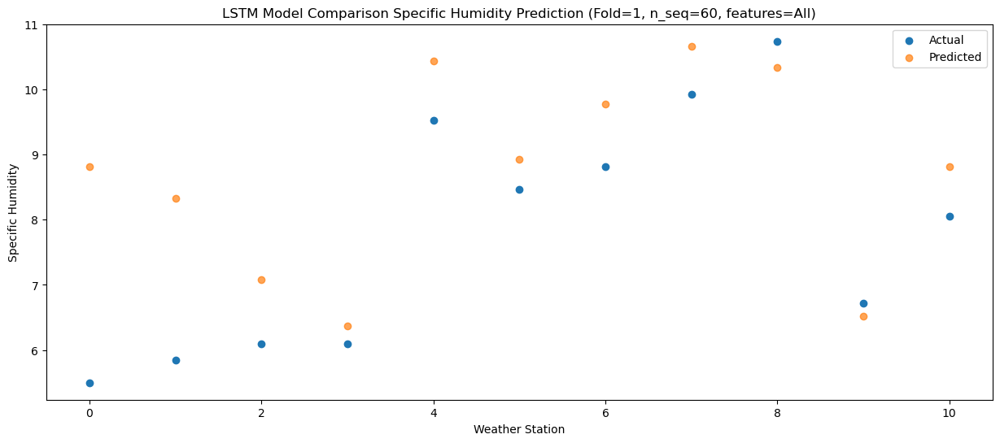

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.10   5.771908
1                 1    1.99   5.281908
2                 2    1.58   4.031908
3                 3    2.68   3.331908
4                 4    6.14   7.391908
5                 5    6.48   5.881908
6                 6    4.56   6.731908
7                 7    6.67   7.621908
8                 8    7.31   7.291908
9                 9    3.61   3.481908
10               10    5.01   5.771908


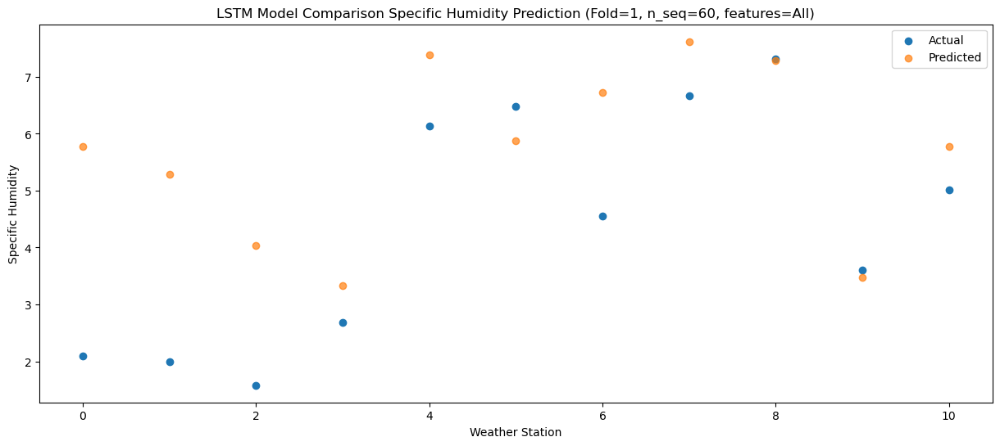

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.96   2.342106
1                 1   -1.02   1.852106
2                 2   -0.97   0.602106
3                 3   -0.65  -0.097894
4                 4    2.80   3.962106
5                 5    3.85   2.452106
6                 6    1.21   3.302106
7                 7    3.96   4.192106
8                 8    4.64   3.862106
9                 9    1.29   0.052106
10               10    1.35   2.342106


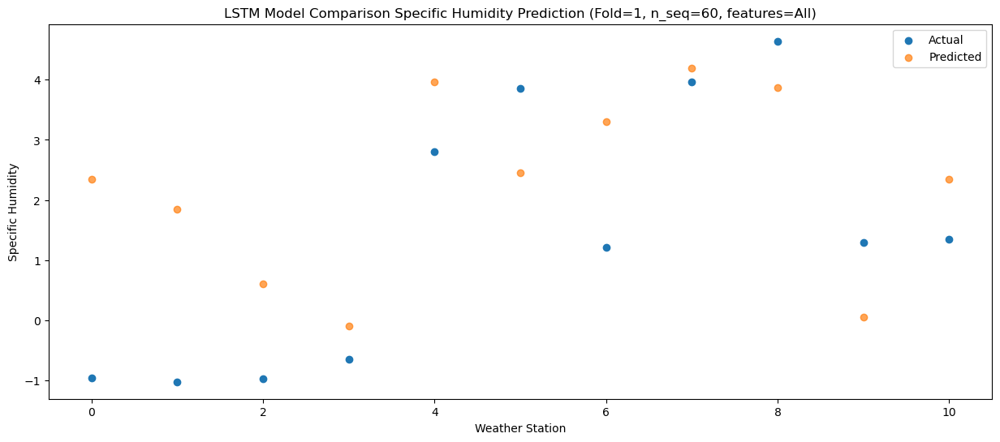

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.71   2.215876
1                 1   -1.60   1.725876
2                 2   -1.99   0.475876
3                 3   -2.29  -0.224124
4                 4    1.08   3.835876
5                 5    1.98   2.325876
6                 6    0.71   3.175876
7                 7    2.57   4.065876
8                 8    3.59   3.735876
9                 9    0.85  -0.074124
10               10    1.59   2.215876


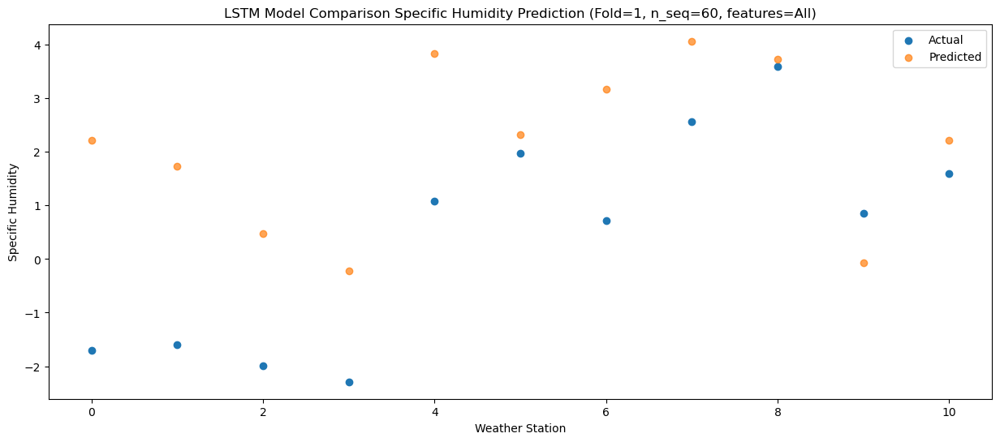

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.10    1.30448
1                 1   -2.37    0.81448
2                 2   -2.62   -0.43552
3                 3   -3.39   -1.13552
4                 4   -0.09    2.92448
5                 5    0.83    1.41448
6                 6   -0.11    2.26448
7                 7    1.50    3.15448
8                 8    2.28    2.82448
9                 9    0.11   -0.98552
10               10    0.54    1.30448


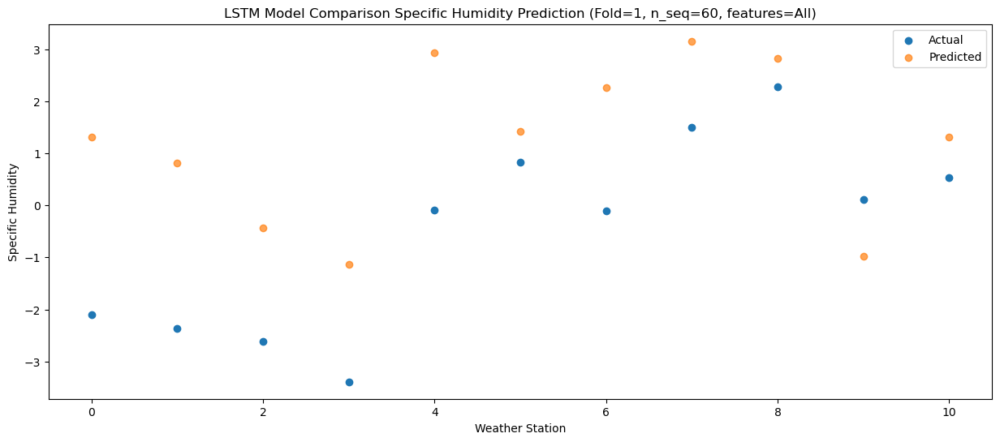

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -2.49   1.975503
1                 1   -2.03   1.485503
2                 2   -1.82   0.235503
3                 3   -1.14  -0.464497
4                 4    2.16   3.595503
5                 5    1.24   2.085503
6                 6    0.37   2.935503
7                 7    3.25   3.825503
8                 8    4.03   3.495503
9                 9    0.78  -0.314497
10               10    0.41   1.975503


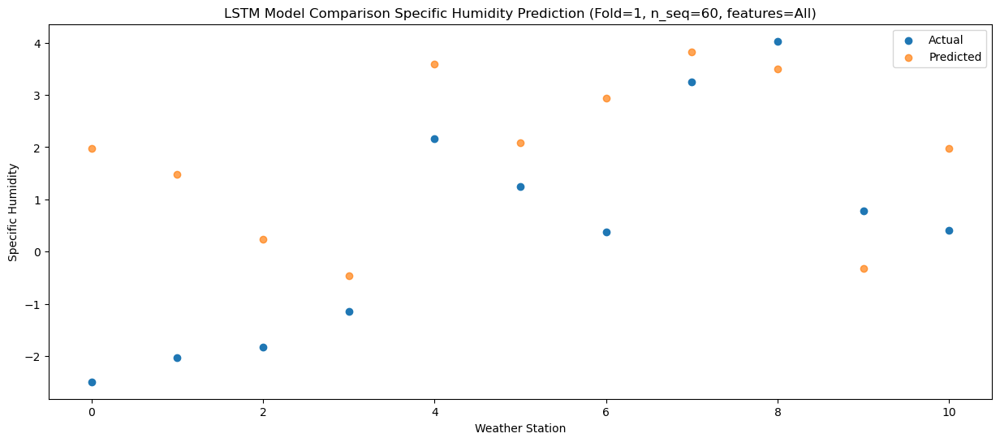

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.08   2.876235
1                 1   -0.52   2.386235
2                 2   -0.28   1.136235
3                 3    0.77   0.436235
4                 4    4.09   4.496235
5                 5    2.20   2.986235
6                 6    1.71   3.836235
7                 7    4.44   4.726235
8                 8    5.58   4.396235
9                 9    1.09   0.586235
10               10    1.44   2.876235


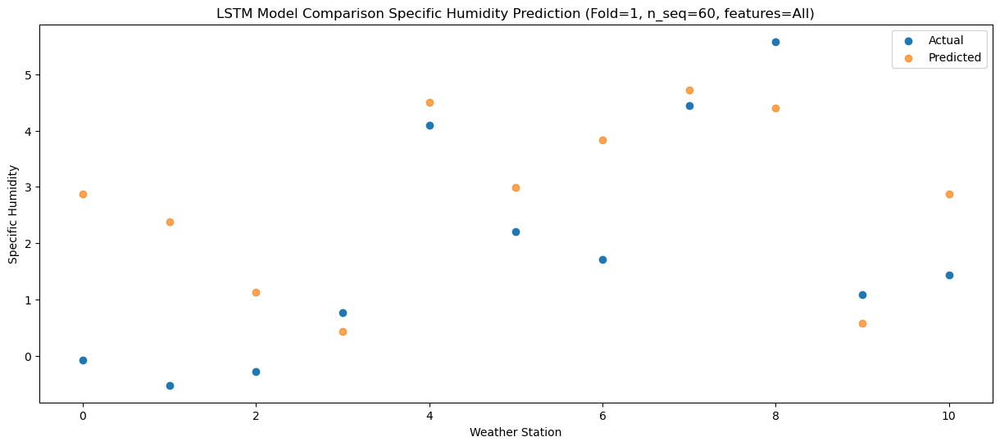

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    0.99   4.018378
1                 1    1.37   3.528378
2                 2    1.71   2.278378
3                 3    3.02   1.578378
4                 4    6.29   5.638378
5                 5    2.84   4.128378
6                 6    3.86   4.978378
7                 7    6.21   5.868378
8                 8    7.90   5.538378
9                 9    1.95   1.728378
10               10    3.05   4.018378


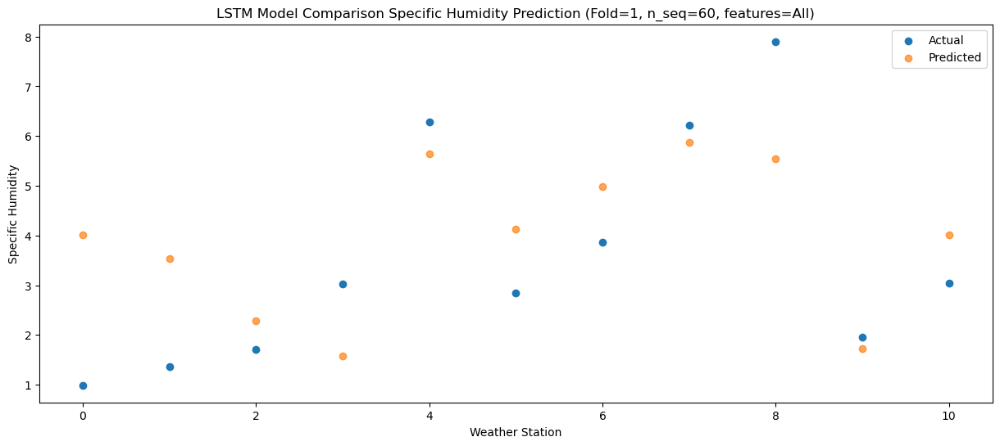

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.19   7.610772
1                 1    5.17   7.120772
2                 2    5.84   5.870772
3                 3    7.37   5.170772
4                 4   10.27   9.230772
5                 5    5.27   7.720772
6                 6    8.00   8.570772
7                 7   10.52   9.460772
8                 8   11.50   9.130772
9                 9    4.68   5.320772
10               10    6.63   7.610772


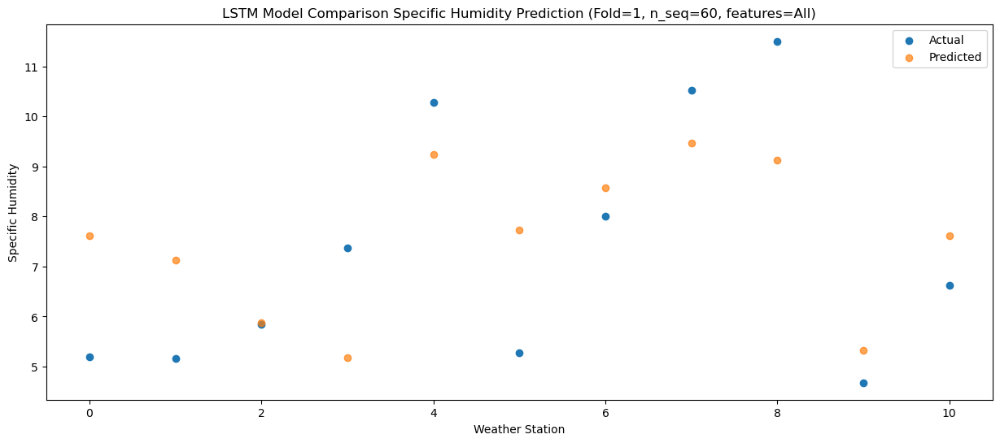

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.26   9.722024
1                 1    6.68   9.232024
2                 2    7.27   7.982024
3                 3    8.76   7.282024
4                 4   11.78  11.342024
5                 5   10.12   9.832024
6                 6    9.96  10.682024
7                 7   12.54  11.572024
8                 8   14.41  11.242024
9                 9   10.35   7.432024
10               10    8.45   9.722024


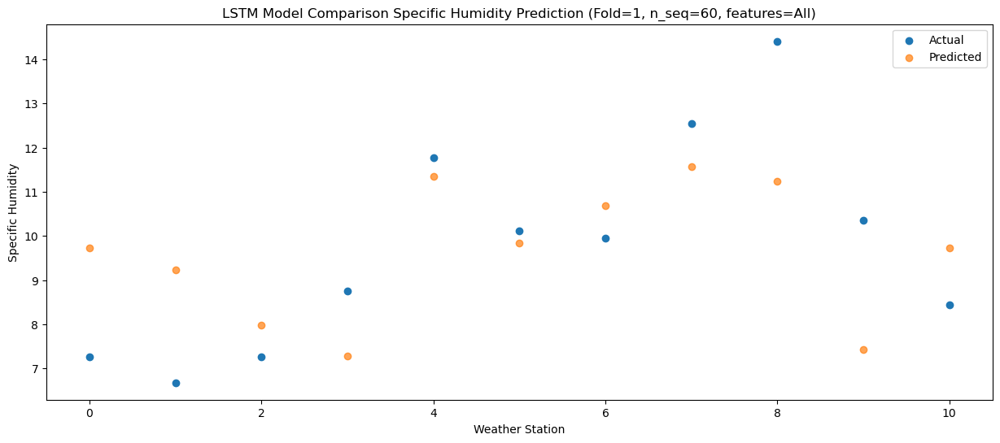

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    9.68  11.446435
1                 1    9.28  10.956435
2                 2   10.44   9.706435
3                 3    8.84   9.006435
4                 4   12.10  13.066435
5                 5    9.97  11.556435
6                 6   12.34  12.406435
7                 7   13.21  13.296435
8                 8   13.02  12.966435
9                 9    8.60   9.156435
10               10   11.82  11.446435


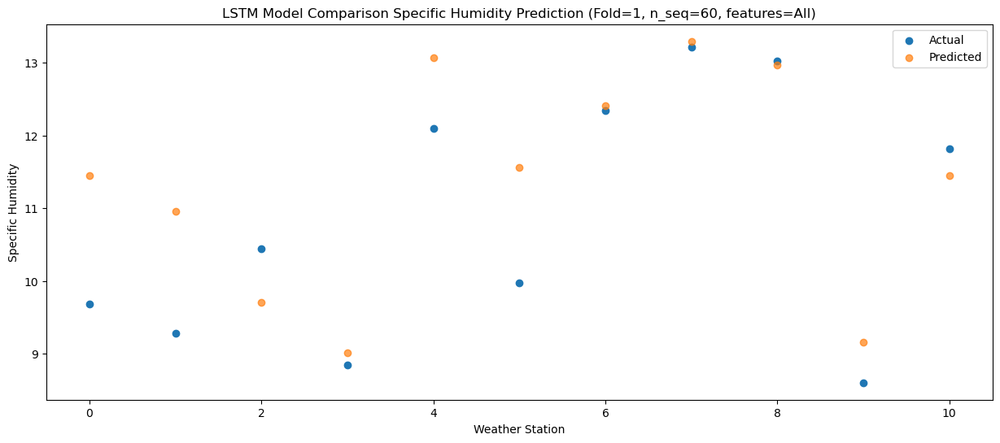

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.04   9.640955
1                 1    7.55   9.150955
2                 2    8.32   7.900955
3                 3    8.93   7.200955
4                 4   12.15  11.260955
5                 5    8.83   9.750955
6                 6   10.62  10.600955
7                 7   11.97  11.490955
8                 8   12.43  11.160955
9                 9    8.79   7.350955
10               10   10.24   9.640955


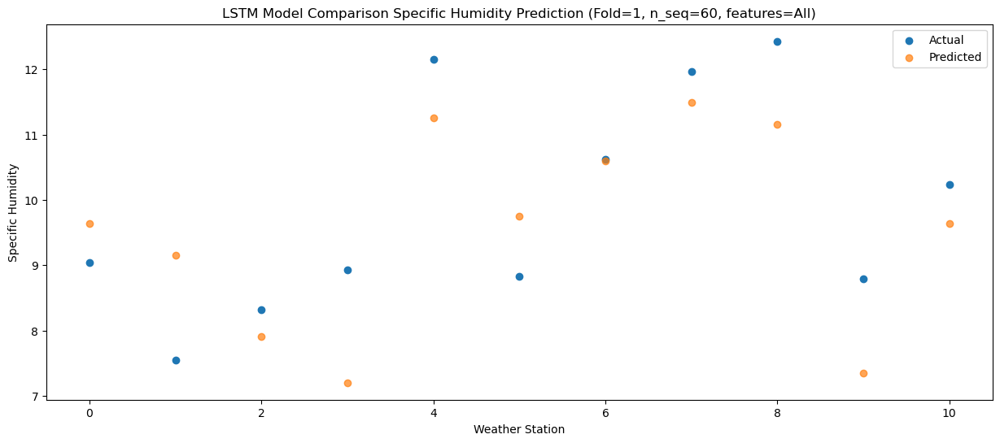

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.05   8.249915
1                 1    6.03   7.759915
2                 2    6.77   6.509915
3                 3    6.01   5.809915
4                 4    9.61   9.869915
5                 5    9.31   8.359915
6                 6    9.33   9.209915
7                 7   10.21  10.099915
8                 8   10.52   9.769915
9                 9    6.35   5.959915
10               10    7.75   8.249915


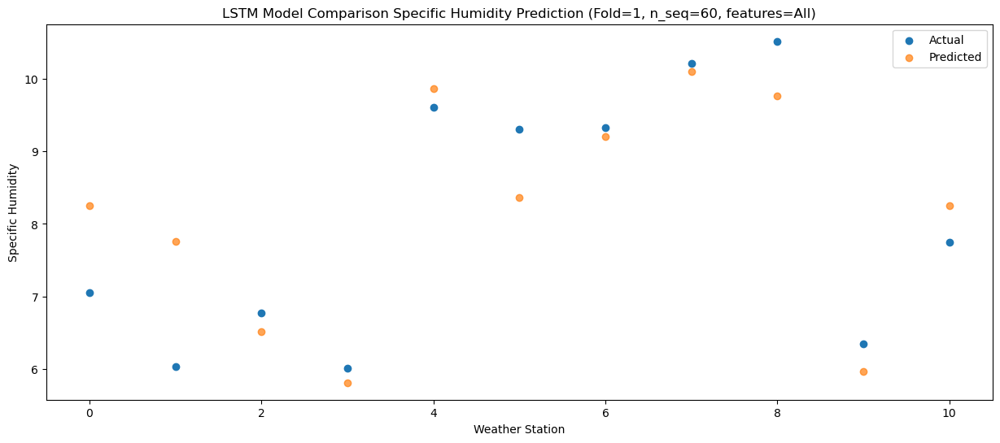

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.10   5.038473
1                 1    2.20   4.548473
2                 2    2.27   3.298473
3                 3    1.96   2.598473
4                 4    5.28   6.658473
5                 5    5.04   5.148473
6                 6    5.19   5.998473
7                 7    5.17   6.888473
8                 8    7.16   6.558473
9                 9    3.36   2.748473
10               10    3.44   5.038473


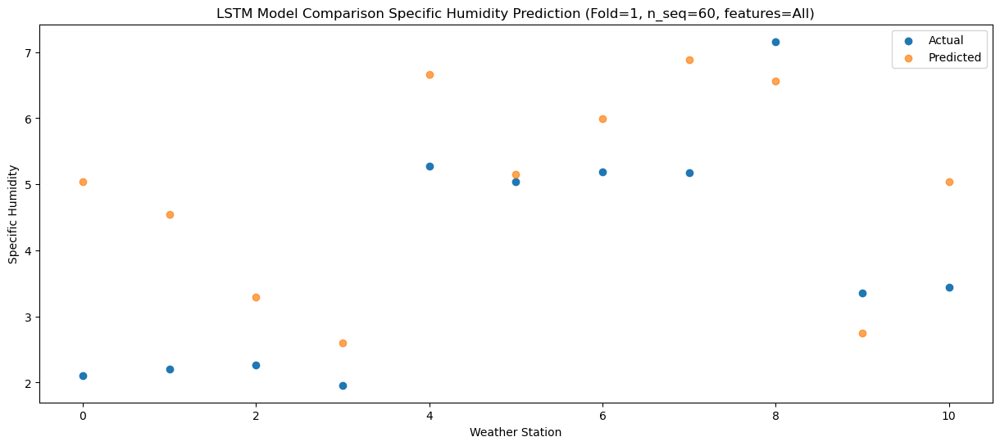

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (1, 1, 1024)              12308480  
                                                                 
 dropout_2 (Dropout)         (1, 1, 1024)              0         
                                                                 
 lstm_3 (LSTM)               (1, 1024)                 8392704   
                                                                 
 dropout_3 (Dropout)         (1, 1024)                 0         
                                                                 
 dense_3 (Dense)             (1, 256)                  262400    
                                                                 
 dense_4 (Dense)             (1, 128)                  32896     
                                                                 
 dense_5 (Dense)             (1, 60)                  

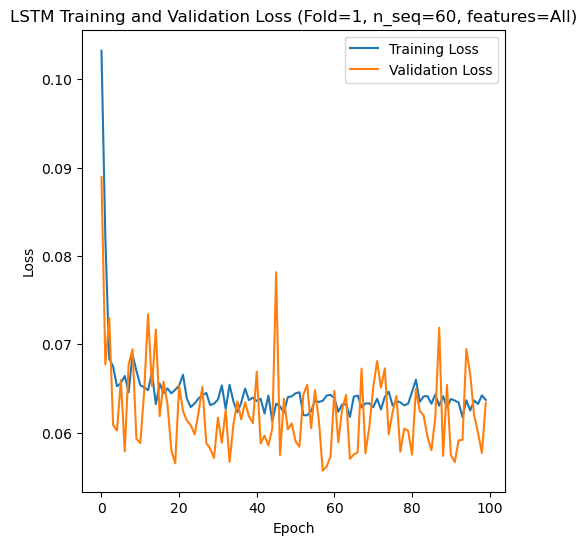

Epoch 1/100
84/84 [==============================] - 13s 103ms/step - loss: 0.1056 - accuracy: 0.2857 - mae: 0.0847 - rmse: 0.1056 - mape: 19.0076 - pearson: 0.6434 - val_loss: 0.0527 - val_accuracy: 0.8000 - val_mae: 0.0416 - val_rmse: 0.0527 - val_mape: 9.2831 - val_pearson: 0.8707
Epoch 2/100
84/84 [==============================] - 7s 84ms/step - loss: 0.0729 - accuracy: 0.3810 - mae: 0.0573 - rmse: 0.0729 - mape: 12.9204 - pearson: 0.7515 - val_loss: 0.0509 - val_accuracy: 0.8000 - val_mae: 0.0415 - val_rmse: 0.0509 - val_mape: 9.0376 - val_pearson: 0.8868
Epoch 3/100
84/84 [==============================] - 7s 88ms/step - loss: 0.0687 - accuracy: 0.4524 - mae: 0.0543 - rmse: 0.0687 - mape: 12.2883 - pearson: 0.7698 - val_loss: 0.0466 - val_accuracy: 0.8000 - val_mae: 0.0364 - val_rmse: 0.0466 - val_mape: 8.3765 - val_pearson: 0.9144
Epoch 4/100
84/84 [==============================] - 7s 85ms/step - loss: 0.0689 - accuracy: 0.4881 - mae: 0.0546 - rmse: 0.0689 - mape: 12.2424 - pe

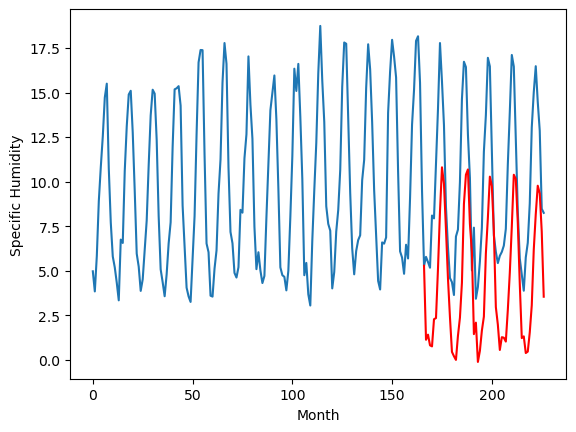

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.26		-1.60		-1.86
-0.25		-1.32		-1.07
-0.27		-1.92		-1.65
-0.21		-1.97		-1.76
1.58		-0.45		-2.03
1.87		-0.38		-2.25
4.77		2.39		-2.38
6.19		5.60		-0.59
11.00		8.08		-2.92
9.57		7.14		-2.43
5.51		4.59		-0.92
1.78		1.84		0.06
1.56		-0.34		-1.90
-0.17		-2.28		-2.11
-0.22		-2.53		-2.31
-0.90		-2.73		-1.83
0.95		-1.38		-2.33
1.07		-0.36		-1.43
6.19		1.60		-4.59
9.10		6.02		-3.08
10.71		7.66		-3.05
9.09		7.96		-1.13
6.27		4.90		-1.37
2.88		3.31		0.43
0.45		-1.29		-1.74
-0.61		-0.64		-0.03
-0.94		-2.85		-1.91
-1.03		-2.22		-1.19
-0.15		-1.09		-0.94
1.00		-0.30		-1.30
3.39		3.25		-0.14
7.75		5.23		-2.52
9.09		7.55		-1.54
8.59		7.02		-1.57
6.02		4.51		-1.51
2.34		0.23		-2.11
0.84		-0.75		-1.59
-0.35		-2.17		-1.82
-0.36		-1.46		-1.10
-0.44		-1.49		-1.05
0.25		-1.70		-1.95
0.87		0.07		-0.80
6.65		2.17		-4.48
9.30		4.76		-4.54
11.36		7.66		-3.70
9.47		7.42		-2.05
6.88		4.96		-1.92
3.42		1.51		-1.91
0.86

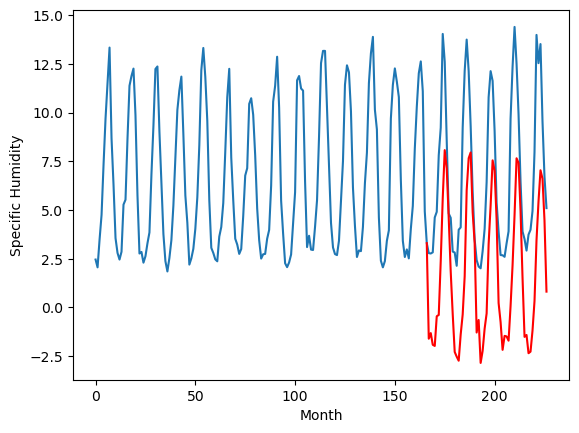

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.12		1.55		1.43
0.43		1.83		1.40
-1.13		1.23		2.36
-0.25		1.18		1.43
0.92		2.70		1.78
2.40		2.77		0.37
3.51		5.54		2.03
6.85		8.75		1.90
7.87		11.23		3.36
8.57		10.29		1.72
7.87		7.74		-0.13
5.28		4.99		-0.29
2.33		2.81		0.48
-2.34		0.87		3.21
-1.85		0.62		2.47
0.28		0.42		0.14
0.50		1.77		1.27
1.47		2.79		1.32
2.78		4.75		1.97
6.56		9.17		2.61
6.96		10.81		3.85
7.58		11.11		3.53
6.30		8.05		1.75
3.64		6.46		2.82
-0.31		1.86		2.17
1.09		2.51		1.42
-2.56		0.30		2.86
-1.37		0.93		2.30
0.44		2.06		1.62
1.80		2.85		1.05
4.90		6.40		1.50
6.83		8.38		1.55
7.66		10.70		3.04
7.55		10.17		2.62
7.40		7.66		0.26
3.01		3.38		0.37
2.90		2.40		-0.50
-0.76		0.98		1.74
-1.14		1.69		2.83
0.71		1.66		0.95
1.10		1.45		0.35
2.61		3.22		0.61
3.42		5.32		1.90
6.58		7.91		1.33
7.55		10.81		3.26
8.27		10.57		2.30
5.88		8.11		2.23
2.96		4.66		1.70
0.46		1.64		1.18
-0.11		1.74		1.85
-1.18		0.80		1.98
-1.60		0.88		2.4

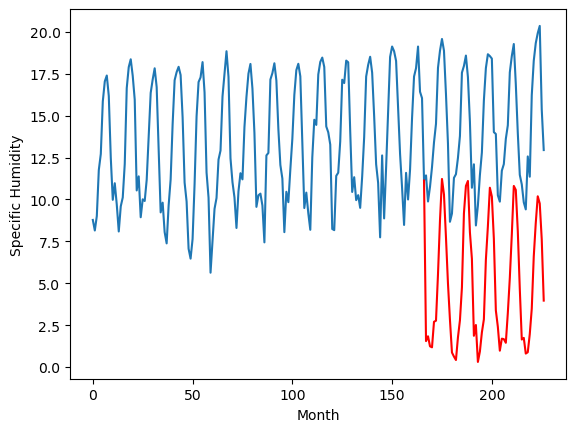

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.77		1.57		0.80
0.21		1.85		1.64
0.03		1.25		1.22
0.05		1.20		1.15
0.57		2.72		2.15
0.95		2.79		1.84
3.20		5.56		2.36
7.21		8.77		1.56
10.59		11.25		0.66
9.76		10.31		0.55
6.67		7.76		1.09
4.16		5.01		0.85
2.29		2.83		0.54
0.37		0.89		0.52
-0.71		0.64		1.35
-0.54		0.44		0.98
0.10		1.79		1.69
1.45		2.81		1.36
3.13		4.77		1.64
7.73		9.19		1.46
10.33		10.83		0.50
11.07		11.13		0.06
8.41		8.07		-0.34
5.45		6.48		1.03
1.00		1.88		0.88
0.64		2.53		1.89
-0.69		0.32		1.01
-0.12		0.95		1.07
0.64		2.08		1.44
1.34		2.87		1.53
4.64		6.42		1.78
6.90		8.40		1.50
10.26		10.72		0.46
10.94		10.19		-0.75
7.14		7.68		0.54
4.27		3.40		-0.87
2.45		2.42		-0.03
0.36		1.00		0.64
0.87		1.71		0.84
0.11		1.68		1.57
0.36		1.47		1.11
2.44		3.24		0.80
3.25		5.34		2.09
7.15		7.93		0.78
11.41		10.83		-0.58
9.07		10.59		1.52
8.06		8.13		0.07
4.70		4.68		-0.02
0.87		1.66		0.79
1.16		1.76		0.60
-0.17		0.82		0.99
-0.22		0.90		

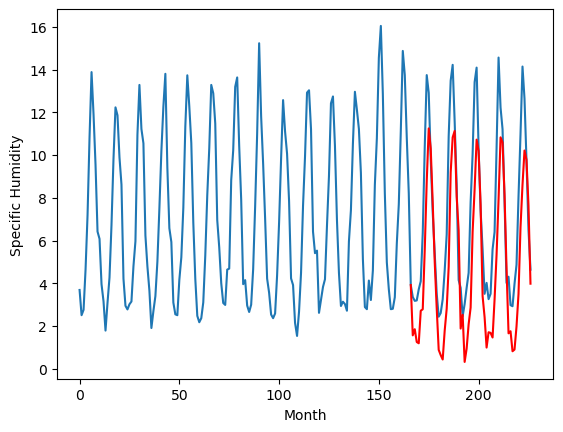

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.79		1.48		2.27
0.01		1.76		1.75
0.04		1.16		1.12
0.36		1.11		0.75
3.85		2.63		-1.22
2.89		2.70		-0.19
5.01		5.47		0.46
8.35		8.68		0.33
10.48		11.16		0.68
9.75		10.22		0.47
7.95		7.67		-0.28
4.74		4.92		0.18
2.01		2.74		0.73
-1.27		0.80		2.07
-1.14		0.55		1.69
-1.16		0.35		1.51
2.13		1.70		-0.43
2.15		2.72		0.57
5.35		4.68		-0.67
9.24		9.10		-0.14
10.27		10.74		0.47
9.87		11.04		1.17
7.73		7.98		0.25
5.20		6.39		1.19
-0.46		1.79		2.25
2.82		2.44		-0.38
-2.09		0.23		2.32
-0.63		0.86		1.49
0.22		1.99		1.77
2.65		2.78		0.13
6.68		6.33		-0.35
8.98		8.31		-0.67
10.27		10.63		0.36
10.67		10.10		-0.57
7.16		7.59		0.43
1.98		3.31		1.33
1.54		2.33		0.79
0.99		0.91		-0.08
0.90		1.62		0.72
2.20		1.59		-0.61
3.08		1.38		-1.70
3.63		3.15		-0.48
6.69		5.25		-1.44
10.00		7.84		-2.16
11.34		10.74		-0.60
11.37		10.50		-0.87
9.02		8.04		-0.98
3.79		4.59		0.80
1.27		1.57		0.30
-0.32		1.67		1.99
-1.19		0.73		

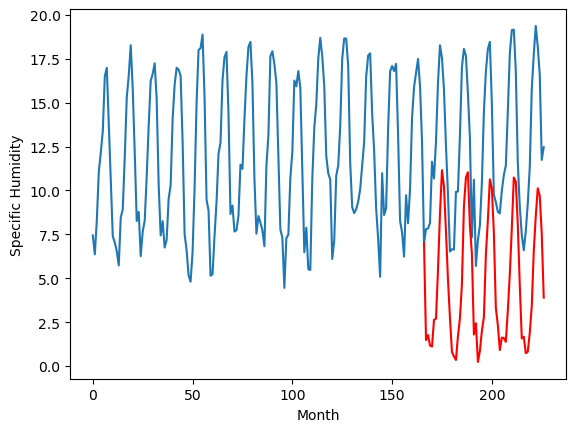

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.21		-1.03		0.18
-2.40		-0.75		1.65
-1.57		-1.35		0.22
-2.24		-1.40		0.84
2.37		0.12		-2.25
1.85		0.19		-1.66
3.93		2.96		-0.97
6.05		6.17		0.12
8.63		8.65		0.02
7.19		7.71		0.52
5.74		5.16		-0.58
1.87		2.41		0.54
-0.19		0.23		0.42
-2.51		-1.71		0.80
-2.64		-1.96		0.68
-2.69		-2.16		0.53
0.30		-0.81		-1.11
1.87		0.21		-1.66
6.70		2.17		-4.53
9.34		6.59		-2.75
8.30		8.23		-0.07
8.43		8.53		0.10
4.87		5.47		0.60
3.28		3.88		0.60
-0.91		-0.72		0.19
1.96		-0.07		-2.03
-3.67		-2.28		1.39
-3.45		-1.65		1.80
-1.83		-0.52		1.31
2.13		0.27		-1.86
5.78		3.82		-1.96
6.81		5.80		-1.01
7.91		8.12		0.21
8.37		7.59		-0.78
5.01		5.08		0.07
0.19		0.80		0.61
0.05		-0.18		-0.23
-0.86		-1.60		-0.74
-1.24		-0.89		0.35
-0.79		-0.92		-0.13
0.99		-1.13		-2.12
1.54		0.64		-0.90
5.24		2.74		-2.50
8.70		5.33		-3.37
8.41		8.23		-0.18
6.98		7.99		1.01
6.43		5.53		-0.90
2.90		2.08		-0.82
-0.27		-0.94		-0.67
-2.20		-0.84

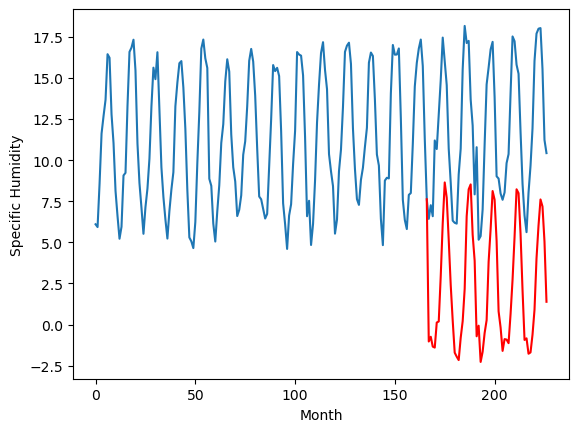

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.57		5.29		-0.28
4.47		5.57		1.10
5.15		4.97		-0.18
4.59		4.92		0.33
8.81		6.44		-2.37
8.39		6.51		-1.88
11.33		9.28		-2.05
13.61		12.49		-1.12
16.52		14.97		-1.55
13.82		14.03		0.21
12.88		11.48		-1.40
8.39		8.73		0.34
6.80		6.55		-0.25
4.09		4.61		0.52
3.99		4.36		0.37
3.66		4.16		0.50
6.52		5.51		-1.01
7.84		6.53		-1.31
12.04		8.49		-3.55
15.79		12.91		-2.88
16.61		14.55		-2.06
16.99		14.85		-2.14
12.54		11.79		-0.75
9.93		10.20		0.27
5.94		5.60		-0.34
8.44		6.25		-2.19
3.15		4.04		0.89
3.62		4.67		1.05
5.25		5.80		0.55
9.15		6.59		-2.56
13.24		10.14		-3.10
14.04		12.12		-1.92
13.36		14.44		1.08
14.42		13.91		-0.51
11.75		11.40		-0.35
6.97		7.12		0.15
6.52		6.14		-0.38
5.35		4.72		-0.63
4.57		5.43		0.86
4.97		5.40		0.43
6.88		5.19		-1.69
7.55		6.96		-0.59
11.44		9.06		-2.38
15.34		11.65		-3.69
14.63		14.55		-0.08
12.58		14.31		1.73
11.95		11.85		-0.10
8.80		8.40		-0.40
6.18		5.38		-0.80
4

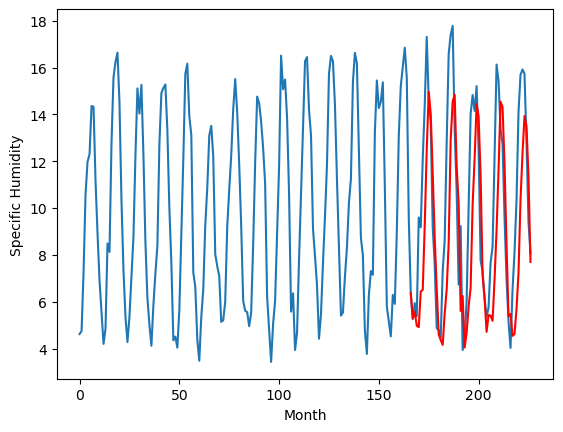

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.62		0.20		-2.42
2.17		0.48		-1.69
1.22		-0.12		-1.34
1.75		-0.17		-1.92
3.21		1.35		-1.86
1.81		1.42		-0.39
2.05		4.19		2.14
3.73		7.40		3.67
7.17		9.88		2.71
5.44		8.94		3.50
4.79		6.39		1.60
1.72		3.64		1.92
1.77		1.46		-0.31
0.51		-0.48		-0.99
0.79		-0.73		-1.52
0.66		-0.93		-1.59
0.75		0.42		-0.33
1.05		1.44		0.39
1.17		3.40		2.23
3.83		7.82		3.99
9.07		9.46		0.39
9.36		9.76		0.40
6.60		6.70		0.10
2.89		5.11		2.22
1.24		0.51		-0.73
1.37		1.16		-0.21
1.09		-1.05		-2.14
0.10		-0.42		-0.52
0.50		0.71		0.21
0.51		1.50		0.99
0.44		5.05		4.61
5.94		7.03		1.09
8.50		9.35		0.85
10.47		8.82		-1.65
7.43		6.31		-1.12
5.35		2.03		-3.32
1.38		1.05		-0.33
2.20		-0.37		-2.57
1.31		0.34		-0.97
1.19		0.31		-0.88
1.53		0.10		-1.43
0.69		1.87		1.18
2.69		3.97		1.28
2.49		6.56		4.07
5.84		9.46		3.62
8.03		9.22		1.19
6.22		6.76		0.54
3.77		3.31		-0.46
2.85		0.29		-2.56
1.33		0.39		-0.94
1.75		-0.55		-2.30
1

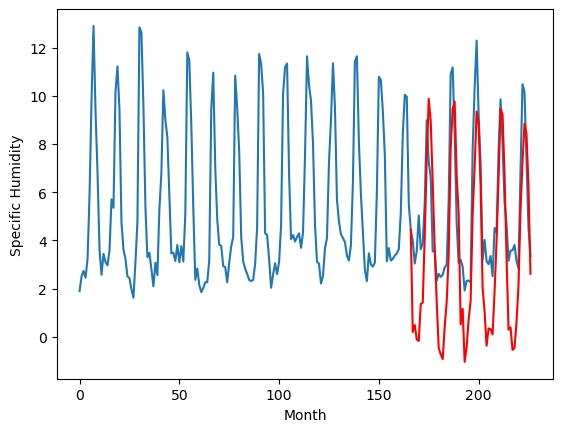

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
7.78		3.95		-3.83
7.60		4.23		-3.37
7.39		3.63		-3.76
6.67		3.58		-3.09
8.31		5.10		-3.21
9.72		5.17		-4.55
10.48		7.94		-2.54
10.46		11.15		0.69
11.23		13.63		2.40
12.31		12.69		0.38
10.53		10.14		-0.39
9.40		7.39		-2.01
7.16		5.21		-1.95
5.59		3.27		-2.32
6.44		3.02		-3.42
6.97		2.82		-4.15
7.08		4.17		-2.91
8.40		5.19		-3.21
9.88		7.15		-2.73
11.13		11.57		0.44
12.28		13.21		0.93
11.68		13.51		1.83
11.22		10.45		-0.77
8.42		8.86		0.44
7.88		4.26		-3.62
7.70		4.91		-2.79
6.34		2.70		-3.64
5.60		3.33		-2.27
7.34		4.46		-2.88
8.18		5.25		-2.93
9.44		8.80		-0.64
11.21		10.78		-0.43
12.10		13.10		1.00
12.20		12.57		0.37
13.05		10.06		-2.99
11.28		5.78		-5.50
6.64		4.80		-1.84
7.49		3.38		-4.11
7.58		4.09		-3.49
6.17		4.06		-2.11
8.09		3.85		-4.24
8.79		5.62		-3.17
10.19		7.72		-2.47
10.57		10.31		-0.26
11.91		13.21		1.30
12.52		12.97		0.45
12.27		10.51		-1.76
9.97		7.06		-2.91
6.94		4.04		-2.90

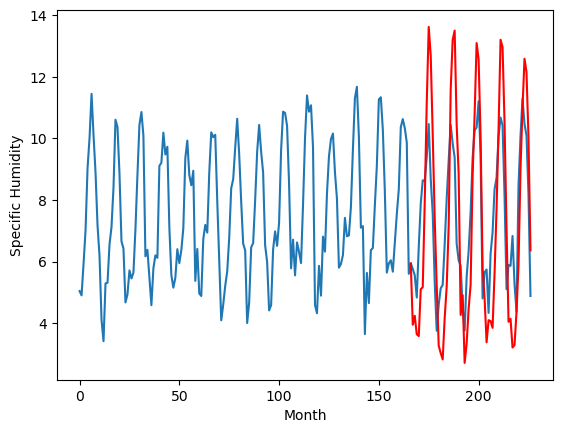

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.89		2.61		1.72
1.00		2.89		1.89
0.98		2.29		1.31
1.37		2.24		0.87
3.00		3.76		0.76
2.91		3.83		0.92
6.24		6.60		0.36
9.75		9.81		0.06
12.60		12.29		-0.31
12.59		11.35		-1.24
8.87		8.80		-0.07
6.25		6.05		-0.20
3.60		3.87		0.27
0.38		1.93		1.55
0.26		1.68		1.42
0.33		1.48		1.15
2.06		2.83		0.77
2.59		3.85		1.26
5.30		5.81		0.51
9.80		10.23		0.43
11.32		11.87		0.55
11.90		12.17		0.27
8.30		9.11		0.81
6.14		7.52		1.38
0.58		2.92		2.34
2.43		3.57		1.14
-0.35		1.36		1.71
0.96		1.99		1.03
1.92		3.12		1.20
2.96		3.91		0.95
7.28		7.46		0.18
9.08		9.44		0.36
12.66		11.76		-0.90
11.09		11.23		0.14
7.66		8.72		1.06
3.30		4.44		1.14
2.83		3.46		0.63
0.59		2.04		1.45
1.45		2.75		1.30
2.21		2.72		0.51
1.90		2.51		0.61
4.03		4.28		0.25
5.56		6.38		0.82
8.42		8.97		0.55
12.26		11.87		-0.39
11.77		11.63		-0.14
8.63		9.17		0.54
4.44		5.72		1.28
1.33		2.70		1.37
1.24		2.80		1.56
0.55		1.86		1.31
0.69		1.94		

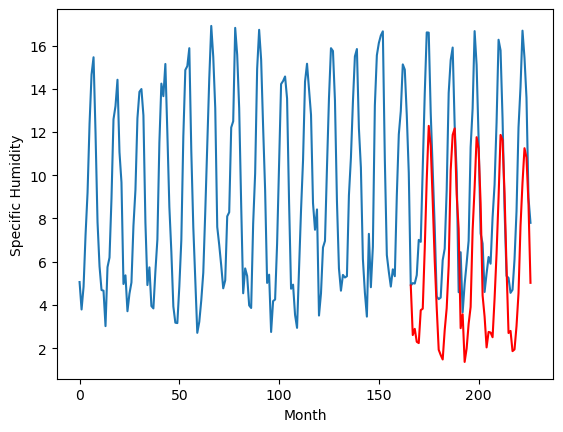

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.08		1.13		1.05
0.53		1.41		0.88
0.33		0.81		0.48
0.44		0.76		0.32
2.29		2.28		-0.01
1.72		2.35		0.63
4.51		5.12		0.61
7.95		8.33		0.38
10.65		10.81		0.16
10.41		9.87		-0.54
7.80		7.32		-0.48
4.61		4.57		-0.04
1.49		2.39		0.90
-0.30		0.45		0.75
-0.29		0.20		0.49
-0.05		-0.00		0.05
0.98		1.35		0.37
1.59		2.37		0.78
4.26		4.33		0.07
8.36		8.75		0.39
9.77		10.39		0.62
10.16		10.69		0.53
6.95		7.63		0.68
5.22		6.04		0.82
-0.14		1.44		1.58
1.42		2.09		0.67
-1.00		-0.12		0.88
-0.10		0.51		0.61
0.52		1.64		1.12
1.79		2.43		0.64
5.95		5.98		0.03
7.91		7.96		0.05
11.12		10.28		-0.84
10.13		9.75		-0.38
6.65		7.24		0.59
1.99		2.96		0.97
1.37		1.98		0.61
0.28		0.56		0.28
0.55		1.27		0.72
0.95		1.24		0.29
0.55		1.03		0.48
2.19		2.80		0.61
4.78		4.90		0.12
6.62		7.49		0.87
9.93		10.39		0.46
10.04		10.15		0.11
7.62		7.69		0.07
3.51		4.24		0.73
0.56		1.22		0.66
0.35		1.32		0.97
-0.27		0.38		0.65
0.13		0.46

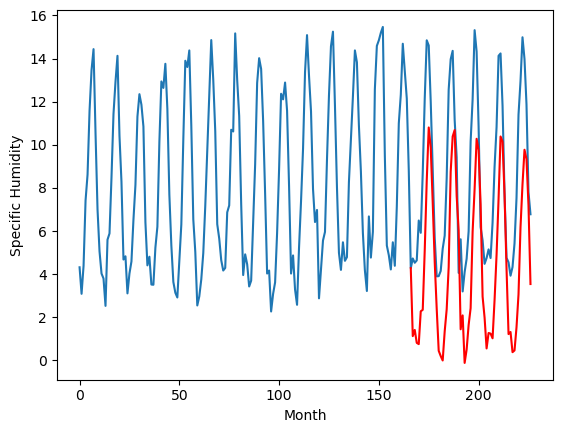

RangeIndex(start=1, stop=12, step=1)
[0.41000000000000014, 0.26000000000000045, 0.1200000000000001, 0.7699999999999987, -0.79, -1.2099999999999995, 5.569999999999999, 2.62, 7.780000000000001, 0.8900000000000006, 0.08000000000000007]
[1.1258562755584718, -1.6041437244415284, 1.5458562755584717, 1.5658562755584713, 1.4758562755584714, -1.0341437244415284, 5.285856275558471, 0.19585627555847163, 3.945856275558472, 2.6058562755584713, 1.1258562755584718]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.41   1.125856
1                 1    0.26  -1.604144
2                 2    0.12   1.545856
3                 3    0.77   1.565856
4                 4   -0.79   1.475856
5                 5   -1.21  -1.034144
6                 6    5.57   5.285856
7                 7    2.62   0.195856
8                 8    7.78   3.945856
9                 9    0.89   2.605856
10               10    0.08   1.125856


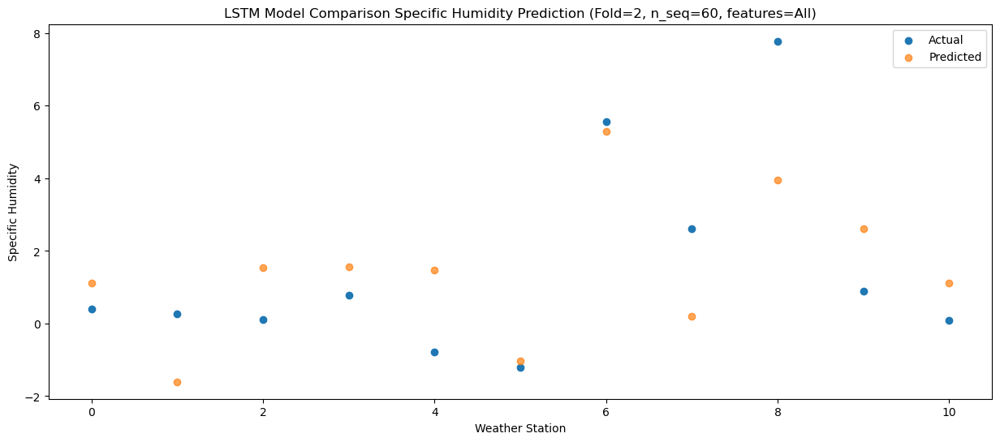

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.91    1.41494
1                 1   -0.25   -1.31506
2                 2    0.43    1.83494
3                 3    0.21    1.85494
4                 4    0.01    1.76494
5                 5   -2.40   -0.74506
6                 6    4.47    5.57494
7                 7    2.17    0.48494
8                 8    7.60    4.23494
9                 9    1.00    2.89494
10               10    0.53    1.41494


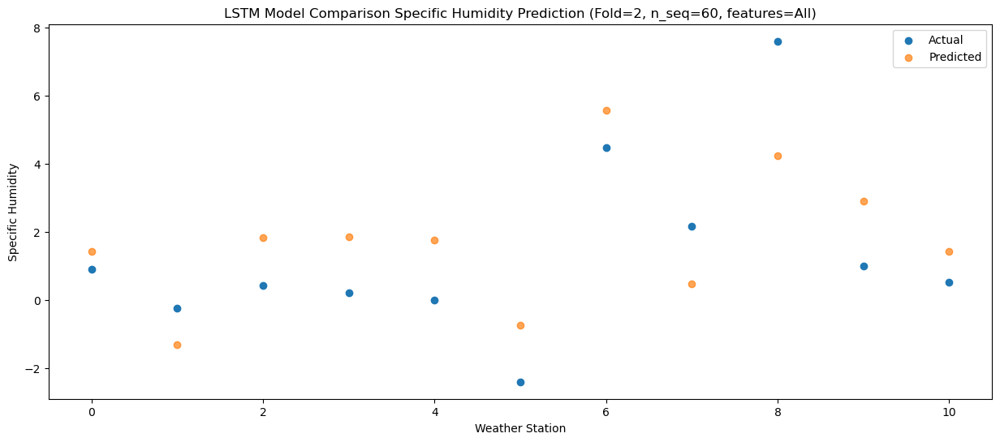

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.62   0.814409
1                 1   -0.27  -1.915591
2                 2   -1.13   1.234409
3                 3    0.03   1.254409
4                 4    0.04   1.164409
5                 5   -1.57  -1.345591
6                 6    5.15   4.974409
7                 7    1.22  -0.115591
8                 8    7.39   3.634409
9                 9    0.98   2.294409
10               10    0.33   0.814409


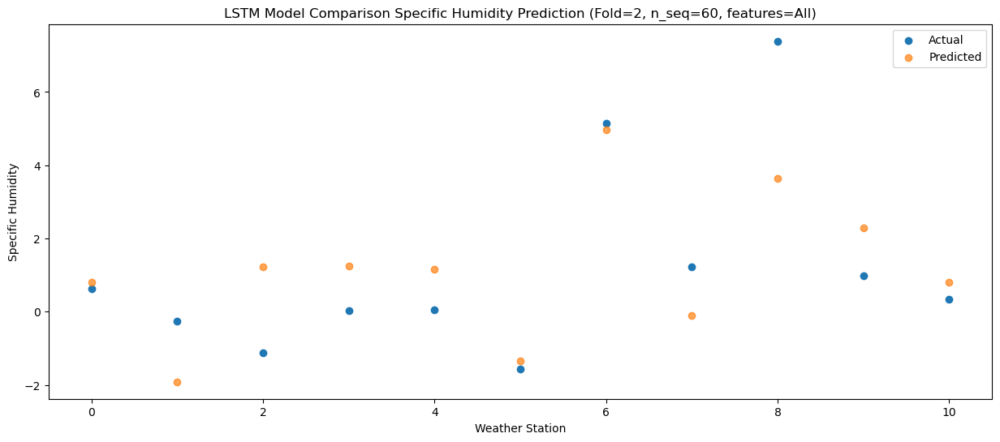

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.30   0.756703
1                 1   -0.21  -1.973297
2                 2   -0.25   1.176703
3                 3    0.05   1.196703
4                 4    0.36   1.106703
5                 5   -2.24  -1.403297
6                 6    4.59   4.916703
7                 7    1.75  -0.173297
8                 8    6.67   3.576703
9                 9    1.37   2.236703
10               10    0.44   0.756703


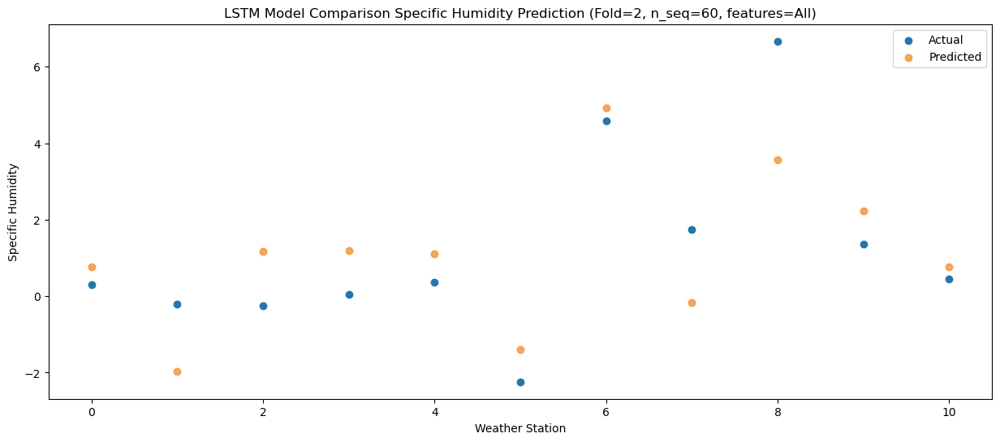

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.23   2.279394
1                 1    1.58  -0.450606
2                 2    0.92   2.699394
3                 3    0.57   2.719394
4                 4    3.85   2.629394
5                 5    2.37   0.119394
6                 6    8.81   6.439394
7                 7    3.21   1.349394
8                 8    8.31   5.099394
9                 9    3.00   3.759394
10               10    2.29   2.279394


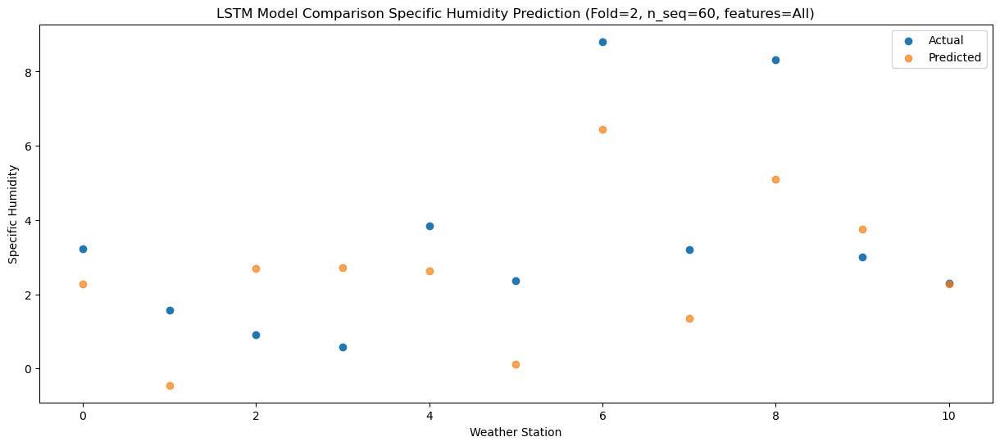

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.07   2.346352
1                 1    1.87  -0.383648
2                 2    2.40   2.766352
3                 3    0.95   2.786352
4                 4    2.89   2.696352
5                 5    1.85   0.186352
6                 6    8.39   6.506352
7                 7    1.81   1.416352
8                 8    9.72   5.166352
9                 9    2.91   3.826352
10               10    1.72   2.346352


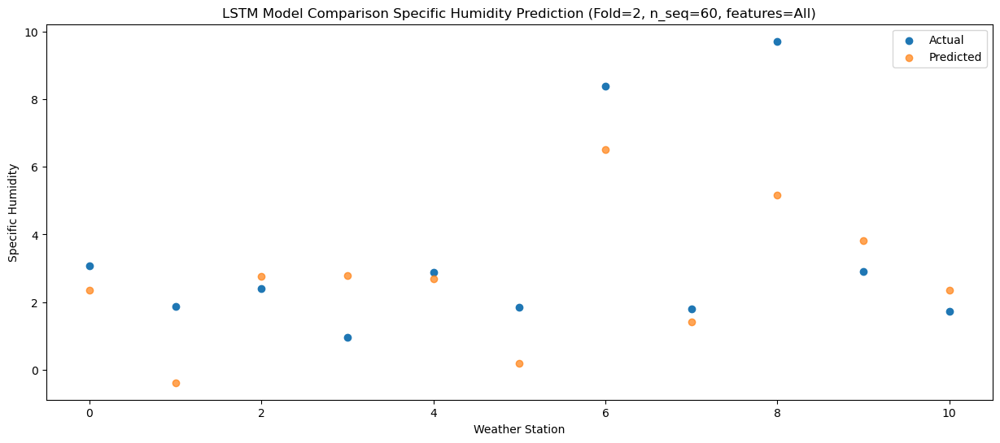

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.06   5.118083
1                 1    4.77   2.388083
2                 2    3.51   5.538083
3                 3    3.20   5.558083
4                 4    5.01   5.468083
5                 5    3.93   2.958083
6                 6   11.33   9.278083
7                 7    2.05   4.188083
8                 8   10.48   7.938083
9                 9    6.24   6.598083
10               10    4.51   5.118083


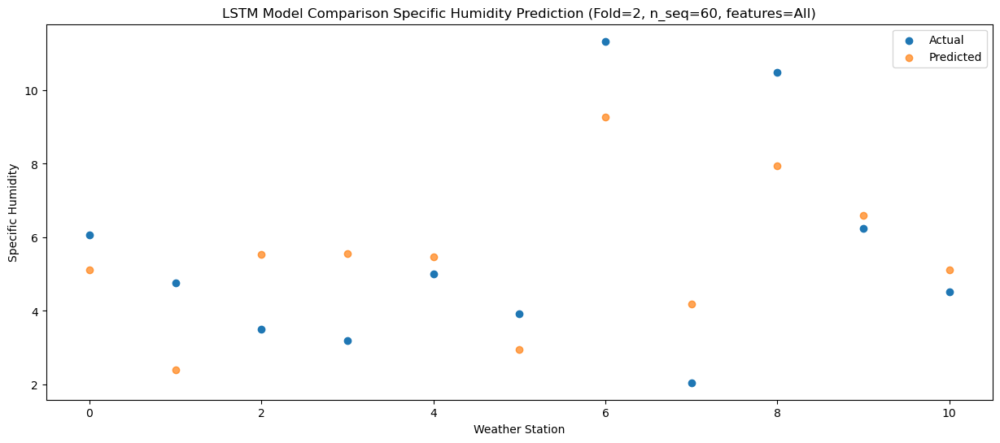

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.21   8.328783
1                 1    6.19   5.598783
2                 2    6.85   8.748783
3                 3    7.21   8.768783
4                 4    8.35   8.678783
5                 5    6.05   6.168783
6                 6   13.61  12.488783
7                 7    3.73   7.398783
8                 8   10.46  11.148783
9                 9    9.75   9.808783
10               10    7.95   8.328783


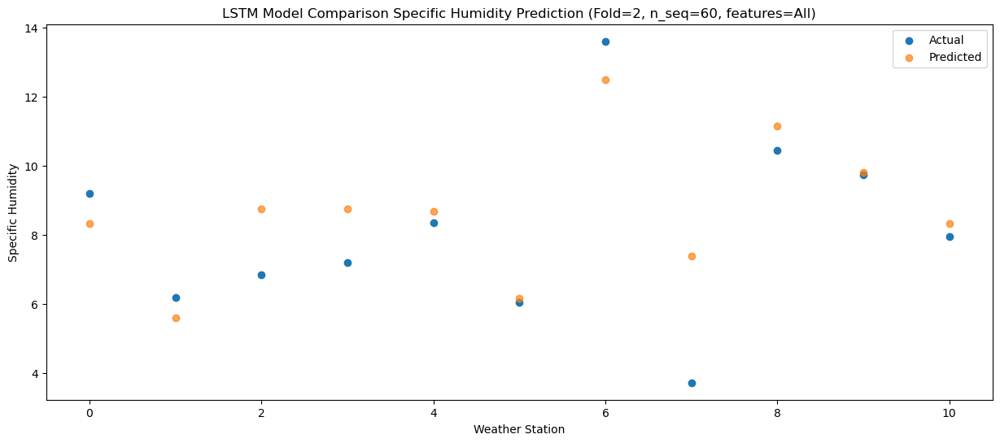

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.91  10.805955
1                 1   11.00   8.075955
2                 2    7.87  11.225955
3                 3   10.59  11.245955
4                 4   10.48  11.155955
5                 5    8.63   8.645955
6                 6   16.52  14.965955
7                 7    7.17   9.875955
8                 8   11.23  13.625955
9                 9   12.60  12.285955
10               10   10.65  10.805955


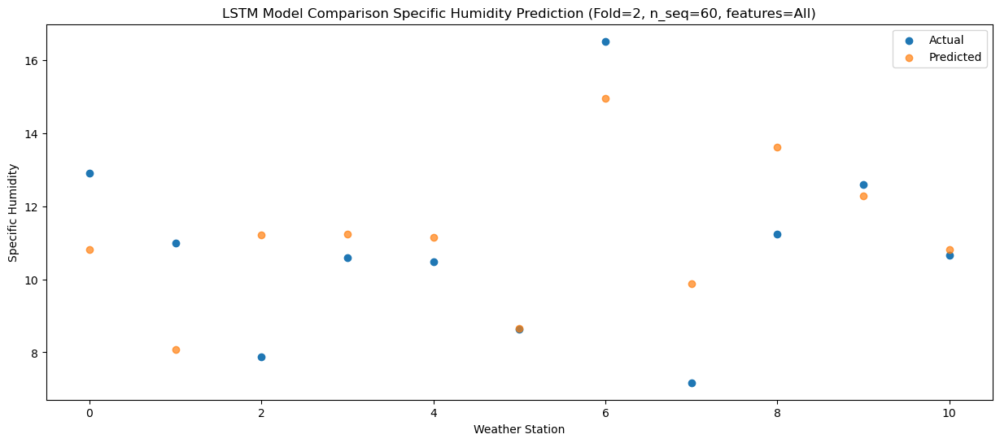

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.75   9.872293
1                 1    9.57   7.142293
2                 2    8.57  10.292293
3                 3    9.76  10.312293
4                 4    9.75  10.222293
5                 5    7.19   7.712293
6                 6   13.82  14.032293
7                 7    5.44   8.942293
8                 8   12.31  12.692293
9                 9   12.59  11.352293
10               10   10.41   9.872293


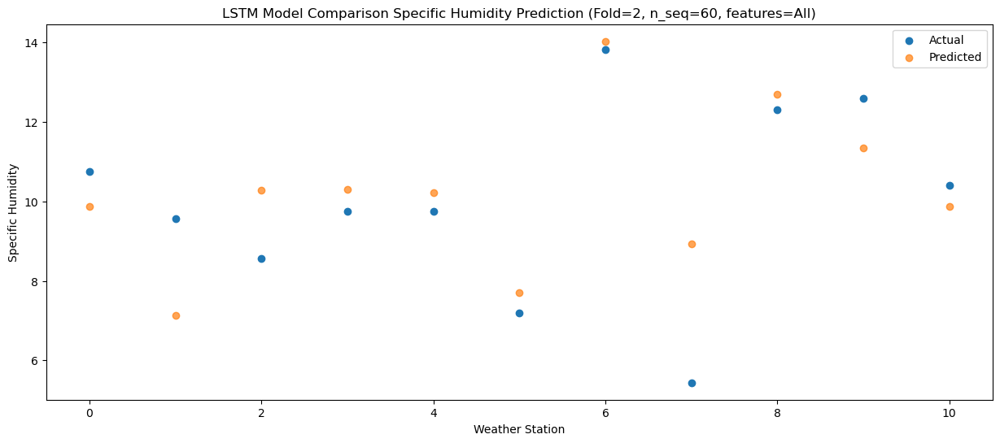

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.29   7.317807
1                 1    5.51   4.587807
2                 2    7.87   7.737807
3                 3    6.67   7.757807
4                 4    7.95   7.667807
5                 5    5.74   5.157807
6                 6   12.88  11.477807
7                 7    4.79   6.387807
8                 8   10.53  10.137807
9                 9    8.87   8.797807
10               10    7.80   7.317807


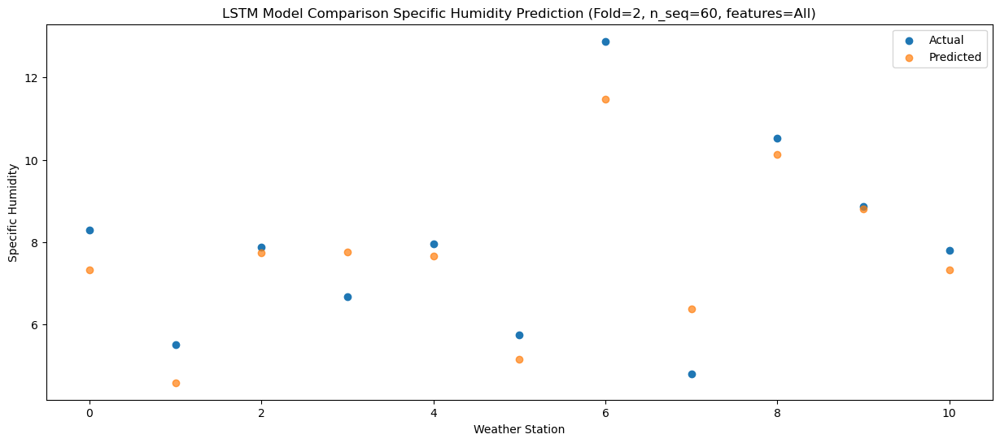

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.70   4.570636
1                 1    1.78   1.840636
2                 2    5.28   4.990636
3                 3    4.16   5.010636
4                 4    4.74   4.920636
5                 5    1.87   2.410636
6                 6    8.39   8.730636
7                 7    1.72   3.640636
8                 8    9.40   7.390636
9                 9    6.25   6.050636
10               10    4.61   4.570636


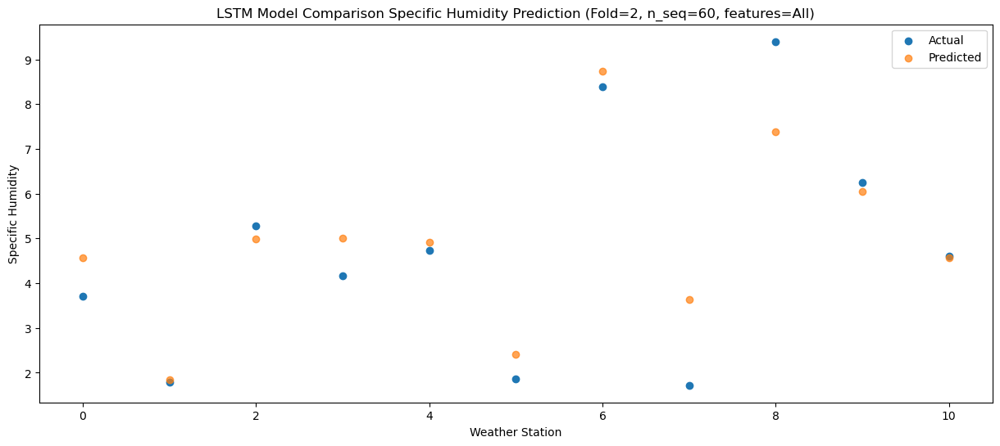

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.45   2.394383
1                 1    1.56  -0.335617
2                 2    2.33   2.814383
3                 3    2.29   2.834383
4                 4    2.01   2.744383
5                 5   -0.19   0.234383
6                 6    6.80   6.554383
7                 7    1.77   1.464383
8                 8    7.16   5.214383
9                 9    3.60   3.874383
10               10    1.49   2.394383


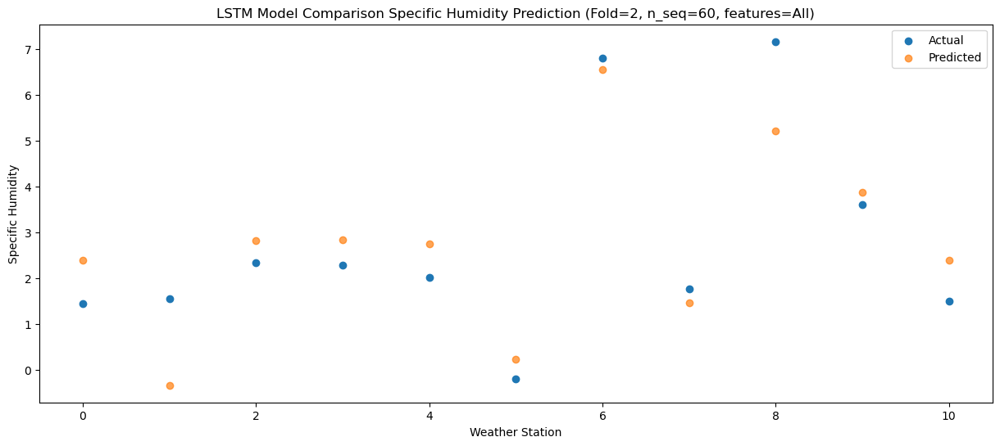

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.28   0.446816
1                 1   -0.17  -2.283184
2                 2   -2.34   0.866816
3                 3    0.37   0.886816
4                 4   -1.27   0.796816
5                 5   -2.51  -1.713184
6                 6    4.09   4.606816
7                 7    0.51  -0.483184
8                 8    5.59   3.266816
9                 9    0.38   1.926816
10               10   -0.30   0.446816


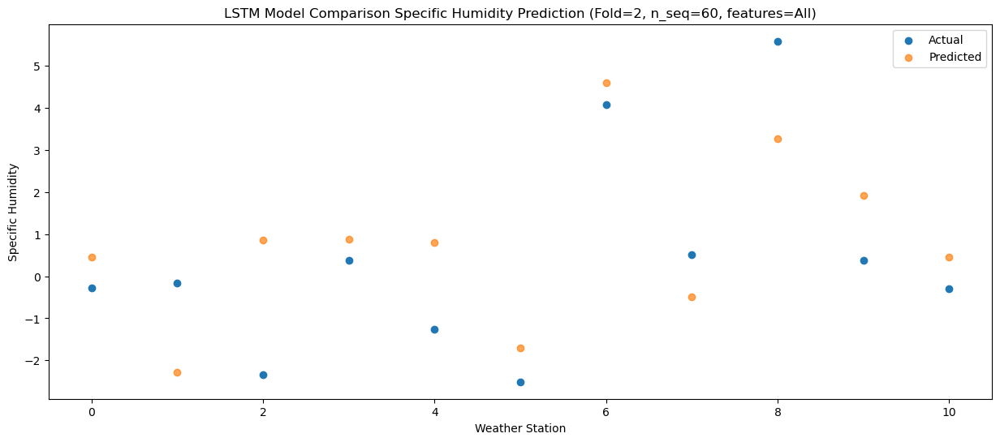

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.51   0.203864
1                 1   -0.22  -2.526136
2                 2   -1.85   0.623864
3                 3   -0.71   0.643864
4                 4   -1.14   0.553864
5                 5   -2.64  -1.956136
6                 6    3.99   4.363864
7                 7    0.79  -0.726136
8                 8    6.44   3.023864
9                 9    0.26   1.683864
10               10   -0.29   0.203864


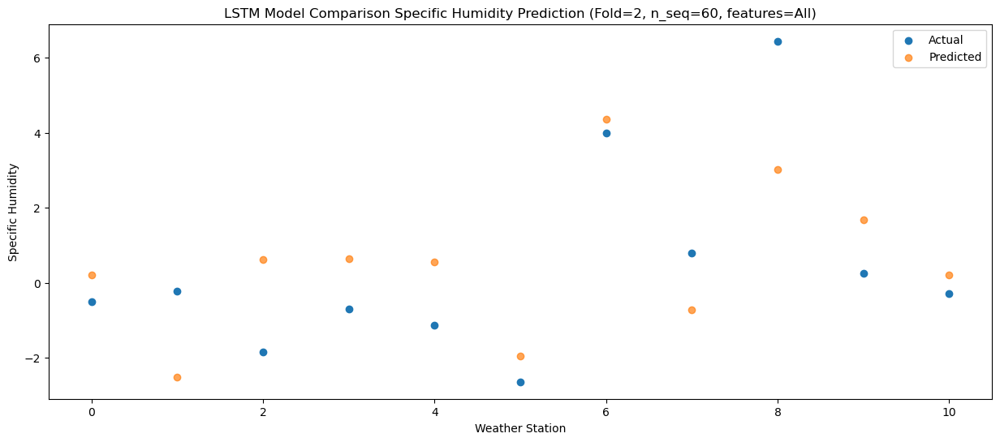

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -0.002597
1                 1   -0.90  -2.732597
2                 2    0.28   0.417403
3                 3   -0.54   0.437403
4                 4   -1.16   0.347403
5                 5   -2.69  -2.162597
6                 6    3.66   4.157403
7                 7    0.66  -0.932597
8                 8    6.97   2.817403
9                 9    0.33   1.477403
10               10   -0.05  -0.002597


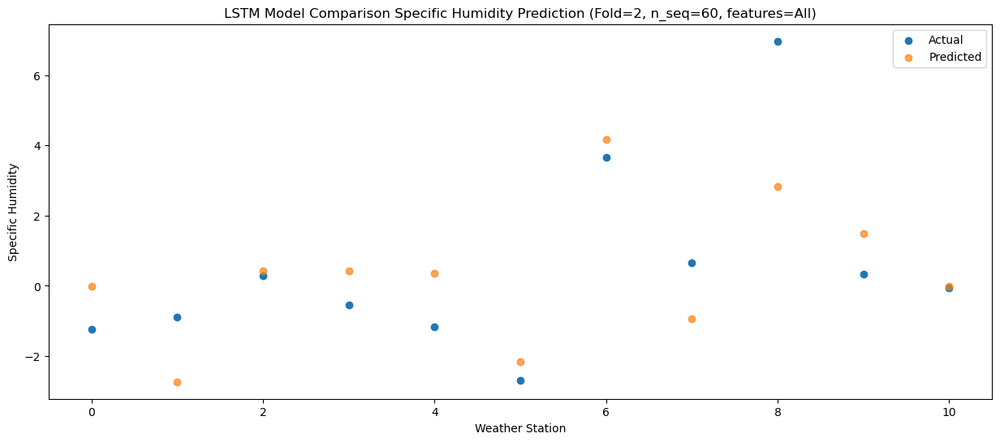

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.05   1.346259
1                 1    0.95  -1.383741
2                 2    0.50   1.766259
3                 3    0.10   1.786259
4                 4    2.13   1.696259
5                 5    0.30  -0.813741
6                 6    6.52   5.506259
7                 7    0.75   0.416259
8                 8    7.08   4.166259
9                 9    2.06   2.826259
10               10    0.98   1.346259


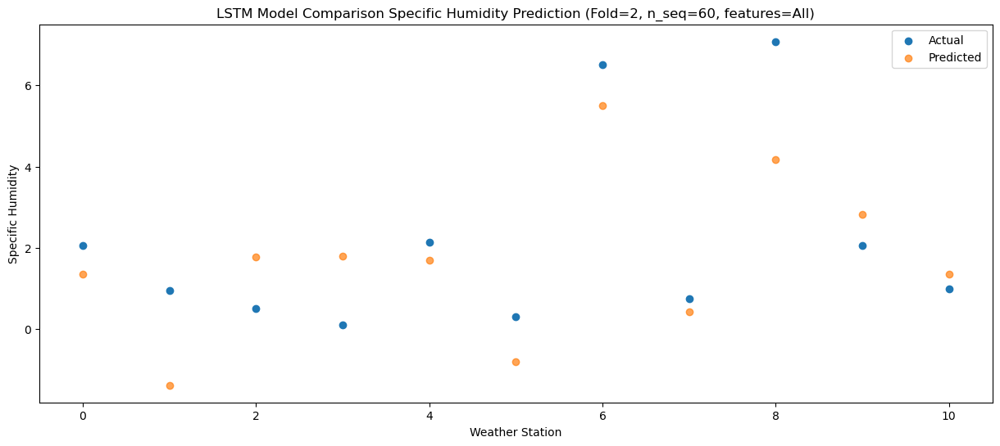

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.44   2.368875
1                 1    1.07  -0.361125
2                 2    1.47   2.788875
3                 3    1.45   2.808875
4                 4    2.15   2.718875
5                 5    1.87   0.208875
6                 6    7.84   6.528875
7                 7    1.05   1.438875
8                 8    8.40   5.188875
9                 9    2.59   3.848875
10               10    1.59   2.368875


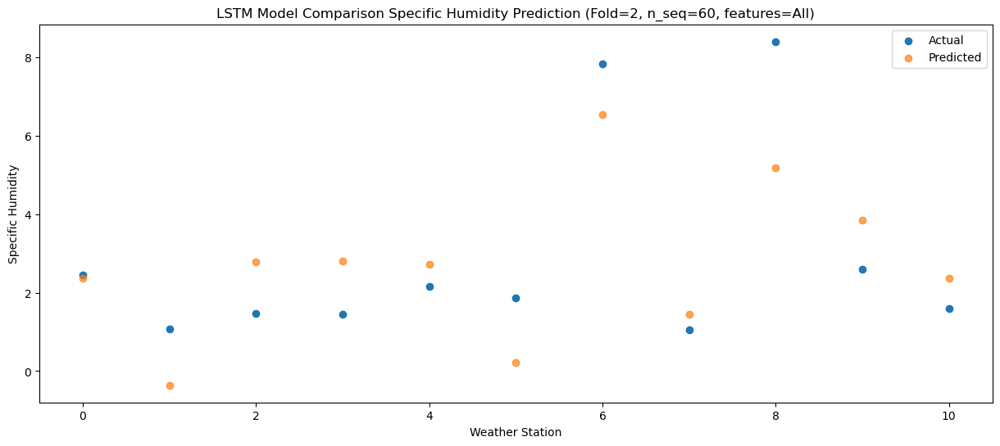

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.11   4.333533
1                 1    6.19   1.603533
2                 2    2.78   4.753533
3                 3    3.13   4.773533
4                 4    5.35   4.683533
5                 5    6.70   2.173533
6                 6   12.04   8.493533
7                 7    1.17   3.403533
8                 8    9.88   7.153533
9                 9    5.30   5.813533
10               10    4.26   4.333533


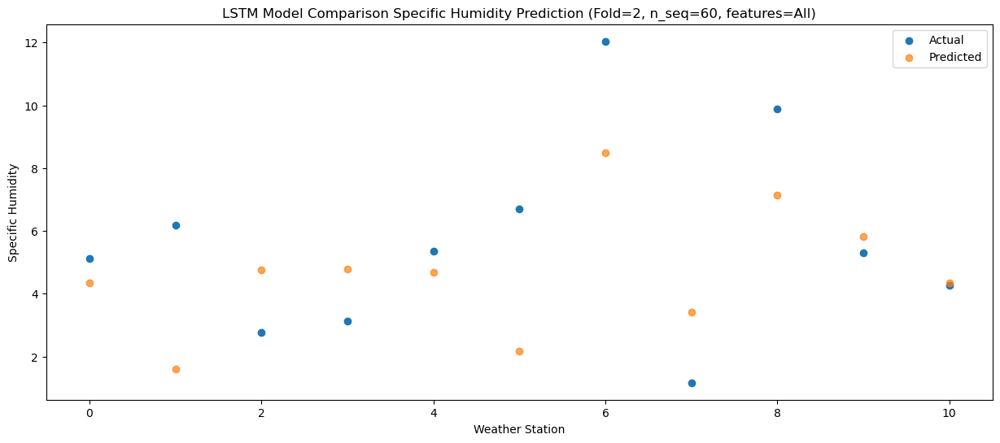

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    9.76   8.746363
1                 1    9.10   6.016363
2                 2    6.56   9.166363
3                 3    7.73   9.186363
4                 4    9.24   9.096363
5                 5    9.34   6.586363
6                 6   15.79  12.906363
7                 7    3.83   7.816363
8                 8   11.13  11.566363
9                 9    9.80  10.226363
10               10    8.36   8.746363


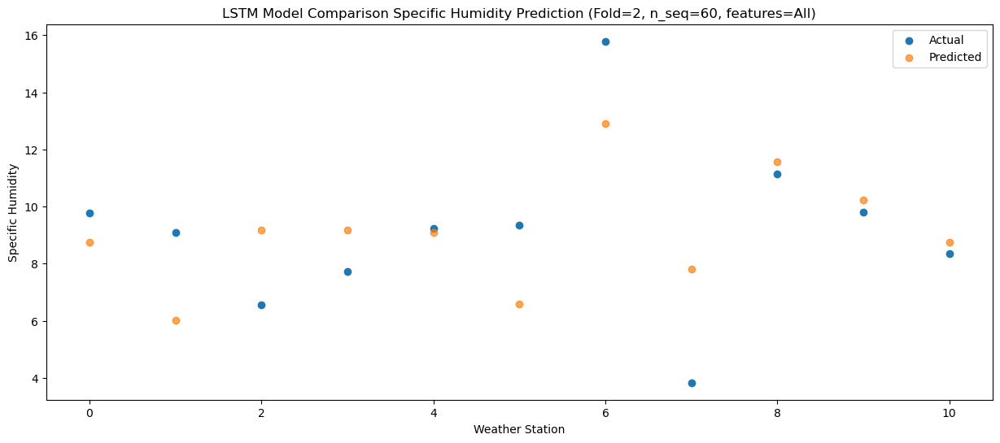

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.86  10.388272
1                 1   10.71   7.658272
2                 2    6.96  10.808272
3                 3   10.33  10.828272
4                 4   10.27  10.738272
5                 5    8.30   8.228272
6                 6   16.61  14.548272
7                 7    9.07   9.458272
8                 8   12.28  13.208272
9                 9   11.32  11.868272
10               10    9.77  10.388272


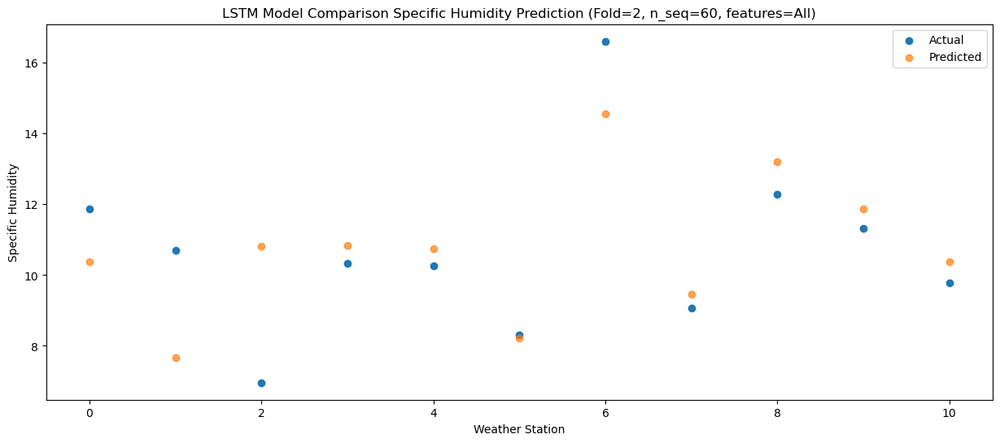

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.56  10.686551
1                 1    9.09   7.956551
2                 2    7.58  11.106551
3                 3   11.07  11.126551
4                 4    9.87  11.036551
5                 5    8.43   8.526551
6                 6   16.99  14.846551
7                 7    9.36   9.756551
8                 8   11.68  13.506551
9                 9   11.90  12.166551
10               10   10.16  10.686551


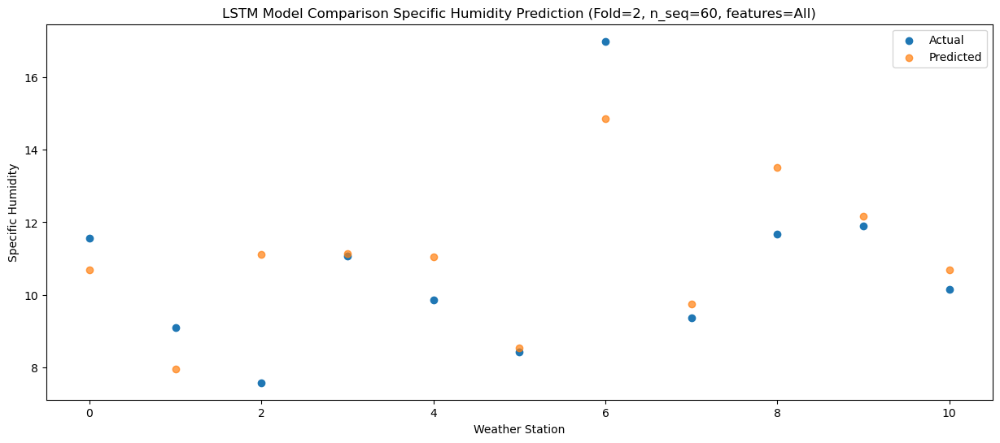

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    7.79   7.625038
1                 1    6.27   4.895038
2                 2    6.30   8.045038
3                 3    8.41   8.065038
4                 4    7.73   7.975038
5                 5    4.87   5.465038
6                 6   12.54  11.785038
7                 7    6.60   6.695038
8                 8   11.22  10.445038
9                 9    8.30   9.105038
10               10    6.95   7.625038


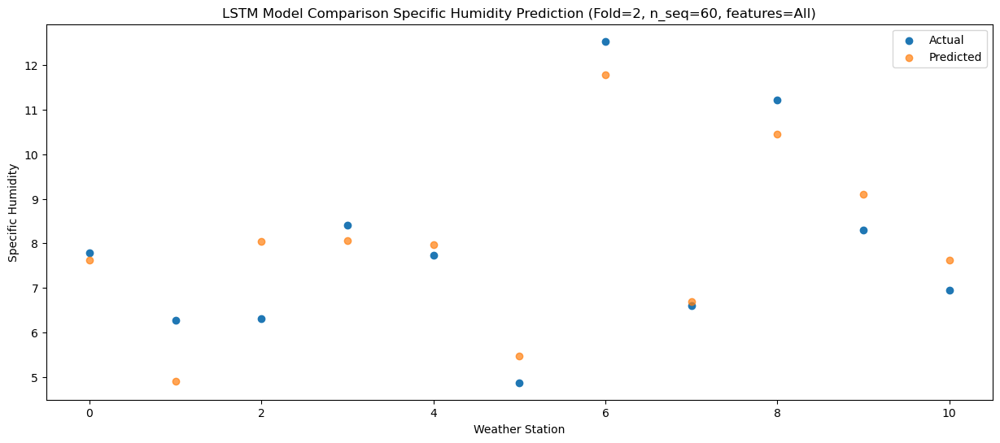

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.34   6.038163
1                 1    2.88   3.308163
2                 2    3.64   6.458163
3                 3    5.45   6.478163
4                 4    5.20   6.388163
5                 5    3.28   3.878163
6                 6    9.93  10.198163
7                 7    2.89   5.108163
8                 8    8.42   8.858163
9                 9    6.14   7.518163
10               10    5.22   6.038163


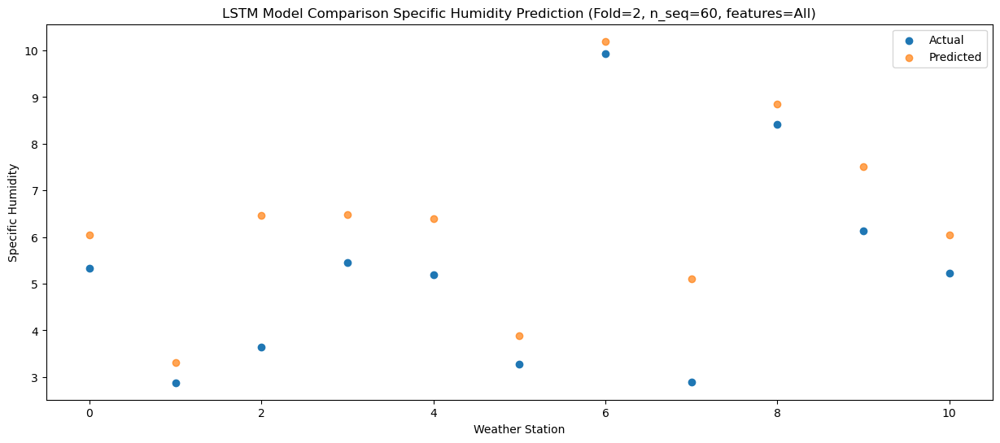

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.15    1.44451
1                 1    0.45   -1.28549
2                 2   -0.31    1.86451
3                 3    1.00    1.88451
4                 4   -0.46    1.79451
5                 5   -0.91   -0.71549
6                 6    5.94    5.60451
7                 7    1.24    0.51451
8                 8    7.88    4.26451
9                 9    0.58    2.92451
10               10   -0.14    1.44451


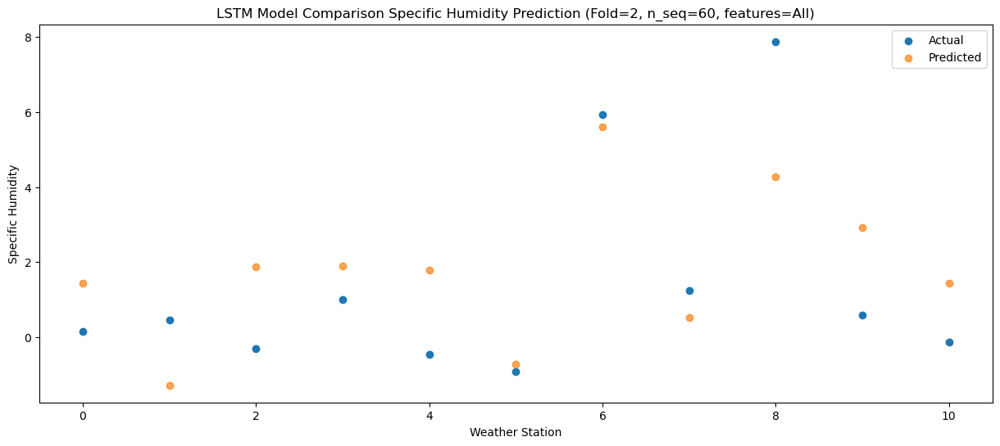

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.55   2.087953
1                 1   -0.61  -0.642047
2                 2    1.09   2.507953
3                 3    0.64   2.527953
4                 4    2.82   2.437953
5                 5    1.96  -0.072047
6                 6    8.44   6.247953
7                 7    1.37   1.157953
8                 8    7.70   4.907953
9                 9    2.43   3.567953
10               10    1.42   2.087953


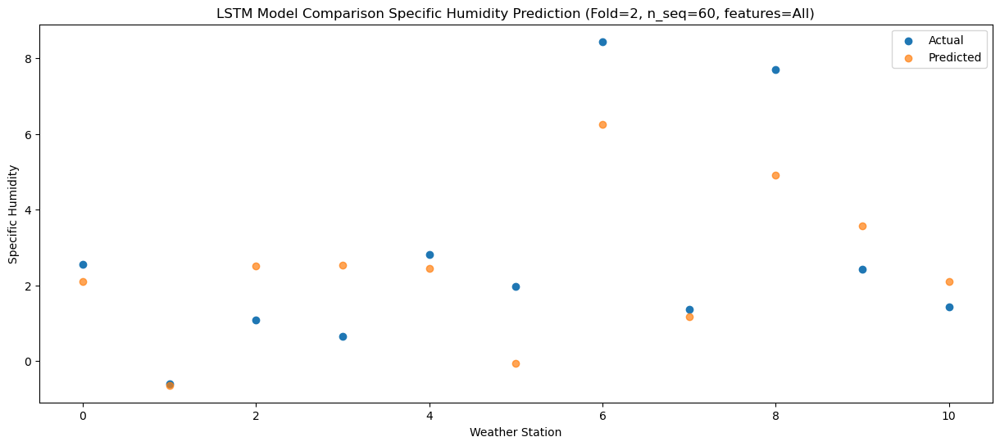

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.44  -0.115858
1                 1   -0.94  -2.845858
2                 2   -2.56   0.304142
3                 3   -0.69   0.324142
4                 4   -2.09   0.234142
5                 5   -3.67  -2.275858
6                 6    3.15   4.044142
7                 7    1.09  -1.045858
8                 8    6.34   2.704142
9                 9   -0.35   1.364142
10               10   -1.00  -0.115858


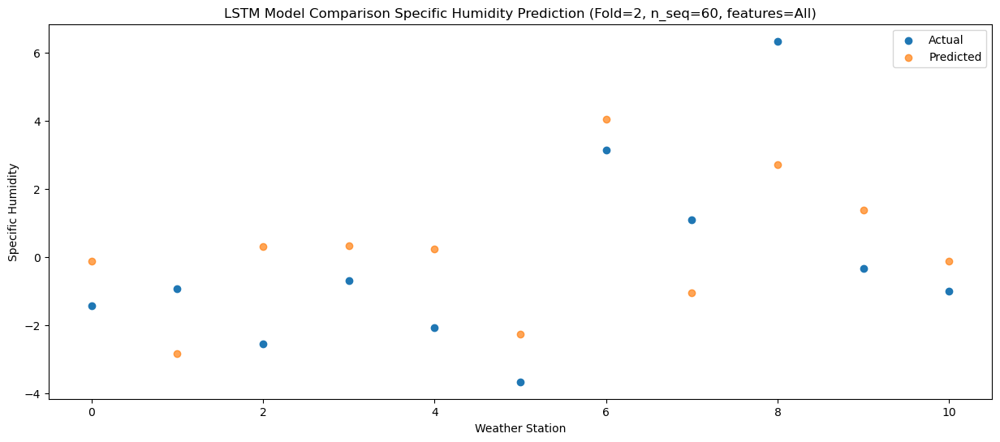

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.78   0.505447
1                 1   -1.03  -2.224553
2                 2   -1.37   0.925447
3                 3   -0.12   0.945447
4                 4   -0.63   0.855447
5                 5   -3.45  -1.654553
6                 6    3.62   4.665447
7                 7    0.10  -0.424553
8                 8    5.60   3.325447
9                 9    0.96   1.985447
10               10   -0.10   0.505447


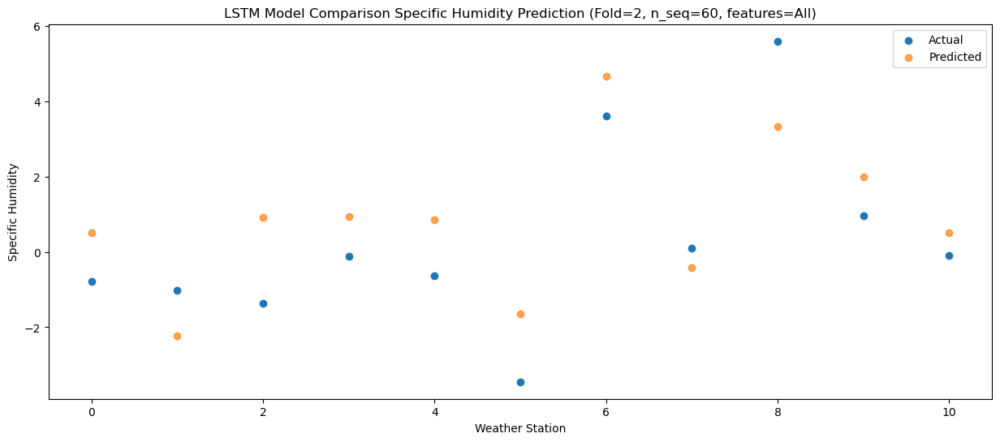

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.65   1.644824
1                 1   -0.15  -1.085176
2                 2    0.44   2.064824
3                 3    0.64   2.084824
4                 4    0.22   1.994824
5                 5   -1.83  -0.515176
6                 6    5.25   5.804824
7                 7    0.50   0.714824
8                 8    7.34   4.464824
9                 9    1.92   3.124824
10               10    0.52   1.644824


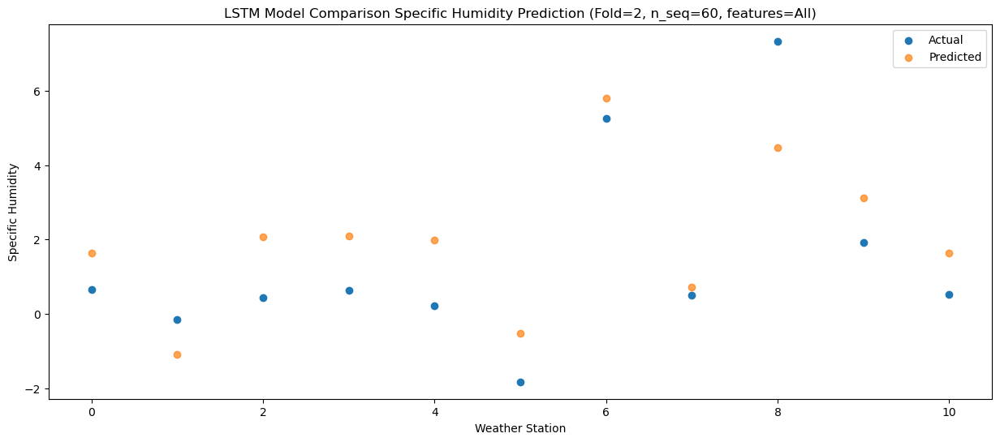

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.55    2.42612
1                 1    1.00   -0.30388
2                 2    1.80    2.84612
3                 3    1.34    2.86612
4                 4    2.65    2.77612
5                 5    2.13    0.26612
6                 6    9.15    6.58612
7                 7    0.51    1.49612
8                 8    8.18    5.24612
9                 9    2.96    3.90612
10               10    1.79    2.42612


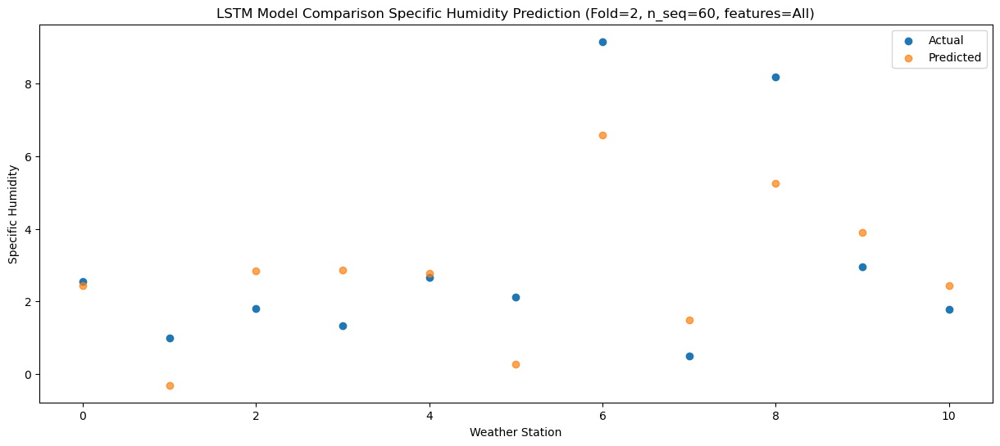

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    6.81   5.977984
1                 1    3.39   3.247984
2                 2    4.90   6.397984
3                 3    4.64   6.417984
4                 4    6.68   6.327984
5                 5    5.78   3.817984
6                 6   13.24  10.137984
7                 7    0.44   5.047984
8                 8    9.44   8.797984
9                 9    7.28   7.457984
10               10    5.95   5.977984


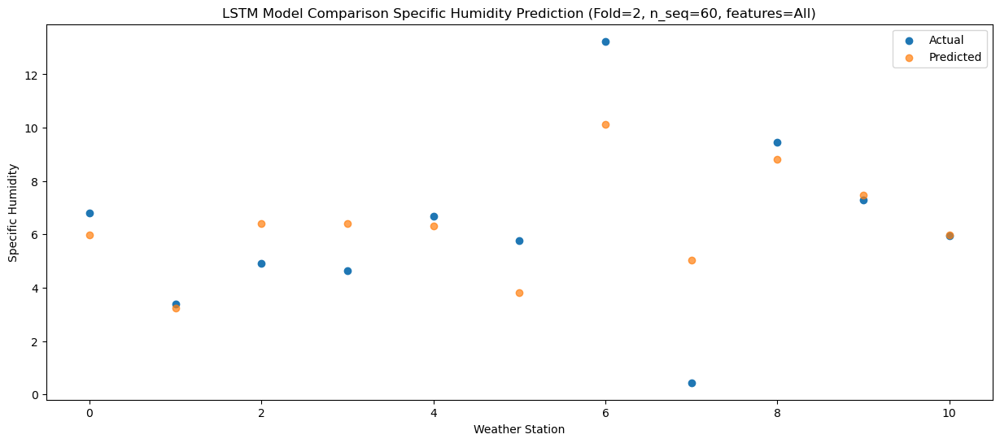

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    8.86   7.960523
1                 1    7.75   5.230523
2                 2    6.83   8.380523
3                 3    6.90   8.400523
4                 4    8.98   8.310523
5                 5    6.81   5.800523
6                 6   14.04  12.120523
7                 7    5.94   7.030523
8                 8   11.21  10.780523
9                 9    9.08   9.440523
10               10    7.91   7.960523


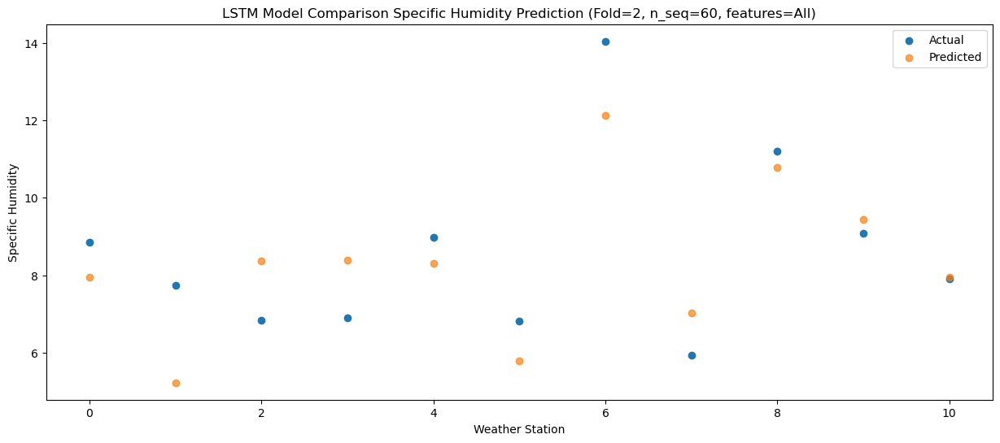

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.08  10.281415
1                 1    9.09   7.551415
2                 2    7.66  10.701415
3                 3   10.26  10.721415
4                 4   10.27  10.631415
5                 5    7.91   8.121415
6                 6   13.36  14.441415
7                 7    8.50   9.351415
8                 8   12.10  13.101415
9                 9   12.66  11.761415
10               10   11.12  10.281415


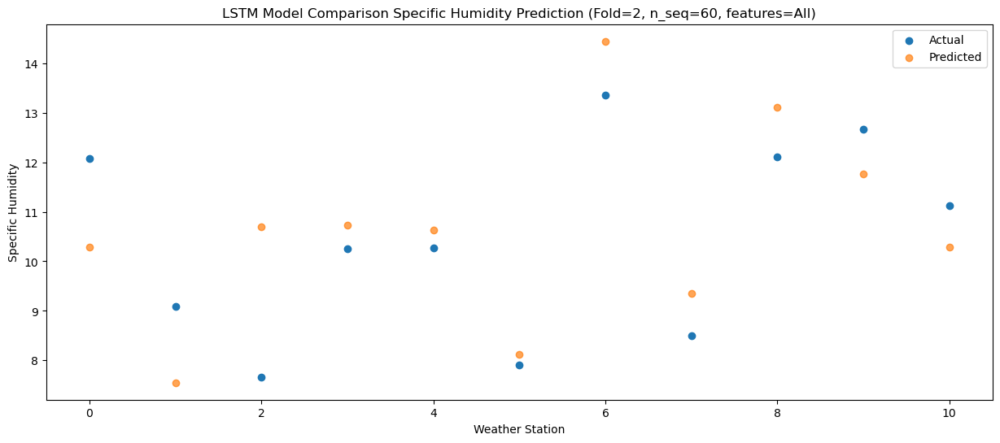

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.60   9.754416
1                 1    8.59   7.024416
2                 2    7.55  10.174416
3                 3   10.94  10.194416
4                 4   10.67  10.104416
5                 5    8.37   7.594416
6                 6   14.42  13.914416
7                 7   10.47   8.824416
8                 8   12.20  12.574416
9                 9   11.09  11.234416
10               10   10.13   9.754416


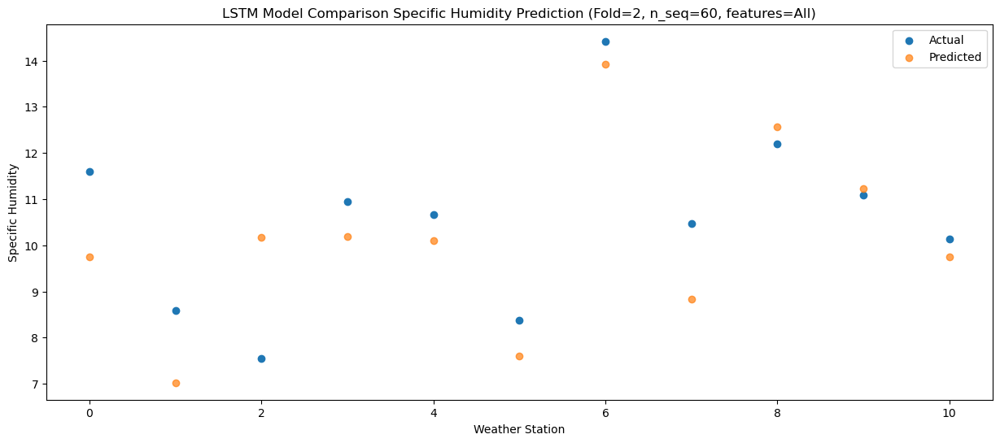

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.85   7.243171
1                 1    6.02   4.513171
2                 2    7.40   7.663171
3                 3    7.14   7.683171
4                 4    7.16   7.593171
5                 5    5.01   5.083171
6                 6   11.75  11.403171
7                 7    7.43   6.313171
8                 8   13.05  10.063171
9                 9    7.66   8.723171
10               10    6.65   7.243171


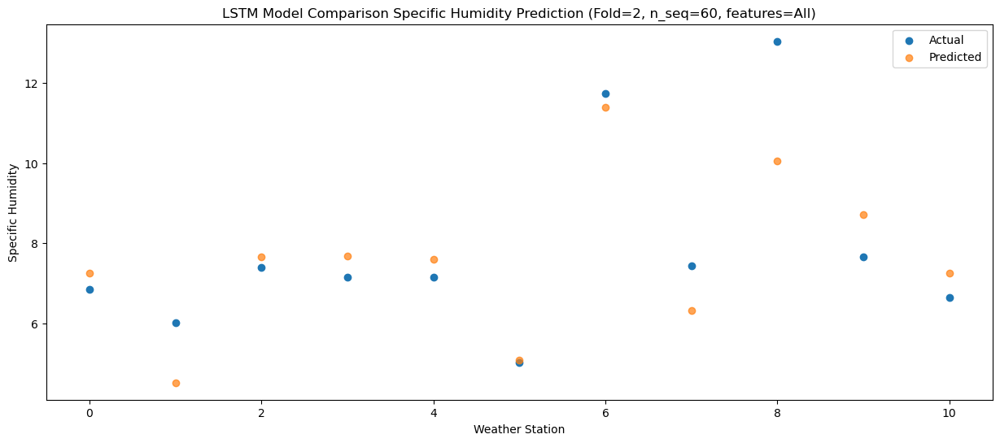

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   2.961272
1                 1    2.34   0.231272
2                 2    3.01   3.381272
3                 3    4.27   3.401272
4                 4    1.98   3.311272
5                 5    0.19   0.801272
6                 6    6.97   7.121272
7                 7    5.35   2.031272
8                 8   11.28   5.781272
9                 9    3.30   4.441272
10               10    1.99   2.961272


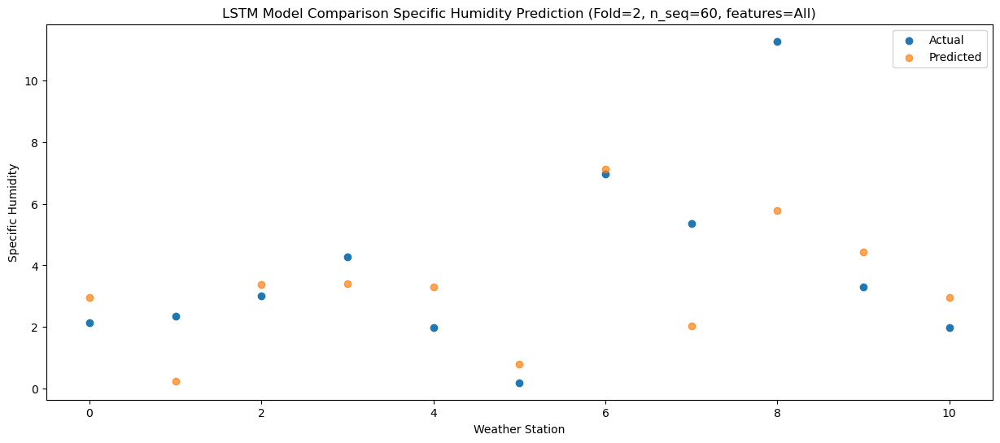

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.19   1.979047
1                 1    0.84  -0.750953
2                 2    2.90   2.399047
3                 3    2.45   2.419047
4                 4    1.54   2.329047
5                 5    0.05  -0.180953
6                 6    6.52   6.139047
7                 7    1.38   1.049047
8                 8    6.64   4.799047
9                 9    2.83   3.459047
10               10    1.37   1.979047


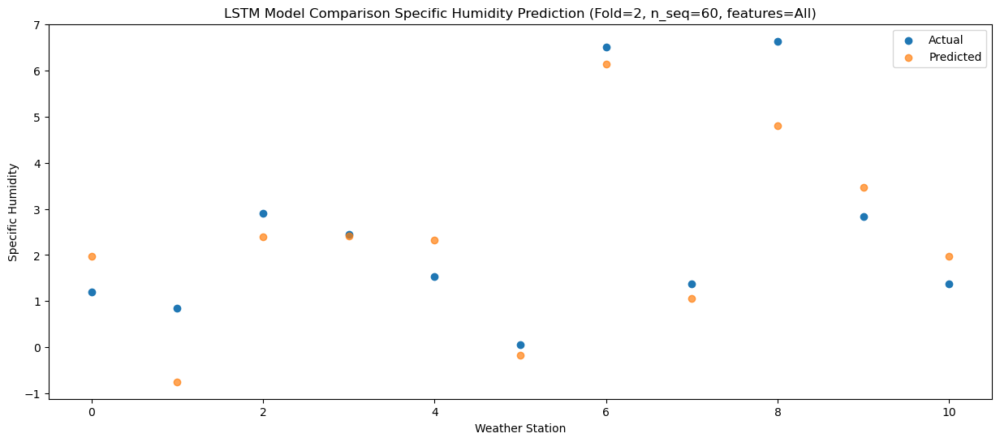

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.56   0.555433
1                 1   -0.35  -2.174567
2                 2   -0.76   0.975433
3                 3    0.36   0.995433
4                 4    0.99   0.905433
5                 5   -0.86  -1.604567
6                 6    5.35   4.715433
7                 7    2.20  -0.374567
8                 8    7.49   3.375433
9                 9    0.59   2.035433
10               10    0.28   0.555433


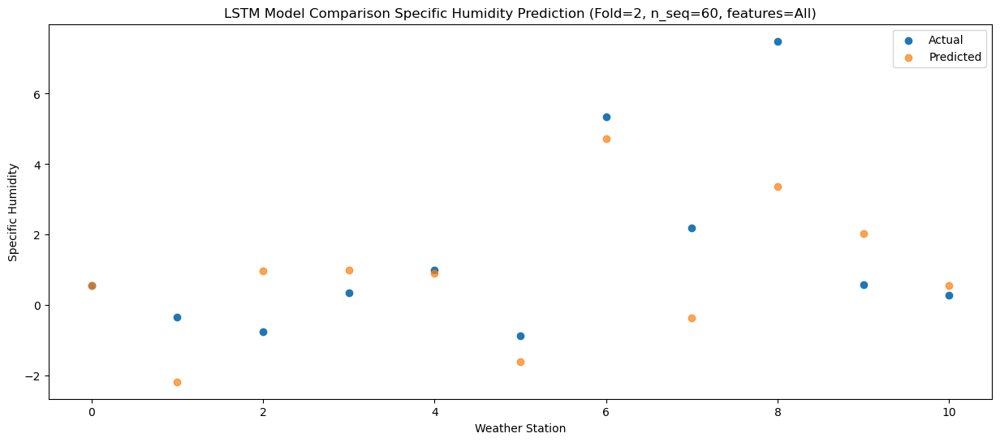

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.97   1.272516
1                 1   -0.36  -1.457484
2                 2   -1.14   1.692516
3                 3    0.87   1.712516
4                 4    0.90   1.622516
5                 5   -1.24  -0.887484
6                 6    4.57   5.432516
7                 7    1.31   0.342516
8                 8    7.58   4.092516
9                 9    1.45   2.752516
10               10    0.55   1.272516


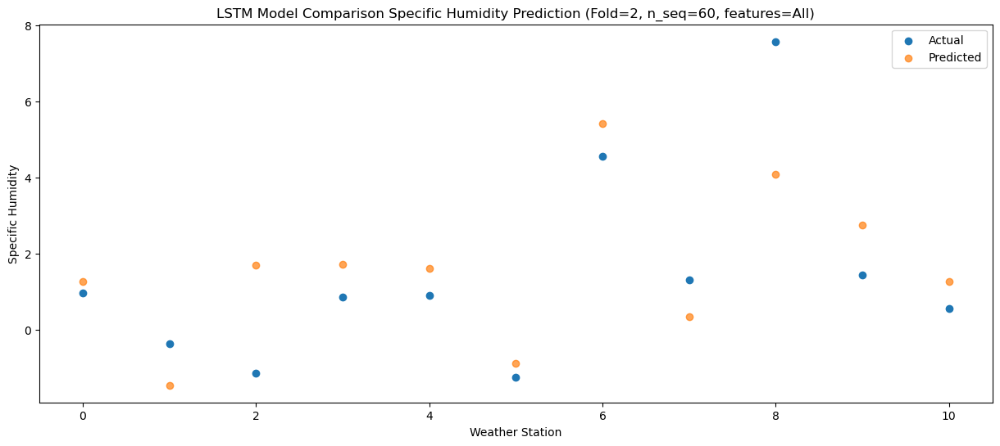

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.19   1.244283
1                 1   -0.44  -1.485717
2                 2    0.71   1.664283
3                 3    0.11   1.684283
4                 4    2.20   1.594283
5                 5   -0.79  -0.915717
6                 6    4.97   5.404283
7                 7    1.19   0.314283
8                 8    6.17   4.064283
9                 9    2.21   2.724283
10               10    0.95   1.244283


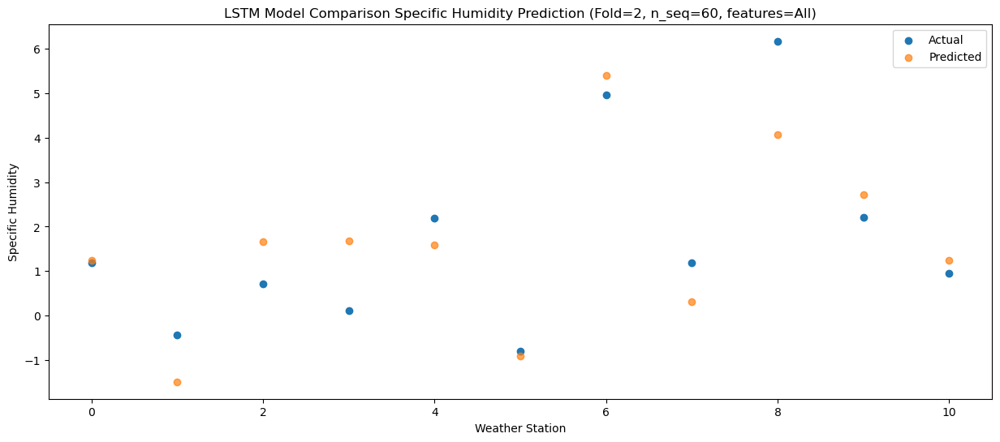

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.54      1.026
1                 1    0.25     -1.704
2                 2    1.10      1.446
3                 3    0.36      1.466
4                 4    3.08      1.376
5                 5    0.99     -1.134
6                 6    6.88      5.186
7                 7    1.53      0.096
8                 8    8.09      3.846
9                 9    1.90      2.506
10               10    0.55      1.026


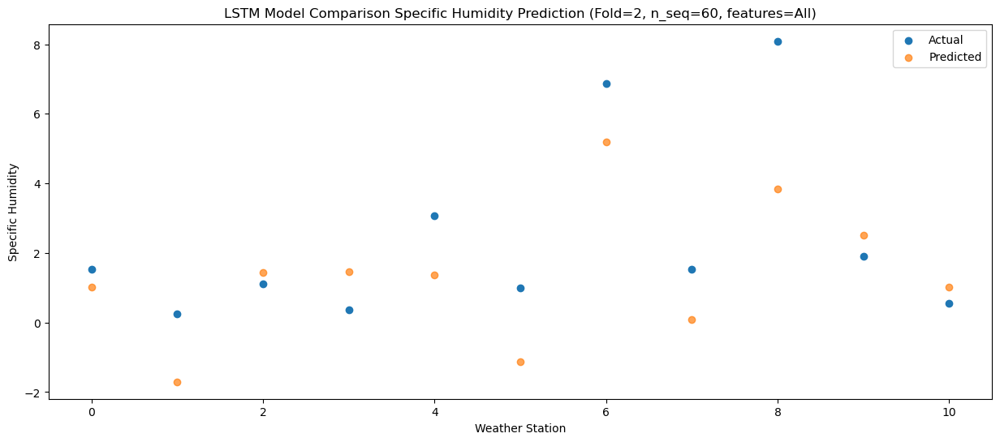

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.48   2.803336
1                 1    0.87   0.073336
2                 2    2.61   3.223336
3                 3    2.44   3.243336
4                 4    3.63   3.153336
5                 5    1.54   0.643336
6                 6    7.55   6.963336
7                 7    0.69   1.873336
8                 8    8.79   5.623336
9                 9    4.03   4.283336
10               10    2.19   2.803336


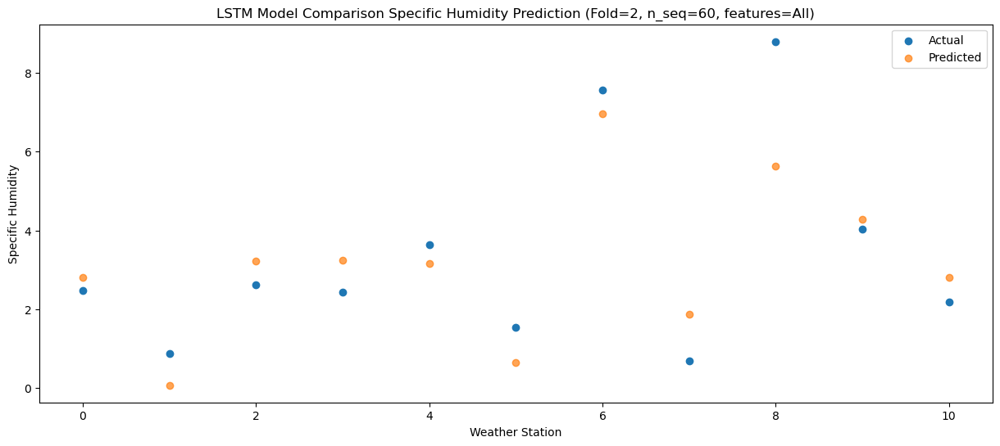

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.09   4.897832
1                 1    6.65   2.167832
2                 2    3.42   5.317832
3                 3    3.25   5.337832
4                 4    6.69   5.247832
5                 5    5.24   2.737832
6                 6   11.44   9.057832
7                 7    2.69   3.967832
8                 8   10.19   7.717832
9                 9    5.56   6.377832
10               10    4.78   4.897832


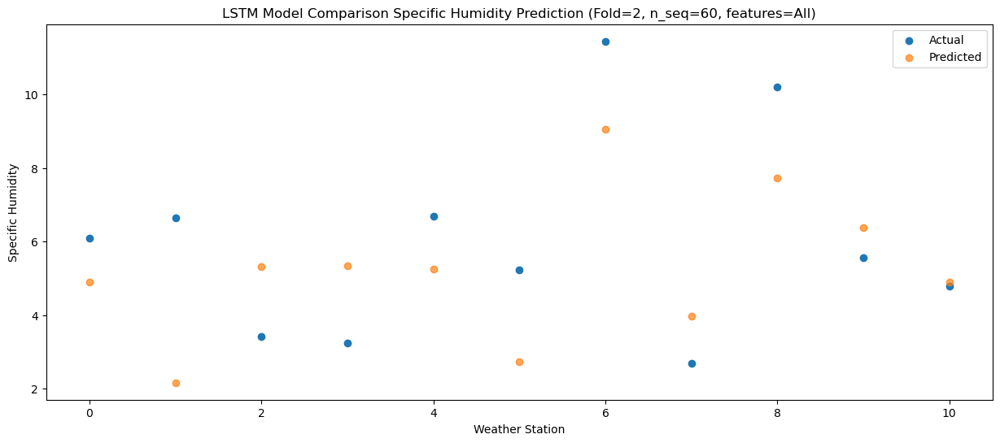

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.06   7.488078
1                 1    9.30   4.758078
2                 2    6.58   7.908078
3                 3    7.15   7.928078
4                 4   10.00   7.838078
5                 5    8.70   5.328078
6                 6   15.34  11.648078
7                 7    2.49   6.558078
8                 8   10.57  10.308078
9                 9    8.42   8.968078
10               10    6.62   7.488078


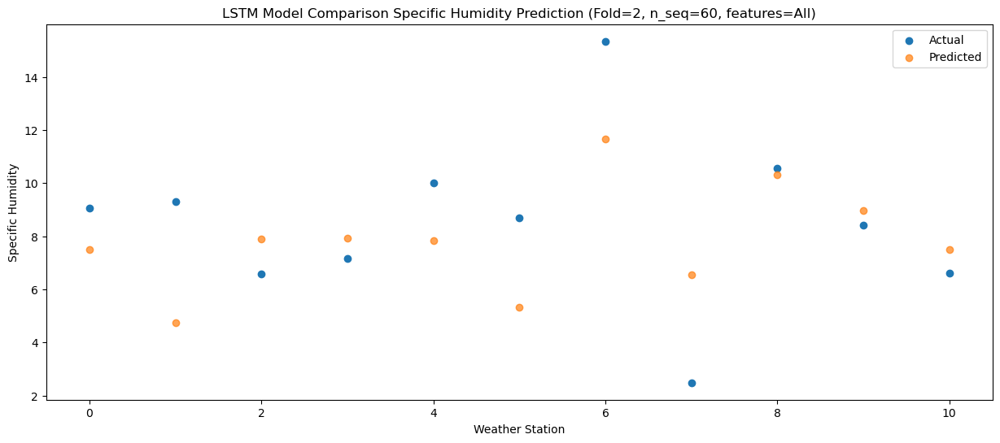

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.24  10.388448
1                 1   11.36   7.658448
2                 2    7.55  10.808448
3                 3   11.41  10.828448
4                 4   11.34  10.738448
5                 5    8.41   8.228448
6                 6   14.63  14.548448
7                 7    5.84   9.458448
8                 8   11.91  13.208448
9                 9   12.26  11.868448
10               10    9.93  10.388448


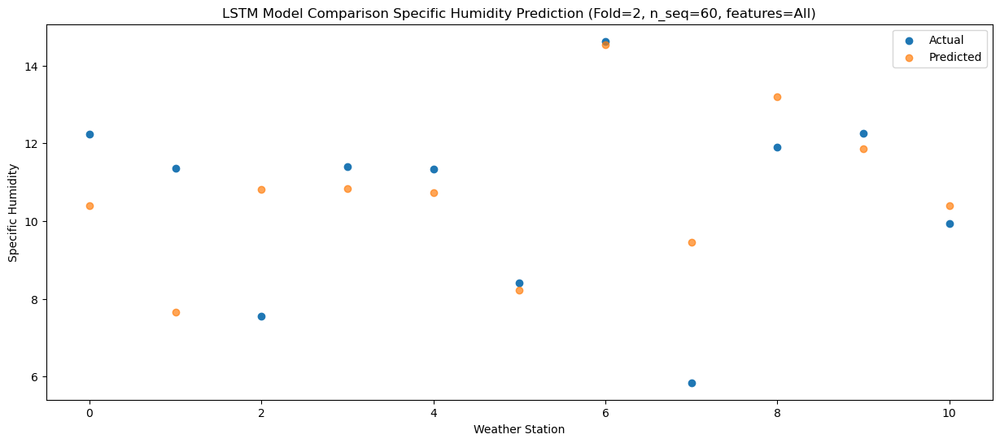

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   11.59  10.151747
1                 1    9.47   7.421747
2                 2    8.27  10.571747
3                 3    9.07  10.591747
4                 4   11.37  10.501747
5                 5    6.98   7.991747
6                 6   12.58  14.311747
7                 7    8.03   9.221747
8                 8   12.52  12.971747
9                 9   11.77  11.631747
10               10   10.04  10.151747


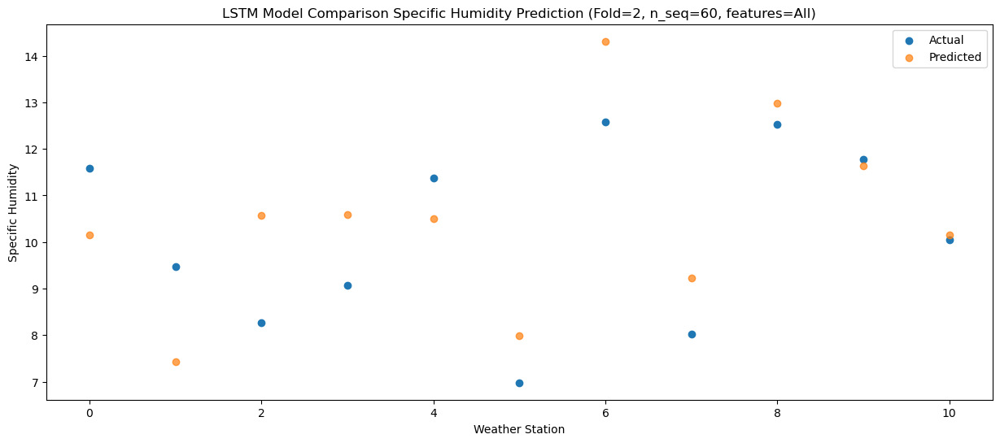

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    7.56   7.690162
1                 1    6.88   4.960162
2                 2    5.88   8.110162
3                 3    8.06   8.130162
4                 4    9.02   8.040162
5                 5    6.43   5.530162
6                 6   11.95  11.850162
7                 7    6.22   6.760162
8                 8   12.27  10.510162
9                 9    8.63   9.170162
10               10    7.62   7.690162


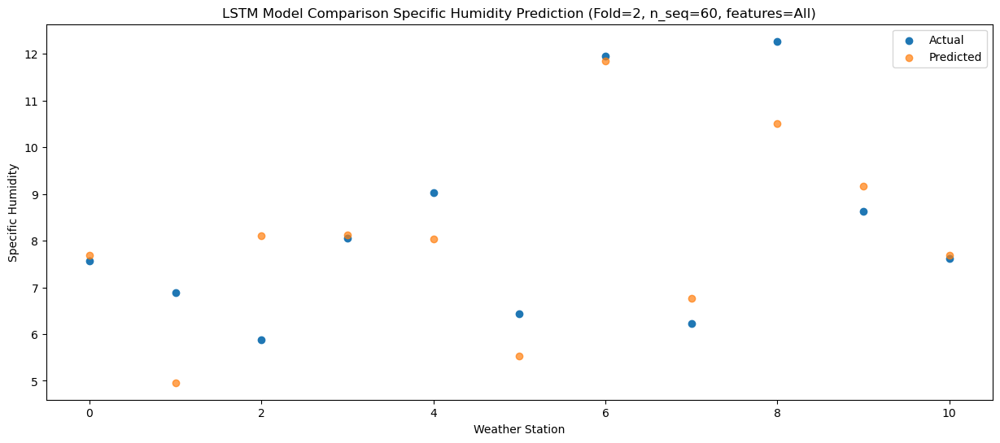

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.46   4.242704
1                 1    3.42   1.512704
2                 2    2.96   4.662704
3                 3    4.70   4.682704
4                 4    3.79   4.592704
5                 5    2.90   2.082704
6                 6    8.80   8.402704
7                 7    3.77   3.312704
8                 8    9.97   7.062704
9                 9    4.44   5.722704
10               10    3.51   4.242704


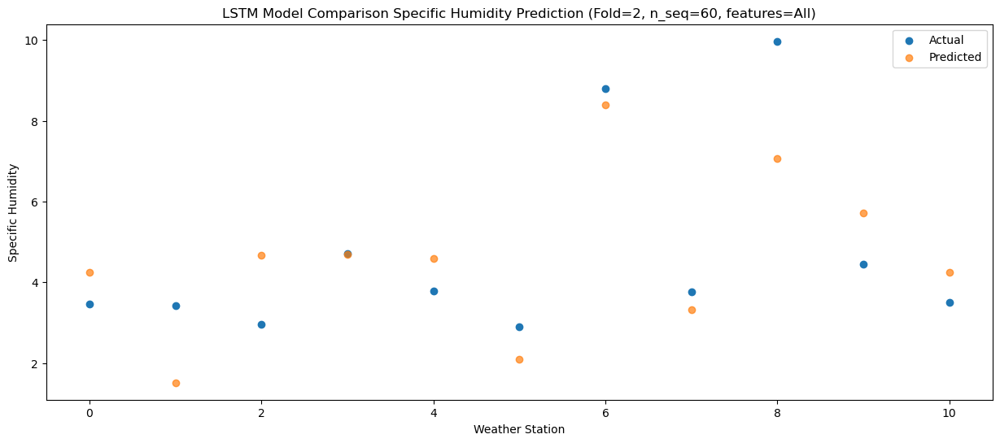

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.82   1.221462
1                 1    0.86  -1.508538
2                 2    0.46   1.641462
3                 3    0.87   1.661462
4                 4    1.27   1.571462
5                 5   -0.27  -0.938538
6                 6    6.18   5.381462
7                 7    2.85   0.291462
8                 8    6.94   4.041462
9                 9    1.33   2.701462
10               10    0.56   1.221462


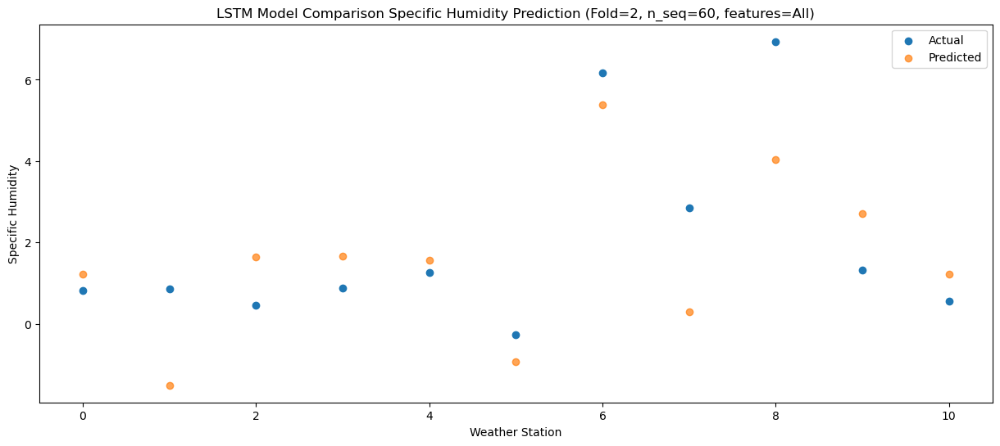

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.10   1.318855
1                 1    0.47  -1.411145
2                 2   -0.11   1.738855
3                 3    1.16   1.758855
4                 4   -0.32   1.668855
5                 5   -2.20  -0.841145
6                 6    4.36   5.478855
7                 7    1.33   0.388855
8                 8    7.73   4.138855
9                 9    1.24   2.798855
10               10    0.35   1.318855


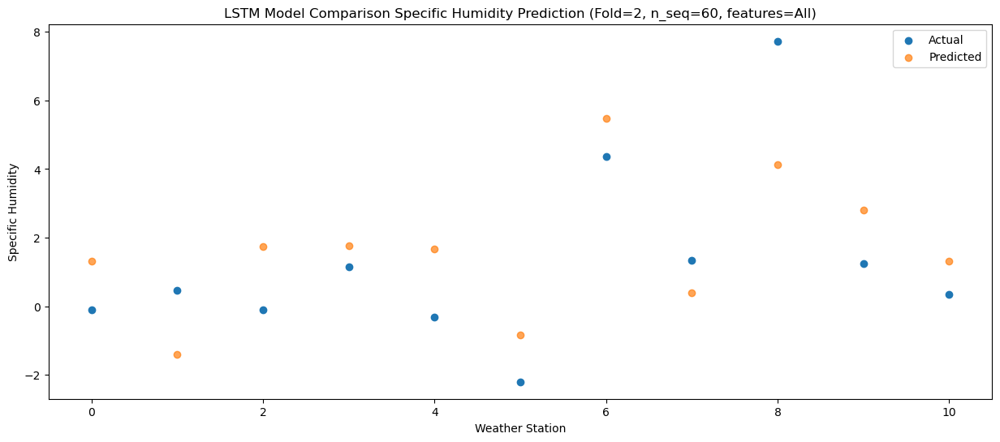

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.99    0.38312
1                 1   -0.12   -2.34688
2                 2   -1.18    0.80312
3                 3   -0.17    0.82312
4                 4   -1.19    0.73312
5                 5   -3.21   -1.77688
6                 6    3.24    4.54312
7                 7    1.75   -0.54688
8                 8    7.70    3.20312
9                 9    0.55    1.86312
10               10   -0.27    0.38312


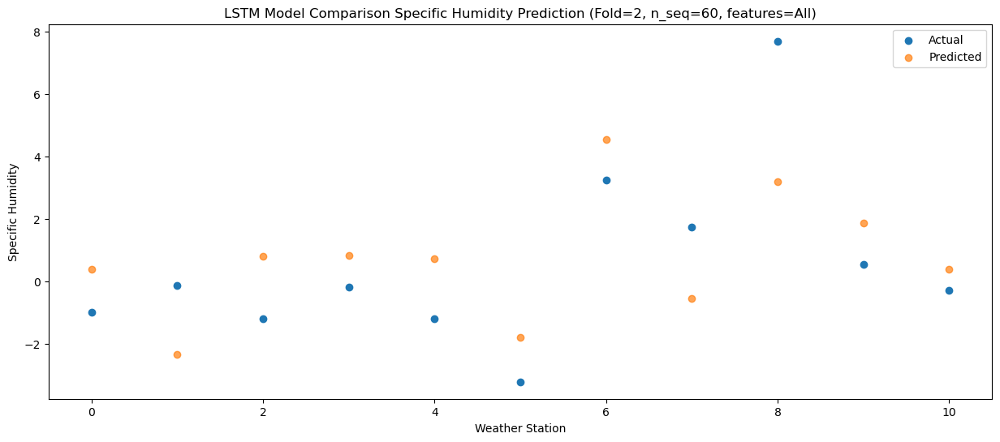

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.88   0.462033
1                 1    0.70  -2.267967
2                 2   -1.60   0.882033
3                 3   -0.22   0.902033
4                 4   -0.13   0.812033
5                 5   -0.81  -1.697967
6                 6    5.71   4.622033
7                 7    1.77  -0.467967
8                 8    8.67   3.282033
9                 9    0.69   1.942033
10               10    0.13   0.462033


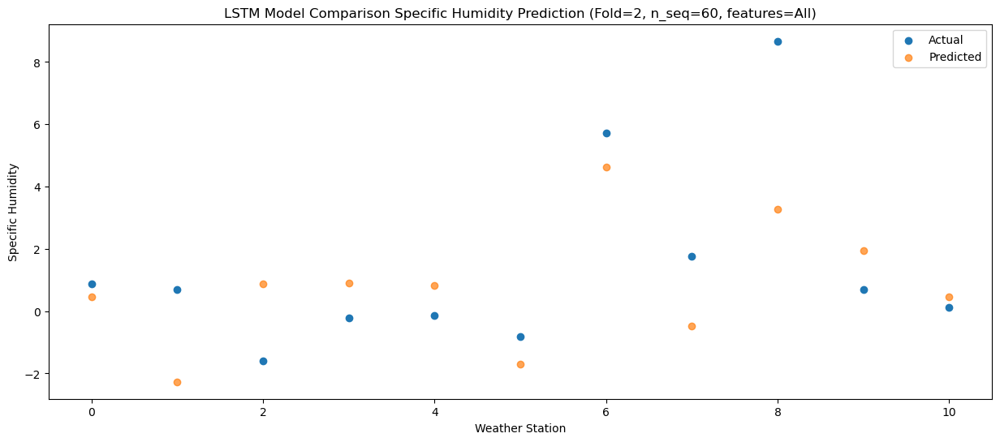

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.70   1.542474
1                 1    0.95  -1.187526
2                 2    1.56   1.962474
3                 3    0.83   1.982474
4                 4    1.47   1.892474
5                 5    0.83  -0.617526
6                 6    7.33   5.702474
7                 7    1.99   0.612474
8                 8    7.11   4.362474
9                 9    2.10   3.022474
10               10    1.23   1.542474


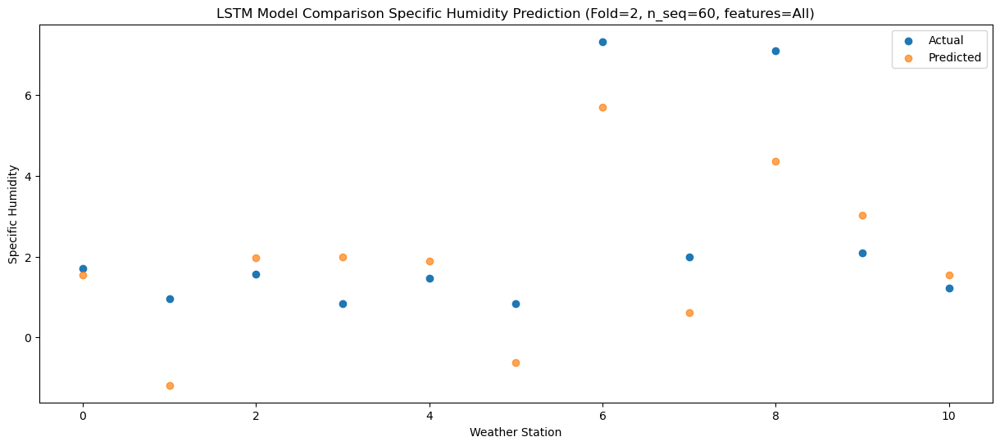

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   3.061996
1                 1    1.91   0.331996
2                 2    0.35   3.481996
3                 3    1.72   3.501996
4                 4    3.54   3.411996
5                 5    3.11   0.901996
6                 6    9.53   7.221996
7                 7    1.32   2.131996
8                 8    6.21   5.881996
9                 9    4.32   4.541996
10               10    3.34   3.061996


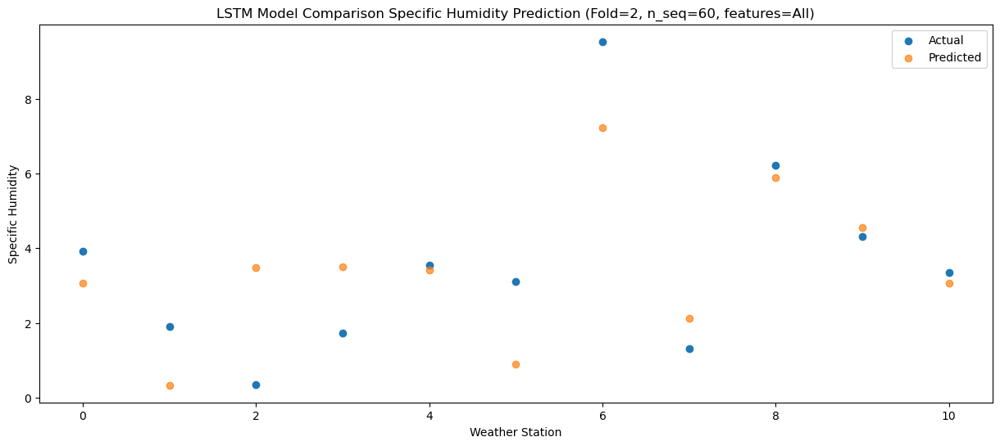

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.17   6.174532
1                 1    4.94   3.444532
2                 2    5.21   6.594532
3                 3    4.90   6.614532
4                 4    7.97   6.524532
5                 5    7.21   4.014532
6                 6   13.31  10.334532
7                 7    1.01   5.244532
8                 8   10.31   8.994532
9                 9    8.20   7.654532
10               10    7.20   6.174532


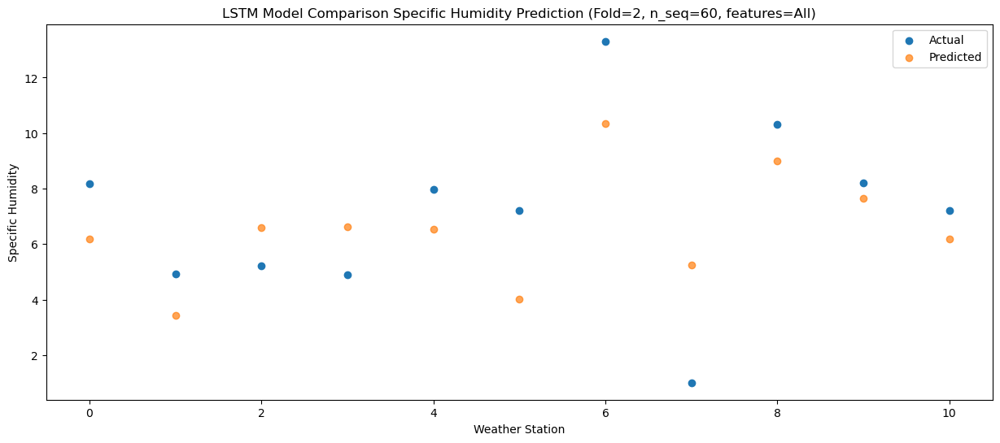

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.14   8.165287
1                 1   10.95   5.435287
2                 2    7.27   8.585287
3                 3    7.82   8.605287
4                 4    9.94   8.515287
5                 5    8.87   6.005287
6                 6   14.90  12.325287
7                 7    5.06   7.235287
8                 8   11.91  10.985287
9                 9   10.07   9.645287
10               10    8.75   8.165287


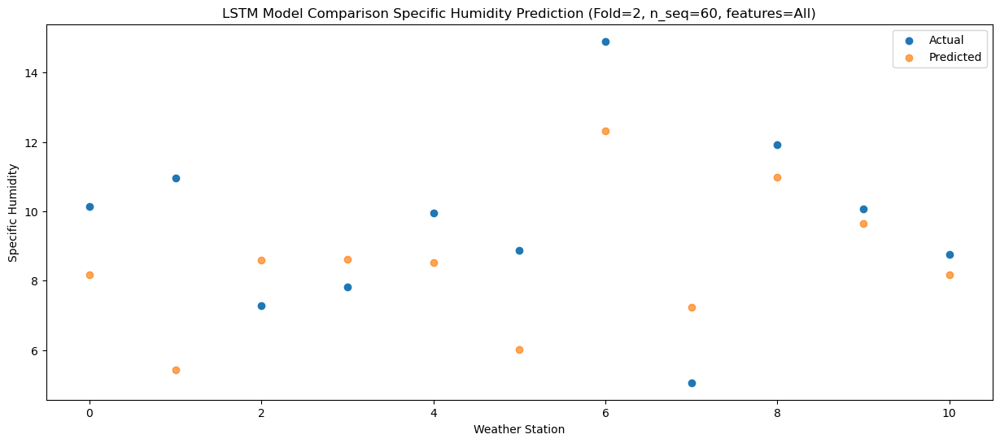

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.61   9.771766
1                 1    9.50   7.041766
2                 2    8.32  10.191766
3                 3   10.99  10.211766
4                 4   11.58  10.121766
5                 5    9.17   7.611766
6                 6   15.13  13.931766
7                 7    8.66   8.841766
8                 8   13.14  12.591766
9                 9   12.68  11.251766
10               10   10.79   9.771766


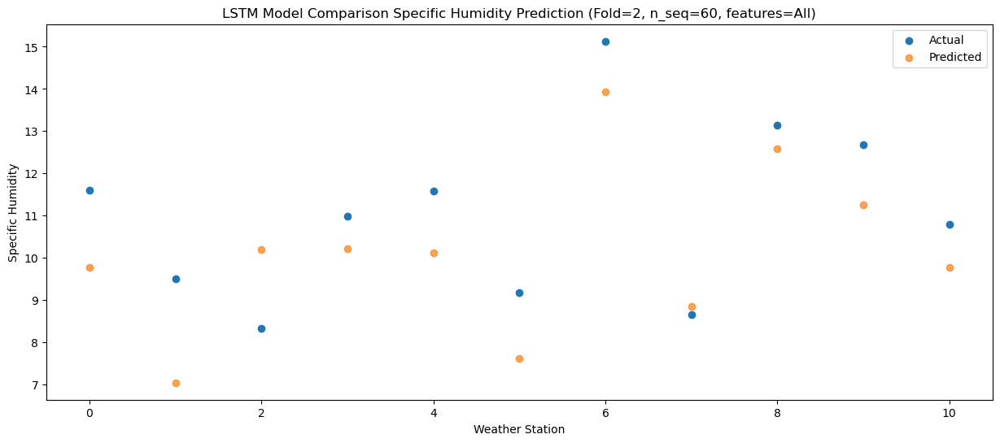

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.61   9.341173
1                 1   10.48   6.611173
2                 2    8.92   9.761173
3                 3    9.49   9.781173
4                 4   10.41   9.691173
5                 5    9.21   7.181173
6                 6   14.95  13.501173
7                 7    8.34   8.411173
8                 8   12.32  12.161173
9                 9   11.42  10.821173
10               10    9.78   9.341173


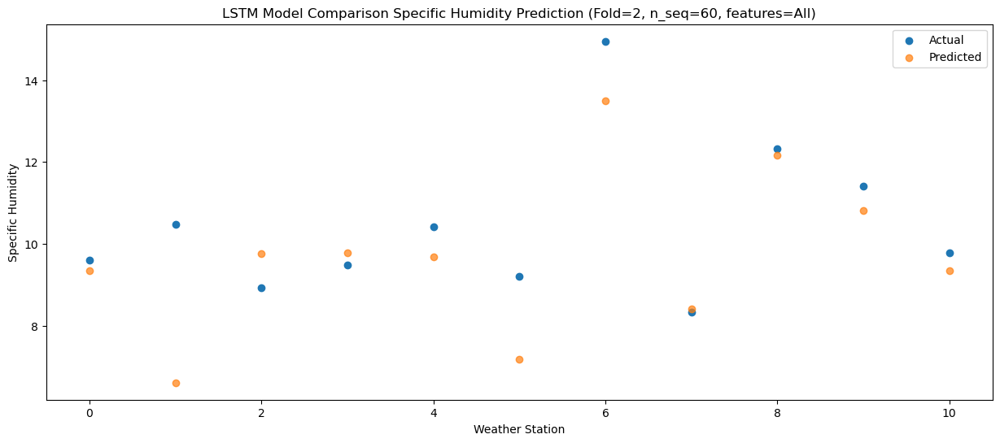

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.99   7.204811
1                 1    6.53   4.474811
2                 2    9.35   7.624811
3                 3    6.60   7.644811
4                 4    8.81   7.554811
5                 5    6.72   5.044811
6                 6   12.05  11.364811
7                 7    5.60   6.274811
8                 8   11.93  10.024811
9                 9    9.57   8.684811
10               10    7.68   7.204811


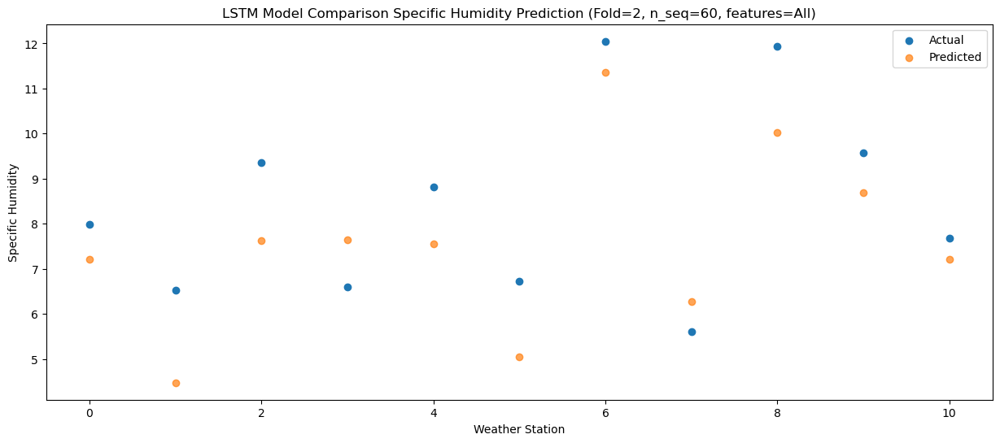

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.61   3.543539
1                 1    3.67   0.813539
2                 2    4.37   3.963539
3                 3    3.36   3.983539
4                 4    3.95   3.893539
5                 5    2.40   1.383539
6                 6    8.63   7.703539
7                 7    2.71   2.613539
8                 8   10.03   6.363539
9                 9    4.95   5.023539
10               10    3.61   3.543539


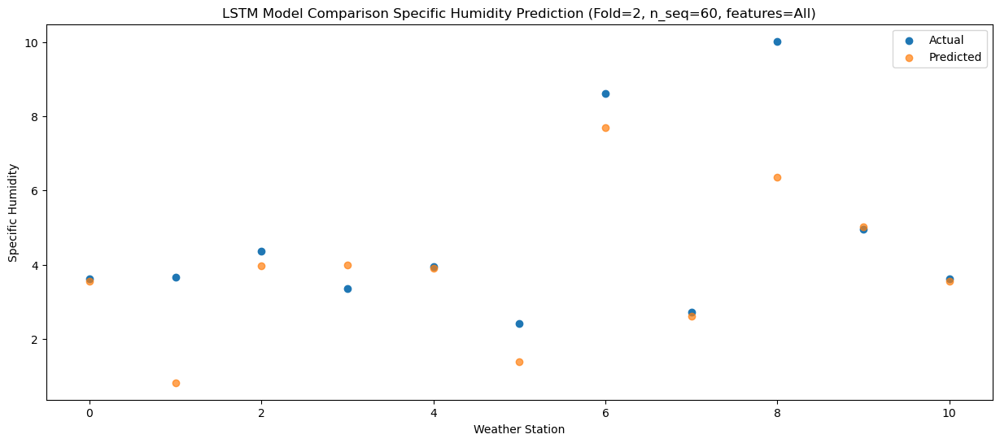

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (1, 1, 1024)              12308480  
                                                                 
 dropout_4 (Dropout)         (1, 1, 1024)              0         
                                                                 
 lstm_5 (LSTM)               (1, 1024)                 8392704   
                                                                 
 dropout_5 (Dropout)         (1, 1024)                 0         
                                                                 
 dense_6 (Dense)             (1, 256)                  262400    
                                                                 
 dense_7 (Dense)             (1, 128)                  32896     
                                                                 
 dense_8 (Dense)             (1, 60)                  

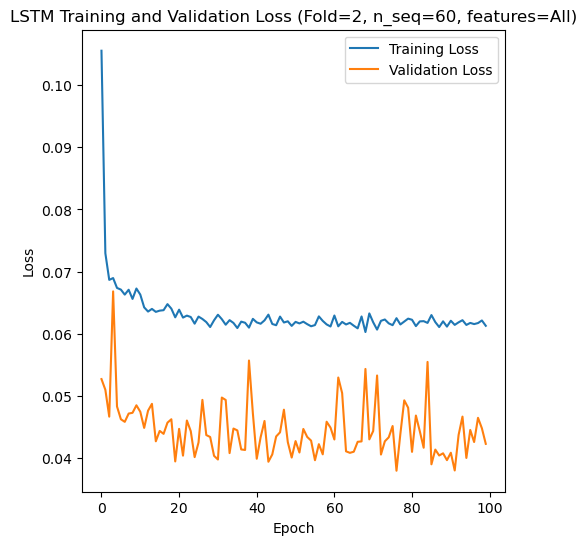

Epoch 1/100
84/84 [==============================] - 34s 164ms/step - loss: 0.1007 - accuracy: 0.2857 - mae: 0.0806 - rmse: 0.1007 - mape: 18.4203 - pearson: 0.6811 - val_loss: 0.0722 - val_accuracy: 0.0000e+00 - val_mae: 0.0591 - val_rmse: 0.0722 - val_mape: 12.9016 - val_pearson: 0.6766
Epoch 2/100
84/84 [==============================] - 7s 82ms/step - loss: 0.0675 - accuracy: 0.4405 - mae: 0.0531 - rmse: 0.0675 - mape: 12.0920 - pearson: 0.7868 - val_loss: 0.0727 - val_accuracy: 0.6000 - val_mae: 0.0572 - val_rmse: 0.0727 - val_mape: 12.2266 - val_pearson: 0.7270
Epoch 3/100
84/84 [==============================] - 8s 89ms/step - loss: 0.0658 - accuracy: 0.4643 - mae: 0.0511 - rmse: 0.0658 - mape: 11.5387 - pearson: 0.7968 - val_loss: 0.0773 - val_accuracy: 0.6000 - val_mae: 0.0604 - val_rmse: 0.0773 - val_mape: 12.8843 - val_pearson: 0.6374
Epoch 4/100
84/84 [==============================] - 7s 84ms/step - loss: 0.0635 - accuracy: 0.3810 - mae: 0.0498 - rmse: 0.0635 - mape: 11.28

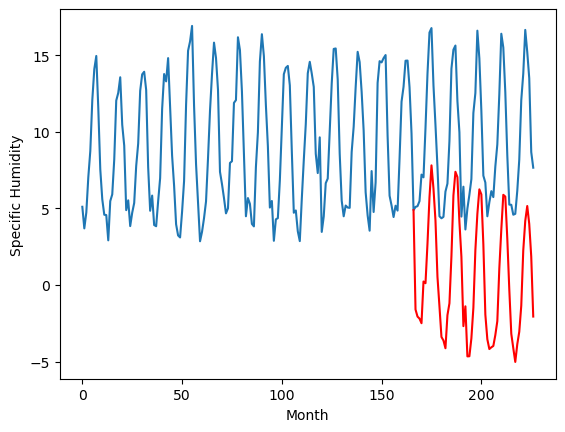

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.14		-0.55		-0.41
-0.55		-1.01		-0.46
-0.58		-1.15		-0.57
-0.94		-1.45		-0.51
1.66		1.27		-0.39
1.81		1.16		-0.65
4.78		3.75		-1.03
8.31		6.76		-1.55
11.05		8.85		-2.20
8.38		7.34		-1.04
6.94		5.26		-1.68
2.37		1.58		-0.79
0.87		-0.35		-1.22
-1.17		-2.34		-1.17
-1.26		-2.57		-1.31
-1.82		-3.08		-1.26
0.69		-0.92		-1.61
1.86		-0.15		-2.01
5.38		2.92		-2.46
9.91		6.89		-3.02
10.79		8.43		-2.36
10.96		8.09		-2.87
6.99		5.16		-1.83
4.80		2.89		-1.91
0.37		-1.64		-2.01
1.34		-0.34		-1.68
-1.85		-3.61		-1.76
-1.48		-3.60		-2.12
-0.01		-2.43		-2.42
2.29		-0.44		-2.73
6.74		3.32		-3.42
9.36		5.69		-3.67
9.57		7.29		-2.28
10.18		6.96		-3.22
6.33		3.70		-2.63
1.87		-0.89		-2.76
0.84		-2.50		-3.34
-0.35		-3.13		-2.78
-0.43		-3.02		-2.59
-0.27		-2.93		-2.66
0.67		-2.22		-2.89
1.54		-1.31		-2.85
5.95		2.12		-3.83
8.59		4.67		-3.92
10.86		6.93		-3.93
11.10		6.81		-4.29
7.03		4.08		-2.95
3.59		0.76		-2.83

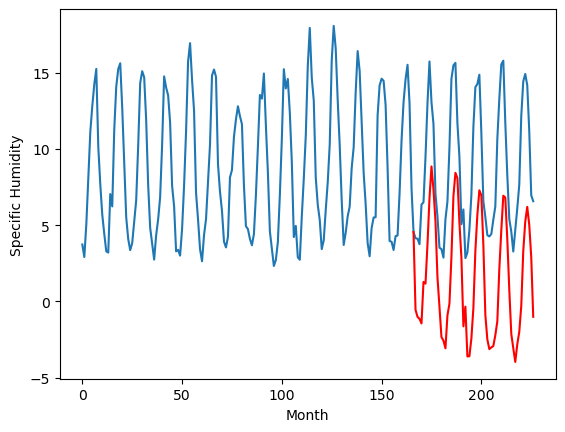

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.99		2.65		-3.34
6.53		2.19		-4.34
6.15		2.05		-4.10
5.46		1.75		-3.71
6.54		4.47		-2.07
7.91		4.36		-3.55
7.72		6.95		-0.77
9.26		9.96		0.70
9.48		12.05		2.57
11.00		10.54		-0.46
10.52		8.46		-2.06
8.64		4.78		-3.86
5.95		2.85		-3.10
5.35		0.86		-4.49
5.79		0.63		-5.16
5.73		0.12		-5.61
5.81		2.28		-3.53
6.43		3.05		-3.38
6.83		6.12		-0.71
9.28		10.09		0.81
9.98		11.63		1.65
9.51		11.29		1.78
8.22		8.36		0.14
7.08		6.09		-0.99
7.66		1.56		-6.10
6.16		2.86		-3.30
5.88		-0.41		-6.29
5.10		-0.40		-5.50
6.44		0.77		-5.67
6.11		2.76		-3.35
6.29		6.52		0.23
7.46		8.89		1.43
8.63		10.49		1.86
9.42		10.16		0.74
9.13		6.90		-2.23
7.96		2.31		-5.65
5.24		0.70		-4.54
6.08		0.07		-6.01
6.23		0.18		-6.05
5.10		0.27		-4.83
6.62		0.98		-5.64
6.82		1.89		-4.93
7.76		5.32		-2.44
8.53		7.87		-0.66
9.63		10.13		0.50
10.70		10.01		-0.69
9.16		7.28		-1.88
8.00		3.96		-4.04
5.89		1.06		-4.83
6.12		0.13		-5.99
6.

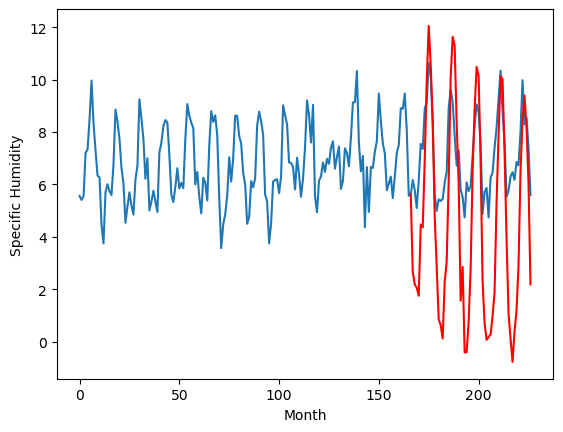

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.83		0.43		1.26
-0.30		-0.03		0.27
-0.70		-0.17		0.53
-0.88		-0.47		0.41
0.98		2.25		1.27
0.90		2.14		1.24
4.33		4.73		0.40
7.57		7.74		0.17
10.67		9.83		-0.84
9.59		8.32		-1.27
7.02		6.24		-0.78
3.33		2.56		-0.77
0.44		0.63		0.19
-1.17		-1.36		-0.19
-1.44		-1.59		-0.15
-1.51		-2.10		-0.59
-0.21		0.06		0.27
0.98		0.83		-0.15
3.51		3.90		0.39
8.93		7.87		-1.06
9.56		9.41		-0.15
10.44		9.07		-1.37
6.97		6.14		-0.83
4.91		3.87		-1.04
-0.78		-0.66		0.12
0.36		0.64		0.28
-1.96		-2.63		-0.67
-1.44		-2.62		-1.18
-0.46		-1.45		-0.99
0.81		0.54		-0.27
5.23		4.30		-0.93
7.49		6.67		-0.82
10.53		8.27		-2.26
9.40		7.94		-1.46
6.15		4.68		-1.47
1.00		0.09		-0.91
0.19		-1.52		-1.71
-0.84		-2.15		-1.31
-0.30		-2.04		-1.74
-0.48		-1.95		-1.47
-0.61		-1.24		-0.63
0.93		-0.33		-1.26
3.84		3.10		-0.74
5.86		5.65		-0.21
9.51		7.91		-1.60
8.96		7.79		-1.17
6.49		5.06		-1.43
2.96		1.74		-1.22
-0.43		-1.16		-0.73

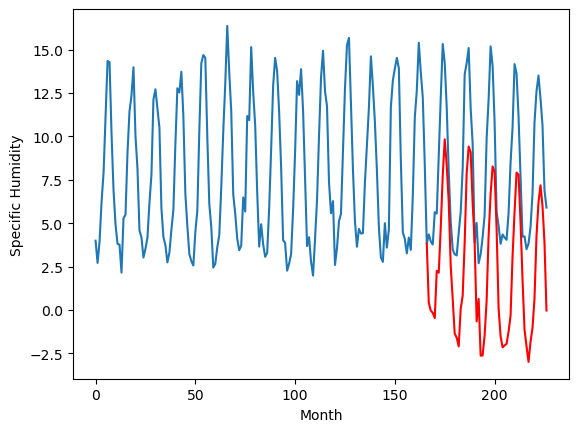

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.61		1.83		-1.78
2.11		1.37		-0.74
-0.18		1.23		1.41
-0.94		0.93		1.87
1.13		3.65		2.52
1.45		3.54		2.09
5.15		6.13		0.98
8.24		9.14		0.90
12.19		11.23		-0.96
9.81		9.72		-0.09
6.85		7.64		0.79
2.13		3.96		1.83
1.03		2.03		1.00
-0.90		0.04		0.94
-1.10		-0.19		0.91
-1.93		-0.70		1.23
0.55		1.46		0.91
1.61		2.23		0.62
4.03		5.30		1.27
8.49		9.27		0.78
10.44		10.81		0.37
10.53		10.47		-0.06
6.76		7.54		0.78
4.81		5.27		0.46
-0.31		0.74		1.05
0.39		2.04		1.65
-2.07		-1.23		0.84
-1.45		-1.22		0.23
0.12		-0.05		-0.17
1.68		1.94		0.26
5.77		5.70		-0.07
7.87		8.07		0.20
10.46		9.67		-0.79
9.96		9.34		-0.62
6.86		6.08		-0.78
1.86		1.49		-0.37
0.47		-0.12		-0.59
-0.65		-0.75		-0.10
-0.27		-0.64		-0.37
0.61		-0.55		-1.16
0.28		0.16		-0.12
1.51		1.07		-0.44
4.69		4.50		-0.19
6.82		7.05		0.23
10.59		9.31		-1.28
10.98		9.19		-1.79
6.87		6.46		-0.41
3.25		3.14		-0.11
0.08		0.24		0.16
-0.33		-0.69		-0.36
-1

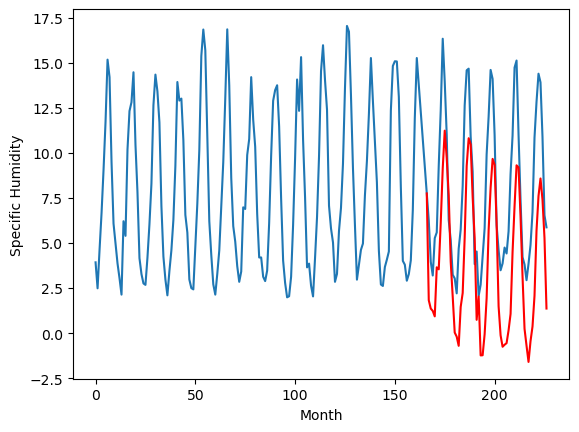

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.24		0.45		0.21
0.53		-0.01		-0.54
0.03		-0.15		-0.18
-0.22		-0.45		-0.23
1.77		2.27		0.50
1.89		2.16		0.27
5.10		4.75		-0.35
7.83		7.76		-0.07
10.99		9.85		-1.14
9.77		8.34		-1.43
6.59		6.26		-0.33
3.17		2.58		-0.59
1.40		0.65		-0.75
-0.26		-1.34		-1.08
-0.57		-1.57		-1.00
-1.09		-2.08		-0.99
0.94		0.08		-0.86
2.24		0.85		-1.39
4.48		3.92		-0.56
9.70		7.89		-1.81
10.95		9.43		-1.52
11.12		9.09		-2.03
7.82		6.16		-1.66
6.20		3.89		-2.31
0.33		-0.64		-0.97
1.38		0.66		-0.72
-1.13		-2.61		-1.48
-0.60		-2.60		-2.00
0.71		-1.43		-2.14
2.24		0.56		-1.68
6.47		4.32		-2.15
8.54		6.69		-1.85
11.32		8.29		-3.03
10.12		7.96		-2.16
7.35		4.70		-2.65
2.05		0.11		-1.94
0.83		-1.50		-2.33
0.07		-2.13		-2.20
0.65		-2.02		-2.67
0.32		-1.93		-2.25
0.75		-1.22		-1.97
2.06		-0.31		-2.37
4.66		3.12		-1.54
6.82		5.67		-1.15
11.33		7.93		-3.40
10.45		7.81		-2.64
7.22		5.08		-2.14
3.84		1.76		-2.08
0.65		-1.14		-1

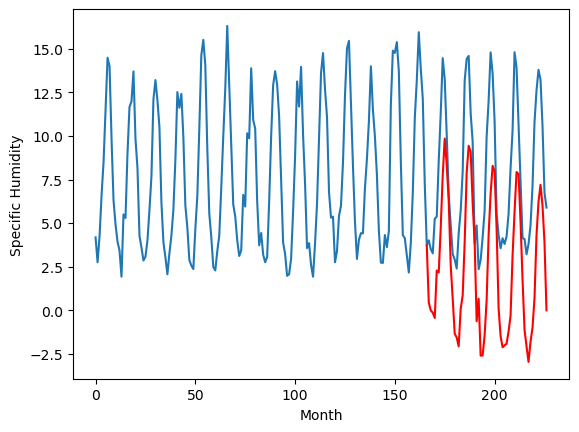

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.16		2.28		-3.88
5.79		1.82		-3.97
5.75		1.68		-4.07
5.71		1.38		-4.33
6.34		4.10		-2.24
6.69		3.99		-2.70
7.82		6.58		-1.24
8.88		9.59		0.71
10.40		11.68		1.28
9.19		10.17		0.98
8.05		8.09		0.04
6.40		4.41		-1.99
6.34		2.48		-3.86
5.53		0.49		-5.04
5.70		0.26		-5.44
5.76		-0.25		-6.01
6.07		1.91		-4.16
6.54		2.68		-3.86
7.94		5.75		-2.19
9.27		9.72		0.45
11.72		11.26		-0.46
10.29		10.92		0.63
8.59		7.99		-0.60
7.50		5.72		-1.78
6.79		1.19		-5.60
6.08		2.49		-3.59
5.60		-0.78		-6.38
5.39		-0.77		-6.16
6.07		0.40		-5.67
6.57		2.39		-4.18
7.38		6.15		-1.23
9.32		8.52		-0.80
12.31		10.12		-2.19
12.15		9.79		-2.36
9.20		6.53		-2.67
7.59		1.94		-5.65
5.93		0.33		-5.60
5.96		-0.30		-6.26
5.93		-0.19		-6.12
5.55		-0.10		-5.65
5.85		0.61		-5.24
6.48		1.52		-4.96
8.64		4.95		-3.69
8.87		7.50		-1.37
9.71		9.76		0.05
11.36		9.64		-1.72
8.74		6.91		-1.83
7.49		3.59		-3.90
6.16		0.69		-5.47
6.03		-0.24		

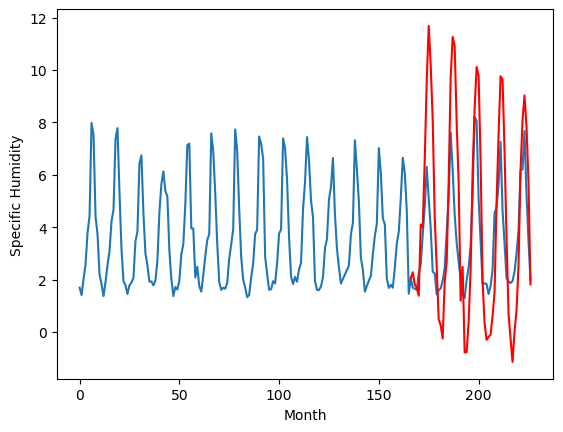

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.99		0.71		-4.28
5.98		0.25		-5.73
4.86		0.11		-4.75
4.44		-0.19		-4.63
6.18		2.53		-3.65
5.99		2.42		-3.57
5.29		5.01		-0.28
5.62		8.02		2.40
6.10		10.11		4.01
6.97		8.60		1.63
5.71		6.52		0.81
4.70		2.84		-1.86
4.68		0.91		-3.77
3.85		-1.08		-4.93
4.66		-1.31		-5.97
4.18		-1.82		-6.00
4.48		0.34		-4.14
4.17		1.11		-3.06
4.73		4.18		-0.55
6.15		8.15		2.00
11.51		9.69		-1.82
9.08		9.35		0.27
7.36		6.42		-0.94
6.26		4.15		-2.11
4.99		-0.38		-5.37
5.13		0.92		-4.21
4.14		-2.35		-6.49
3.71		-2.34		-6.05
4.33		-1.17		-5.50
4.33		0.82		-3.51
4.59		4.58		-0.01
6.35		6.95		0.60
9.78		8.55		-1.23
12.85		8.22		-4.63
8.94		4.96		-3.98
6.21		0.37		-5.84
4.44		-1.24		-5.68
5.19		-1.87		-7.06
5.58		-1.76		-7.34
4.33		-1.67		-6.00
5.37		-0.96		-6.33
4.52		-0.05		-4.57
6.06		3.38		-2.68
6.56		5.93		-0.63
7.53		8.19		0.66
10.11		8.07		-2.04
9.17		5.34		-3.83
6.11		2.02		-4.09
5.10		-0.88		-5.98
5.02		-1.81	

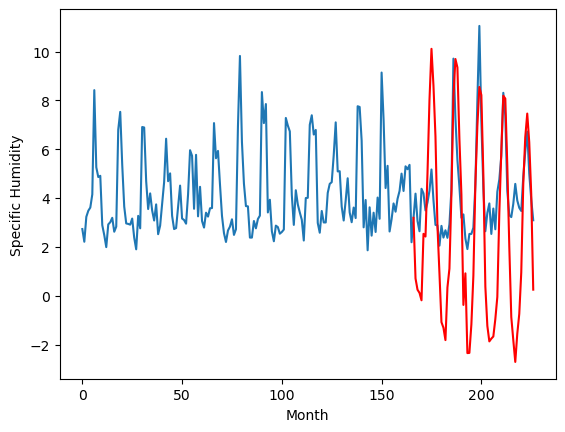

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.53		0.65		-3.88
5.76		0.19		-5.57
5.08		0.05		-5.03
4.19		-0.25		-4.44
4.67		2.47		-2.20
5.73		2.36		-3.37
6.59		4.95		-1.64
6.81		7.96		1.15
7.28		10.05		2.77
8.08		8.54		0.46
7.69		6.46		-1.23
5.49		2.78		-2.71
4.33		0.85		-3.48
3.99		-1.14		-5.13
4.66		-1.37		-6.03
4.31		-1.88		-6.19
3.96		0.28		-3.68
4.89		1.05		-3.84
5.33		4.12		-1.21
6.76		8.09		1.33
7.24		9.63		2.39
7.63		9.29		1.66
6.99		6.36		-0.63
5.96		4.09		-1.87
6.18		-0.44		-6.62
4.93		0.86		-4.07
4.60		-2.41		-7.01
3.76		-2.40		-6.16
4.76		-1.23		-5.99
4.86		0.76		-4.10
5.23		4.52		-0.71
6.72		6.89		0.17
7.55		8.49		0.94
8.01		8.16		0.15
7.41		4.90		-2.51
6.10		0.31		-5.79
3.85		-1.30		-5.15
4.64		-1.93		-6.57
4.47		-1.82		-6.29
3.61		-1.73		-5.34
4.41		-1.02		-5.43
4.79		-0.11		-4.90
6.38		3.32		-3.06
6.44		5.87		-0.57
7.28		8.13		0.85
8.55		8.01		-0.54
8.00		5.28		-2.72
6.57		1.96		-4.61
5.48		-0.94		-6.42
5.86		-1.87		-7.7

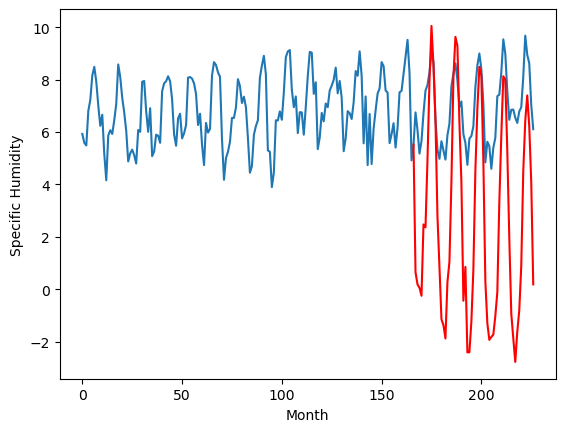

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.50		0.90		0.40
0.14		0.44		0.30
-0.14		0.30		0.44
-0.06		0.00		0.06
0.43		2.72		2.29
0.93		2.61		1.68
3.16		5.20		2.04
7.27		8.21		0.94
11.25		10.30		-0.95
10.18		8.79		-1.39
6.81		6.71		-0.10
4.28		3.03		-1.25
2.12		1.10		-1.02
0.16		-0.89		-1.05
-0.93		-1.12		-0.19
-0.78		-1.63		-0.85
0.00		0.53		0.53
1.38		1.30		-0.08
2.95		4.37		1.42
7.85		8.34		0.49
10.06		9.88		-0.18
10.44		9.54		-0.90
7.84		6.61		-1.23
5.30		4.34		-0.96
0.77		-0.19		-0.96
0.47		1.11		0.64
-1.01		-2.16		-1.15
-0.42		-2.15		-1.73
0.42		-0.98		-1.40
1.07		1.01		-0.06
4.46		4.77		0.31
6.80		7.14		0.34
9.96		8.74		-1.22
10.10		8.41		-1.69
6.43		5.15		-1.28
3.80		0.56		-3.24
1.95		-1.05		-3.00
-0.02		-1.68		-1.66
0.55		-1.57		-2.12
-0.16		-1.48		-1.32
0.05		-0.77		-0.82
2.29		0.14		-2.15
2.81		3.57		0.76
6.51		6.12		-0.39
11.36		8.38		-2.98
8.79		8.26		-0.53
7.82		5.53		-2.29
4.43		2.21		-2.22
0.63		-0.69		-1.32
0.96		-1.

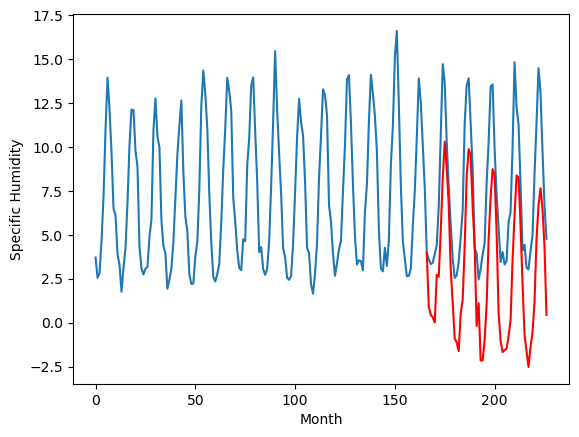

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.56		-1.59		0.97
-2.68		-2.05		0.63
-2.76		-2.19		0.57
-2.77		-2.49		0.28
-1.81		0.23		2.04
-1.38		0.12		1.50
1.15		2.71		1.56
4.72		5.72		1.00
8.07		7.81		-0.26
7.43		6.30		-1.13
4.14		4.22		0.08
1.37		0.54		-0.83
-0.96		-1.39		-0.43
-2.81		-3.38		-0.57
-3.50		-3.61		-0.11
-3.64		-4.12		-0.48
-2.36		-1.96		0.40
-0.95		-1.19		-0.24
0.64		1.88		1.24
5.51		5.85		0.34
7.20		7.39		0.19
7.52		7.05		-0.47
4.60		4.12		-0.48
2.70		1.85		-0.85
-2.22		-2.68		-0.46
-2.32		-1.38		0.94
-3.83		-4.65		-0.82
-3.13		-4.64		-1.51
-2.19		-3.47		-1.28
-1.55		-1.48		0.07
2.63		2.28		-0.35
4.03		4.65		0.62
7.01		6.25		-0.76
6.64		5.92		-0.72
3.62		2.66		-0.96
0.20		-1.93		-2.13
-1.02		-3.54		-2.52
-2.94		-4.17		-1.23
-2.16		-4.06		-1.90
-2.91		-3.97		-1.06
-2.78		-3.26		-0.48
-0.35		-2.35		-2.00
0.12		1.08		0.96
3.81		3.63		-0.18
7.79		5.89		-1.90
6.55		5.77		-0.78
4.86		3.04		-1.82
1.59		-0.28		-1.87
-2.09		-3

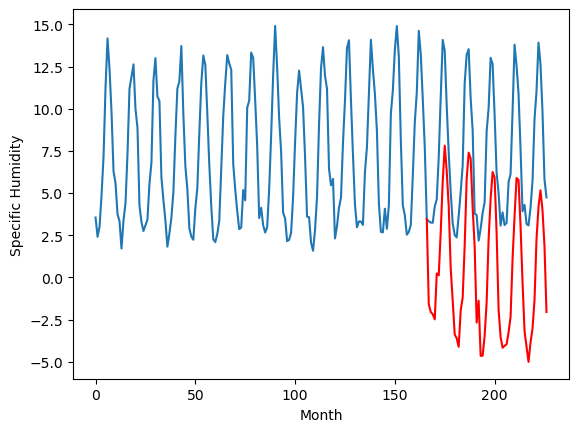

RangeIndex(start=1, stop=12, step=1)
[-3.310000000000001, -0.13999999999999968, 5.989999999999999, -0.8299999999999992, 3.6100000000000003, 0.2400000000000002, 6.16, 4.990000000000001, 4.529999999999999, 0.49999999999999956, -2.56]
[-1.5923591232299805, -0.5523591232299805, 2.6476408767700192, 0.4276408767700195, 1.8276408767700199, 0.4476408767700195, 2.277640876770019, 0.7076408767700197, 0.6476408767700197, 0.8976408767700192, -1.5923591232299805]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.31  -1.592359
1                 1   -0.14  -0.552359
2                 2    5.99   2.647641
3                 3   -0.83   0.427641
4                 4    3.61   1.827641
5                 5    0.24   0.447641
6                 6    6.16   2.277641
7                 7    4.99   0.707641
8                 8    4.53   0.647641
9                 9    0.50   0.897641
10               10   -2.56  -1.592359


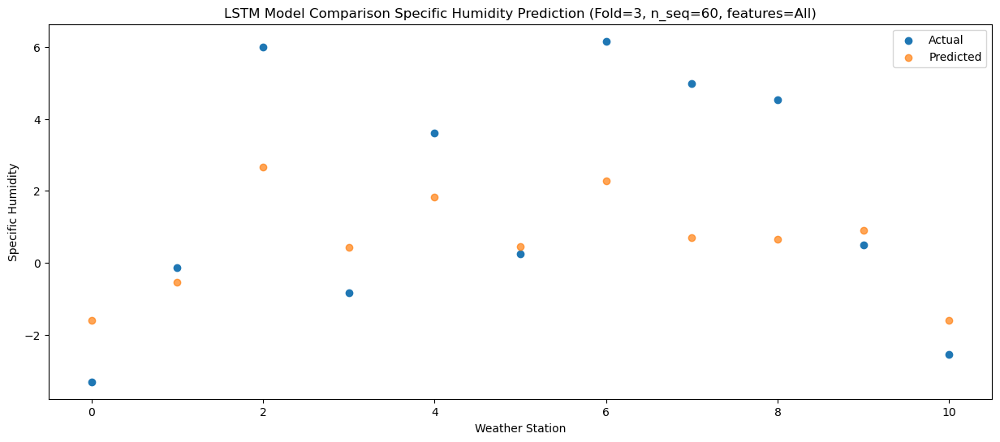

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.10  -2.054357
1                 1   -0.55  -1.014357
2                 2    6.53   2.185643
3                 3   -0.30  -0.034357
4                 4    2.11   1.365643
5                 5    0.53  -0.014357
6                 6    5.79   1.815643
7                 7    5.98   0.245643
8                 8    5.76   0.185643
9                 9    0.14   0.435643
10               10   -2.68  -2.054357


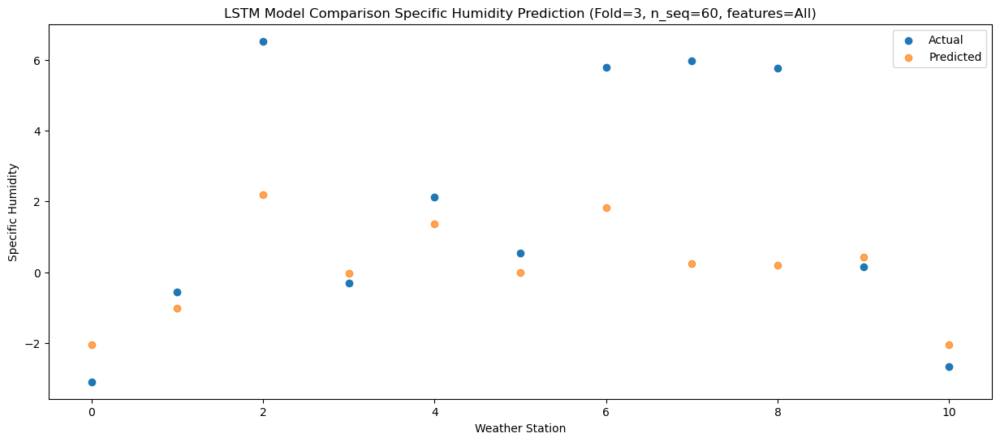

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.05  -2.185451
1                 1   -0.58  -1.145451
2                 2    6.15   2.054549
3                 3   -0.70  -0.165451
4                 4   -0.18   1.234549
5                 5    0.03  -0.145451
6                 6    5.75   1.684549
7                 7    4.86   0.114549
8                 8    5.08   0.054549
9                 9   -0.14   0.304549
10               10   -2.76  -2.185451


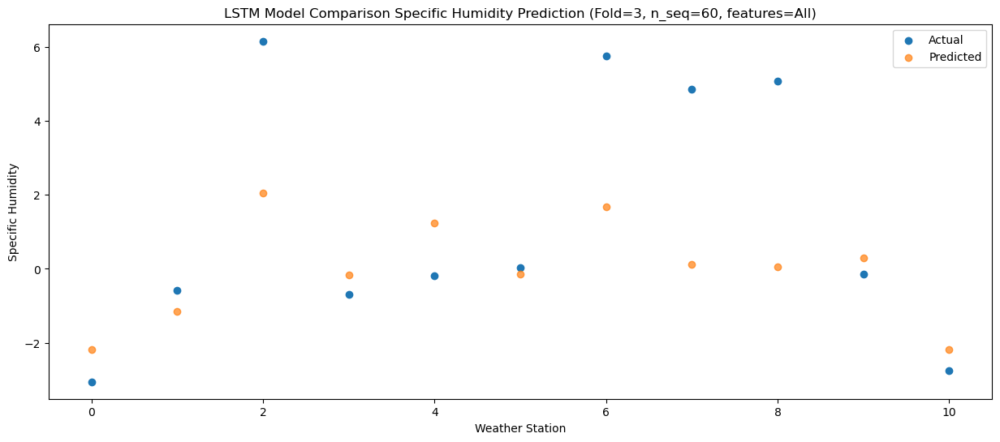

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -2.72  -2.487463
1                 1   -0.94  -1.447463
2                 2    5.46   1.752537
3                 3   -0.88  -0.467463
4                 4   -0.94   0.932537
5                 5   -0.22  -0.447463
6                 6    5.71   1.382537
7                 7    4.44  -0.187463
8                 8    4.19  -0.247463
9                 9   -0.06   0.002537
10               10   -2.77  -2.487463


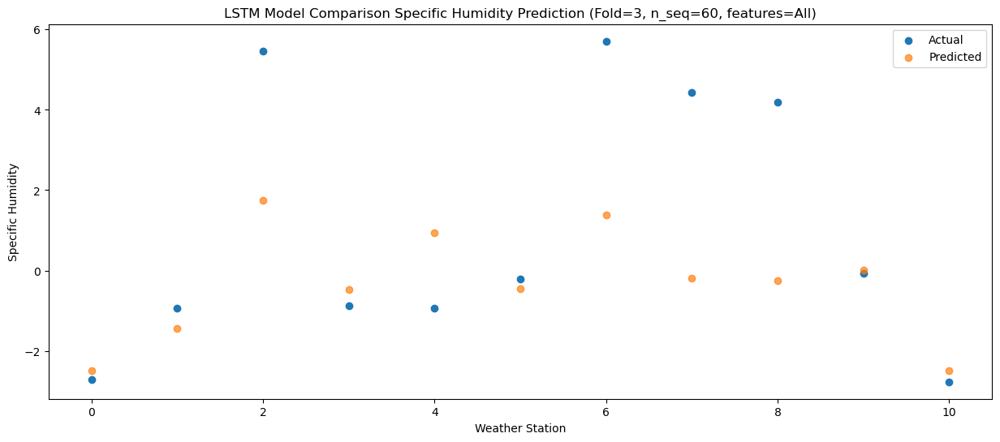

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -0.99    0.23471
1                 1    1.66    1.27471
2                 2    6.54    4.47471
3                 3    0.98    2.25471
4                 4    1.13    3.65471
5                 5    1.77    2.27471
6                 6    6.34    4.10471
7                 7    6.18    2.53471
8                 8    4.67    2.47471
9                 9    0.43    2.72471
10               10   -1.81    0.23471


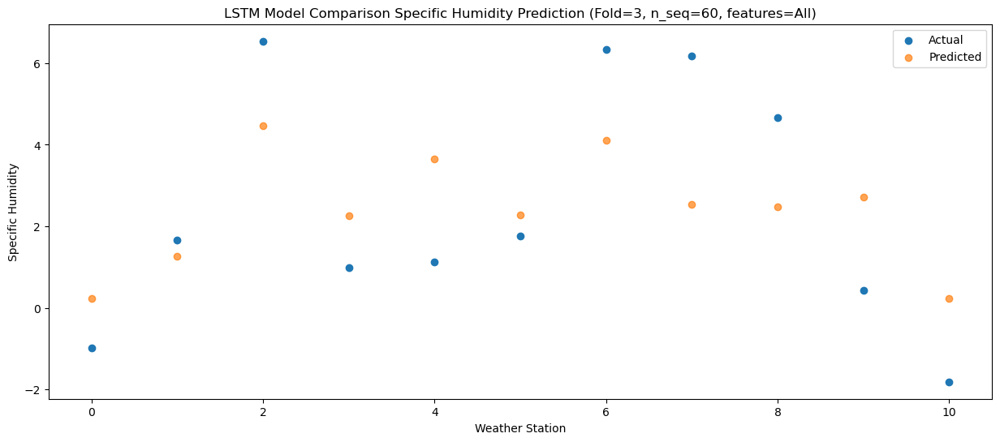

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.17    0.12276
1                 1    1.81    1.16276
2                 2    7.91    4.36276
3                 3    0.90    2.14276
4                 4    1.45    3.54276
5                 5    1.89    2.16276
6                 6    6.69    3.99276
7                 7    5.99    2.42276
8                 8    5.73    2.36276
9                 9    0.93    2.61276
10               10   -1.38    0.12276


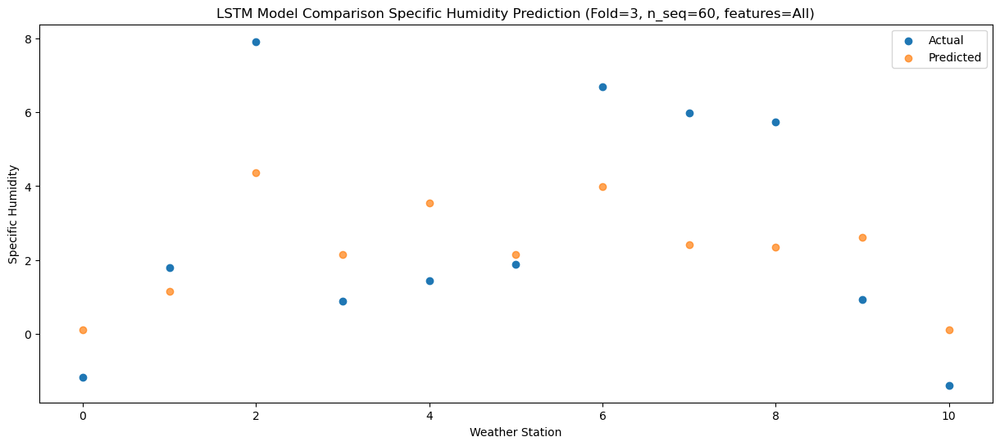

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.05   2.709249
1                 1    4.78   3.749249
2                 2    7.72   6.949249
3                 3    4.33   4.729249
4                 4    5.15   6.129249
5                 5    5.10   4.749249
6                 6    7.82   6.579249
7                 7    5.29   5.009249
8                 8    6.59   4.949249
9                 9    3.16   5.199249
10               10    1.15   2.709249


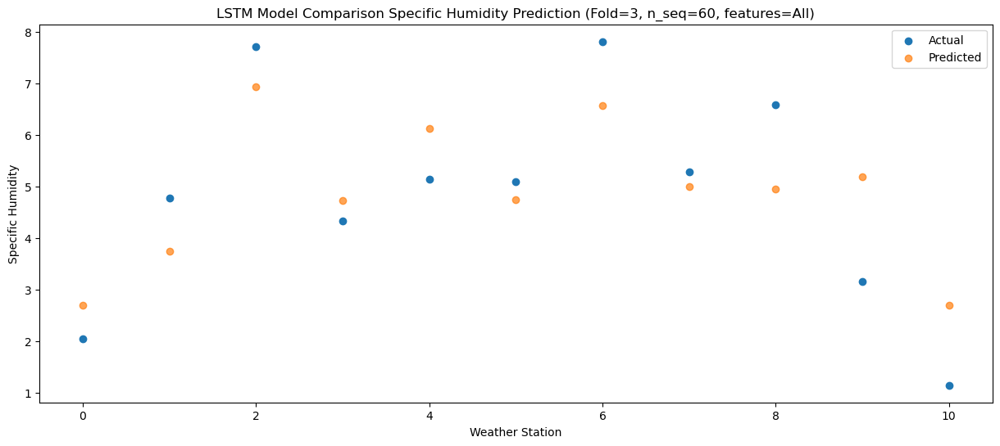

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    5.59   5.717797
1                 1    8.31   6.757797
2                 2    9.26   9.957797
3                 3    7.57   7.737797
4                 4    8.24   9.137797
5                 5    7.83   7.757797
6                 6    8.88   9.587797
7                 7    5.62   8.017797
8                 8    6.81   7.957797
9                 9    7.27   8.207797
10               10    4.72   5.717797


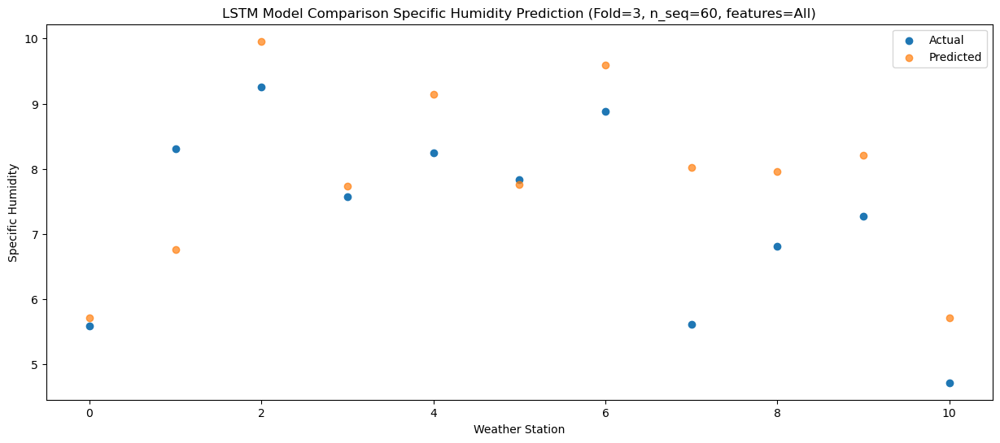

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    8.28   7.811769
1                 1   11.05   8.851769
2                 2    9.48  12.051769
3                 3   10.67   9.831769
4                 4   12.19  11.231769
5                 5   10.99   9.851769
6                 6   10.40  11.681769
7                 7    6.10  10.111769
8                 8    7.28  10.051769
9                 9   11.25  10.301769
10               10    8.07   7.811769


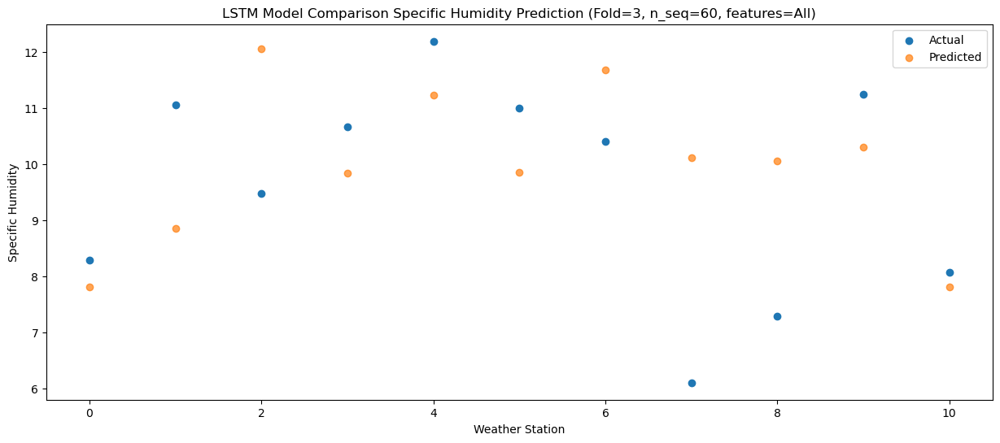

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    8.57   6.298845
1                 1    8.38   7.338845
2                 2   11.00  10.538845
3                 3    9.59   8.318845
4                 4    9.81   9.718845
5                 5    9.77   8.338845
6                 6    9.19  10.168845
7                 7    6.97   8.598845
8                 8    8.08   8.538845
9                 9   10.18   8.788845
10               10    7.43   6.298845


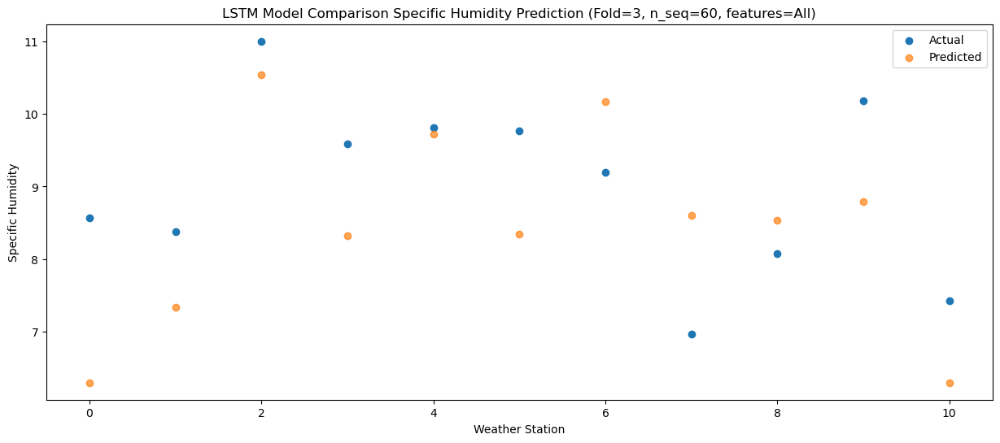

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.83   4.219841
1                 1    6.94   5.259841
2                 2   10.52   8.459841
3                 3    7.02   6.239841
4                 4    6.85   7.639841
5                 5    6.59   6.259841
6                 6    8.05   8.089841
7                 7    5.71   6.519841
8                 8    7.69   6.459841
9                 9    6.81   6.709841
10               10    4.14   4.219841


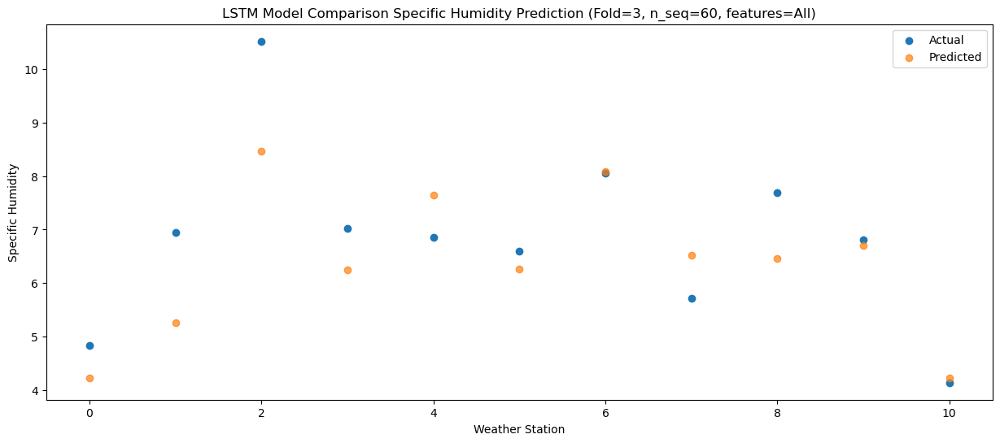

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.25    0.54069
1                 1    2.37    1.58069
2                 2    8.64    4.78069
3                 3    3.33    2.56069
4                 4    2.13    3.96069
5                 5    3.17    2.58069
6                 6    6.40    4.41069
7                 7    4.70    2.84069
8                 8    5.49    2.78069
9                 9    4.28    3.03069
10               10    1.37    0.54069


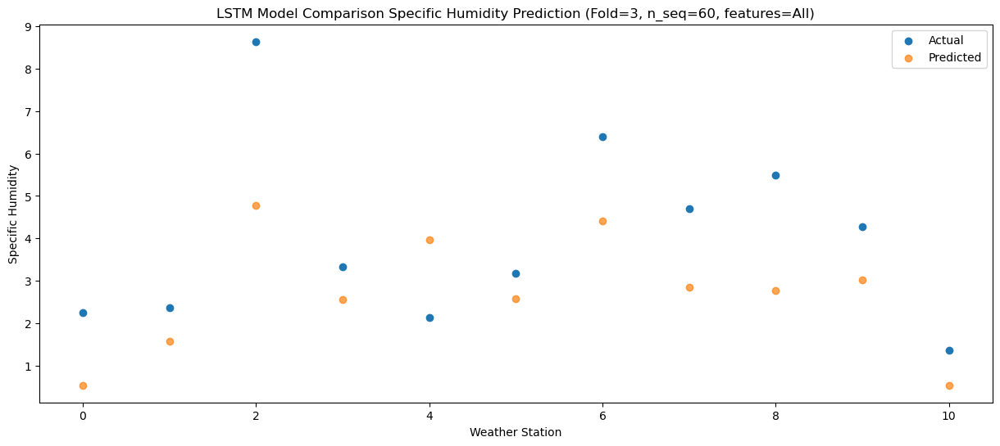

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.49  -1.389383
1                 1    0.87  -0.349383
2                 2    5.95   2.850617
3                 3    0.44   0.630617
4                 4    1.03   2.030617
5                 5    1.40   0.650617
6                 6    6.34   2.480617
7                 7    4.68   0.910617
8                 8    4.33   0.850617
9                 9    2.12   1.100617
10               10   -0.96  -1.389383


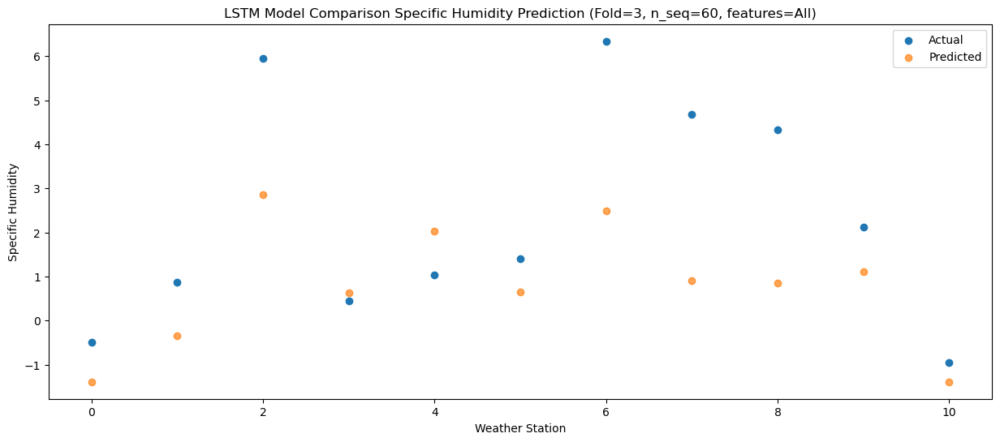

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -3.382947
1                 1   -1.17  -2.342947
2                 2    5.35   0.857053
3                 3   -1.17  -1.362947
4                 4   -0.90   0.037053
5                 5   -0.26  -1.342947
6                 6    5.53   0.487053
7                 7    3.85  -1.082947
8                 8    3.99  -1.142947
9                 9    0.16  -0.892947
10               10   -2.81  -3.382947


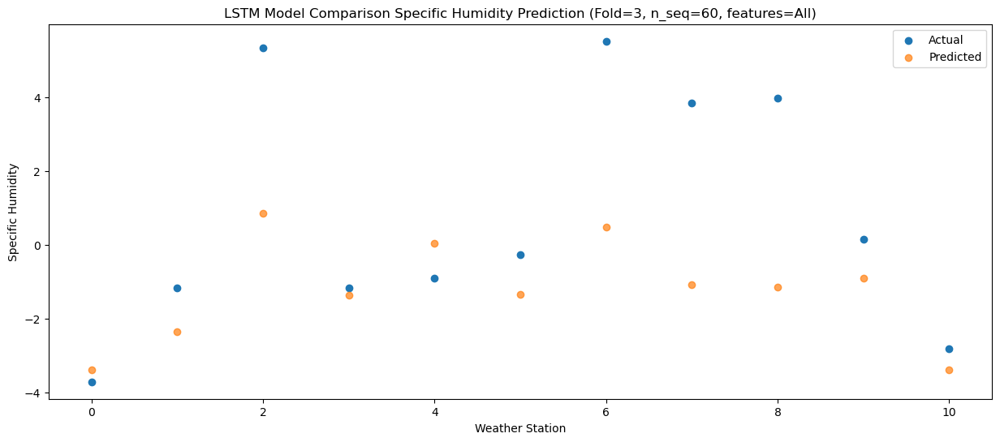

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.84  -3.612587
1                 1   -1.26  -2.572587
2                 2    5.79   0.627413
3                 3   -1.44  -1.592587
4                 4   -1.10  -0.192587
5                 5   -0.57  -1.572587
6                 6    5.70   0.257413
7                 7    4.66  -1.312587
8                 8    4.66  -1.372587
9                 9   -0.93  -1.122587
10               10   -3.50  -3.612587


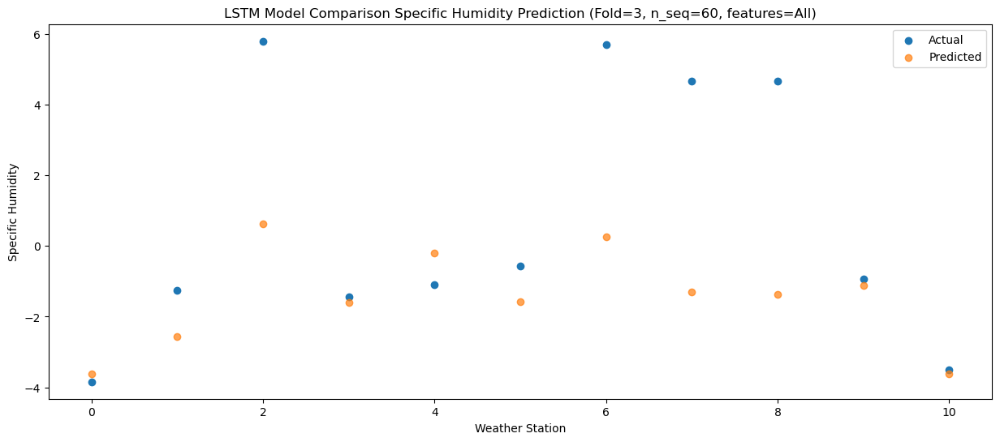

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.75  -4.118617
1                 1   -1.82  -3.078617
2                 2    5.73   0.121383
3                 3   -1.51  -2.098617
4                 4   -1.93  -0.698617
5                 5   -1.09  -2.078617
6                 6    5.76  -0.248617
7                 7    4.18  -1.818617
8                 8    4.31  -1.878617
9                 9   -0.78  -1.628617
10               10   -3.64  -4.118617


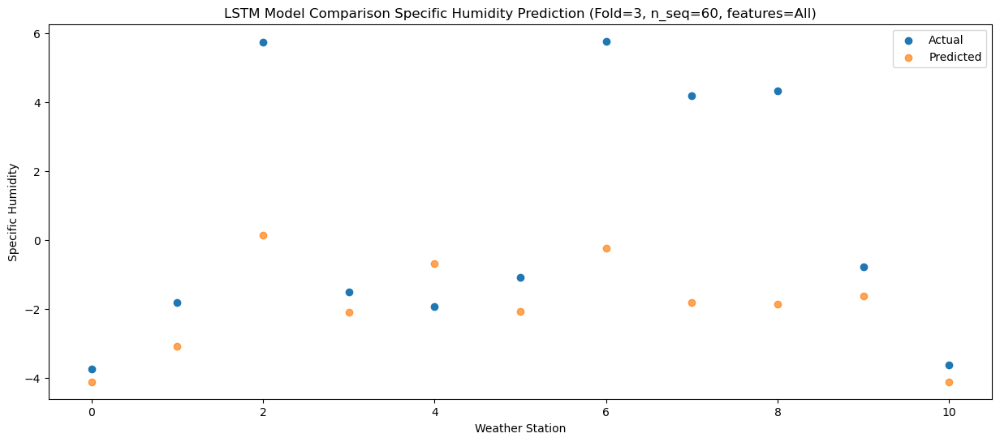

Predictions for (t+16):
    Weather_Station        Actual  Predicted
0                 0 -2.100000e+00  -1.960939
1                 1  6.900000e-01  -0.920939
2                 2  5.810000e+00   2.279061
3                 3 -2.100000e-01   0.059061
4                 4  5.500000e-01   1.459061
5                 5  9.400000e-01   0.079061
6                 6  6.070000e+00   1.909061
7                 7  4.480000e+00   0.339061
8                 8  3.960000e+00   0.279061
9                 9  2.220446e-16   0.529061
10               10 -2.360000e+00  -1.960939


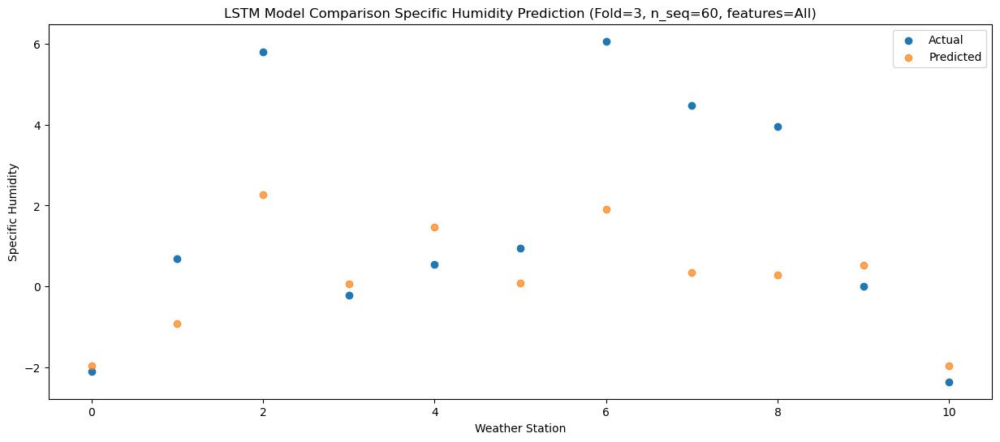

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -1.58  -1.190321
1                 1    1.86  -0.150321
2                 2    6.43   3.049679
3                 3    0.98   0.829679
4                 4    1.61   2.229679
5                 5    2.24   0.849679
6                 6    6.54   2.679679
7                 7    4.17   1.109679
8                 8    4.89   1.049679
9                 9    1.38   1.299679
10               10   -0.95  -1.190321


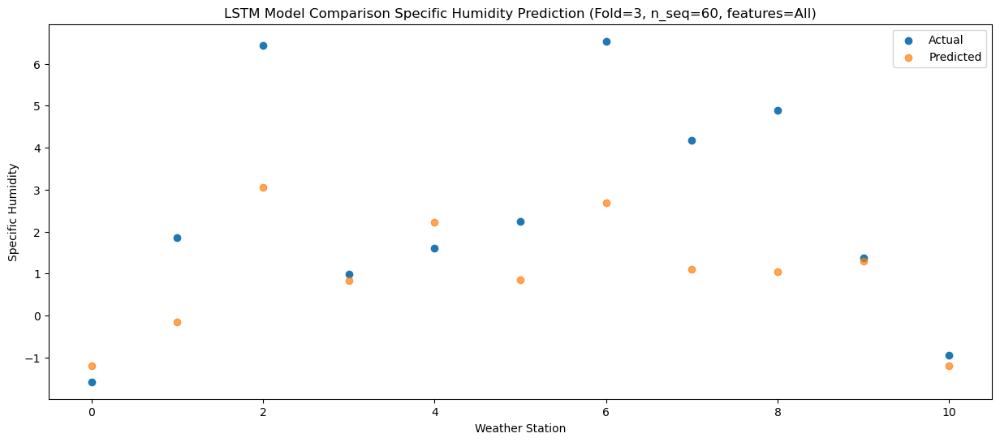

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    1.20   1.878806
1                 1    5.38   2.918806
2                 2    6.83   6.118806
3                 3    3.51   3.898806
4                 4    4.03   5.298806
5                 5    4.48   3.918806
6                 6    7.94   5.748806
7                 7    4.73   4.178806
8                 8    5.33   4.118806
9                 9    2.95   4.368806
10               10    0.64   1.878806


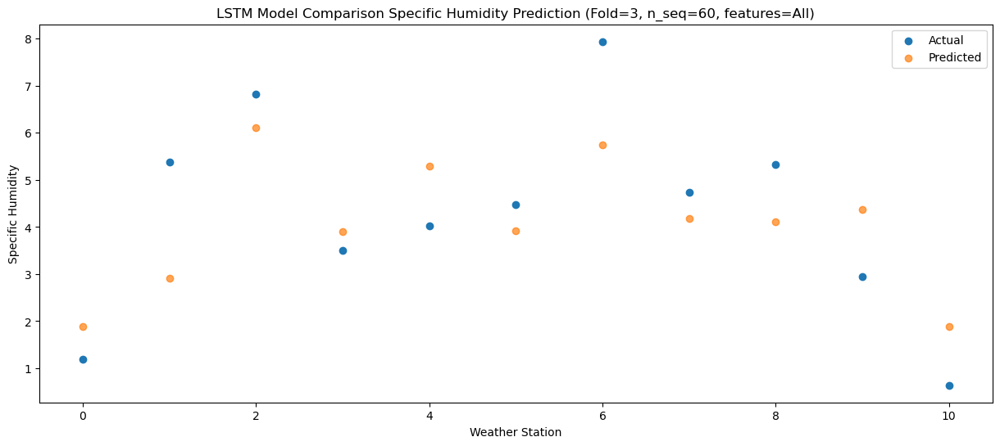

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.92   5.851004
1                 1    9.91   6.891004
2                 2    9.28  10.091004
3                 3    8.93   7.871004
4                 4    8.49   9.271004
5                 5    9.70   7.891004
6                 6    9.27   9.721004
7                 7    6.15   8.151004
8                 8    6.76   8.091004
9                 9    7.85   8.341004
10               10    5.51   5.851004


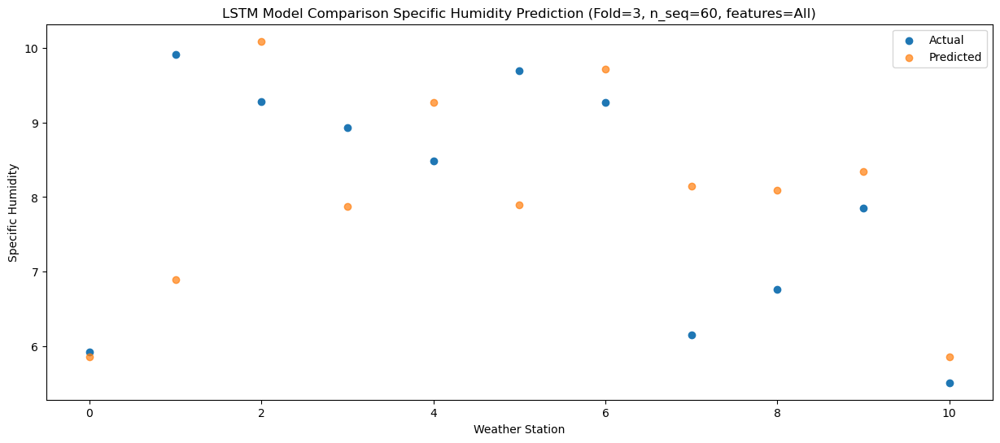

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    7.16   7.394237
1                 1   10.79   8.434237
2                 2    9.98  11.634237
3                 3    9.56   9.414237
4                 4   10.44  10.814237
5                 5   10.95   9.434237
6                 6   11.72  11.264237
7                 7   11.51   9.694237
8                 8    7.24   9.634237
9                 9   10.06   9.884237
10               10    7.20   7.394237


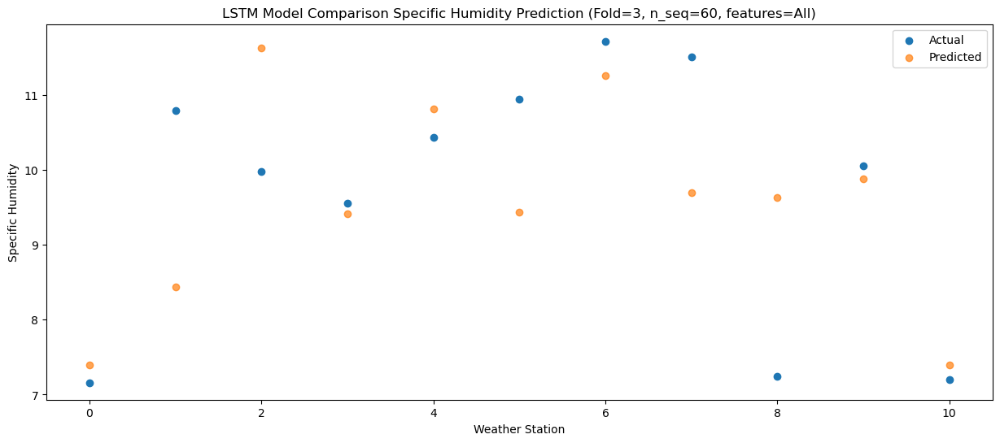

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.43   7.047627
1                 1   10.96   8.087627
2                 2    9.51  11.287627
3                 3   10.44   9.067627
4                 4   10.53  10.467627
5                 5   11.12   9.087627
6                 6   10.29  10.917627
7                 7    9.08   9.347627
8                 8    7.63   9.287627
9                 9   10.44   9.537627
10               10    7.52   7.047627


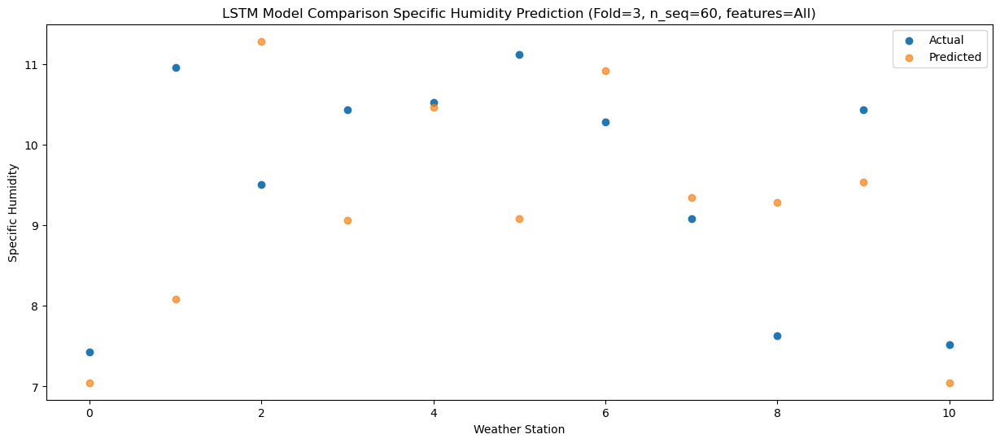

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.81   4.120117
1                 1    6.99   5.160117
2                 2    8.22   8.360117
3                 3    6.97   6.140117
4                 4    6.76   7.540117
5                 5    7.82   6.160117
6                 6    8.59   7.990117
7                 7    7.36   6.420117
8                 8    6.99   6.360117
9                 9    7.84   6.610117
10               10    4.60   4.120117


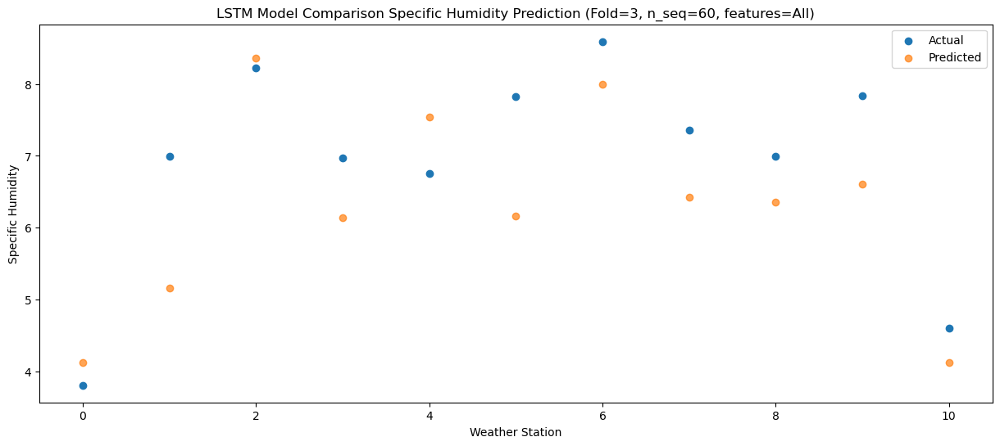

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.77   1.845867
1                 1    4.80   2.885867
2                 2    7.08   6.085867
3                 3    4.91   3.865867
4                 4    4.81   5.265867
5                 5    6.20   3.885867
6                 6    7.50   5.715867
7                 7    6.26   4.145867
8                 8    5.96   4.085867
9                 9    5.30   4.335867
10               10    2.70   1.845867


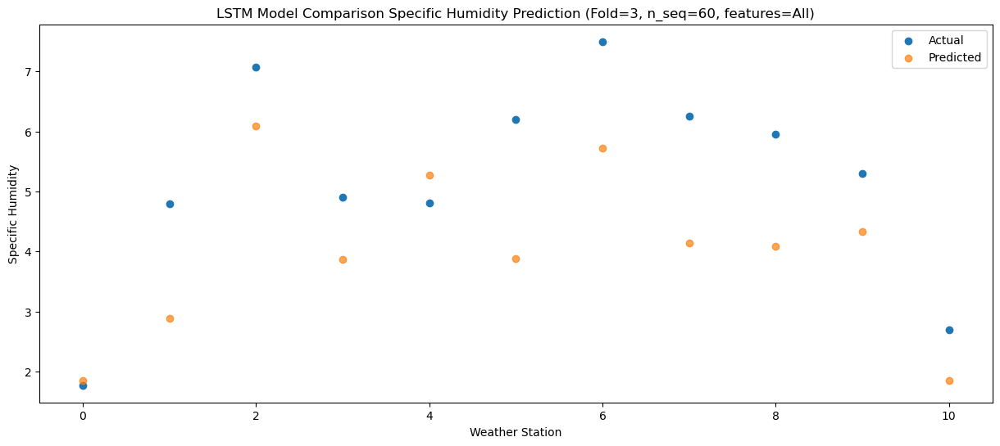

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -3.73  -2.677852
1                 1    0.37  -1.637852
2                 2    7.66   1.562148
3                 3   -0.78  -0.657852
4                 4   -0.31   0.742148
5                 5    0.33  -0.637852
6                 6    6.79   1.192148
7                 7    4.99  -0.377852
8                 8    6.18  -0.437852
9                 9    0.77  -0.187852
10               10   -2.22  -2.677852


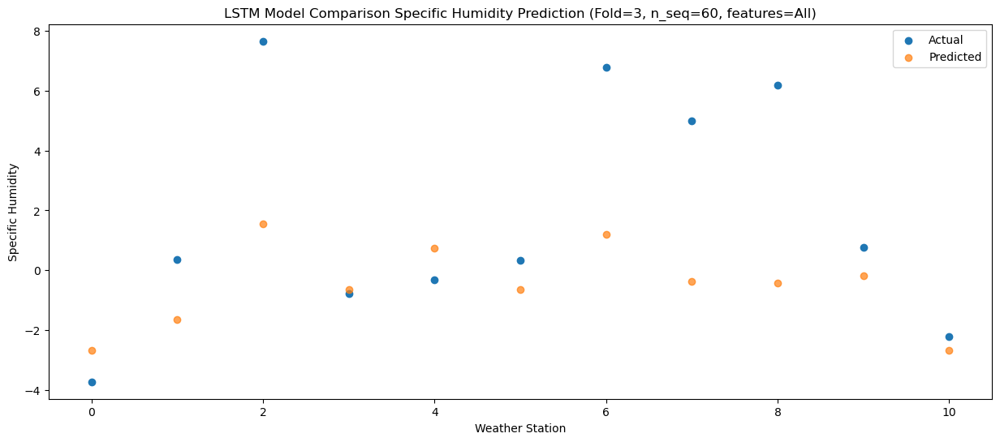

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -1.384565
1                 1    1.34  -0.344565
2                 2    6.16   2.855435
3                 3    0.36   0.635435
4                 4    0.39   2.035435
5                 5    1.38   0.655435
6                 6    6.08   2.485435
7                 7    5.13   0.915435
8                 8    4.93   0.855435
9                 9    0.47   1.105435
10               10   -2.32  -1.384565


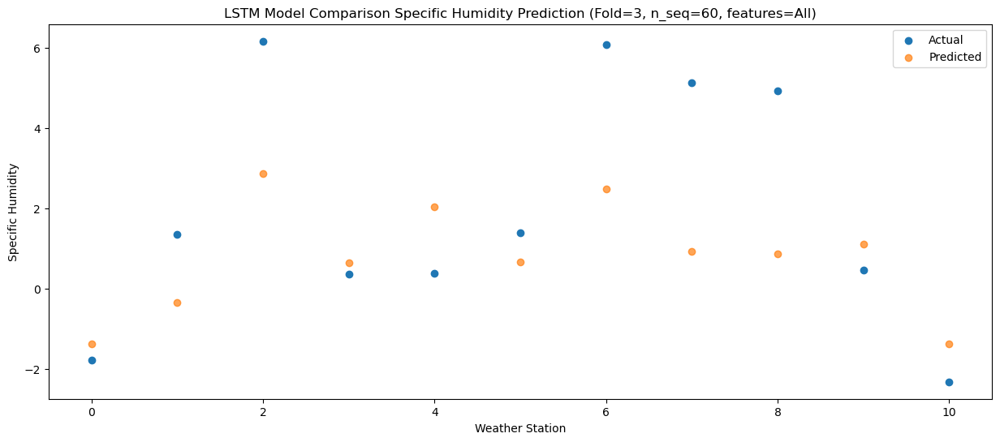

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.57  -4.651647
1                 1   -1.85  -3.611647
2                 2    5.88  -0.411647
3                 3   -1.96  -2.631647
4                 4   -2.07  -1.231647
5                 5   -1.13  -2.611647
6                 6    5.60  -0.781647
7                 7    4.14  -2.351647
8                 8    4.60  -2.411647
9                 9   -1.01  -2.161647
10               10   -3.83  -4.651647


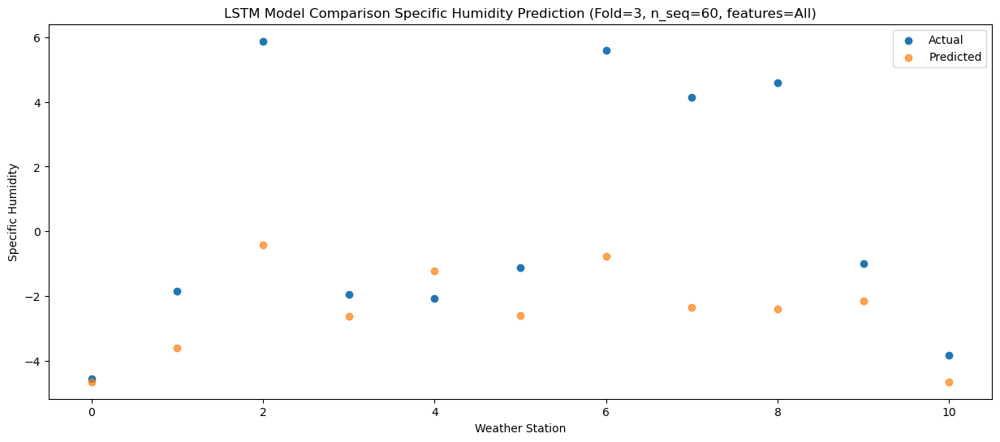

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.21  -4.642595
1                 1   -1.48  -3.602595
2                 2    5.10  -0.402595
3                 3   -1.44  -2.622595
4                 4   -1.45  -1.222595
5                 5   -0.60  -2.602595
6                 6    5.39  -0.772595
7                 7    3.71  -2.342595
8                 8    3.76  -2.402595
9                 9   -0.42  -2.152595
10               10   -3.13  -4.642595


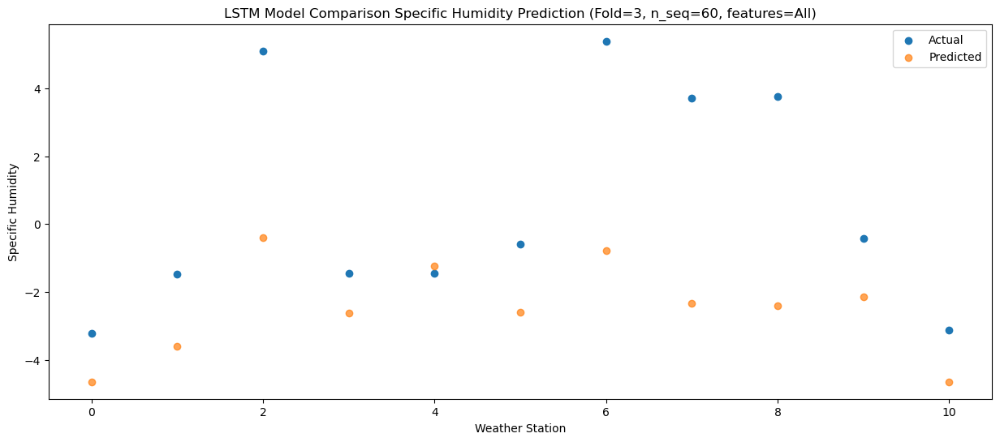

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -3.473803
1                 1   -0.01  -2.433803
2                 2    6.44   0.766197
3                 3   -0.46  -1.453803
4                 4    0.12  -0.053803
5                 5    0.71  -1.433803
6                 6    6.07   0.396197
7                 7    4.33  -1.173803
8                 8    4.76  -1.233803
9                 9    0.42  -0.983803
10               10   -2.19  -3.473803


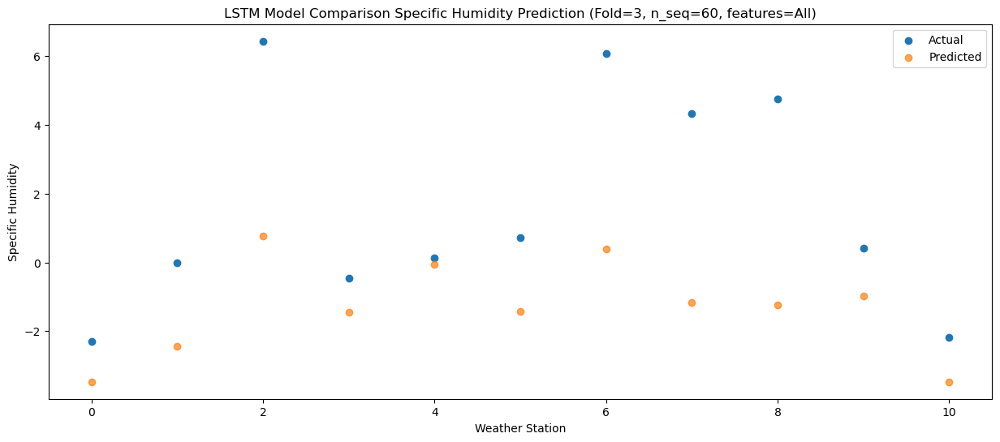

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.28  -1.478381
1                 1    2.29  -0.438381
2                 2    6.11   2.761619
3                 3    0.81   0.541619
4                 4    1.68   1.941619
5                 5    2.24   0.561619
6                 6    6.57   2.391619
7                 7    4.33   0.821619
8                 8    4.86   0.761619
9                 9    1.07   1.011619
10               10   -1.55  -1.478381


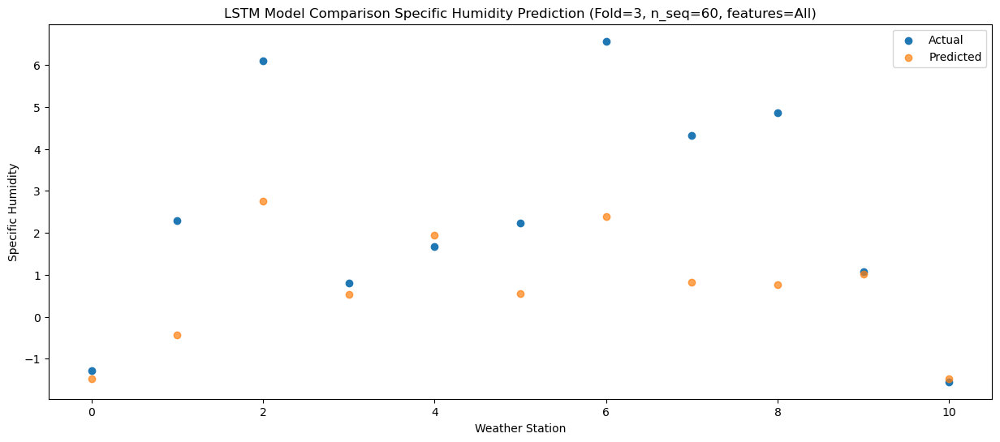

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    3.03   2.283688
1                 1    6.74   3.323688
2                 2    6.29   6.523688
3                 3    5.23   4.303688
4                 4    5.77   5.703688
5                 5    6.47   4.323688
6                 6    7.38   6.153688
7                 7    4.59   4.583688
8                 8    5.23   4.523688
9                 9    4.46   4.773688
10               10    2.63   2.283688


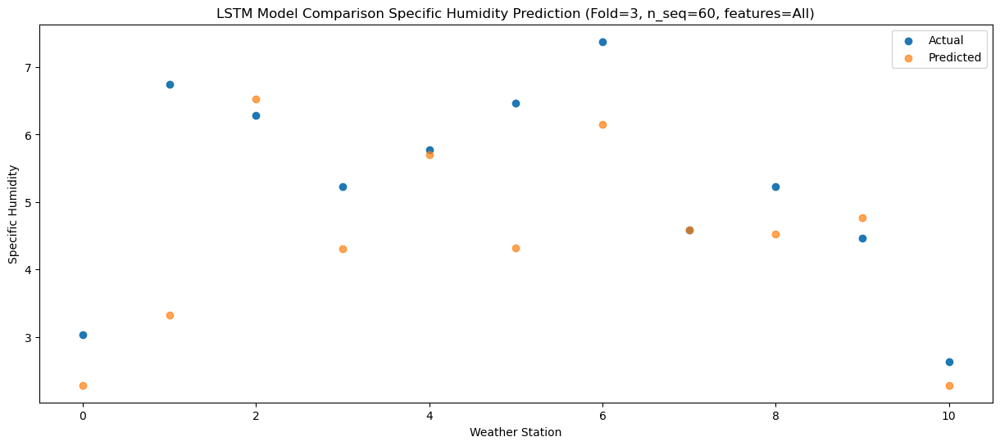

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.33    4.64908
1                 1    9.36    5.68908
2                 2    7.46    8.88908
3                 3    7.49    6.66908
4                 4    7.87    8.06908
5                 5    8.54    6.68908
6                 6    9.32    8.51908
7                 7    6.35    6.94908
8                 8    6.72    6.88908
9                 9    6.80    7.13908
10               10    4.03    4.64908


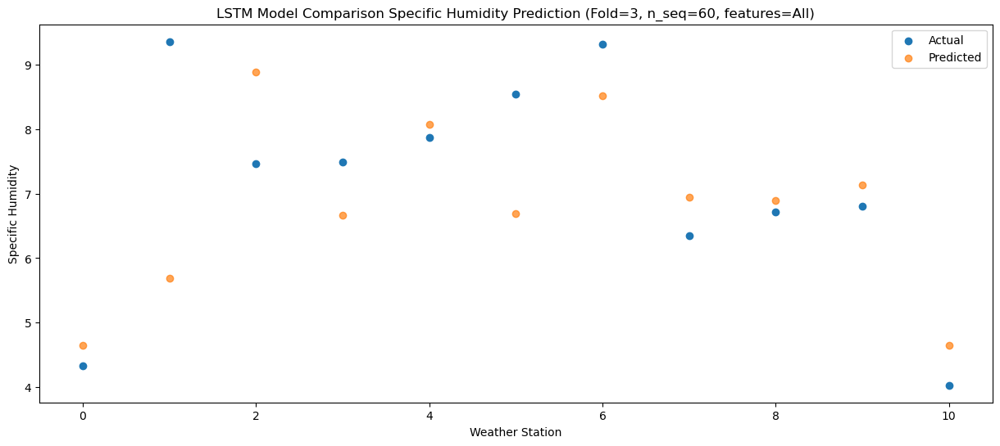

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    8.40   6.248006
1                 1    9.57   7.288006
2                 2    8.63  10.488006
3                 3   10.53   8.268006
4                 4   10.46   9.668006
5                 5   11.32   8.288006
6                 6   12.31  10.118006
7                 7    9.78   8.548006
8                 8    7.55   8.488006
9                 9    9.96   8.738006
10               10    7.01   6.248006


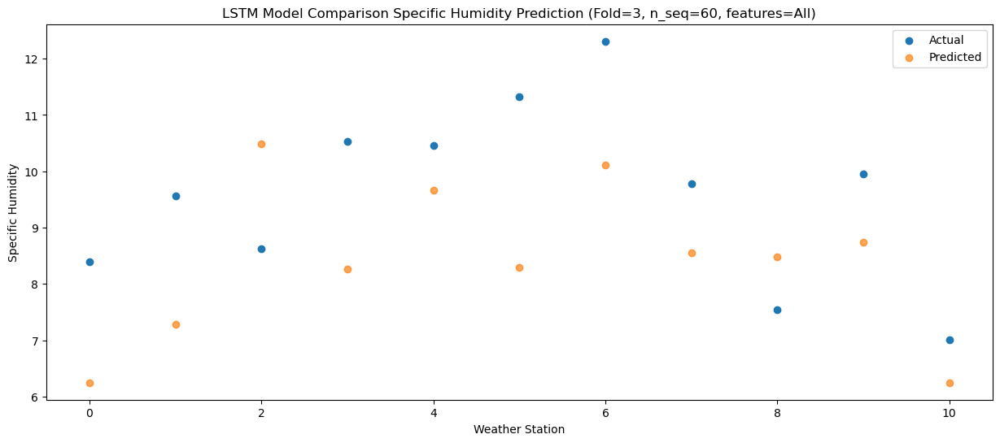

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.59   5.917051
1                 1   10.18   6.957051
2                 2    9.42  10.157051
3                 3    9.40   7.937051
4                 4    9.96   9.337051
5                 5   10.12   7.957051
6                 6   12.15   9.787051
7                 7   12.85   8.217051
8                 8    8.01   8.157051
9                 9   10.10   8.407051
10               10    6.64   5.917051


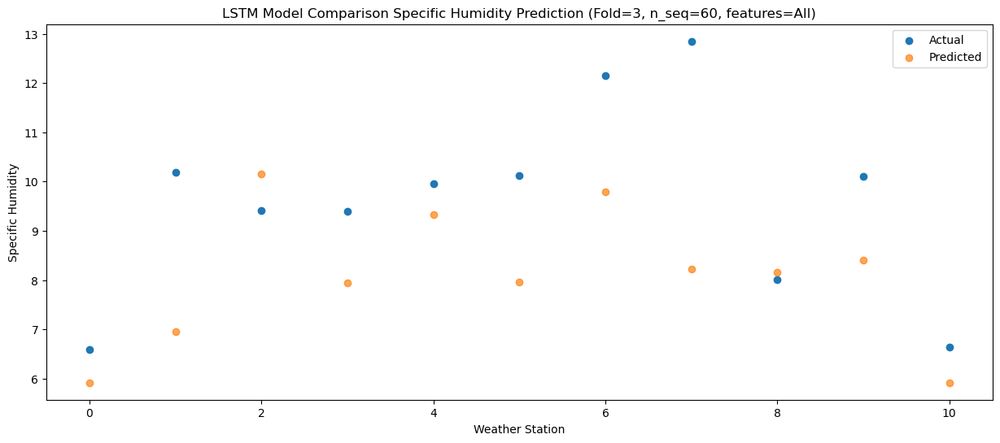

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.17   2.656865
1                 1    6.33   3.696865
2                 2    9.13   6.896865
3                 3    6.15   4.676865
4                 4    6.86   6.076865
5                 5    7.35   4.696865
6                 6    9.20   6.526865
7                 7    8.94   4.956865
8                 8    7.41   4.896865
9                 9    6.43   5.146865
10               10    3.62   2.656865


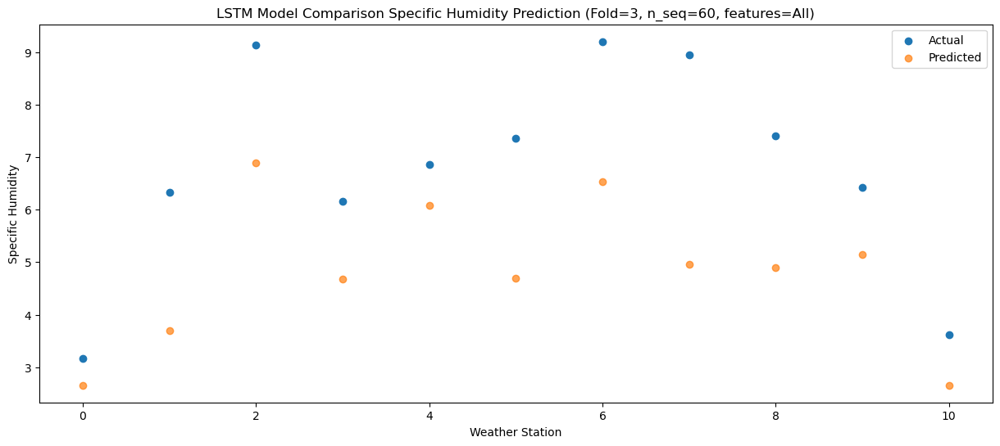

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.06  -1.927671
1                 1    1.87  -0.887671
2                 2    7.96   2.312329
3                 3    1.00   0.092329
4                 4    1.86   1.492329
5                 5    2.05   0.112329
6                 6    7.59   1.942329
7                 7    6.21   0.372329
8                 8    6.10   0.312329
9                 9    3.80   0.562329
10               10    0.20  -1.927671


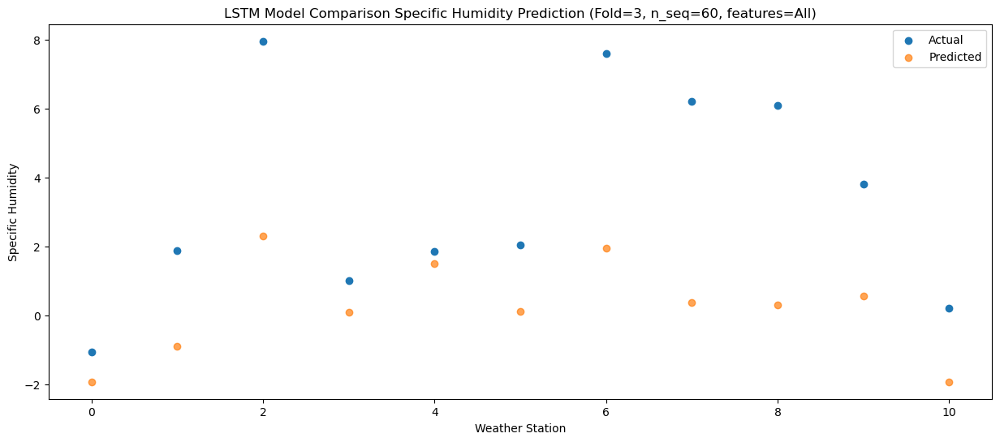

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.51  -3.536734
1                 1    0.84  -2.496734
2                 2    5.24   0.703266
3                 3    0.19  -1.516734
4                 4    0.47  -0.116734
5                 5    0.83  -1.496734
6                 6    5.93   0.333266
7                 7    4.44  -1.236734
8                 8    3.85  -1.296734
9                 9    1.95  -1.046734
10               10   -1.02  -3.536734


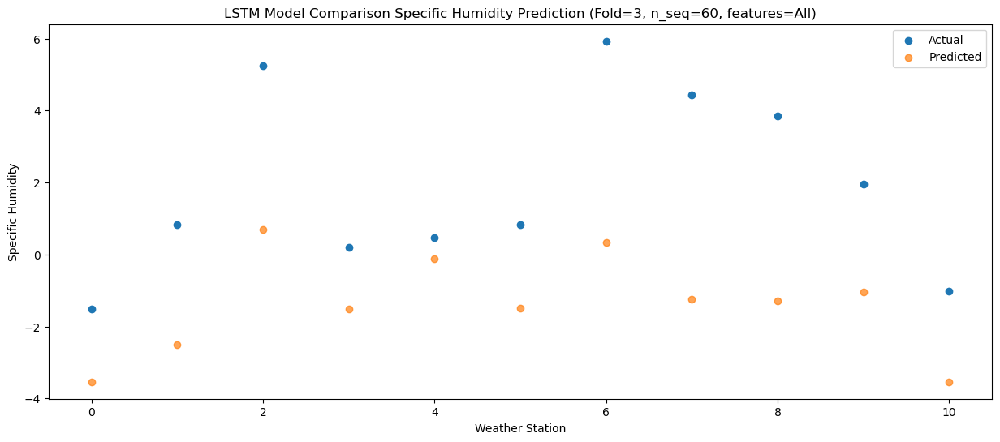

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -4.171829
1                 1   -0.35  -3.131829
2                 2    6.08   0.068171
3                 3   -0.84  -2.151829
4                 4   -0.65  -0.751829
5                 5    0.07  -2.131829
6                 6    5.96  -0.301829
7                 7    5.19  -1.871829
8                 8    4.64  -1.931829
9                 9   -0.02  -1.681829
10               10   -2.94  -4.171829


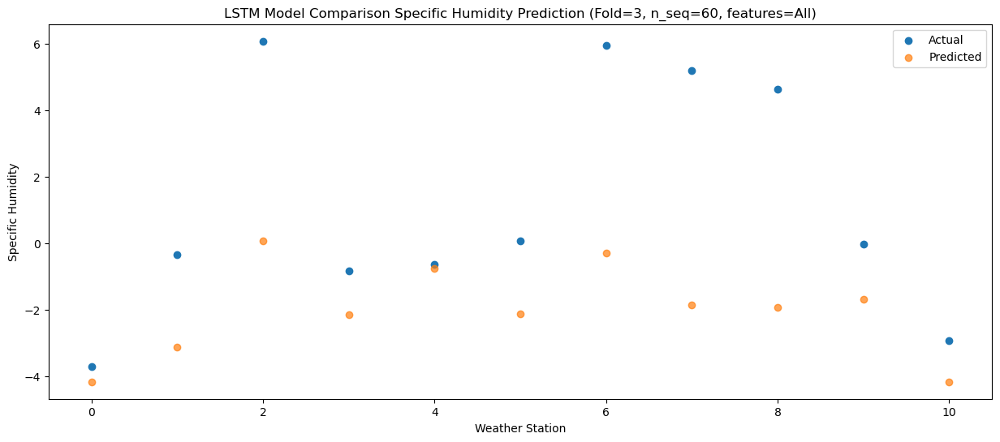

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.80   -4.05932
1                 1   -0.43   -3.01932
2                 2    6.23    0.18068
3                 3   -0.30   -2.03932
4                 4   -0.27   -0.63932
5                 5    0.65   -2.01932
6                 6    5.93   -0.18932
7                 7    5.58   -1.75932
8                 8    4.47   -1.81932
9                 9    0.55   -1.56932
10               10   -2.16   -4.05932


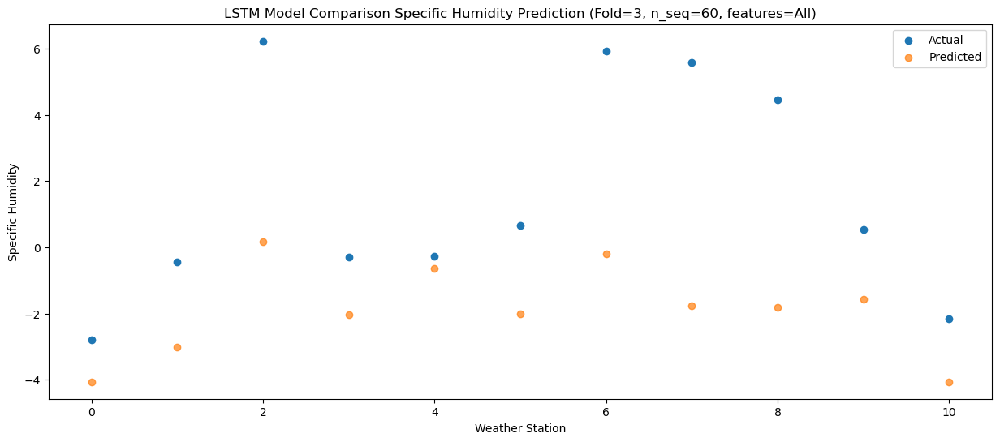

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.07  -3.969957
1                 1   -0.27  -2.929957
2                 2    5.10   0.270043
3                 3   -0.48  -1.949957
4                 4    0.61  -0.549957
5                 5    0.32  -1.929957
6                 6    5.55  -0.099957
7                 7    4.33  -1.669957
8                 8    3.61  -1.729957
9                 9   -0.16  -1.479957
10               10   -2.91  -3.969957


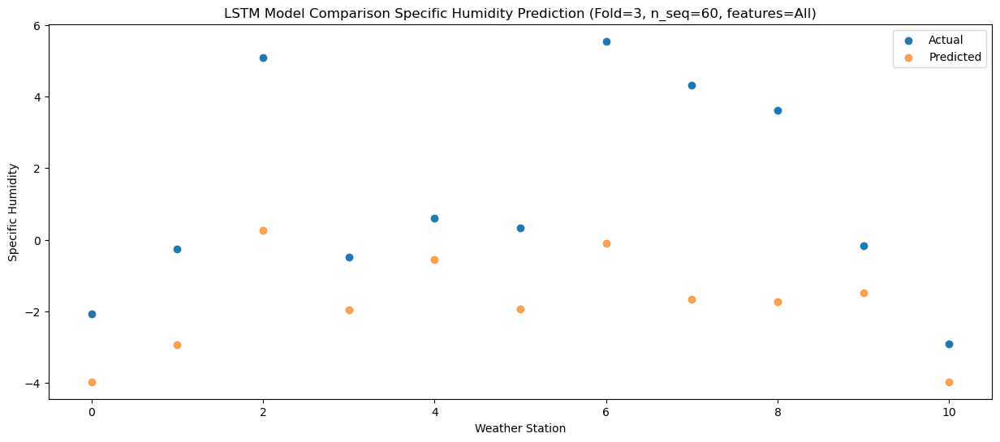

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.46  -3.260567
1                 1    0.67  -2.220567
2                 2    6.62   0.979433
3                 3   -0.61  -1.240567
4                 4    0.28   0.159433
5                 5    0.75  -1.220567
6                 6    5.85   0.609433
7                 7    5.37  -0.960567
8                 8    4.41  -1.020567
9                 9    0.05  -0.770567
10               10   -2.78  -3.260567


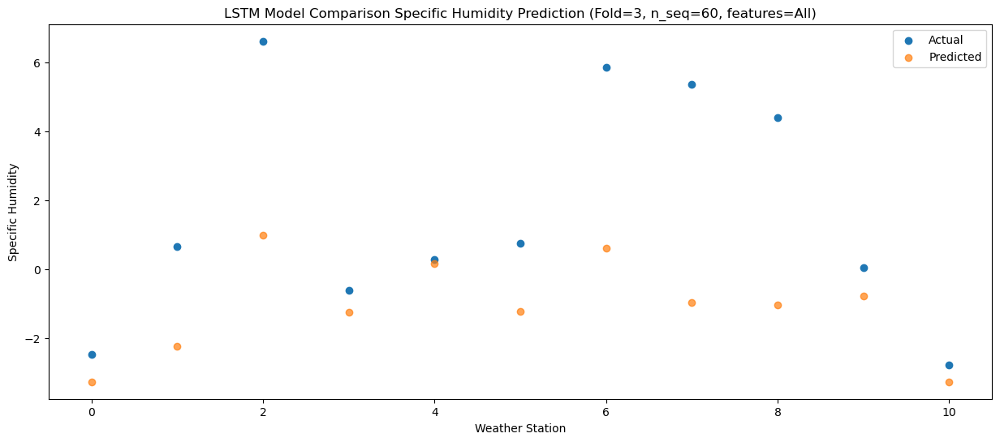

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.47   -2.35159
1                 1    1.54   -1.31159
2                 2    6.82    1.88841
3                 3    0.93   -0.33159
4                 4    1.51    1.06841
5                 5    2.06   -0.31159
6                 6    6.48    1.51841
7                 7    4.52   -0.05159
8                 8    4.79   -0.11159
9                 9    2.29    0.13841
10               10   -0.35   -2.35159


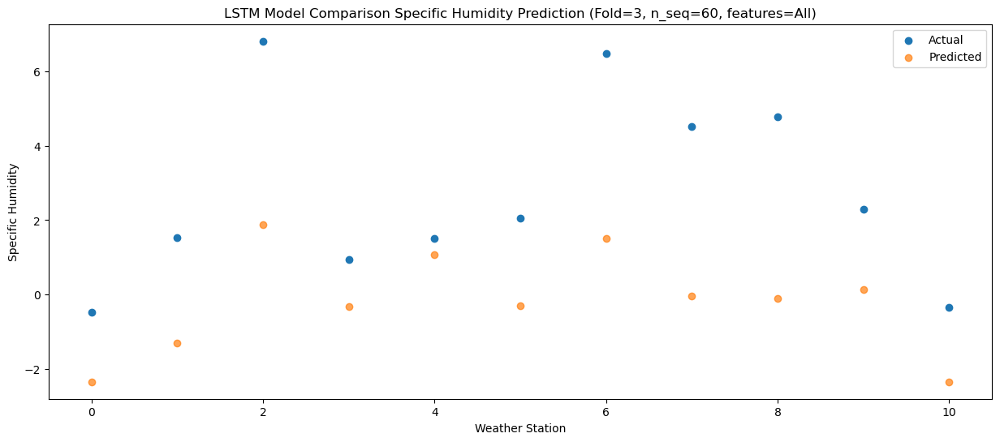

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.98   1.080556
1                 1    5.95   2.120556
2                 2    7.76   5.320556
3                 3    3.84   3.100556
4                 4    4.69   4.500556
5                 5    4.66   3.120556
6                 6    8.64   4.950556
7                 7    6.06   3.380556
8                 8    6.38   3.320556
9                 9    2.81   3.570556
10               10    0.12   1.080556


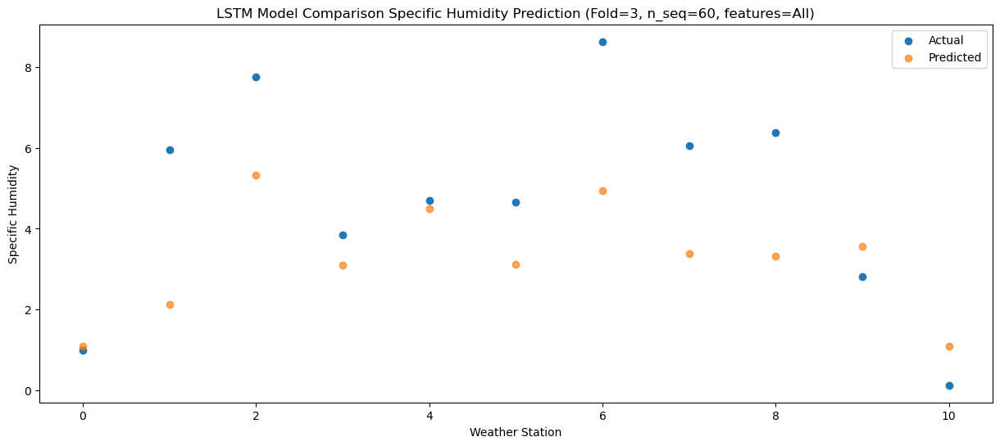

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    4.25   3.629433
1                 1    8.59   4.669433
2                 2    8.53   7.869433
3                 3    5.86   5.649433
4                 4    6.82   7.049433
5                 5    6.82   5.669433
6                 6    8.87   7.499433
7                 7    6.56   5.929433
8                 8    6.44   5.869433
9                 9    6.51   6.119433
10               10    3.81   3.629433


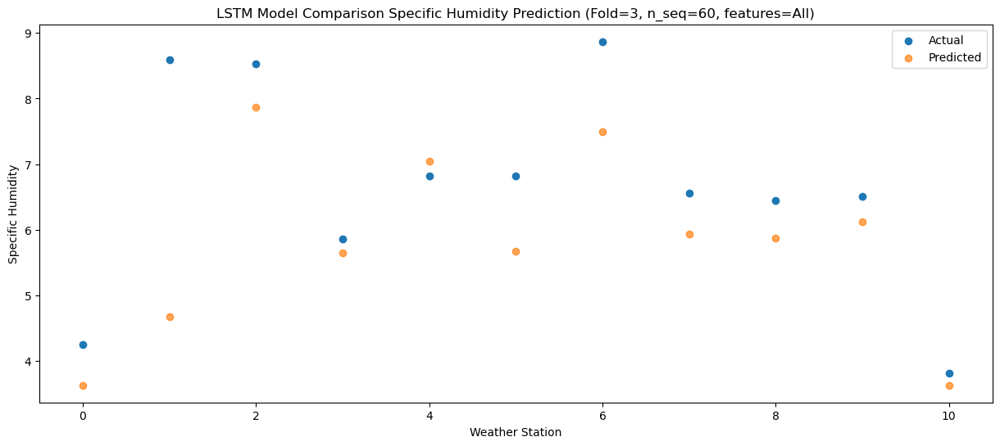

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    8.20   5.890696
1                 1   10.86   6.930696
2                 2    9.63  10.130696
3                 3    9.51   7.910696
4                 4   10.59   9.310696
5                 5   11.33   7.930696
6                 6    9.71   9.760696
7                 7    7.53   8.190696
8                 8    7.28   8.130696
9                 9   11.36   8.380696
10               10    7.79   5.890696


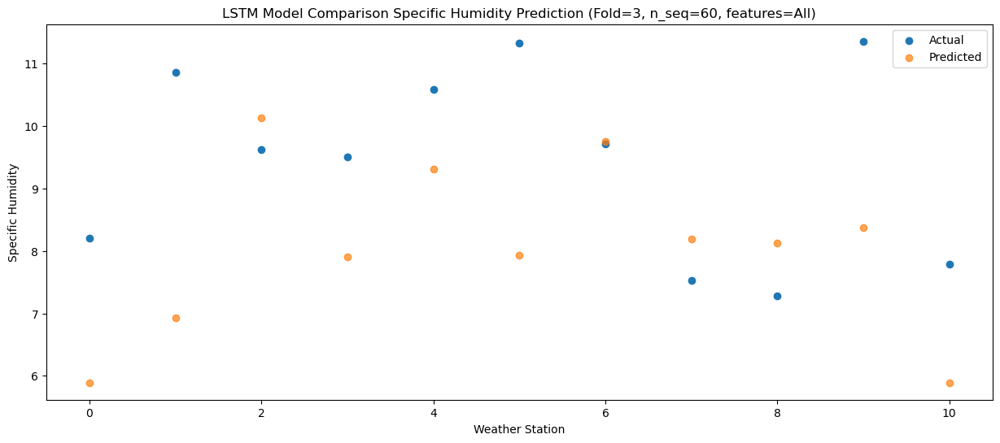

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    7.30   5.773339
1                 1   11.10   6.813339
2                 2   10.70  10.013339
3                 3    8.96   7.793339
4                 4   10.98   9.193339
5                 5   10.45   7.813339
6                 6   11.36   9.643339
7                 7   10.11   8.073339
8                 8    8.55   8.013339
9                 9    8.79   8.263339
10               10    6.55   5.773339


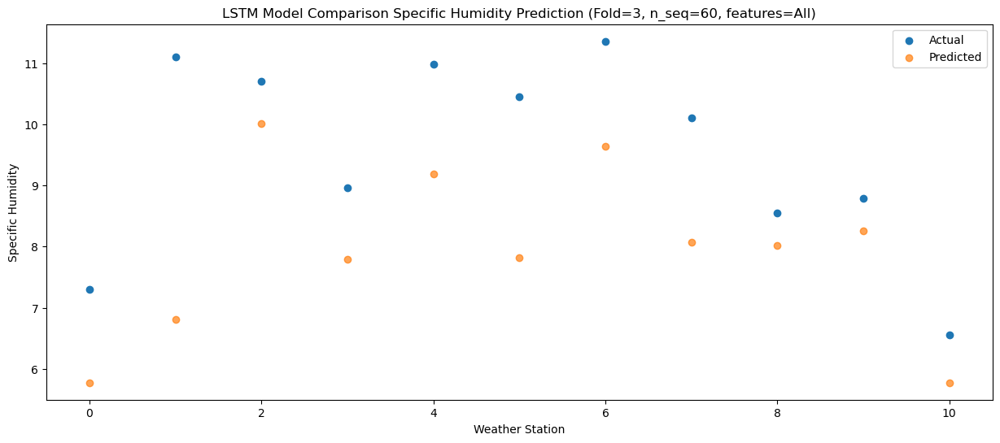

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    4.39   3.038354
1                 1    7.03   4.078354
2                 2    9.16   7.278354
3                 3    6.49   5.058354
4                 4    6.87   6.458354
5                 5    7.22   5.078354
6                 6    8.74   6.908354
7                 7    9.17   5.338354
8                 8    8.00   5.278354
9                 9    7.82   5.528354
10               10    4.86   3.038354


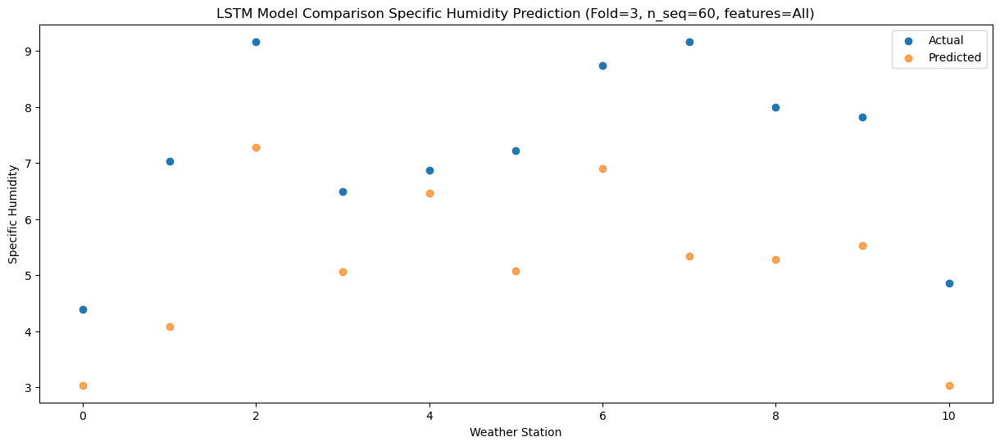

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.28  -0.282974
1                 1    3.59   0.757026
2                 2    8.00   3.957026
3                 3    2.96   1.737026
4                 4    3.25   3.137026
5                 5    3.84   1.757026
6                 6    7.49   3.587026
7                 7    6.11   2.017026
8                 8    6.57   1.957026
9                 9    4.43   2.207026
10               10    1.59  -0.282974


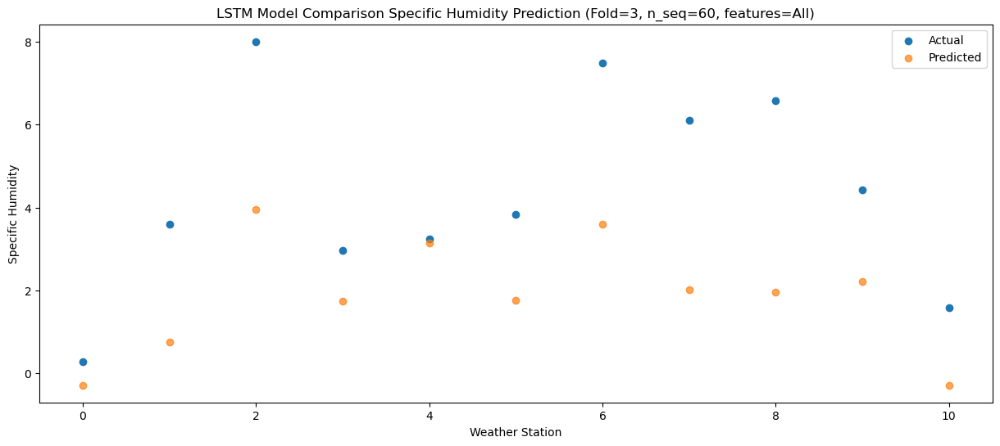

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -3.175989
1                 1    0.71  -2.135989
2                 2    5.89   1.064011
3                 3   -0.43  -1.155989
4                 4    0.08   0.244011
5                 5    0.65  -1.135989
6                 6    6.16   0.694011
7                 7    5.10  -0.875989
8                 8    5.48  -0.935989
9                 9    0.63  -0.685989
10               10   -2.09  -3.175989


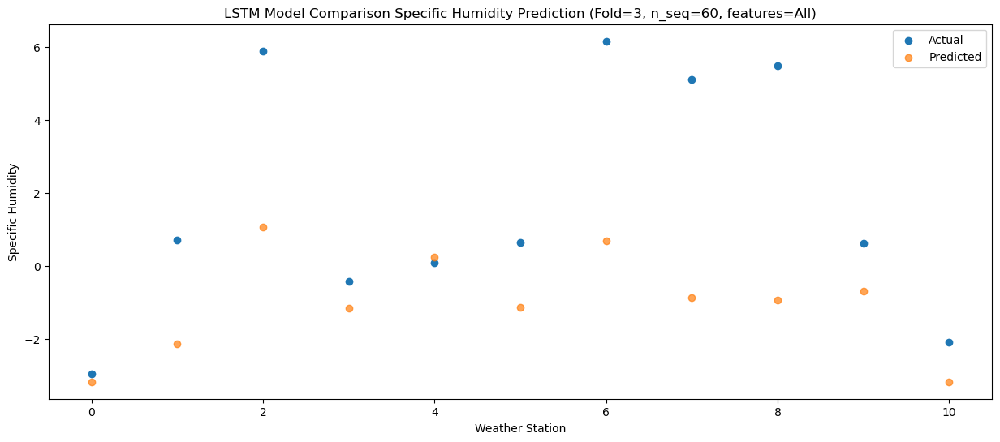

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.96  -4.110833
1                 1   -0.11  -3.070833
2                 2    6.12   0.129167
3                 3   -0.41  -2.090833
4                 4   -0.33  -0.690833
5                 5    0.61  -2.070833
6                 6    6.03  -0.240833
7                 7    5.02  -1.810833
8                 8    5.86  -1.870833
9                 9    0.96  -1.620833
10               10   -1.71  -4.110833


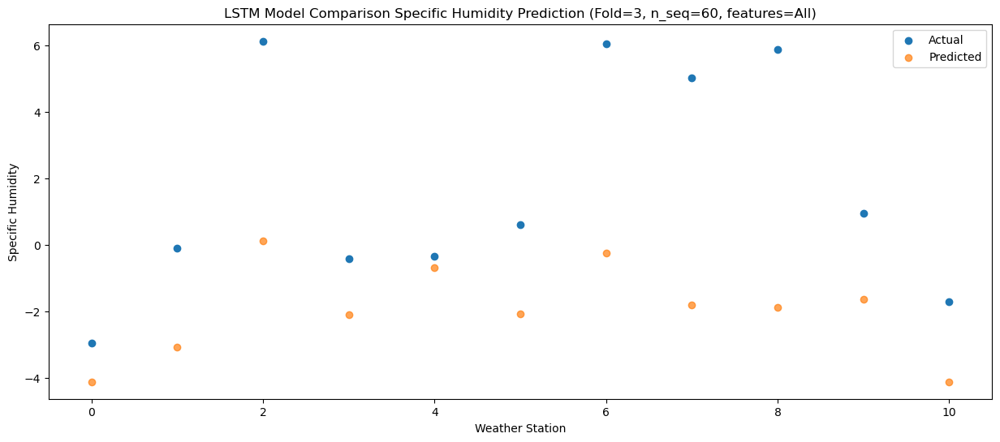

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.61  -5.012523
1                 1   -1.42  -3.972523
2                 2    6.66  -0.772523
3                 3   -1.15  -2.992523
4                 4   -1.20  -1.592523
5                 5   -0.27  -2.972523
6                 6    5.97  -1.142523
7                 7    5.56  -2.712523
8                 8    5.87  -2.772523
9                 9   -0.34  -2.522523
10               10   -2.84  -5.012523


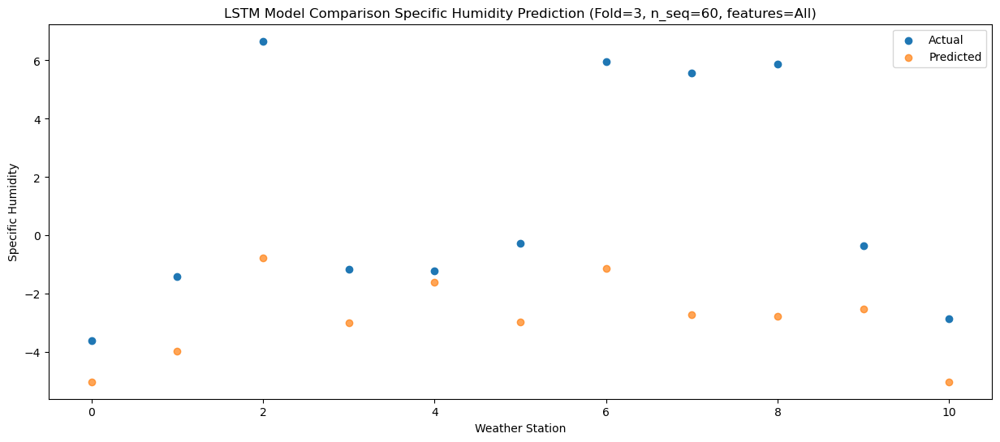

Predictions for (t+51):
    Weather_Station        Actual  Predicted
0                 0 -3.550000e+00  -3.861229
1                 1 -3.552714e-15  -2.821229
2                 2  6.830000e+00   0.378771
3                 3 -8.300000e-01  -1.841229
4                 4 -2.900000e-01  -0.441229
5                 5  3.100000e-01  -1.821229
6                 6  6.040000e+00   0.008771
7                 7  6.380000e+00  -1.561229
8                 8  5.560000e+00  -1.621229
9                 9 -4.400000e-01  -1.371229
10               10 -2.930000e+00  -3.861229


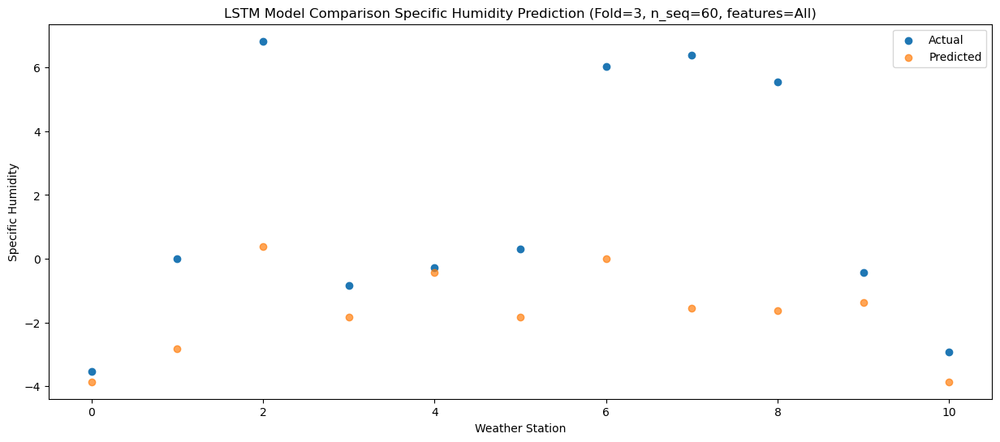

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.05  -3.044756
1                 1    1.42  -2.004756
2                 2    6.54   1.195244
3                 3    0.13  -1.024756
4                 4    0.75   0.375244
5                 5    1.39  -1.004756
6                 6    6.40   0.825244
7                 7    5.70  -0.744756
8                 8    5.36  -0.804756
9                 9    0.61  -0.554756
10               10   -1.88  -3.044756


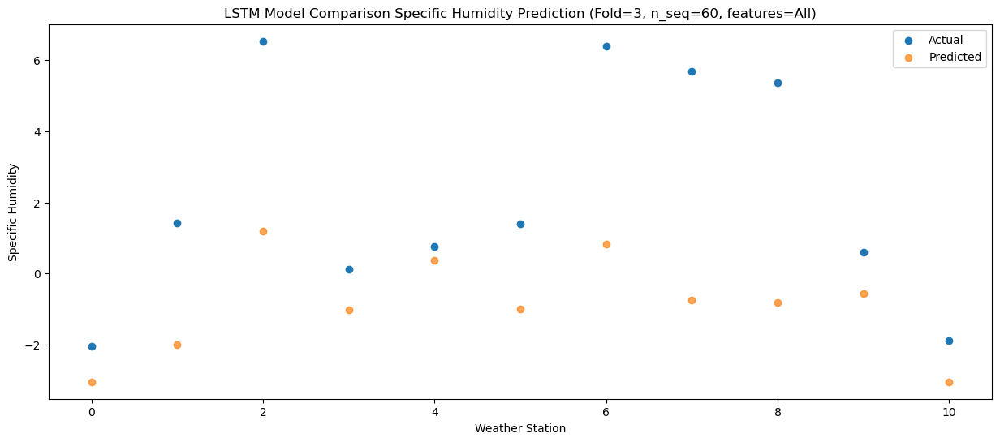

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -0.01  -1.345638
1                 1    2.96  -0.305638
2                 2    7.22   2.894362
3                 3    2.04   0.674362
4                 4    2.57   2.074362
5                 5    3.64   0.694362
6                 6    7.08   2.524362
7                 7    5.40   0.954362
8                 8    5.80   0.894362
9                 9    1.52   1.144362
10               10   -0.28  -1.345638


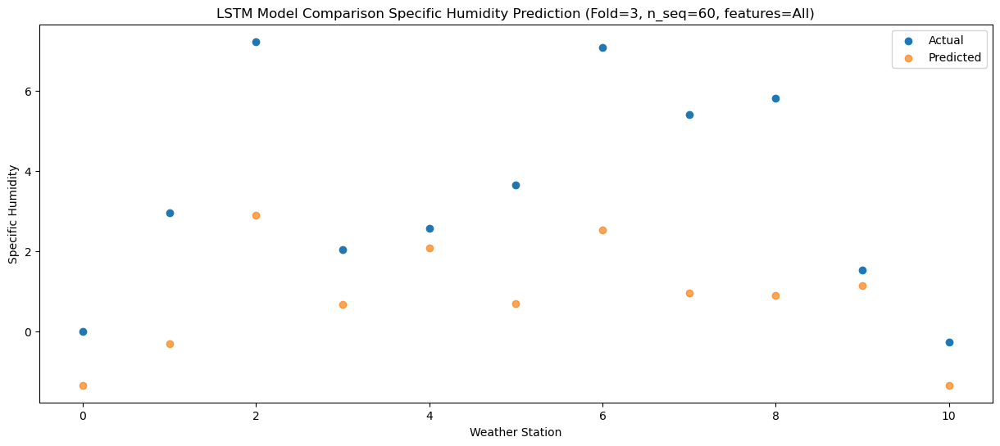

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    3.86   2.257668
1                 1    7.46   3.297668
2                 2    7.09   6.497668
3                 3    6.15   4.277668
4                 4    6.71   5.677668
5                 5    7.31   4.297668
6                 6    7.97   6.127668
7                 7    5.27   4.557668
8                 8    5.96   4.497668
9                 9    4.98   4.747668
10               10    3.35   2.257668


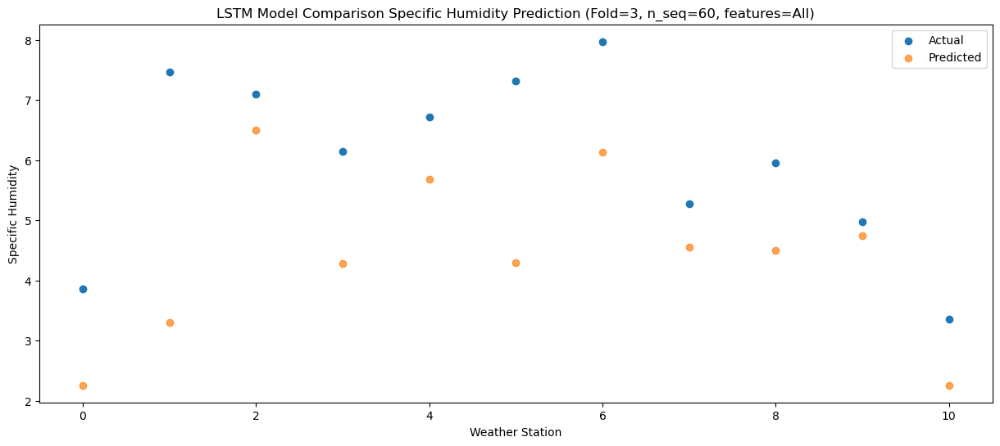

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    5.59   4.186416
1                 1    9.74   5.226416
2                 2    8.36   8.426416
3                 3    7.95   6.206416
4                 4    8.68   7.606416
5                 5    9.13   6.226416
6                 6   10.26   8.056416
7                 7    6.67   6.486416
8                 8    7.11   6.426416
9                 9    7.85   6.676416
10               10    5.03   4.186416


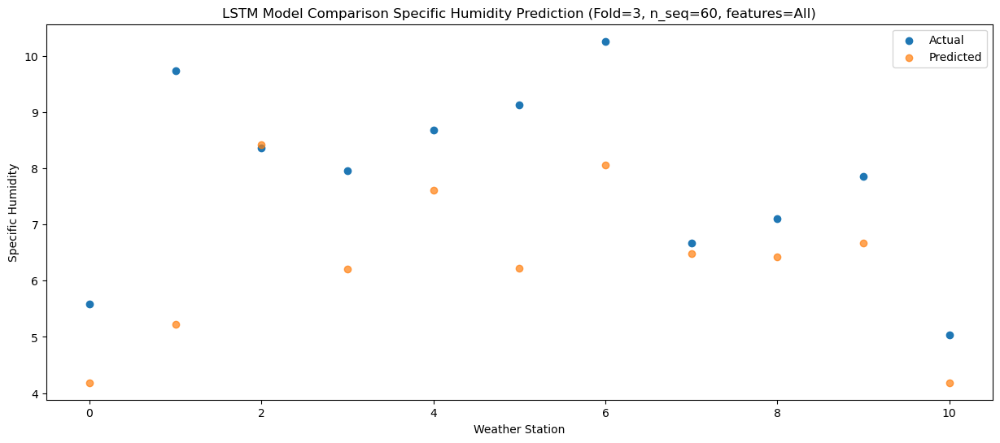

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    8.45   5.159816
1                 1   10.23   6.199816
2                 2   10.34   9.399816
3                 3    8.85   7.179816
4                 4   10.25   8.579816
5                 5   10.32   7.199816
6                 6   10.31   9.029816
7                 7    7.70   7.459816
8                 8    8.69   7.399816
9                 9   11.02   7.649816
10               10    7.91   5.159816


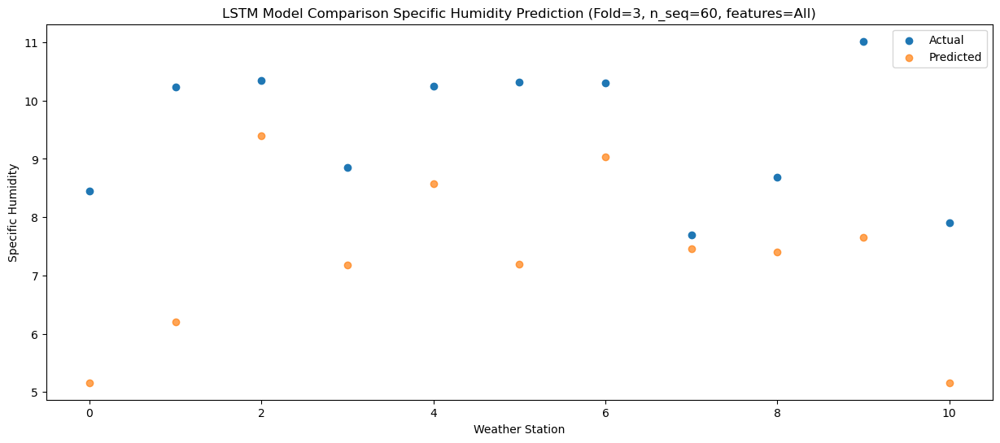

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    7.01   3.986172
1                 1    9.49   5.026172
2                 2    8.65   8.226172
3                 3    7.53   6.006172
4                 4    9.77   7.406172
5                 5    9.76   6.026172
6                 6   11.77   7.856172
7                 7    8.52   6.286172
8                 8    7.96   6.226172
9                 9    9.67   6.476172
10               10    6.63   3.986172


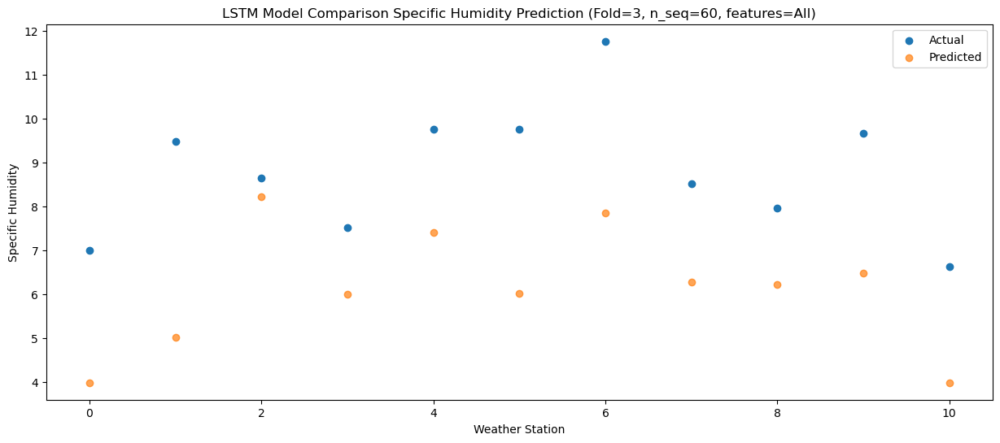

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    5.30   1.862623
1                 1    6.50   2.902623
2                 2    8.92   6.102623
3                 3    5.99   3.882623
4                 4    6.76   5.282623
5                 5    7.14   3.902623
6                 6    9.35   5.732623
7                 7    6.80   4.162623
8                 8    7.64   4.102623
9                 9    6.31   4.352623
10               10    3.81   1.862623


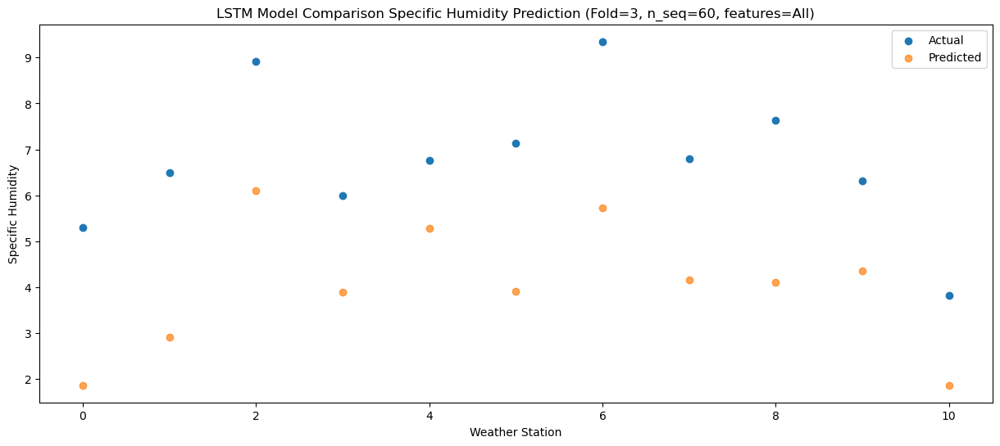

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.48  -2.052534
1                 1    2.27  -1.012534
2                 2    7.81   2.187466
3                 3    2.24  -0.032534
4                 4    2.40   1.367466
5                 5    3.27  -0.012534
6                 6    7.59   1.817466
7                 7    5.75   0.247466
8                 8    6.05   0.187466
9                 9    3.21   0.437466
10               10   -0.19  -2.052534


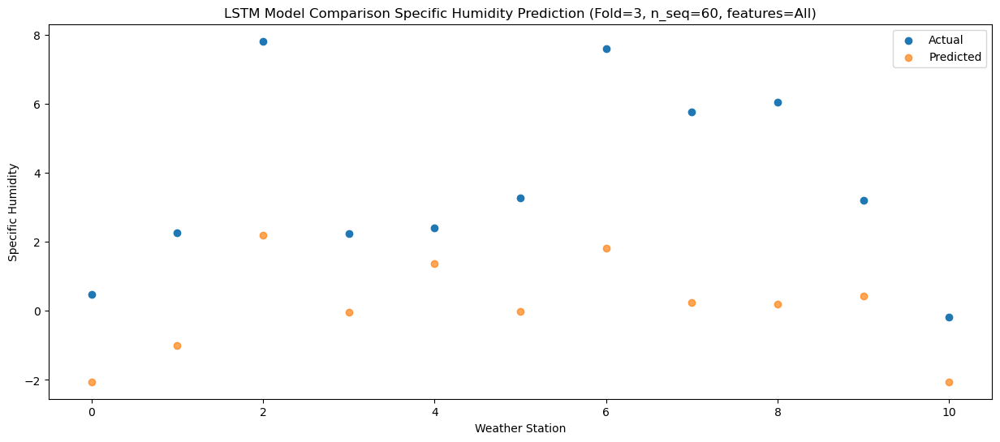

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_6 (LSTM)               (1, 1, 1024)              12308480  
                                                                 
 dropout_6 (Dropout)         (1, 1, 1024)              0         
                                                                 
 lstm_7 (LSTM)               (1, 1024)                 8392704   
                                                                 
 dropout_7 (Dropout)         (1, 1024)                 0         
                                                                 
 dense_9 (Dense)             (1, 256)                  262400    
                                                                 
 dense_10 (Dense)            (1, 128)                  32896     
                                                                 
 dense_11 (Dense)            (1, 60)                  

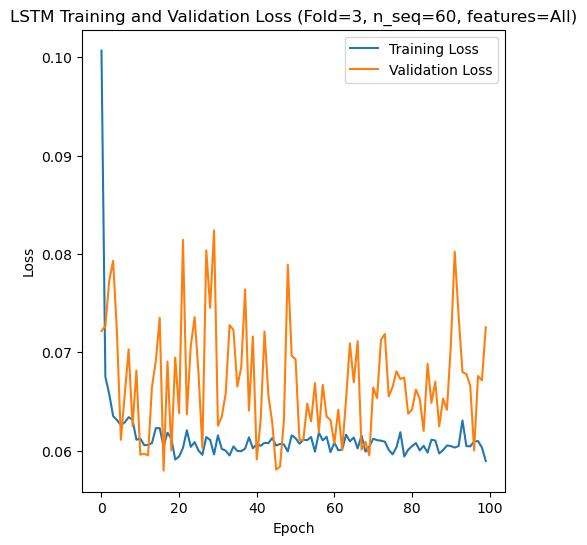

Epoch 1/100
84/84 [==============================] - 34s 162ms/step - loss: 0.1029 - accuracy: 0.2619 - mae: 0.0817 - rmse: 0.1029 - mape: 18.2371 - pearson: 0.6475 - val_loss: 0.0624 - val_accuracy: 0.7000 - val_mae: 0.0498 - val_rmse: 0.0624 - val_mape: 11.1982 - val_pearson: 0.7957
Epoch 2/100
84/84 [==============================] - 8s 95ms/step - loss: 0.0704 - accuracy: 0.3810 - mae: 0.0560 - rmse: 0.0704 - mape: 12.5222 - pearson: 0.7506 - val_loss: 0.0789 - val_accuracy: 0.7000 - val_mae: 0.0640 - val_rmse: 0.0789 - val_mape: 15.0595 - val_pearson: 0.6482
Epoch 3/100
84/84 [==============================] - 7s 86ms/step - loss: 0.0718 - accuracy: 0.4048 - mae: 0.0570 - rmse: 0.0718 - mape: 12.8090 - pearson: 0.7501 - val_loss: 0.0686 - val_accuracy: 0.0000e+00 - val_mae: 0.0537 - val_rmse: 0.0686 - val_mape: 12.7247 - val_pearson: 0.7392
Epoch 4/100
84/84 [==============================] - 7s 87ms/step - loss: 0.0718 - accuracy: 0.5000 - mae: 0.0572 - rmse: 0.0718 - mape: 12.96

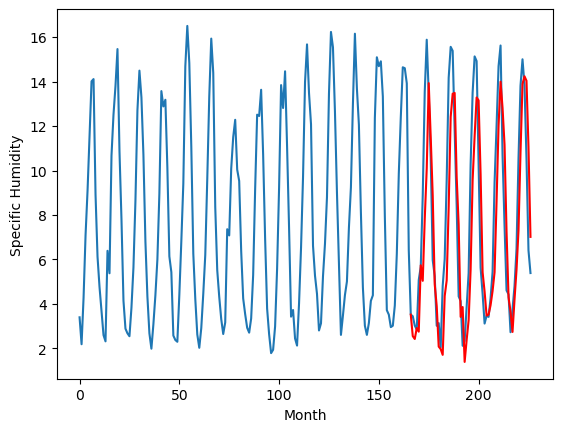

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		1.25		2.61
-1.22		1.13		2.35
-2.78		1.62		4.40
-1.94		1.45		3.39
-0.56		4.44		5.00
0.65		3.74		3.09
1.30		6.51		5.21
4.63		8.78		4.15
6.37		12.63		6.26
6.61		10.19		3.58
6.03		7.57		1.54
3.99		3.59		-0.40
0.93		2.61		1.68
-3.81		0.78		4.59
-3.46		0.67		4.13
-1.47		0.41		1.88
-1.50		3.06		4.56
-0.75		3.76		4.51
0.58		7.07		6.49
4.87		11.11		6.24
6.08		12.15		6.07
6.47		12.19		5.72
5.67		8.41		2.74
2.75		6.27		3.52
-1.91		2.12		4.03
-0.17		2.56		2.73
-4.03		0.09		4.12
-2.45		1.08		3.53
-0.92		1.97		2.89
0.37		4.26		3.89
2.76		8.27		5.51
5.66		10.24		4.58
6.69		11.98		5.29
6.77		11.85		5.08
5.90		8.53		2.63
1.12		4.13		3.01
1.29		3.26		1.97
-2.23		2.18		4.41
-2.74		2.22		4.96
-0.80		2.64		3.44
-0.42		3.28		3.70
1.07		4.12		3.05
1.87		7.31		5.44
5.38		10.72		5.34
7.29		12.69		5.40
7.59		11.51		3.92
5.14		9.85		4.71
1.52		5.95		4.43
-0.78		3.01		3.79
-1.87		2.35		4.22
-2.91		1.44		4.35
-3.6

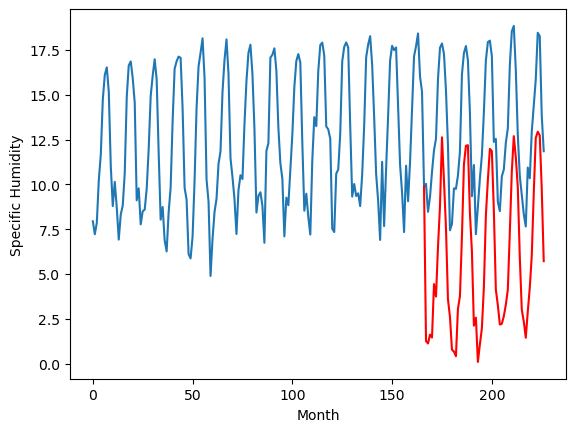

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.06		1.31		2.37
-0.22		1.19		1.41
-0.36		1.68		2.04
-0.55		1.51		2.06
3.00		4.50		1.50
1.88		3.80		1.92
4.12		6.57		2.45
7.42		8.84		1.42
10.35		12.69		2.34
8.84		10.25		1.41
6.79		7.63		0.84
3.44		3.65		0.21
0.77		2.67		1.90
-1.61		0.84		2.45
-1.72		0.73		2.45
-1.84		0.47		2.31
1.22		3.12		1.90
1.47		3.82		2.35
4.91		7.13		2.22
9.15		11.17		2.02
10.80		12.21		1.41
10.81		12.25		1.44
7.87		8.47		0.60
5.09		6.33		1.24
-0.35		2.18		2.53
2.60		2.62		0.02
-2.13		0.15		2.28
-1.28		1.14		2.42
-0.23		2.03		2.26
2.22		4.32		2.10
6.82		8.33		1.51
9.20		10.30		1.10
11.04		12.04		1.00
10.86		11.91		1.05
6.62		8.59		1.97
1.66		4.19		2.53
0.91		3.32		2.41
0.37		2.24		1.87
0.27		2.28		2.01
0.94		2.70		1.76
1.27		3.34		2.07
2.11		4.18		2.07
5.49		7.37		1.88
9.06		10.78		1.72
10.65		12.75		2.10
9.07		11.57		2.50
6.05		9.91		3.86
2.12		6.01		3.89
0.14		3.07		2.93
-1.17		2.41		3.58
-1.89		1.50		3.39
-0.46		2

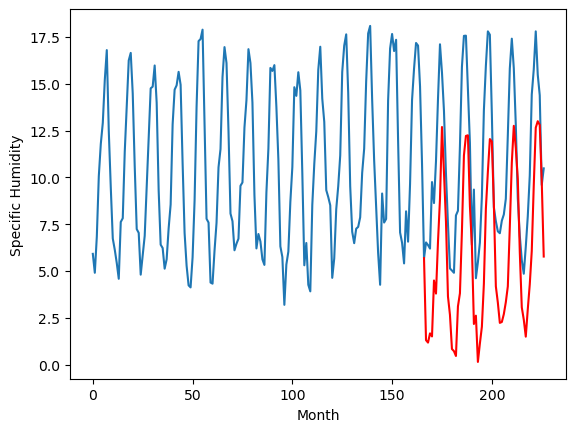

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.12		1.17		0.05
0.12		1.05		0.93
0.76		1.54		0.78
0.14		1.37		1.23
4.09		4.36		0.27
3.69		3.66		-0.03
6.85		6.43		-0.42
9.01		8.70		-0.31
12.24		12.55		0.31
9.65		10.11		0.46
8.44		7.49		-0.95
3.87		3.51		-0.36
2.23		2.53		0.30
-0.37		0.70		1.07
-0.48		0.59		1.07
-0.80		0.33		1.13
1.86		2.98		1.12
3.15		3.68		0.53
7.15		6.99		-0.16
10.84		11.03		0.19
11.41		12.07		0.66
11.80		12.11		0.31
7.79		8.33		0.54
4.94		6.19		1.25
1.32		2.04		0.72
3.18		2.48		-0.70
-1.48		0.01		1.49
-0.95		1.00		1.95
0.64		1.89		1.25
4.15		4.18		0.03
8.14		8.19		0.05
9.91		10.16		0.25
9.33		11.90		2.57
10.34		11.77		1.43
7.06		8.45		1.39
2.60		4.05		1.45
2.42		3.18		0.76
0.84		2.10		1.26
0.15		2.14		1.99
0.51		2.56		2.05
2.57		3.20		0.63
3.25		4.04		0.79
7.51		7.23		-0.28
11.45		10.64		-0.81
11.30		12.61		1.31
9.20		11.43		2.23
8.30		9.77		1.47
4.58		5.87		1.29
2.05		2.93		0.88
0.30		2.27		1.97
-0.98		1.36		2.34
1.36	

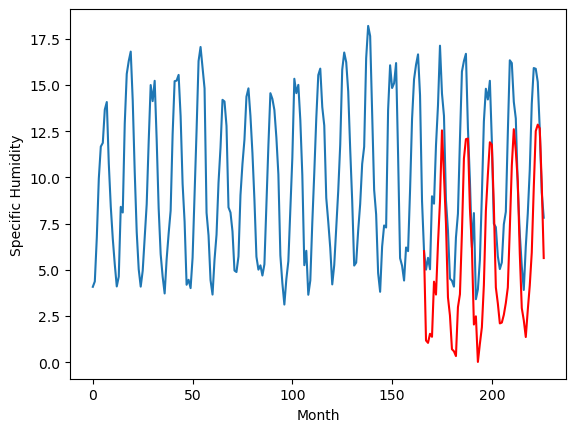

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.61		0.73		0.12
-0.36		0.61		0.97
0.33		1.10		0.77
-0.33		0.93		1.26
3.57		3.92		0.35
3.06		3.22		0.16
6.30		5.99		-0.31
8.28		8.26		-0.02
11.43		12.11		0.68
8.78		9.67		0.89
7.89		7.05		-0.84
3.12		3.07		-0.05
1.76		2.09		0.33
-0.81		0.26		1.07
-0.85		0.15		1.00
-1.30		-0.11		1.19
1.28		2.54		1.26
2.64		3.24		0.60
6.93		6.55		-0.38
10.81		10.59		-0.22
11.19		11.63		0.44
11.30		11.67		0.37
7.40		7.89		0.49
4.67		5.75		1.08
1.06		1.60		0.54
2.47		2.04		-0.43
-1.86		-0.43		1.43
-1.42		0.56		1.98
0.10		1.45		1.35
3.78		3.74		-0.04
7.66		7.75		0.09
9.34		9.72		0.38
8.84		11.46		2.62
10.01		11.33		1.32
6.86		8.01		1.15
2.40		3.61		1.21
1.98		2.74		0.76
0.39		1.66		1.27
-0.36		1.70		2.06
0.04		2.12		2.08
2.01		2.76		0.75
2.86		3.60		0.74
7.13		6.79		-0.34
10.61		10.20		-0.41
9.71		12.17		2.46
8.33		10.99		2.66
8.00		9.33		1.33
4.34		5.43		1.09
1.92		2.49		0.57
0.16		1.83		1.67
-1.26		0.92		2.18
1.

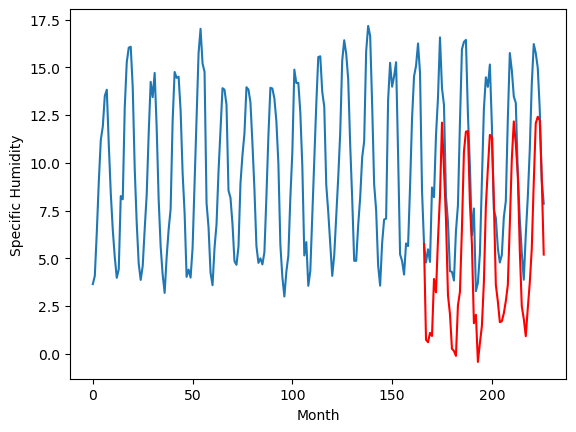

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.92		5.27		-1.65
5.68		5.15		-0.53
5.56		5.64		0.08
5.44		5.47		0.03
8.24		8.46		0.22
7.49		7.76		0.27
9.76		10.53		0.77
11.47		12.80		1.33
12.70		16.65		3.95
11.39		14.21		2.82
11.20		11.59		0.39
7.55		7.61		0.06
7.09		6.63		-0.46
4.53		4.80		0.27
5.23		4.69		-0.54
4.59		4.43		-0.16
6.08		7.08		1.00
7.04		7.78		0.74
11.59		11.09		-0.50
13.89		15.13		1.24
14.92		16.17		1.25
14.64		16.21		1.57
11.39		12.43		1.04
8.34		10.29		1.95
6.62		6.14		-0.48
5.77		6.58		0.81
4.31		4.11		-0.20
4.30		5.10		0.80
4.89		5.99		1.10
6.92		8.28		1.36
9.18		12.29		3.11
12.03		14.26		2.23
12.72		16.00		3.28
14.71		15.87		1.16
13.46		12.55		-0.91
9.95		8.15		-1.80
7.25		7.28		0.03
6.61		6.20		-0.41
5.06		6.24		1.18
5.18		6.66		1.48
6.47		7.30		0.83
6.44		8.14		1.70
11.28		11.33		0.05
15.14		14.74		-0.40
12.81		16.71		3.90
11.95		15.53		3.58
12.46		13.87		1.41
10.33		9.97		-0.36
8.03		7.03		-1.00
6.45		6.37		-0.08


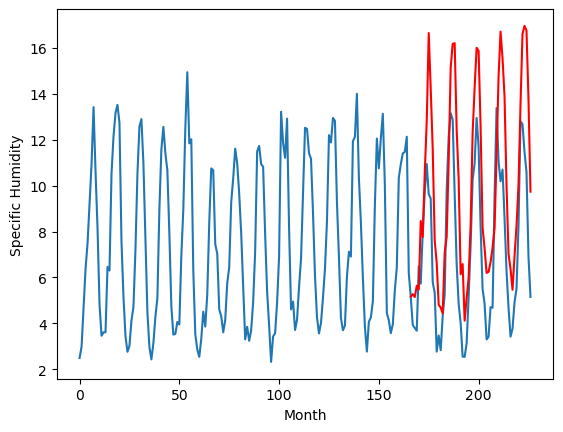

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.46		3.25		2.79
0.53		3.13		2.60
0.37		3.62		3.25
0.95		3.45		2.50
3.14		6.44		3.30
2.47		5.74		3.27
5.59		8.51		2.92
9.42		10.78		1.36
12.01		14.63		2.62
12.22		12.19		-0.03
8.38		9.57		1.19
5.73		5.59		-0.14
2.90		4.61		1.71
-0.44		2.78		3.22
-0.56		2.67		3.23
-0.31		2.41		2.72
1.40		5.06		3.66
1.81		5.76		3.95
4.79		9.07		4.28
9.48		13.11		3.63
11.08		14.15		3.07
11.46		14.19		2.73
7.88		10.41		2.53
5.67		8.27		2.60
-0.05		4.12		4.17
1.81		4.56		2.75
-1.17		2.09		3.26
0.15		3.08		2.93
0.99		3.97		2.98
2.05		6.26		4.21
6.06		10.27		4.21
8.34		12.24		3.90
11.50		13.98		2.48
10.31		13.85		3.54
6.76		10.53		3.77
2.08		6.13		4.05
1.90		5.26		3.36
-0.09		4.18		4.27
0.54		4.22		3.68
1.58		4.64		3.06
1.07		5.28		4.21
2.67		6.12		3.45
4.89		9.31		4.42
7.94		12.72		4.78
11.33		14.69		3.36
10.87		13.51		2.64
7.42		11.85		4.43
3.51		7.95		4.44
0.56		5.01		4.45
0.28		4.35		4.07
-0.50		3.44		3.94
-0.32

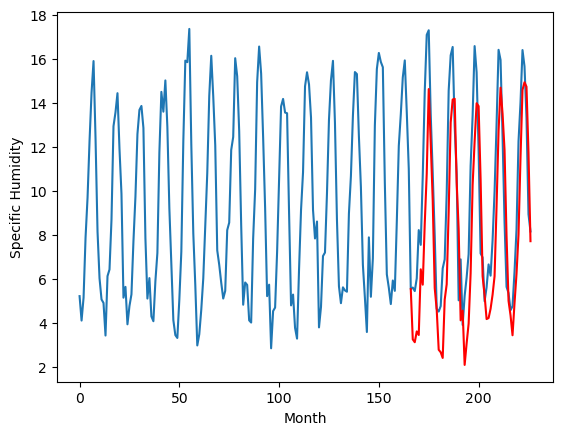

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.67		1.41		0.74
0.40		1.29		0.89
0.16		1.78		1.62
-0.07		1.61		1.68
2.48		4.60		2.12
2.80		3.90		1.10
6.18		6.67		0.49
9.79		8.94		-0.85
11.84		12.79		0.95
9.19		10.35		1.16
7.59		7.73		0.14
3.04		3.75		0.71
1.37		2.77		1.40
-0.56		0.94		1.50
-0.71		0.83		1.54
-1.34		0.57		1.91
1.03		3.22		2.19
1.95		3.92		1.97
5.11		7.23		2.12
9.71		11.27		1.56
10.66		12.31		1.65
10.40		12.35		1.95
7.14		8.57		1.43
5.05		6.43		1.38
0.36		2.28		1.92
1.83		2.72		0.89
-1.37		0.25		1.62
-0.86		1.24		2.10
0.65		2.13		1.48
2.44		4.42		1.98
7.15		8.43		1.28
9.51		10.40		0.89
10.31		12.14		1.83
10.78		12.01		1.23
6.97		8.69		1.72
2.31		4.29		1.98
0.95		3.42		2.47
0.08		2.34		2.26
0.36		2.38		2.02
0.17		2.80		2.63
0.93		3.44		2.51
1.83		4.28		2.45
6.22		7.47		1.25
8.78		10.88		2.10
11.57		12.85		1.28
11.85		11.67		-0.18
7.65		10.01		2.36
4.04		6.11		2.07
1.01		3.17		2.16
0.20		2.51		2.31
-0.95		1.60		2.55
0.41		3.06

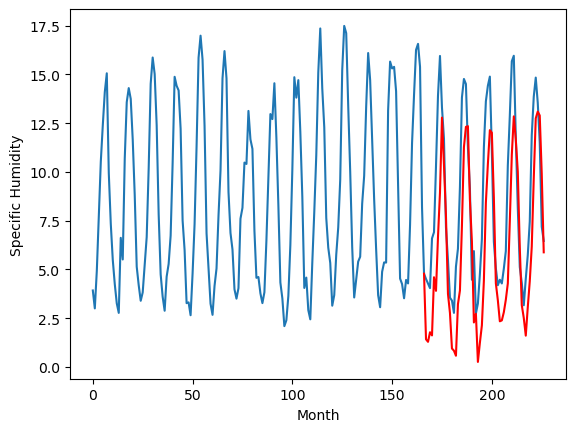

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.13		0.98		0.85
0.30		0.86		0.56
-0.07		1.35		1.42
-0.47		1.18		1.65
1.45		4.17		2.72
1.73		3.47		1.74
4.88		6.24		1.36
7.62		8.51		0.89
10.84		12.36		1.52
9.17		9.92		0.75
6.25		7.30		1.05
2.87		3.32		0.45
1.19		2.34		1.15
-0.41		0.51		0.92
-0.76		0.40		1.16
-1.33		0.14		1.47
0.61		2.79		2.18
1.94		3.49		1.55
4.23		6.80		2.57
9.29		10.84		1.55
10.55		11.88		1.33
10.69		11.92		1.23
7.21		8.14		0.93
6.06		6.00		-0.06
0.29		1.85		1.56
1.00		2.29		1.29
-1.38		-0.18		1.20
-0.80		0.81		1.61
0.51		1.70		1.19
2.00		3.99		1.99
6.02		8.00		1.98
7.46		9.97		2.51
10.20		11.71		1.51
9.84		11.58		1.74
7.18		8.26		1.08
1.85		3.86		2.01
0.81		2.99		2.18
-0.15		1.91		2.06
0.47		1.95		1.48
0.07		2.37		2.30
0.42		3.01		2.59
1.87		3.85		1.98
4.12		7.04		2.92
6.08		10.45		4.37
10.38		12.42		2.04
9.84		11.24		1.40
7.04		9.58		2.54
3.71		5.68		1.97
0.64		2.74		2.10
0.61		2.08		1.47
-0.47		1.17		1.64
0.11		2.63		2

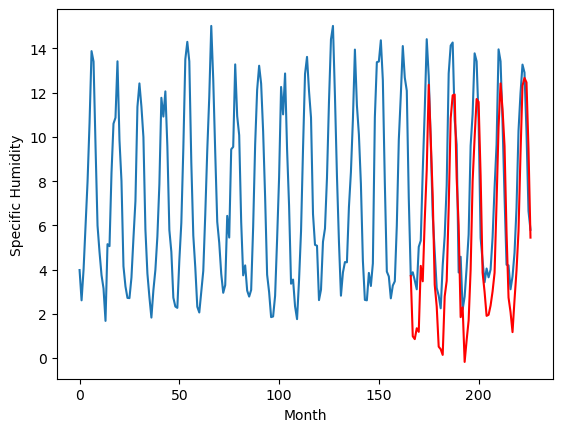

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		-0.18		0.36
-0.37		-0.30		0.07
-0.85		0.19		1.04
-1.12		0.02		1.14
0.93		3.01		2.08
1.52		2.31		0.79
5.24		5.08		-0.16
7.72		7.35		-0.37
11.28		11.20		-0.08
9.09		8.76		-0.33
6.31		6.14		-0.17
2.15		2.16		0.01
1.06		1.18		0.12
-0.85		-0.65		0.20
-1.17		-0.76		0.41
-1.81		-1.02		0.79
0.56		1.63		1.07
1.87		2.33		0.46
4.49		5.64		1.15
9.24		9.68		0.44
10.64		10.72		0.08
10.89		10.76		-0.13
6.86		6.98		0.12
4.99		4.84		-0.15
-0.30		0.69		0.99
0.24		1.13		0.89
-2.00		-1.34		0.66
-1.30		-0.35		0.95
0.22		0.54		0.32
1.52		2.83		1.31
5.59		6.84		1.25
7.83		8.81		0.98
10.47		10.55		0.08
9.70		10.42		0.72
6.33		7.10		0.77
1.57		2.70		1.13
0.20		1.83		1.63
-0.91		0.75		1.66
-0.39		0.79		1.18
-0.62		1.21		1.83
-0.01		1.85		1.86
1.50		2.69		1.19
4.28		5.88		1.60
5.92		9.29		3.37
10.62		11.26		0.64
10.49		10.08		-0.41
6.71		8.42		1.71
3.27		4.52		1.25
-0.12		1.58		1.70
0.37		0.92		0.55
-1.09		0.01

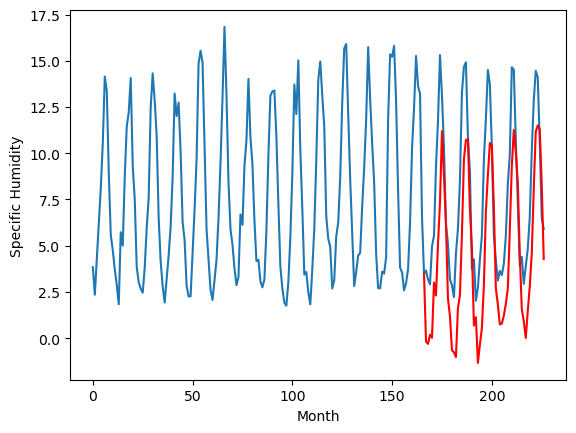

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.53		2.55		1.02
1.68		2.43		0.75
1.34		2.92		1.58
0.99		2.75		1.76
2.56		5.74		3.18
2.40		5.04		2.64
5.02		7.81		2.79
8.21		10.08		1.87
11.13		13.93		2.80
9.71		11.49		1.78
7.57		8.87		1.30
4.53		4.89		0.36
2.60		3.91		1.31
1.27		2.08		0.81
0.89		1.97		1.08
0.32		1.71		1.39
1.61		4.36		2.75
3.28		5.06		1.78
4.88		8.37		3.49
9.89		12.41		2.52
11.16		13.45		2.29
12.03		13.49		1.46
8.27		9.71		1.44
7.26		7.57		0.31
2.02		3.42		1.40
1.98		3.86		1.88
0.24		1.39		1.15
0.69		2.38		1.69
1.84		3.27		1.43
2.83		5.56		2.73
6.29		9.57		3.28
8.20		11.54		3.34
9.93		13.28		3.35
10.39		13.15		2.76
8.40		9.83		1.43
3.58		5.43		1.85
2.86		4.56		1.70
1.41		3.48		2.07
2.03		3.52		1.49
1.28		3.94		2.66
1.49		4.58		3.09
3.19		5.42		2.23
4.09		8.61		4.52
7.33		12.02		4.69
10.95		13.99		3.04
10.15		12.81		2.66
8.44		11.15		2.71
5.38		7.25		1.87
1.94		4.31		2.37
2.46		3.65		1.19
1.39		2.74		1.35
1.41		4.20		2.79
2

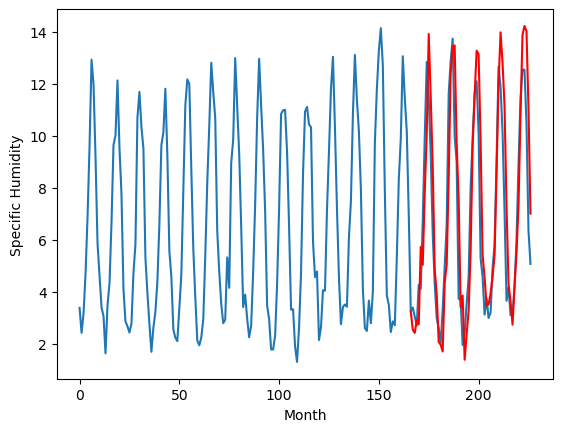

RangeIndex(start=1, stop=12, step=1)
[2.3299999999999996, -1.3599999999999994, -1.06, 1.1199999999999997, 0.6100000000000012, 6.92, 0.45999999999999996, 0.6700000000000013, 0.1299999999999999, -0.5399999999999991, 1.529999999999999]
[2.5548317146301267, 1.2548317146301269, 1.314831714630127, 1.1748317146301268, 0.7348317146301269, 5.274831714630127, 3.254831714630127, 1.414831714630127, 0.9848317146301269, -0.17516828536987283, 2.5548317146301267]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.33   2.554832
1                 1   -1.36   1.254832
2                 2   -1.06   1.314832
3                 3    1.12   1.174832
4                 4    0.61   0.734832
5                 5    6.92   5.274832
6                 6    0.46   3.254832
7                 7    0.67   1.414832
8                 8    0.13   0.984832
9                 9   -0.54  -0.175168
10               10    1.53   2.554832


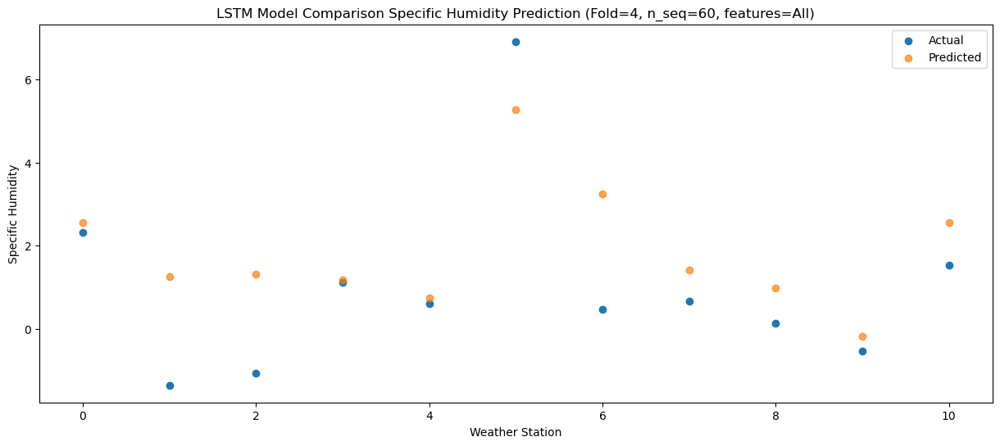

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    2.26   2.425657
1                 1   -1.22   1.125657
2                 2   -0.22   1.185657
3                 3    0.12   1.045657
4                 4   -0.36   0.605657
5                 5    5.68   5.145657
6                 6    0.53   3.125657
7                 7    0.40   1.285657
8                 8    0.30   0.855657
9                 9   -0.37  -0.304343
10               10    1.68   2.425657


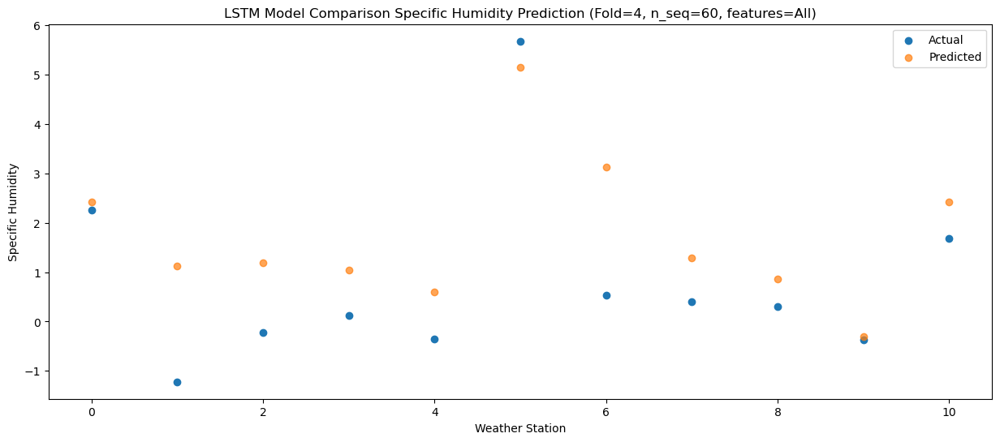

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.84    2.91798
1                 1   -2.78    1.61798
2                 2   -0.36    1.67798
3                 3    0.76    1.53798
4                 4    0.33    1.09798
5                 5    5.56    5.63798
6                 6    0.37    3.61798
7                 7    0.16    1.77798
8                 8   -0.07    1.34798
9                 9   -0.85    0.18798
10               10    1.34    2.91798


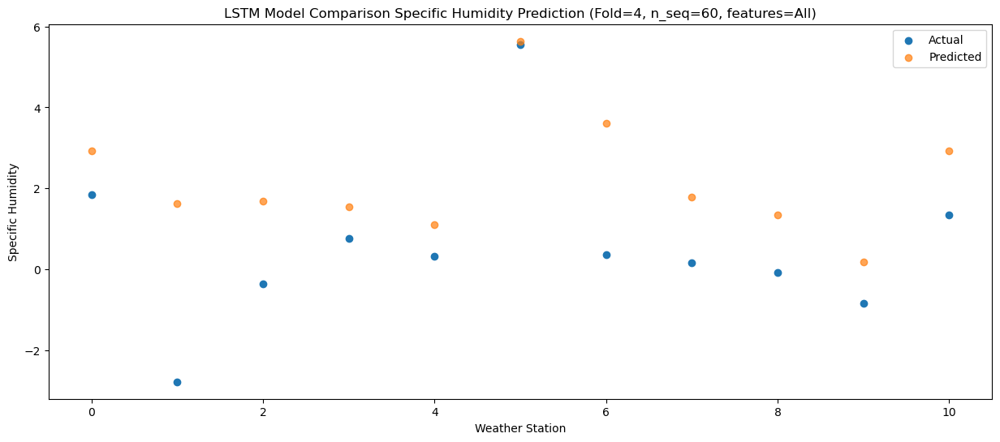

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    1.66   2.754004
1                 1   -1.94   1.454004
2                 2   -0.55   1.514004
3                 3    0.14   1.374004
4                 4   -0.33   0.934004
5                 5    5.44   5.474004
6                 6    0.95   3.454004
7                 7   -0.07   1.614004
8                 8   -0.47   1.184004
9                 9   -1.12   0.024004
10               10    0.99   2.754004


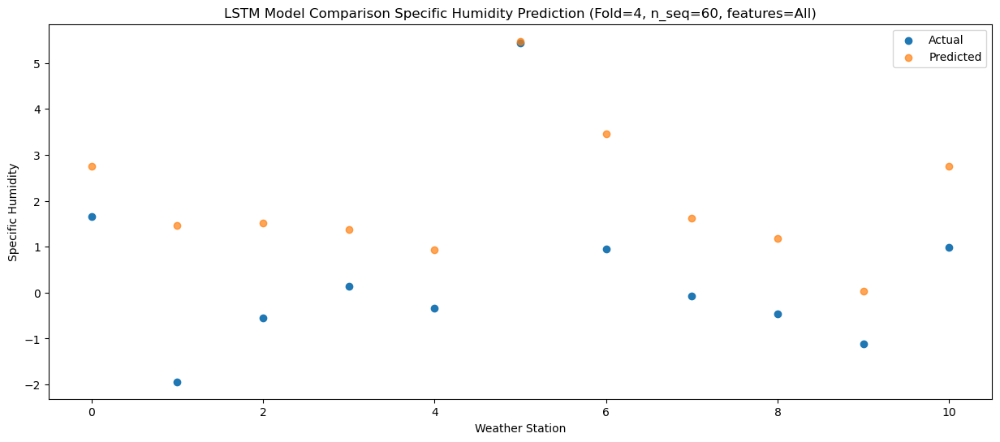

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.89   5.738536
1                 1   -0.56   4.438536
2                 2    3.00   4.498536
3                 3    4.09   4.358536
4                 4    3.57   3.918536
5                 5    8.24   8.458536
6                 6    3.14   6.438536
7                 7    2.48   4.598536
8                 8    1.45   4.168536
9                 9    0.93   3.008536
10               10    2.56   5.738536


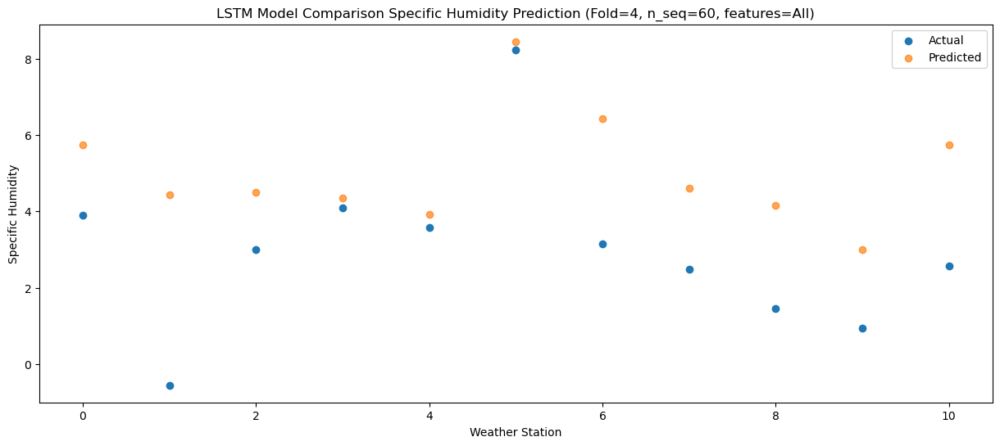

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.48   5.040968
1                 1    0.65   3.740968
2                 2    1.88   3.800968
3                 3    3.69   3.660968
4                 4    3.06   3.220968
5                 5    7.49   7.760968
6                 6    2.47   5.740968
7                 7    2.80   3.900968
8                 8    1.73   3.470968
9                 9    1.52   2.310968
10               10    2.40   5.040968


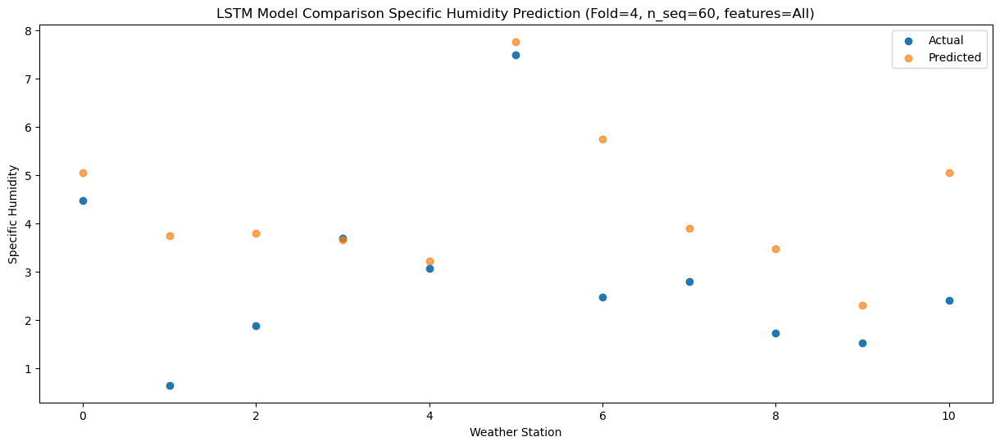

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    7.69   7.806635
1                 1    1.30   6.506635
2                 2    4.12   6.566635
3                 3    6.85   6.426635
4                 4    6.30   5.986635
5                 5    9.76  10.526635
6                 6    5.59   8.506635
7                 7    6.18   6.666635
8                 8    4.88   6.236635
9                 9    5.24   5.076635
10               10    5.02   7.806635


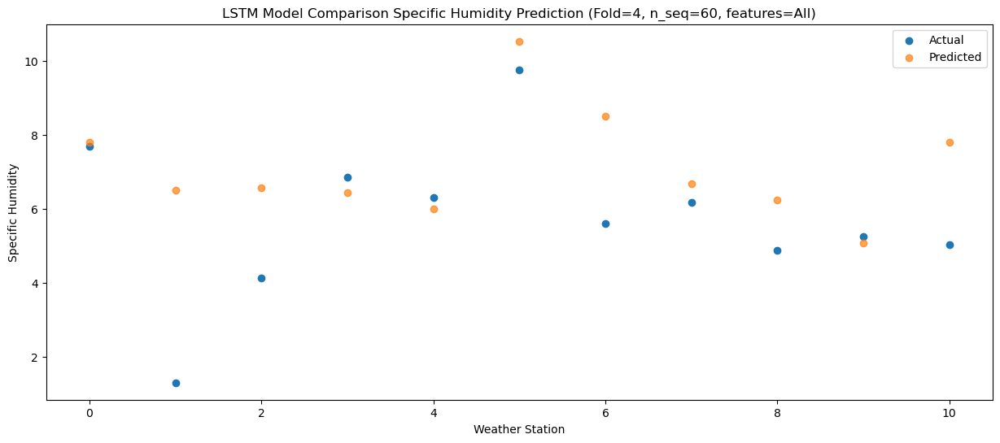

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.34   10.08392
1                 1    4.63    8.78392
2                 2    7.42    8.84392
3                 3    9.01    8.70392
4                 4    8.28    8.26392
5                 5   11.47   12.80392
6                 6    9.42   10.78392
7                 7    9.79    8.94392
8                 8    7.62    8.51392
9                 9    7.72    7.35392
10               10    8.21   10.08392


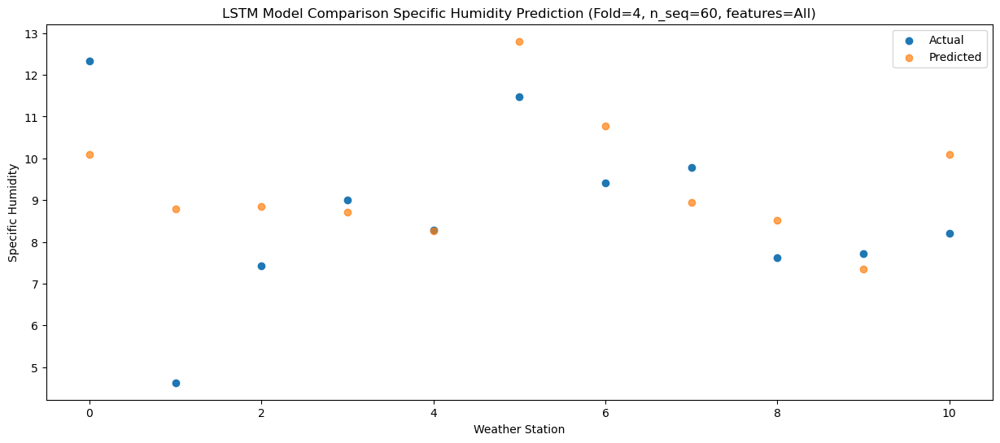

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.69  13.927556
1                 1    6.37  12.627556
2                 2   10.35  12.687556
3                 3   12.24  12.547556
4                 4   11.43  12.107556
5                 5   12.70  16.647556
6                 6   12.01  14.627556
7                 7   11.84  12.787556
8                 8   10.84  12.357556
9                 9   11.28  11.197556
10               10   11.13  13.927556


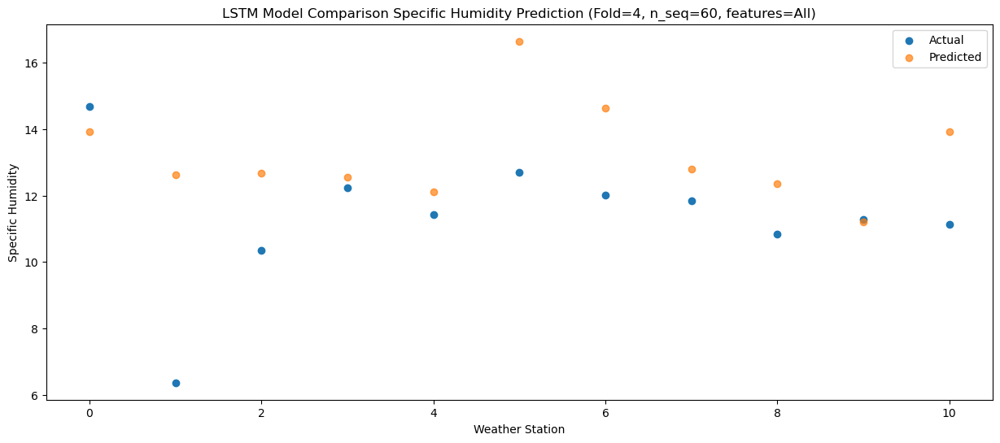

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   12.26   11.49456
1                 1    6.61   10.19456
2                 2    8.84   10.25456
3                 3    9.65   10.11456
4                 4    8.78    9.67456
5                 5   11.39   14.21456
6                 6   12.22   12.19456
7                 7    9.19   10.35456
8                 8    9.17    9.92456
9                 9    9.09    8.76456
10               10    9.71   11.49456


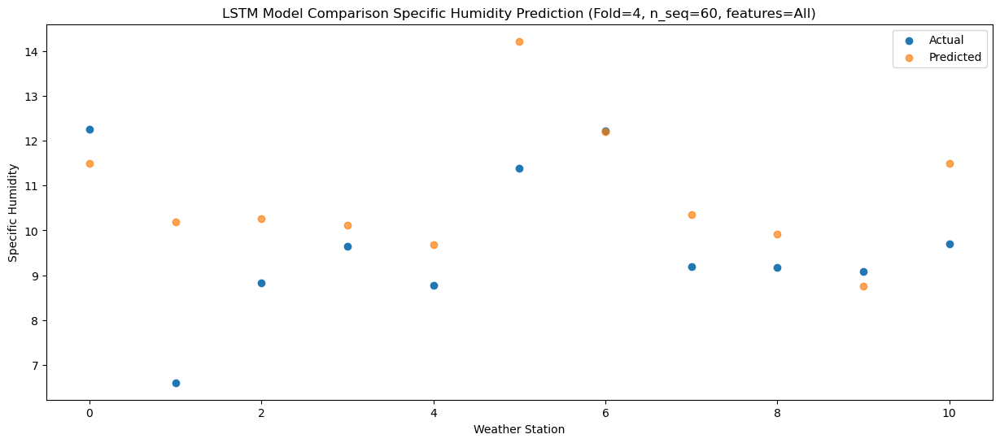

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.37   8.870067
1                 1    6.03   7.570067
2                 2    6.79   7.630067
3                 3    8.44   7.490067
4                 4    7.89   7.050067
5                 5   11.20  11.590067
6                 6    8.38   9.570067
7                 7    7.59   7.730067
8                 8    6.25   7.300067
9                 9    6.31   6.140067
10               10    7.57   8.870067


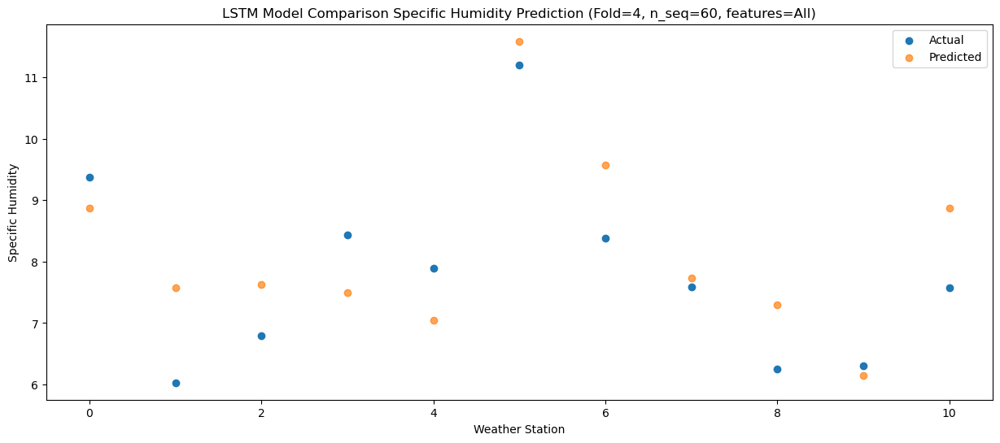

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.78   4.887366
1                 1    3.99   3.587366
2                 2    3.44   3.647366
3                 3    3.87   3.507366
4                 4    3.12   3.067366
5                 5    7.55   7.607366
6                 6    5.73   5.587366
7                 7    3.04   3.747366
8                 8    2.87   3.317366
9                 9    2.15   2.157366
10               10    4.53   4.887366


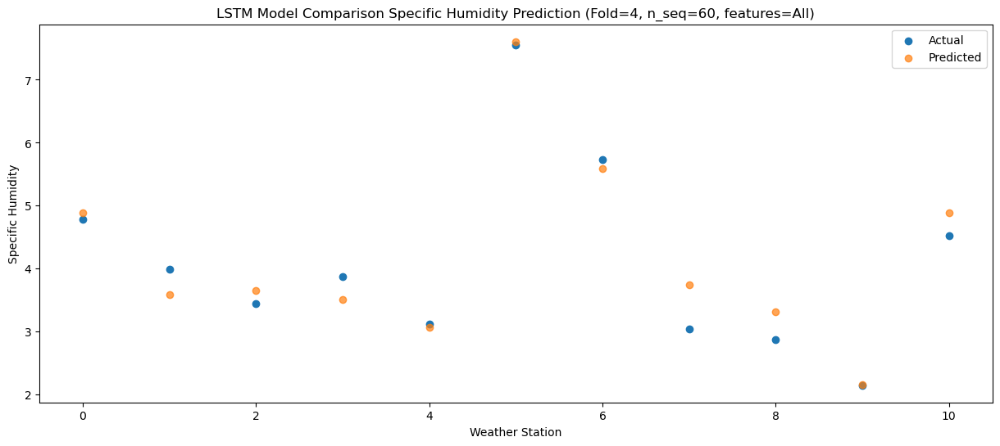

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.06   3.905168
1                 1    0.93   2.605168
2                 2    0.77   2.665168
3                 3    2.23   2.525168
4                 4    1.76   2.085168
5                 5    7.09   6.625168
6                 6    2.90   4.605168
7                 7    1.37   2.765168
8                 8    1.19   2.335168
9                 9    1.06   1.175168
10               10    2.60   3.905168


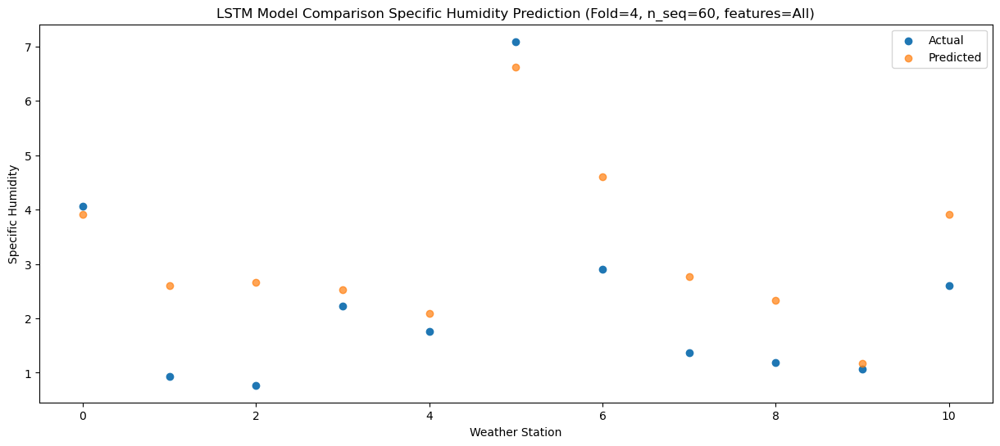

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.83   2.083509
1                 1   -3.81   0.783509
2                 2   -1.61   0.843509
3                 3   -0.37   0.703509
4                 4   -0.81   0.263509
5                 5    4.53   4.803509
6                 6   -0.44   2.783509
7                 7   -0.56   0.943509
8                 8   -0.41   0.513509
9                 9   -0.85  -0.646491
10               10    1.27   2.083509


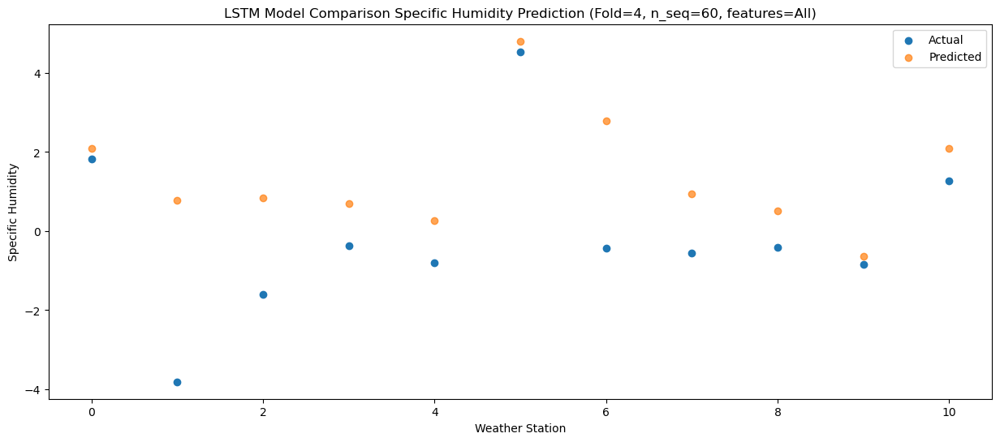

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.95   1.969683
1                 1   -3.46   0.669683
2                 2   -1.72   0.729683
3                 3   -0.48   0.589683
4                 4   -0.85   0.149683
5                 5    5.23   4.689683
6                 6   -0.56   2.669683
7                 7   -0.71   0.829683
8                 8   -0.76   0.399683
9                 9   -1.17  -0.760317
10               10    0.89   1.969683


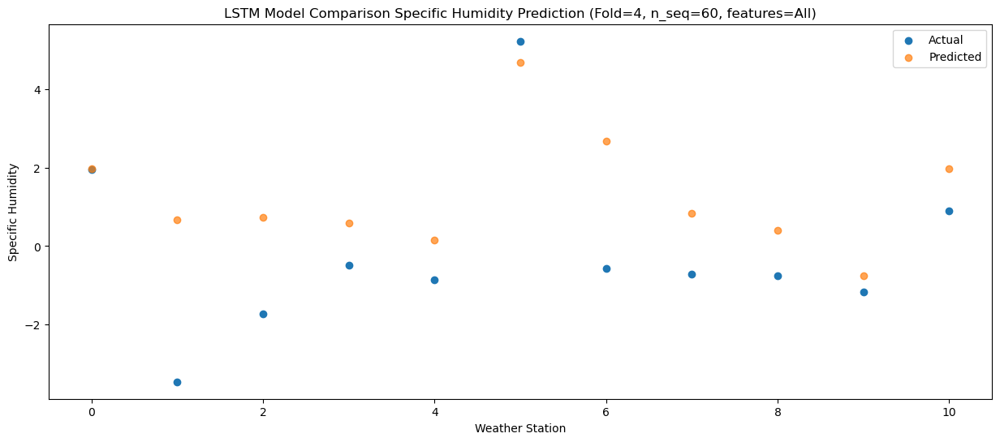

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0    0.86   1.711501
1                 1   -1.47   0.411501
2                 2   -1.84   0.471501
3                 3   -0.80   0.331501
4                 4   -1.30  -0.108499
5                 5    4.59   4.431501
6                 6   -0.31   2.411501
7                 7   -1.34   0.571501
8                 8   -1.33   0.141501
9                 9   -1.81  -1.018499
10               10    0.32   1.711501


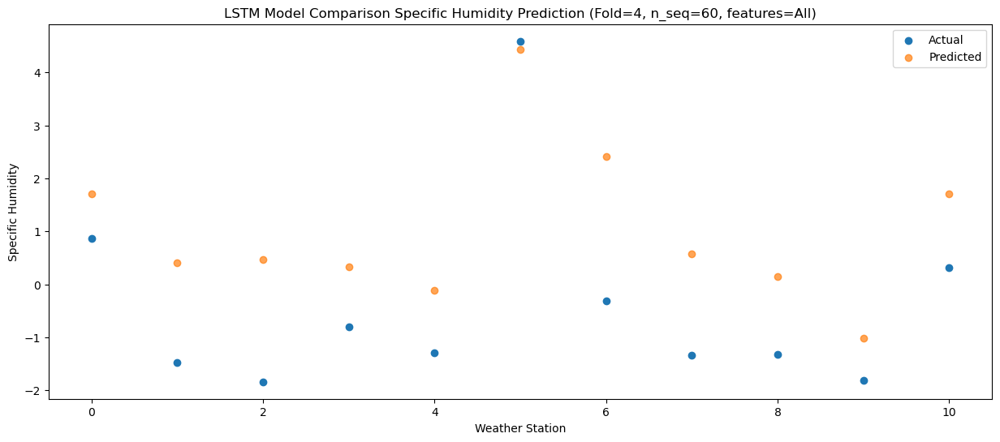

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    3.62   4.357149
1                 1   -1.50   3.057149
2                 2    1.22   3.117149
3                 3    1.86   2.977149
4                 4    1.28   2.537149
5                 5    6.08   7.077149
6                 6    1.40   5.057149
7                 7    1.03   3.217149
8                 8    0.61   2.787149
9                 9    0.56   1.627149
10               10    1.61   4.357149


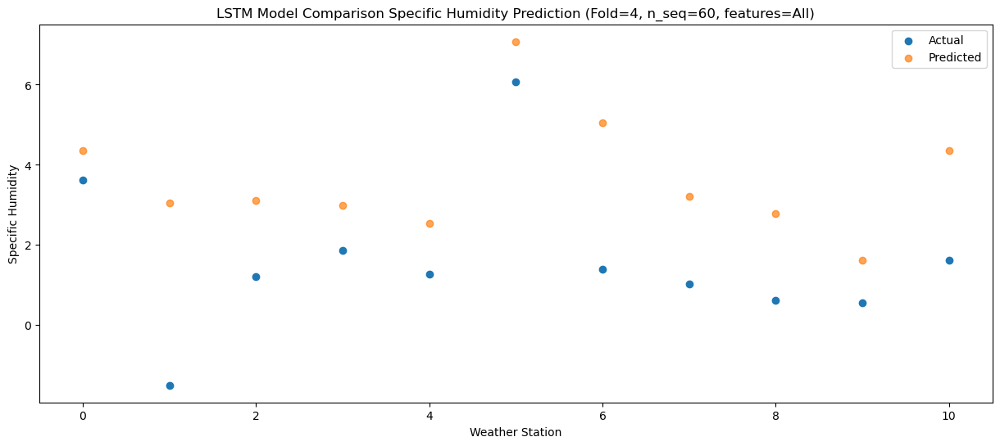

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.83   5.056501
1                 1   -0.75   3.756501
2                 2    1.47   3.816501
3                 3    3.15   3.676501
4                 4    2.64   3.236501
5                 5    7.04   7.776501
6                 6    1.81   5.756501
7                 7    1.95   3.916501
8                 8    1.94   3.486501
9                 9    1.87   2.326501
10               10    3.28   5.056501


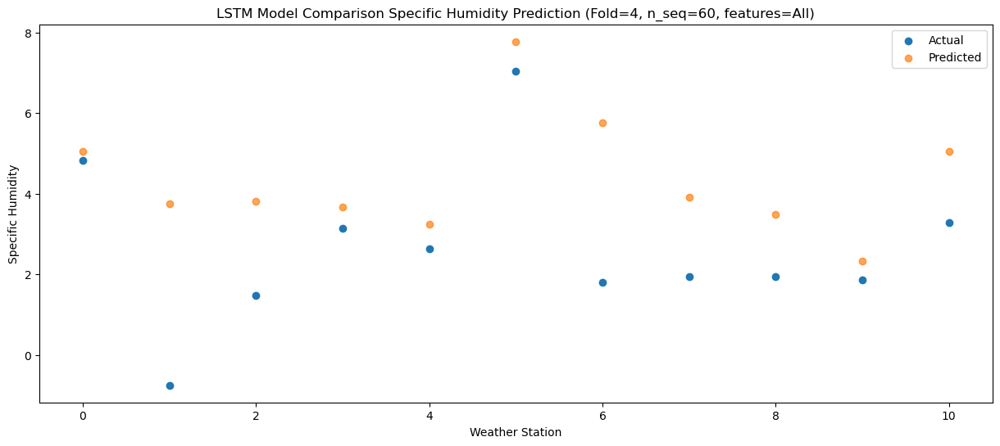

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.39   8.372914
1                 1    0.58   7.072914
2                 2    4.91   7.132914
3                 3    7.15   6.992914
4                 4    6.93   6.552914
5                 5   11.59  11.092914
6                 6    4.79   9.072914
7                 7    5.11   7.232914
8                 8    4.23   6.802914
9                 9    4.49   5.642914
10               10    4.88   8.372914


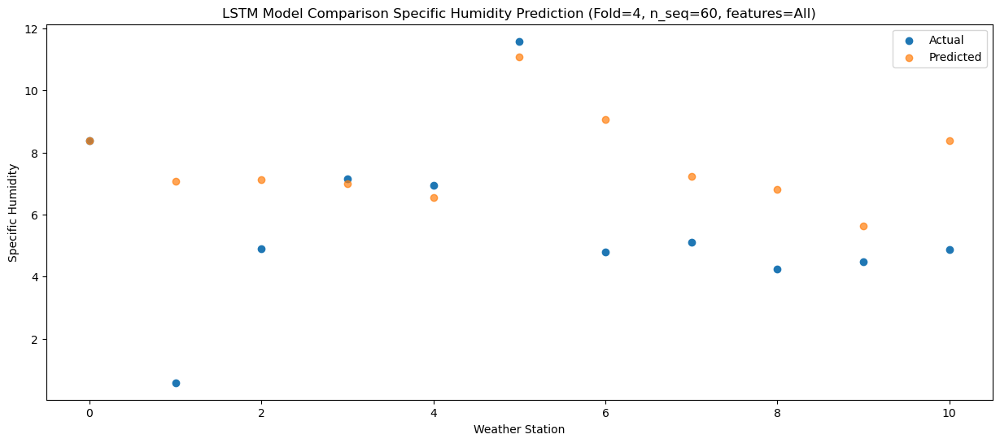

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.98   12.40906
1                 1    4.87   11.10906
2                 2    9.15   11.16906
3                 3   10.84   11.02906
4                 4   10.81   10.58906
5                 5   13.89   15.12906
6                 6    9.48   13.10906
7                 7    9.71   11.26906
8                 8    9.29   10.83906
9                 9    9.24    9.67906
10               10    9.89   12.40906


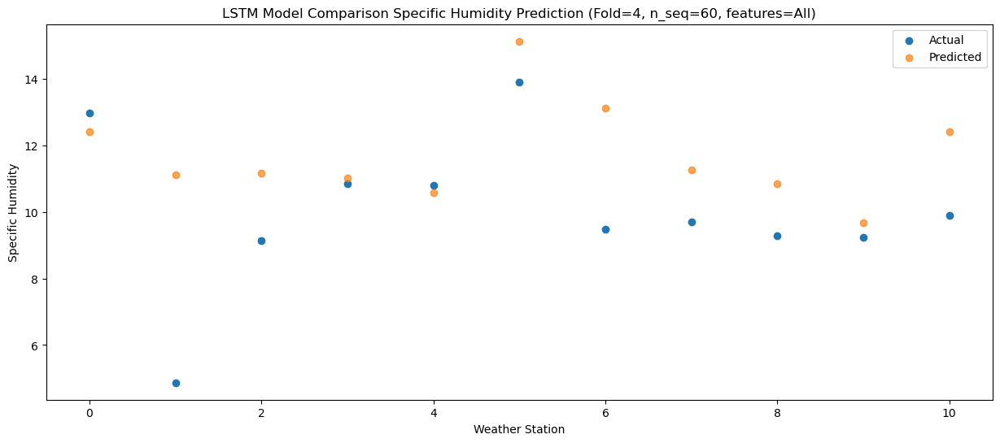

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.37  13.451563
1                 1    6.08  12.151563
2                 2   10.80  12.211563
3                 3   11.41  12.071563
4                 4   11.19  11.631563
5                 5   14.92  16.171563
6                 6   11.08  14.151563
7                 7   10.66  12.311563
8                 8   10.55  11.881563
9                 9   10.64  10.721563
10               10   11.16  13.451563


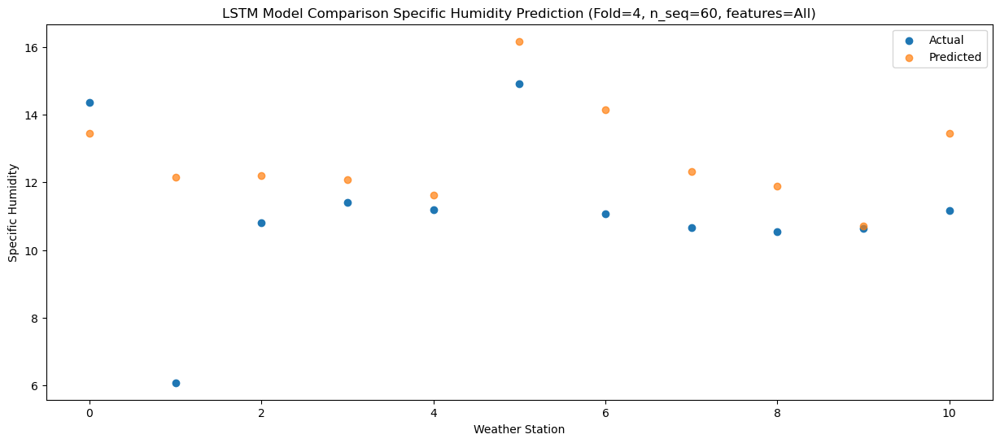

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.19  13.486363
1                 1    6.47  12.186363
2                 2   10.81  12.246363
3                 3   11.80  12.106363
4                 4   11.30  11.666363
5                 5   14.64  16.206363
6                 6   11.46  14.186363
7                 7   10.40  12.346363
8                 8   10.69  11.916363
9                 9   10.89  10.756363
10               10   12.03  13.486363


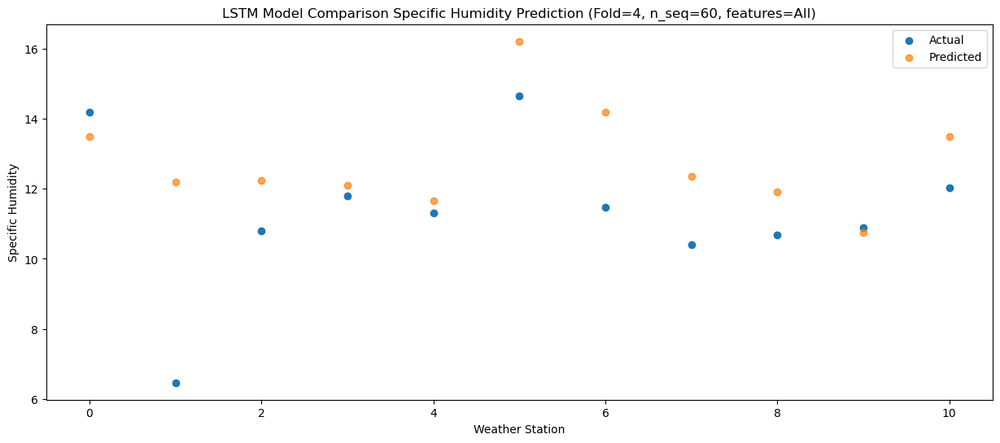

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.61   9.708385
1                 1    5.67   8.408385
2                 2    7.87   8.468385
3                 3    7.79   8.328385
4                 4    7.40   7.888385
5                 5   11.39  12.428385
6                 6    7.88  10.408385
7                 7    7.14   8.568385
8                 8    7.21   8.138385
9                 9    6.86   6.978385
10               10    8.27   9.708385


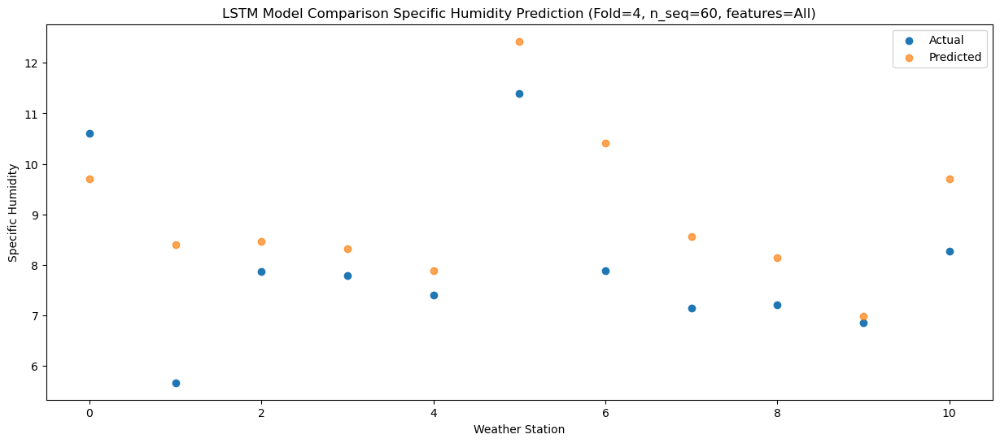

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.24   7.568943
1                 1    2.75   6.268943
2                 2    5.09   6.328943
3                 3    4.94   6.188943
4                 4    4.67   5.748943
5                 5    8.34  10.288943
6                 6    5.67   8.268943
7                 7    5.05   6.428943
8                 8    6.06   5.998943
9                 9    4.99   4.838943
10               10    7.26   7.568943


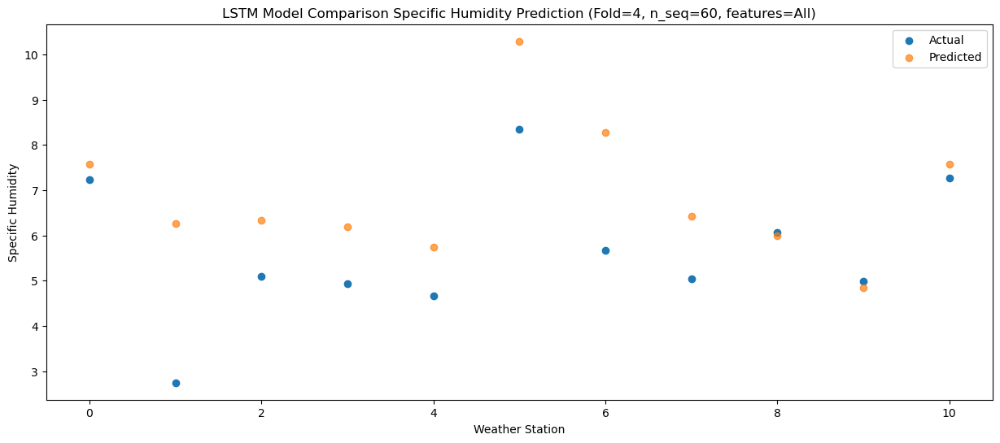

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    3.15   3.419459
1                 1   -1.91   2.119459
2                 2   -0.35   2.179459
3                 3    1.32   2.039459
4                 4    1.06   1.599459
5                 5    6.62   6.139459
6                 6   -0.05   4.119459
7                 7    0.36   2.279459
8                 8    0.29   1.849459
9                 9   -0.30   0.689459
10               10    2.02   3.419459


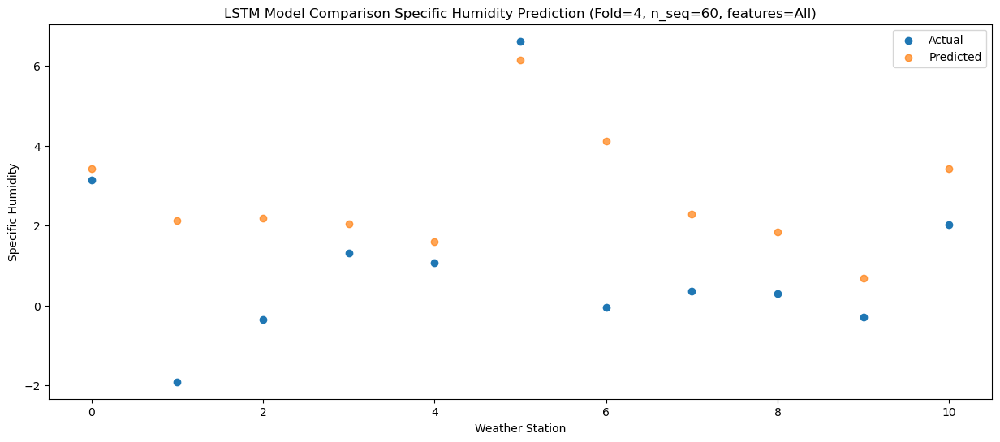

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.94   3.862067
1                 1   -0.17   2.562067
2                 2    2.60   2.622067
3                 3    3.18   2.482067
4                 4    2.47   2.042067
5                 5    5.77   6.582067
6                 6    1.81   4.562067
7                 7    1.83   2.722067
8                 8    1.00   2.292067
9                 9    0.24   1.132067
10               10    1.98   3.862067


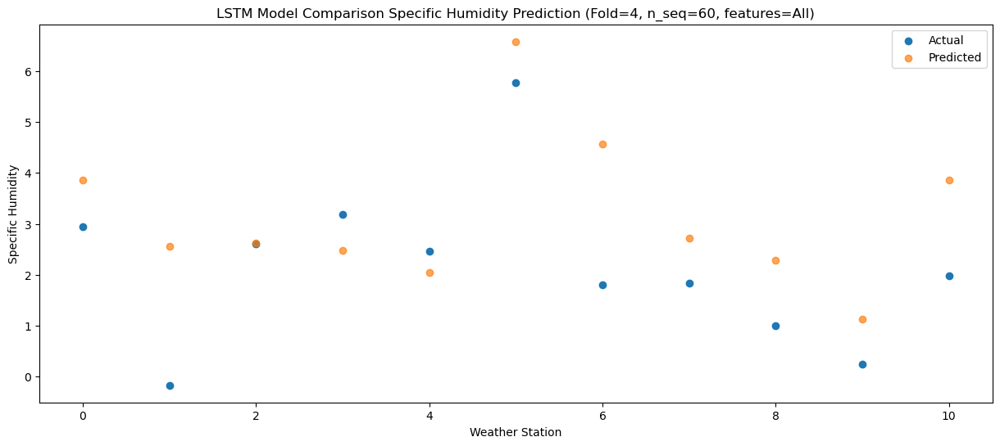

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0    0.93   1.394755
1                 1   -4.03   0.094755
2                 2   -2.13   0.154755
3                 3   -1.48   0.014755
4                 4   -1.86  -0.425245
5                 5    4.31   4.114755
6                 6   -1.17   2.094755
7                 7   -1.37   0.254755
8                 8   -1.38  -0.175245
9                 9   -2.00  -1.335245
10               10    0.24   1.394755


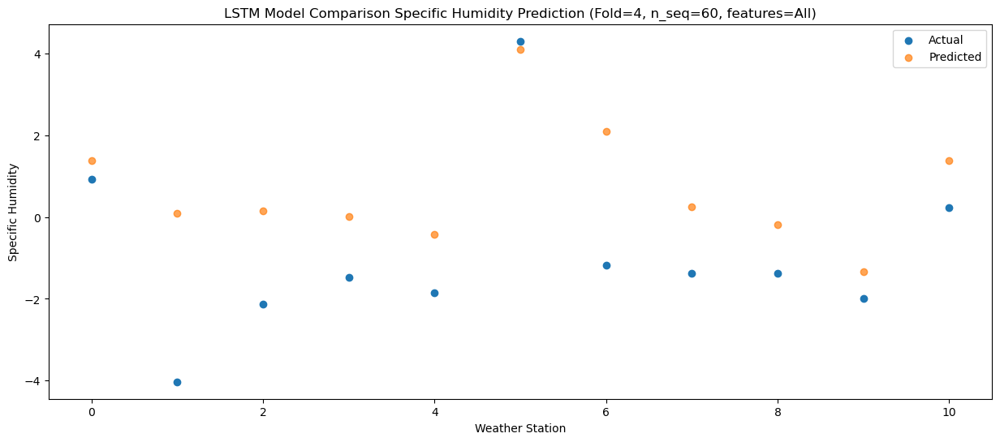

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    1.15   2.377283
1                 1   -2.45   1.077283
2                 2   -1.28   1.137283
3                 3   -0.95   0.997283
4                 4   -1.42   0.557283
5                 5    4.30   5.097283
6                 6    0.15   3.077283
7                 7   -0.86   1.237283
8                 8   -0.80   0.807283
9                 9   -1.30  -0.352717
10               10    0.69   2.377283


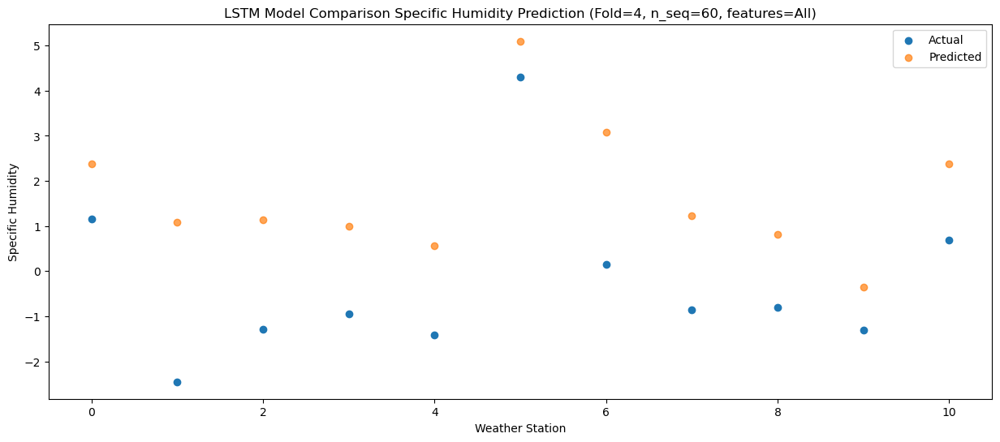

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.71   3.272743
1                 1   -0.92   1.972743
2                 2   -0.23   2.032743
3                 3    0.64   1.892743
4                 4    0.10   1.452743
5                 5    4.89   5.992743
6                 6    0.99   3.972743
7                 7    0.65   2.132743
8                 8    0.51   1.702743
9                 9    0.22   0.542743
10               10    1.84   3.272743


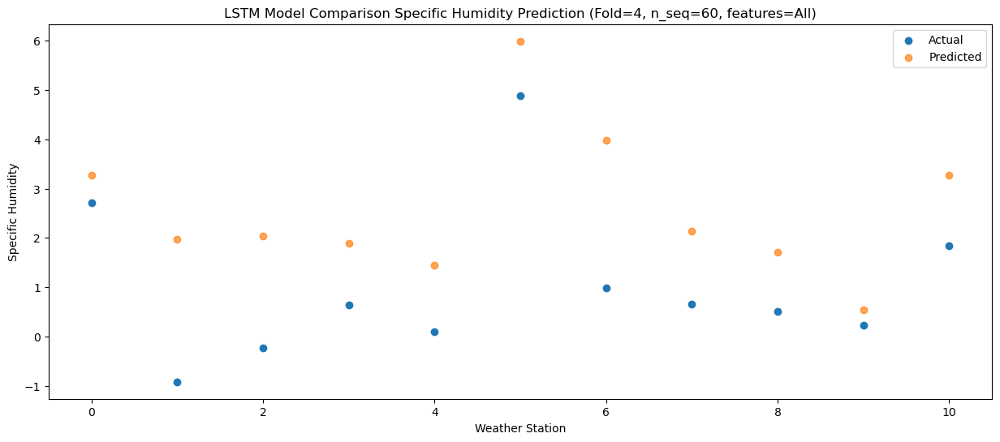

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.20   5.559723
1                 1    0.37   4.259723
2                 2    2.22   4.319723
3                 3    4.15   4.179723
4                 4    3.78   3.739723
5                 5    6.92   8.279723
6                 6    2.05   6.259723
7                 7    2.44   4.419723
8                 8    2.00   3.989723
9                 9    1.52   2.829723
10               10    2.83   5.559723


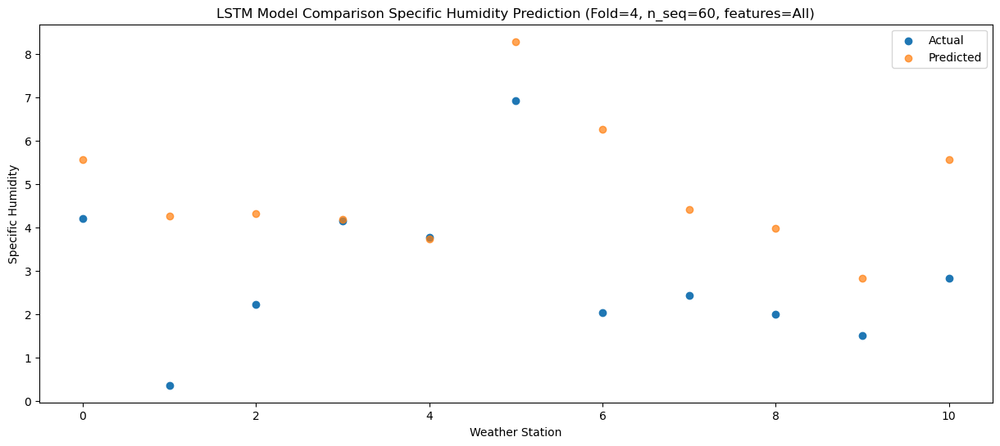

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.08   9.565562
1                 1    2.76   8.265562
2                 2    6.82   8.325562
3                 3    8.14   8.185562
4                 4    7.66   7.745562
5                 5    9.18  12.285562
6                 6    6.06  10.265562
7                 7    7.15   8.425562
8                 8    6.02   7.995562
9                 9    5.59   6.835562
10               10    6.29   9.565562


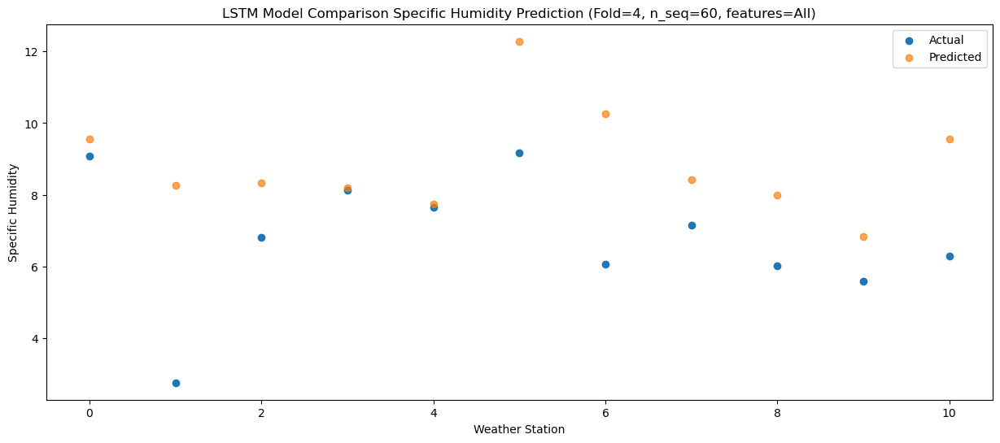

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.31  11.537121
1                 1    5.66  10.237121
2                 2    9.20  10.297121
3                 3    9.91  10.157121
4                 4    9.34   9.717121
5                 5   12.03  14.257121
6                 6    8.34  12.237121
7                 7    9.51  10.397121
8                 8    7.46   9.967121
9                 9    7.83   8.807121
10               10    8.20  11.537121


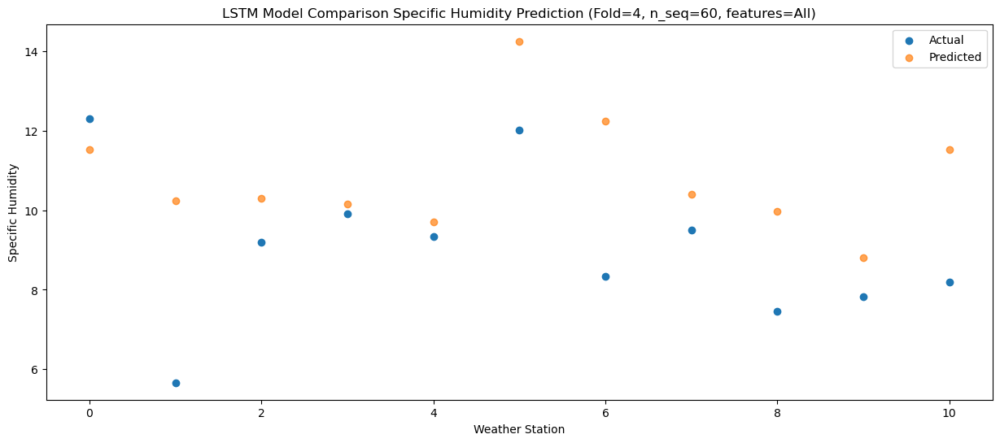

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.94  13.283975
1                 1    6.69  11.983975
2                 2   11.04  12.043975
3                 3    9.33  11.903975
4                 4    8.84  11.463975
5                 5   12.72  16.003975
6                 6   11.50  13.983975
7                 7   10.31  12.143975
8                 8   10.20  11.713975
9                 9   10.47  10.553975
10               10    9.93  13.283975


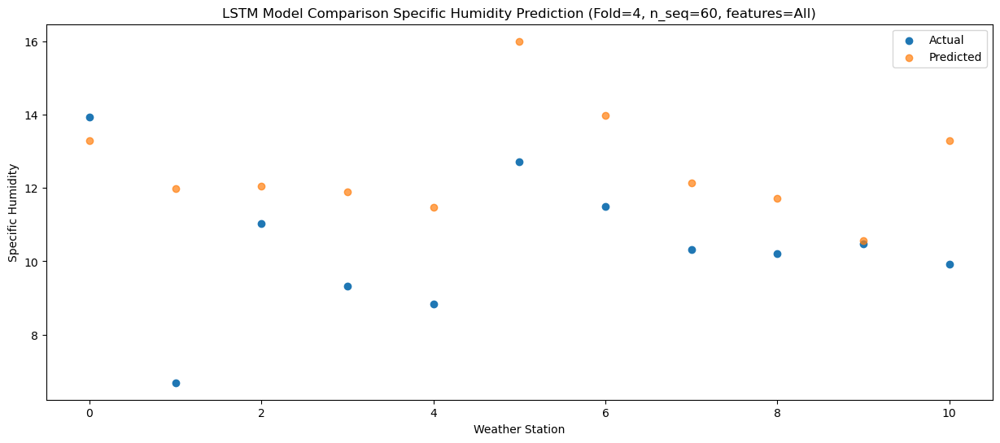

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.73  13.150598
1                 1    6.77  11.850598
2                 2   10.86  11.910598
3                 3   10.34  11.770598
4                 4   10.01  11.330598
5                 5   14.71  15.870598
6                 6   10.31  13.850598
7                 7   10.78  12.010598
8                 8    9.84  11.580598
9                 9    9.70  10.420598
10               10   10.39  13.150598


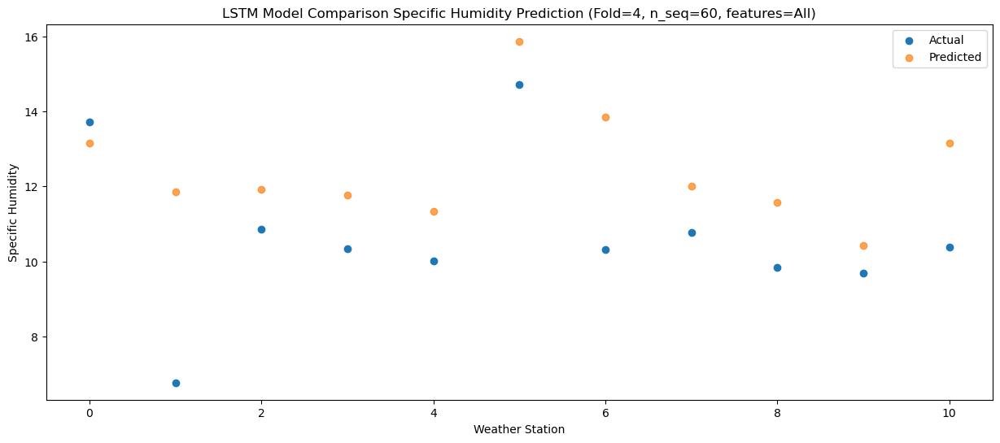

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    9.03   9.831578
1                 1    5.90   8.531578
2                 2    6.62   8.591578
3                 3    7.06   8.451578
4                 4    6.86   8.011578
5                 5   13.46  12.551578
6                 6    6.76  10.531578
7                 7    6.97   8.691578
8                 8    7.18   8.261578
9                 9    6.33   7.101578
10               10    8.40   9.831578


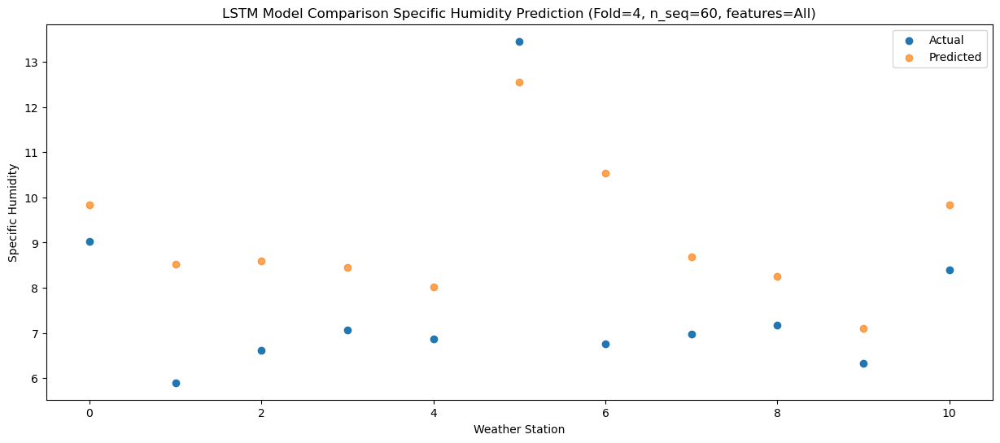

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    4.44   5.427916
1                 1    1.12   4.127916
2                 2    1.66   4.187916
3                 3    2.60   4.047916
4                 4    2.40   3.607916
5                 5    9.95   8.147916
6                 6    2.08   6.127916
7                 7    2.31   4.287916
8                 8    1.85   3.857916
9                 9    1.57   2.697916
10               10    3.58   5.427916


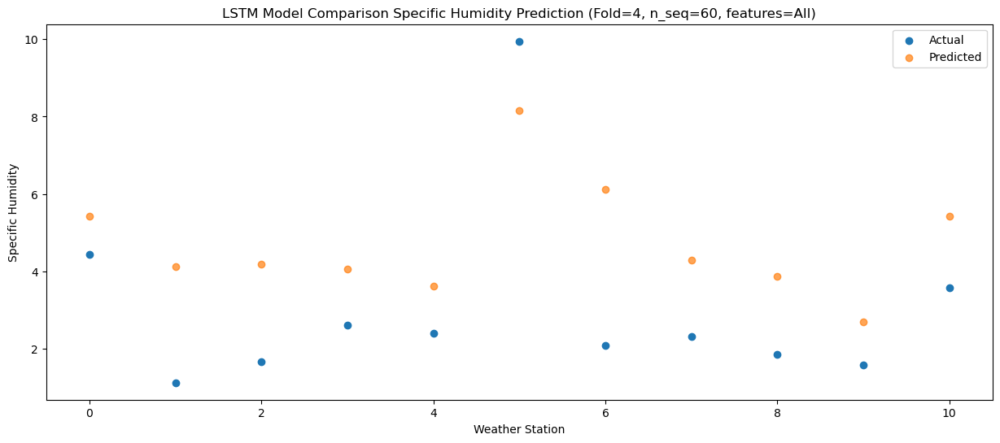

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.27   4.557605
1                 1    1.29   3.257605
2                 2    0.91   3.317605
3                 3    2.42   3.177605
4                 4    1.98   2.737605
5                 5    7.25   7.277605
6                 6    1.90   5.257605
7                 7    0.95   3.417605
8                 8    0.81   2.987605
9                 9    0.20   1.827605
10               10    2.86   4.557605


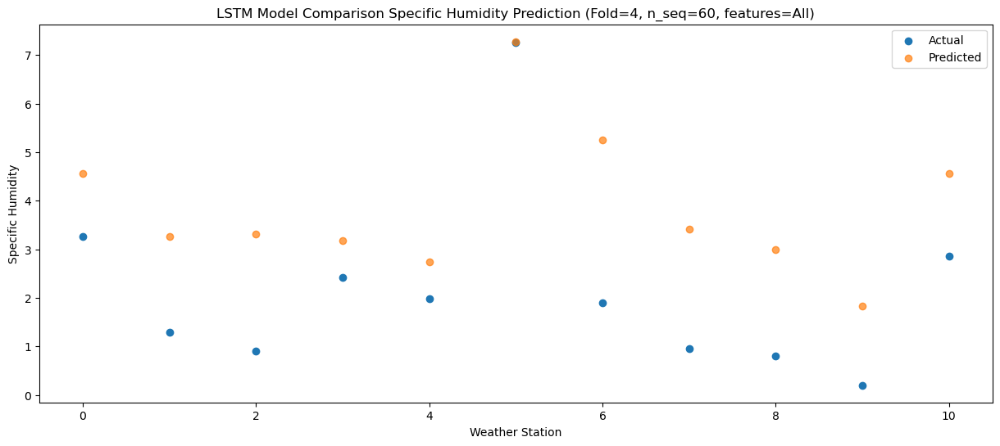

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.93   3.478651
1                 1   -2.23   2.178651
2                 2    0.37   2.238651
3                 3    0.84   2.098651
4                 4    0.39   1.658651
5                 5    6.61   6.198651
6                 6   -0.09   4.178651
7                 7    0.08   2.338651
8                 8   -0.15   1.908651
9                 9   -0.91   0.748651
10               10    1.41   3.478651


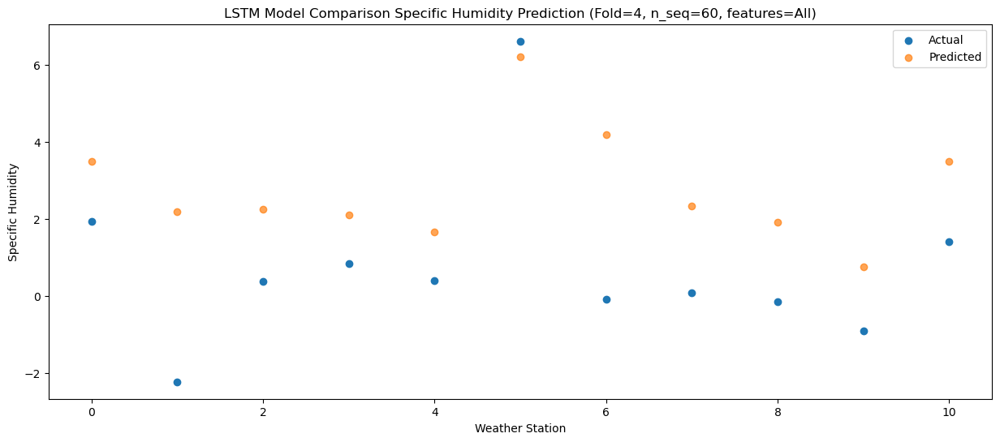

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    2.28   3.523572
1                 1   -2.74   2.223572
2                 2    0.27   2.283572
3                 3    0.15   2.143572
4                 4   -0.36   1.703572
5                 5    5.06   6.243572
6                 6    0.54   4.223572
7                 7    0.36   2.383572
8                 8    0.47   1.953572
9                 9   -0.39   0.793572
10               10    2.03   3.523572


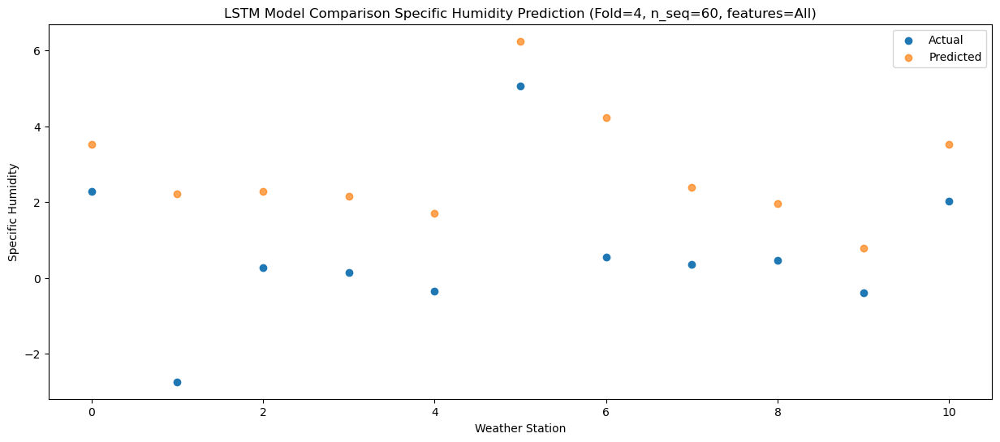

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.23   3.944861
1                 1   -0.80   2.644861
2                 2    0.94   2.704861
3                 3    0.51   2.564861
4                 4    0.04   2.124861
5                 5    5.18   6.664861
6                 6    1.58   4.644861
7                 7    0.17   2.804861
8                 8    0.07   2.374861
9                 9   -0.62   1.214861
10               10    1.28   3.944861


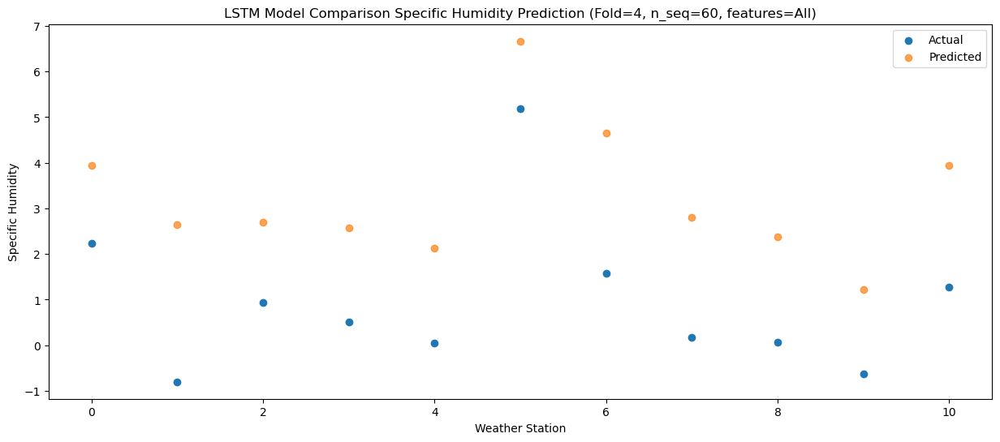

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.07   4.582898
1                 1   -0.42   3.282898
2                 2    1.27   3.342898
3                 3    2.57   3.202898
4                 4    2.01   2.762898
5                 5    6.47   7.302898
6                 6    1.07   5.282898
7                 7    0.93   3.442898
8                 8    0.42   3.012898
9                 9   -0.01   1.852898
10               10    1.49   4.582898


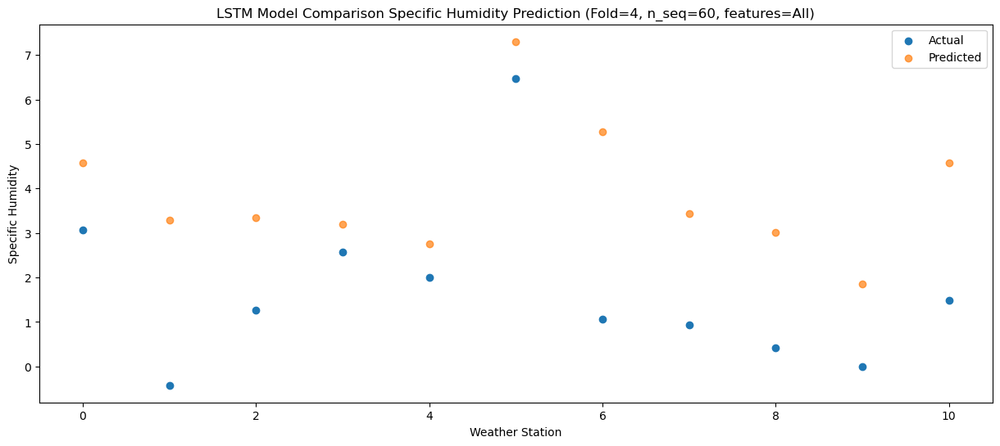

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.25   5.424083
1                 1    1.07   4.124083
2                 2    2.11   4.184083
3                 3    3.25   4.044083
4                 4    2.86   3.604083
5                 5    6.44   8.144083
6                 6    2.67   6.124083
7                 7    1.83   4.284083
8                 8    1.87   3.854083
9                 9    1.50   2.694083
10               10    3.19   5.424083


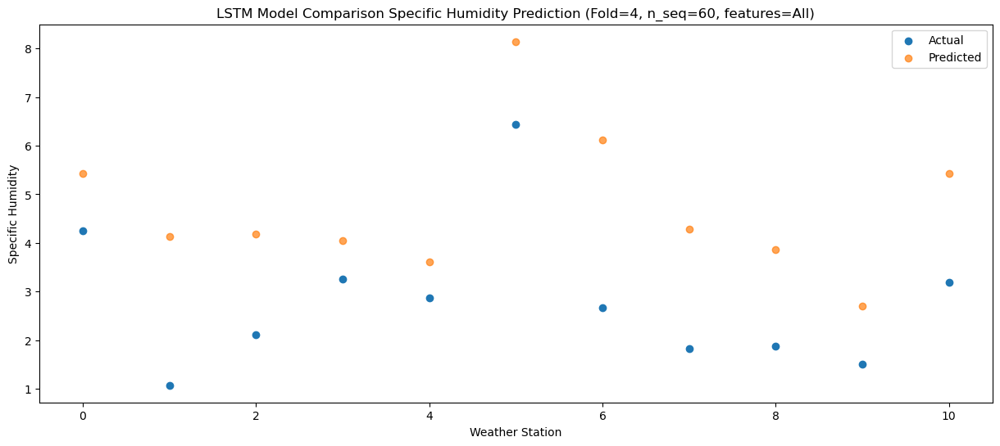

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.27   8.610096
1                 1    1.87   7.310096
2                 2    5.49   7.370096
3                 3    7.51   7.230096
4                 4    7.13   6.790096
5                 5   11.28  11.330096
6                 6    4.89   9.310096
7                 7    6.22   7.470096
8                 8    4.12   7.040096
9                 9    4.28   5.880096
10               10    4.09   8.610096


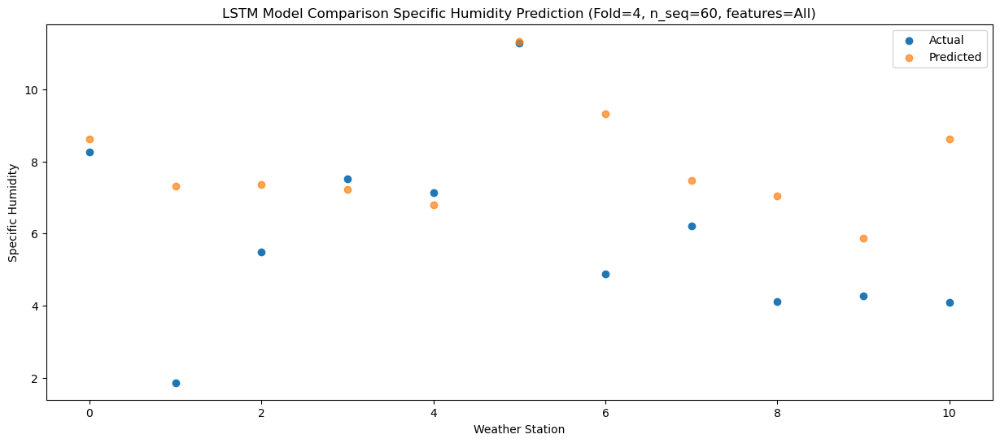

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.81  12.020763
1                 1    5.38  10.720763
2                 2    9.06  10.780763
3                 3   11.45  10.640763
4                 4   10.61  10.200763
5                 5   15.14  14.740763
6                 6    7.94  12.720763
7                 7    8.78  10.880763
8                 8    6.08  10.450763
9                 9    5.92   9.290763
10               10    7.33  12.020763


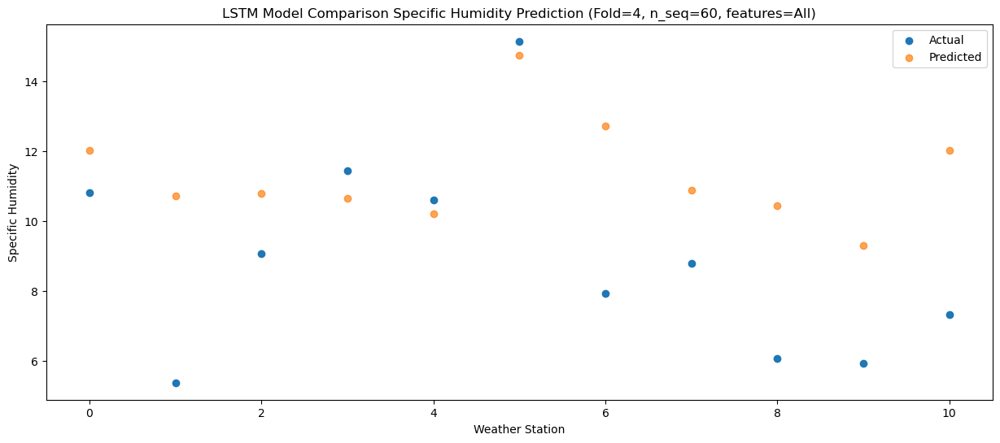

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.50  13.990401
1                 1    7.29  12.690401
2                 2   10.65  12.750401
3                 3   11.30  12.610401
4                 4    9.71  12.170401
5                 5   12.81  16.710401
6                 6   11.33  14.690401
7                 7   11.57  12.850401
8                 8   10.38  12.420401
9                 9   10.62  11.260401
10               10   10.95  13.990401


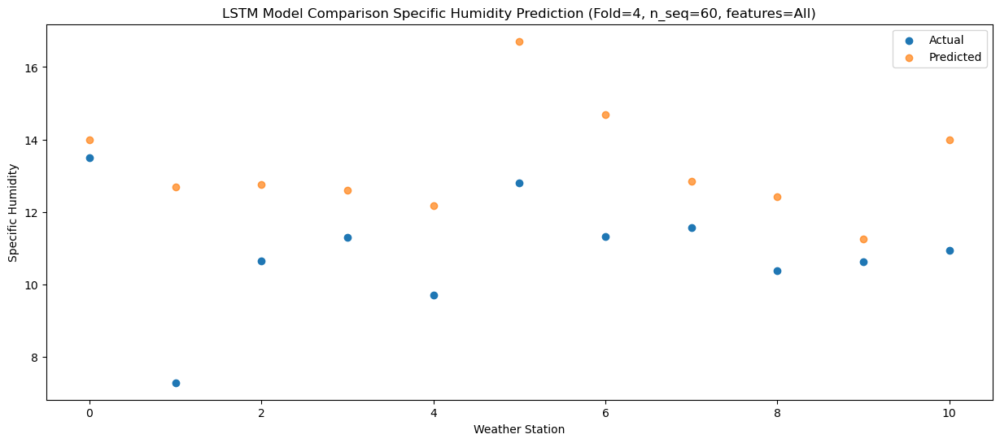

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.43  12.813282
1                 1    7.59  11.513282
2                 2    9.07  11.573282
3                 3    9.20  11.433282
4                 4    8.33  10.993282
5                 5   11.95  15.533282
6                 6   10.87  13.513282
7                 7   11.85  11.673282
8                 8    9.84  11.243282
9                 9   10.49  10.083282
10               10   10.15  12.813282


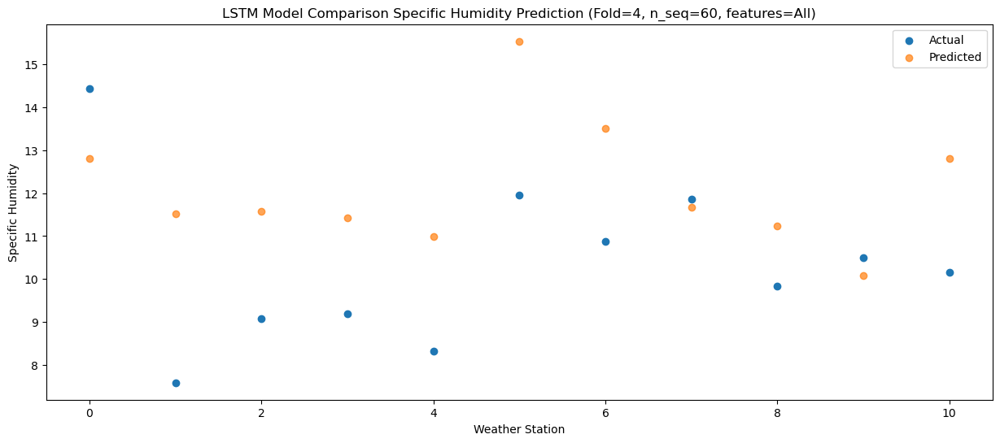

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.51  11.154558
1                 1    5.14   9.854558
2                 2    6.05   9.914558
3                 3    8.30   9.774558
4                 4    8.00   9.334558
5                 5   12.46  13.874558
6                 6    7.42  11.854558
7                 7    7.65  10.014558
8                 8    7.04   9.584558
9                 9    6.71   8.424558
10               10    8.44  11.154558


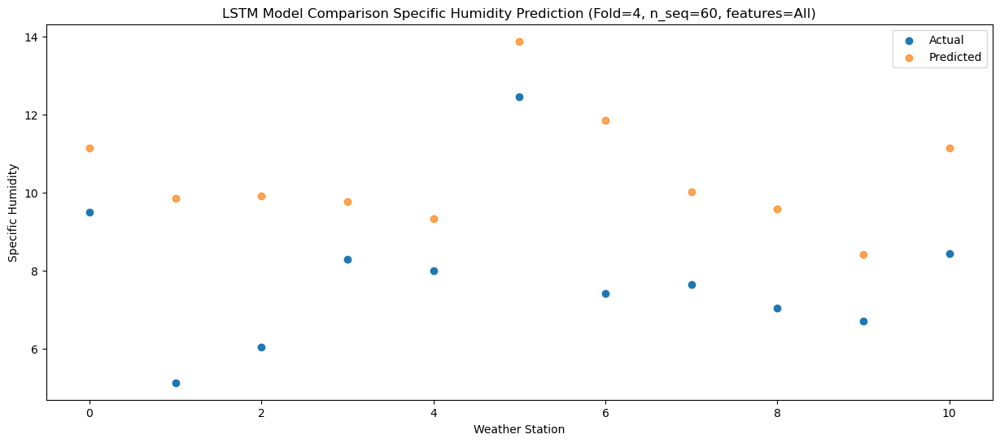

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.32   7.249234
1                 1    1.52   5.949234
2                 2    2.12   6.009234
3                 3    4.58   5.869234
4                 4    4.34   5.429234
5                 5   10.33   9.969234
6                 6    3.51   7.949234
7                 7    4.04   6.109234
8                 8    3.71   5.679234
9                 9    3.27   4.519234
10               10    5.38   7.249234


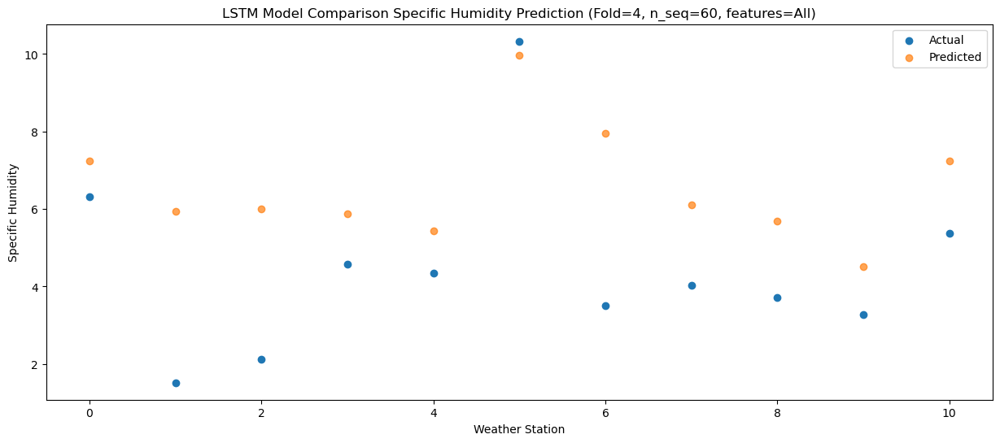

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.42   4.306158
1                 1   -0.78   3.006158
2                 2    0.14   3.066158
3                 3    2.05   2.926158
4                 4    1.92   2.486158
5                 5    8.03   7.026158
6                 6    0.56   5.006158
7                 7    1.01   3.166158
8                 8    0.64   2.736158
9                 9   -0.12   1.576158
10               10    1.94   4.306158


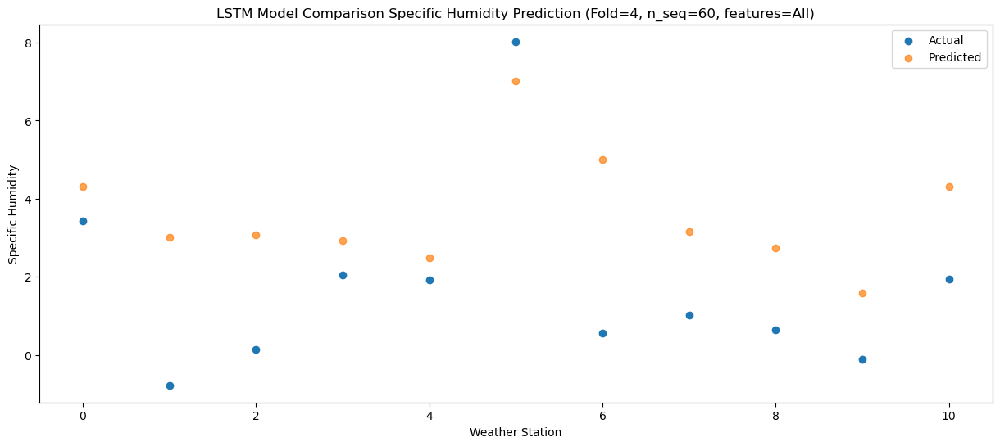

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.24   3.649309
1                 1   -1.87   2.349309
2                 2   -1.17   2.409309
3                 3    0.30   2.269309
4                 4    0.16   1.829309
5                 5    6.45   6.369309
6                 6    0.28   4.349309
7                 7    0.20   2.509309
8                 8    0.61   2.079309
9                 9    0.37   0.919309
10               10    2.46   3.649309


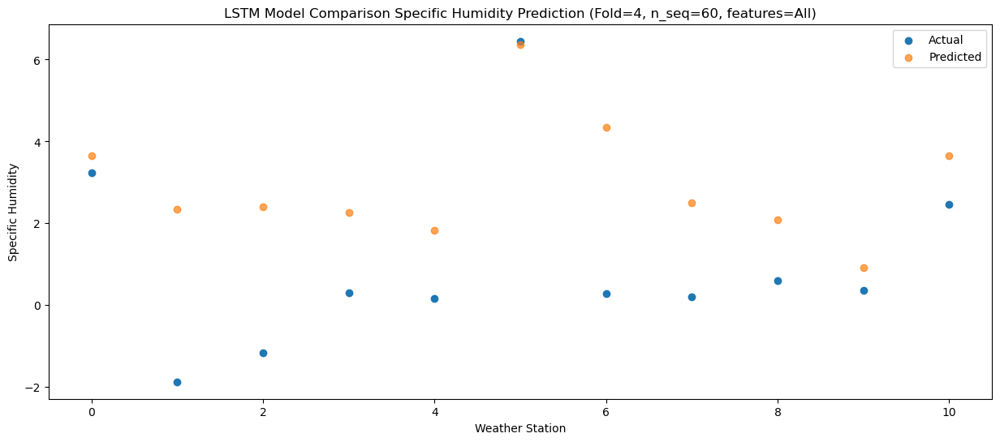

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    1.54   2.742348
1                 1   -2.91   1.442348
2                 2   -1.89   1.502348
3                 3   -0.98   1.362348
4                 4   -1.26   0.922348
5                 5    5.18   5.462348
6                 6   -0.50   3.442348
7                 7   -0.95   1.602348
8                 8   -0.47   1.172348
9                 9   -1.09   0.012348
10               10    1.39   2.742348


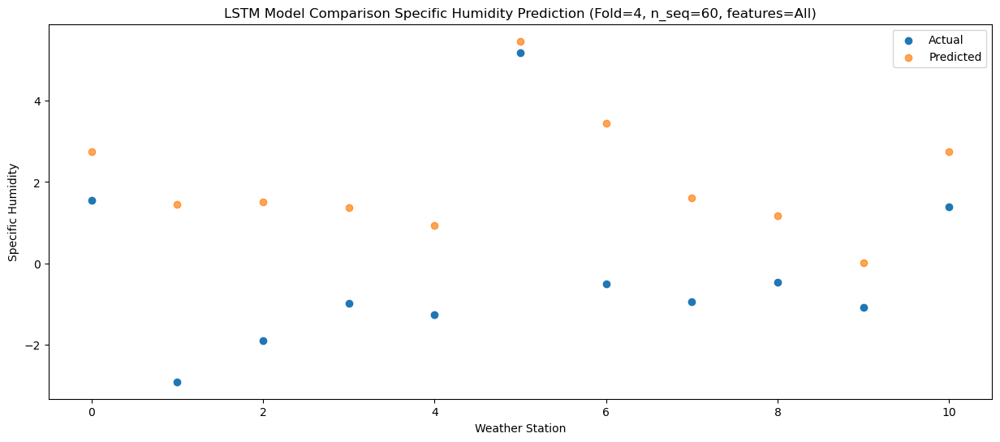

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    2.55   4.200806
1                 1   -3.60   2.900806
2                 2   -0.46   2.960806
3                 3    1.36   2.820806
4                 4    1.09   2.380806
5                 5    5.53   6.920806
6                 6   -0.32   4.900806
7                 7    0.41   3.060806
8                 8    0.11   2.630806
9                 9   -0.17   1.470806
10               10    1.41   4.200806


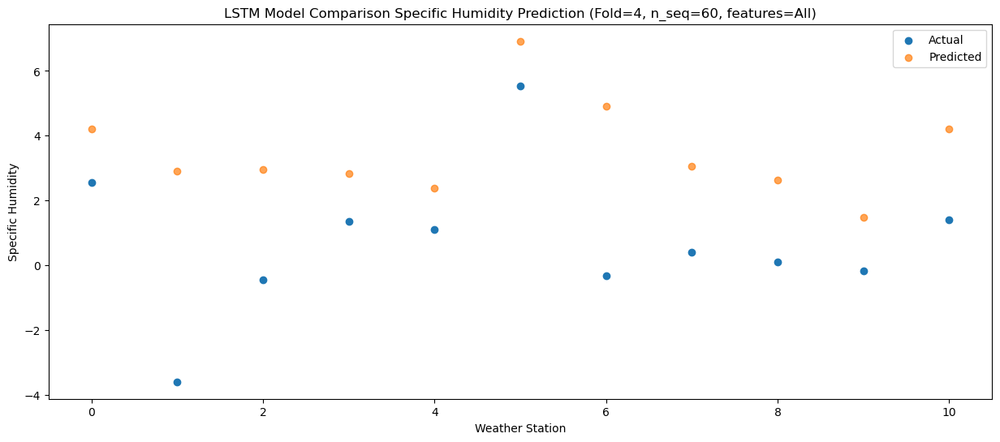

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.61   5.531519
1                 1   -0.31   4.231519
2                 2    1.17   4.291519
3                 3    3.15   4.151519
4                 4    3.04   3.711519
5                 5    6.67   8.251519
6                 6    1.25   6.231519
7                 7    1.62   4.391519
8                 8    1.18   3.961519
9                 9    0.80   2.801519
10               10    2.48   5.531519


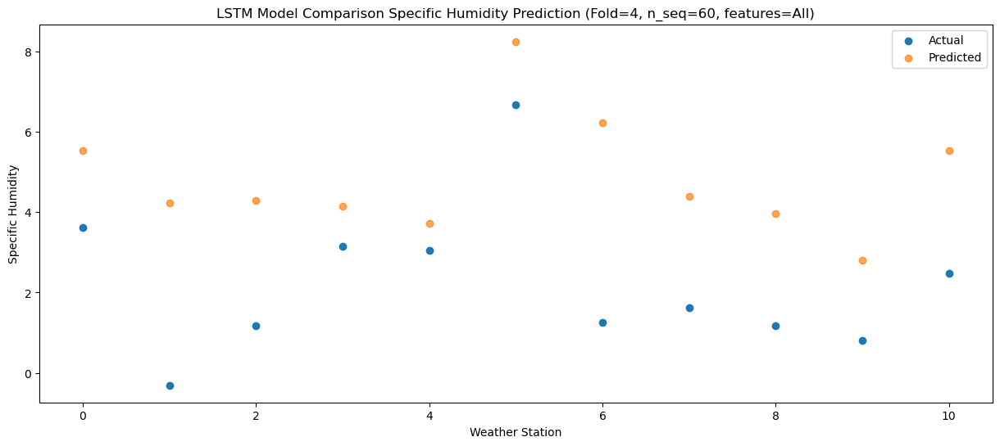

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.29   7.313794
1                 1   -0.91   6.013794
2                 2    3.35   6.073794
3                 3    5.52   5.933794
4                 4    5.54   5.493794
5                 5    7.27  10.033794
6                 6    3.17   8.013794
7                 7    3.35   6.173794
8                 8    3.21   5.743794
9                 9    2.52   4.583794
10               10    4.26   7.313794


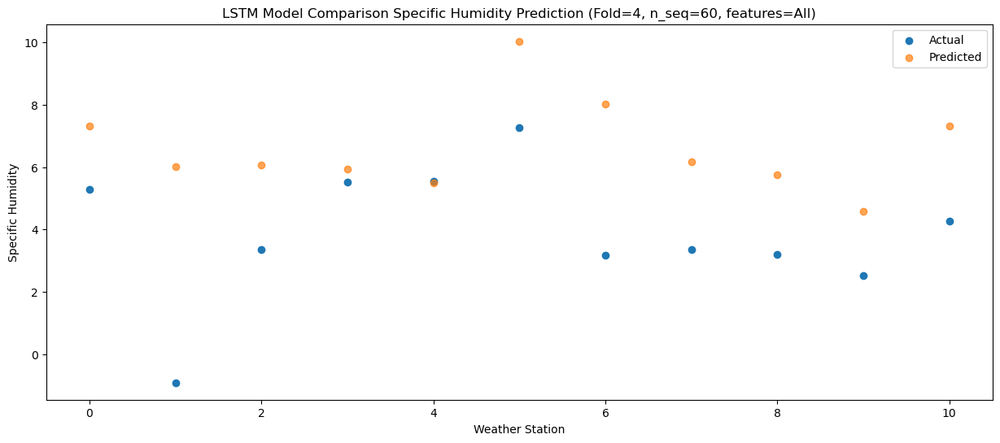

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.36  10.803516
1                 1    1.68   9.503516
2                 2    7.67   9.563516
3                 3    9.09   9.423516
4                 4    8.97   8.983516
5                 5   10.03  13.523516
6                 6    7.17  11.503516
7                 7    7.77   9.663516
8                 8    6.70   9.233516
9                 9    6.06   8.073516
10               10    7.18  10.803516


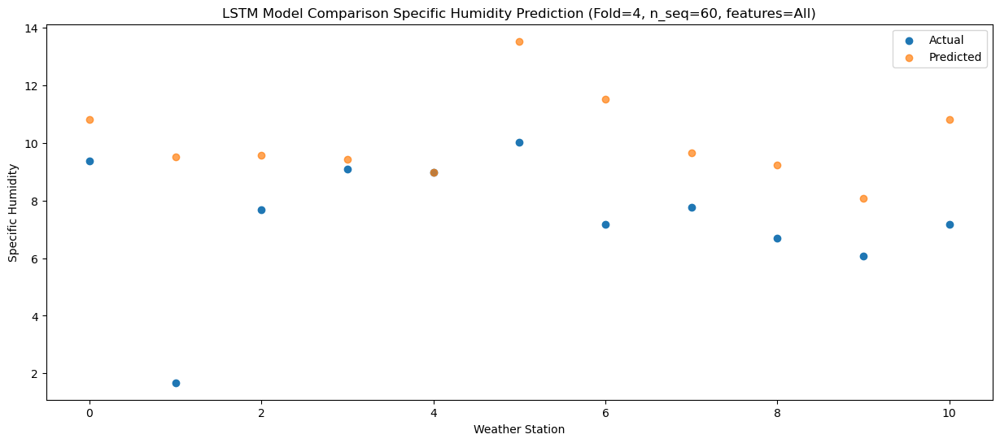

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   12.62  13.889052
1                 1    3.14  12.589052
2                 2    9.01  12.649052
3                 3   11.03  12.509052
4                 4   11.08  12.069052
5                 5   14.56  16.609052
6                 6    8.93  14.589052
7                 7    9.75  12.749052
8                 8    8.39  12.319052
9                 9    8.82  11.159052
10               10    9.73  13.889052


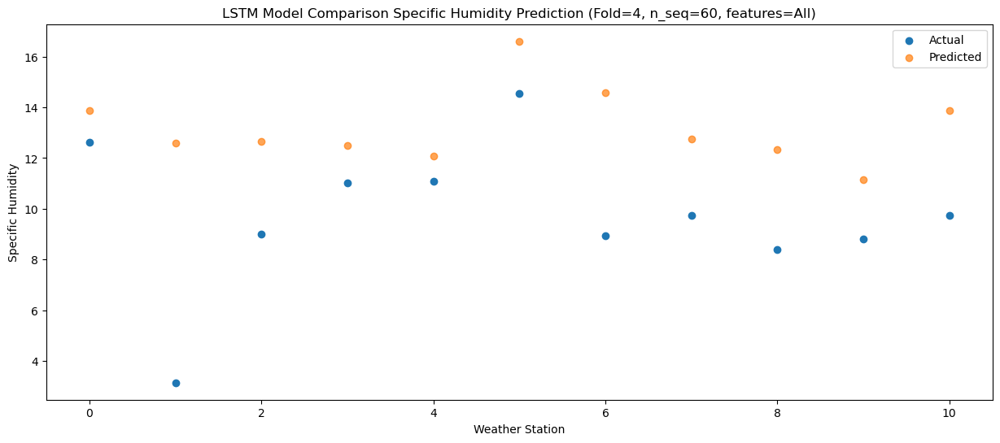

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   13.81  14.236973
1                 1    4.60  12.936973
2                 2   11.04  12.996973
3                 3   10.99  12.856973
4                 4   10.61  12.416973
5                 5   14.44  16.956973
6                 6   11.32  14.936973
7                 7   10.73  13.096973
8                 8    9.69  12.666973
9                 9   10.43  11.506973
10               10   10.85  14.236973


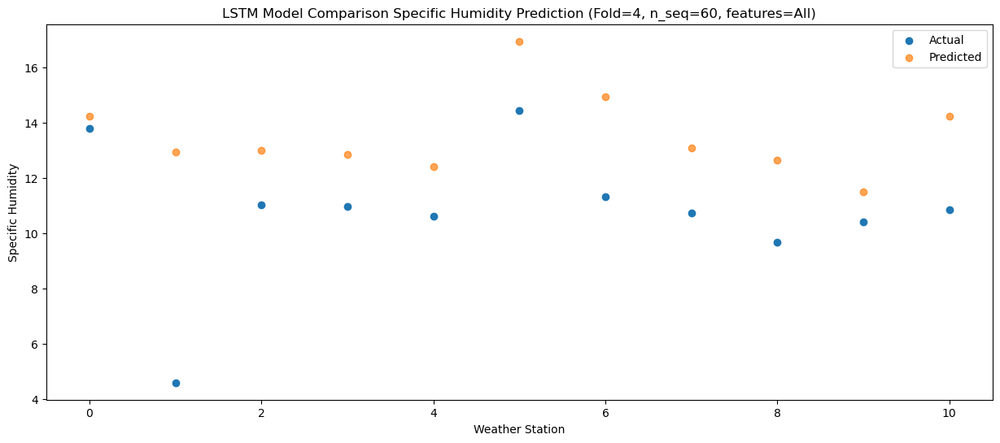

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.65  14.035299
1                 1    7.21  12.735299
2                 2    8.73  12.795299
3                 3   10.28  12.655299
4                 4    9.84  12.215299
5                 5   13.24  16.755299
6                 6   10.58  14.735299
7                 7    9.44  12.895299
8                 8    9.33  12.465299
9                 9   10.07  11.305299
10               10   10.83  14.035299


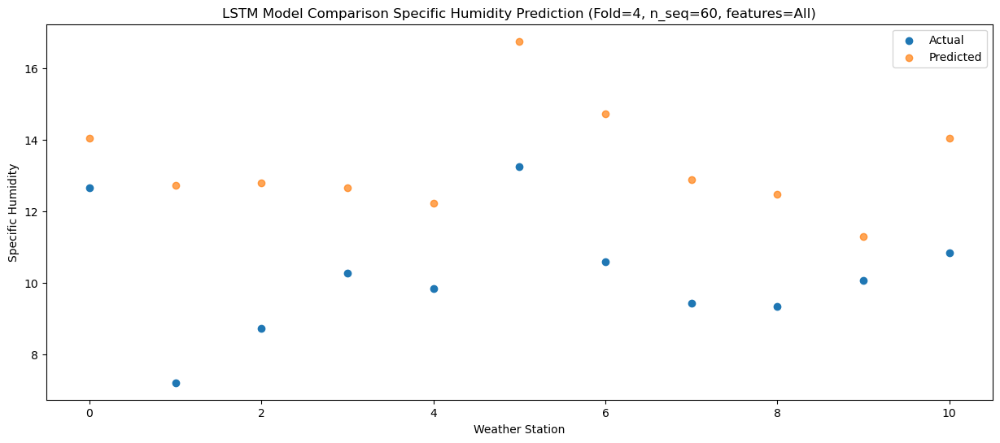

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.35  11.056622
1                 1    7.02   9.756622
2                 2    7.63   9.816622
3                 3    7.75   9.676622
4                 4    7.68   9.236622
5                 5   12.36  13.776622
6                 6    8.26  11.756622
7                 7    7.40   9.916622
8                 8    6.65   9.486622
9                 9    6.57   8.326622
10               10    8.76  11.056622


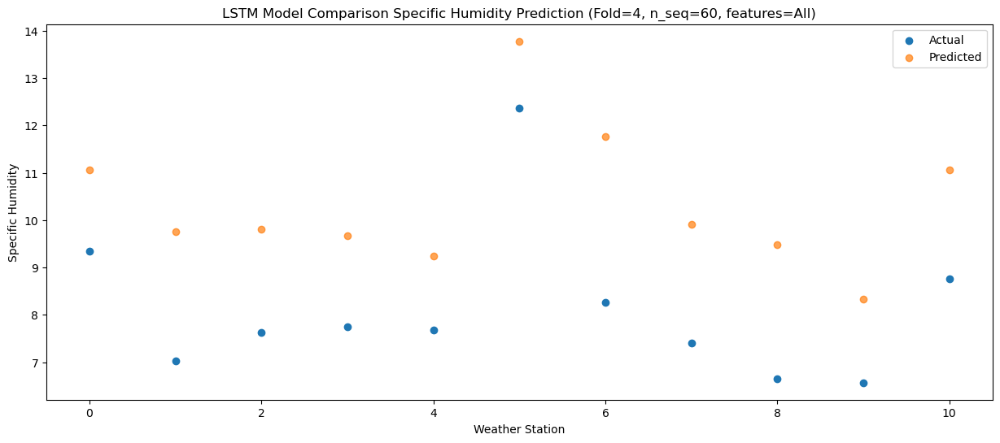

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.22   7.016469
1                 1    2.60   5.716469
2                 2    2.84   5.776469
3                 3    4.29   5.636469
4                 4    3.94   5.196469
5                 5    8.67   9.736469
6                 6    3.86   7.716469
7                 7    3.08   5.876469
8                 8    3.07   5.446469
9                 9    2.47   4.286469
10               10    4.65   7.016469


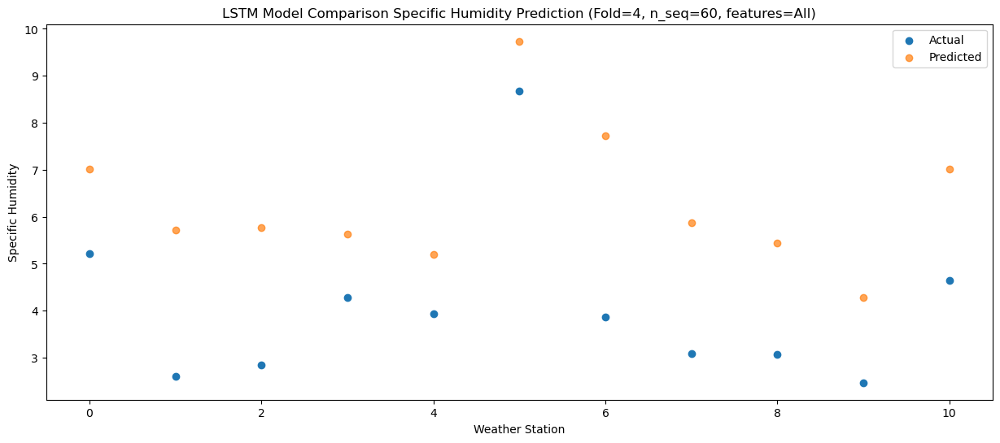

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (1, 1, 1024)              12308480  
                                                                 
 dropout_8 (Dropout)         (1, 1, 1024)              0         
                                                                 
 lstm_9 (LSTM)               (1, 1024)                 8392704   
                                                                 
 dropout_9 (Dropout)         (1, 1024)                 0         
                                                                 
 dense_12 (Dense)            (1, 256)                  262400    
                                                                 
 dense_13 (Dense)            (1, 128)                  32896     
                                                                 
 dense_14 (Dense)            (1, 60)                  

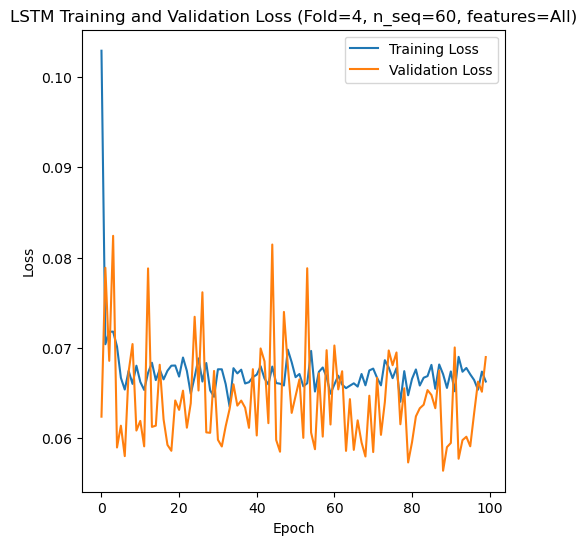

[[2.4974426148245157, 1.913891259686976, 1.4374296186706503, 0.8976713908531221, 1.3238317696382067, 1.3372423642809448, 1.4074779717443662, 1.0809680230154974, 1.348613380702552, 1.0979562501927664, 1.2641249719381837, 0.9939857478042816, 0.7672527742746217, 1.9150673834376566, 2.0018547546288645, 1.3740432096762696, 1.279407488313269, 1.3724657148119024, 1.505422155562845, 1.4052754720732095, 1.2503712458468934, 1.3608991943856805, 0.8528958757200831, 1.1212230544354376, 1.9929338985184633, 1.3654558789696347, 1.787473829271201, 1.0808083274014342, 1.2384465481938587, 1.241983172433179, 1.4913978018554137, 1.3723467970178265, 1.7548948759110494, 1.4866151346917003, 1.1978908388613274, 1.709655393587181, 0.9637936613682577, 1.335062333794203, 1.1885798717677223, 0.74007017333762, 1.1193372585523726, 0.9780113905572252, 1.5859210898900267, 1.8875234373256211, 1.7085657611217784, 1.4074964181797918, 1.2898972528891397, 1.3848130335534465, 1.313587176816703, 1.7795565682842847, 1.7292978

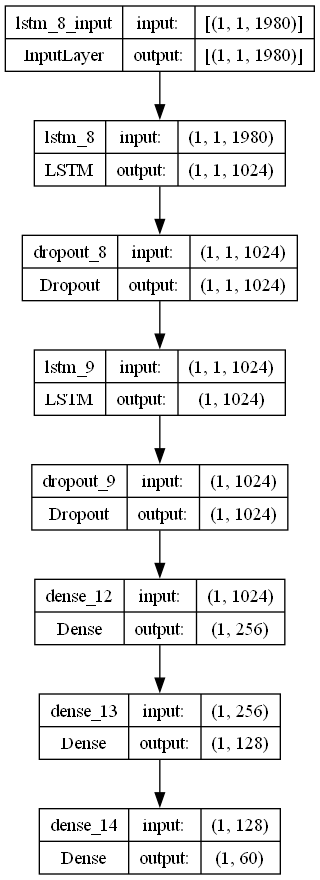

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from best model
    lr = 0.0075347879655024725
    optimizer = Adam(learning_rate = lr)
    activation_function = 'sigmoid'
    lstm_units = 1024
    dropout_rate =  0.4315340075776729

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with an LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=All)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=All)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_SH_S60.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)

In [3]:
print(np.mean(mape_avg_list[0]))

1.412082357570264


In [4]:
print(np.mean(mape_avg_list[1]))

4310528132253.429


In [5]:
print(np.mean(mape_avg_list[2]))

1.397887486946767


In [6]:
print(np.mean(mape_avg_list[3]))

4813310049848.912


In [7]:
print(np.mean(mape_avg_list[4]))

2.133181268574428


In [8]:
print(mape_avg_list[1])

[1.3365434499294644, 1.7399251846714905, 72689586957214.8, 6.108259870235147, 0.5680919023841624, 8.053470901626493, 0.2770072150553043, 0.11645194049018506, 0.10922667012297399, 0.08966141873739415, 0.1001105825212833, 0.2869580296682886, 2.907672262286891, 2.3773169306580115, 3.042531521431943, 2.1633687330072626, 2.022488392194228, 8.68607857493795, 0.419376368770059, 0.134623182604914, 0.08751953746068794, 0.0711205633170588, 0.11629594030952921, 0.18472557463013925, 1.2278051001253667, 2.143813592644423, 2.158781133294711, 5.8090359160938805, 21.61859916808589, 185942100977870.62, 0.22316146317457933, 0.153727226698279, 0.0800155172736809, 0.0625377438993844, 0.11864876684404399, 10.147558743097408, 2.967514865568141, 1.5135833609499656, 1.4827791546136082, 6.935927924958463, 2.9783831028761343, 0.8506508895661746, 0.36846917807193047, 0.25398375477815605, 0.11188965645578747, 0.10228355315539371, 0.15728249360853086, 0.5730071653336763, 1.195773597269052, 1.3471620261583164, 6.63

In [9]:
print(mape_avg_list[3])

[0.9468369234823467, 0.8245922919316405, 2.041014666500743, 0.80023492945873, 1.22580182290066, 0.8512858889037623, 0.3136453462915649, 0.13096801676077952, 0.18776756401189806, 0.12776322872298532, 0.10741232367177092, 0.44663428810507527, 0.8039785306422152, 1.5969282719190074, 0.7684284975503711, 0.803368834803083, 216607216396355.7, 0.49389005129101077, 0.4285886191277921, 0.13601016411912842, 0.1071004698780419, 0.11614331567131225, 0.12325445033275949, 0.24100419488919364, 1.5826800643569294, 1.0472180553307955, 0.8805129844129251, 1.4815809336514898, 23.435179623724764, 0.5019143239661538, 0.16502497084986667, 0.12890948119374054, 0.17527095044787463, 0.16170373585069, 0.2798158995513887, 1.7433283862706836, 2.434373529998474, 11.779315969759734, 2.4728648253948116, 3.2916874327574828, 2.6794377861595318, 1.7124723673554725, 1.0225349035889812, 0.12407008882162186, 0.18184756686396764, 0.16350484438541565, 0.2859827688447303, 0.7153057961397106, 1.5662669176747401, 4.15313347667

In [10]:
print(mape_avg_list[1][2])

72689586957214.8


In [11]:
print(mape_avg_list[1][29])

185942100977870.62


In [12]:
print(mape_avg_list[3][16])

216607216396355.7


In [13]:
print(mape_avg_list[3][51])

72191386594480.33


In [14]:
print(np.sum(mape_avg_list[1][0:1])+np.sum(mape_avg_list[1][3:28])+np.sum(mape_avg_list[1][30:60]))

96.97693736126902


In [15]:
print(np.sum(mape_avg_list[3][0:15])+np.sum(mape_avg_list[3][17:50])+np.sum(mape_avg_list[3][52:60]))

95.385525677455


In [16]:
print("MAPE Average for Fold 2 (removing >1e14 values): "+str(96.97693736126902/58))

MAPE Average for Fold 2 (removing >1e14 values): 1.6720161614011901


In [17]:
print("MAPE Average for Fold 4 (removing >1e14 values): "+str(95.385525677455/58))

MAPE Average for Fold 4 (removing >1e14 values): 1.644578028921638


In [18]:
print("Average MAPE: "+str((1.412082357570264+1.6720161614011901+1.397887486946767+1.644578028921638+2.133181268574428)/5))

Average MAPE: 1.6519490606828575
